In [1]:
import os
import sys
import re
import random
import numpy as np
import pandas as pd
import math
import glob
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import subprocess
from shutil import copyfile
import tempfile
import shutil
from collections import defaultdict
# import xarray
import gzip
import time
import json
from Bio import SeqIO

from sklearn.cluster import AgglomerativeClustering
from sklearn import metrics
from scipy.cluster.hierarchy import dendrogram
import scipy as sp
import sklearn as sk

from sklearn.cluster import KMeans
import sklearn.metrics as sm
%matplotlib inline
pd.options.display.max_colwidth = 1000

sys.path.append('./software/')
from get_rmsds_functions import TMalign
from get_rmsds_functions import get_RMSD
import check_interactions_to_lig

# from pyrosetta import *
# param_f = '/home/linnaan/ligands/4KL_xanthurenic_acid/4KL_paper2/ready_to_use/good_to_use/4KL_ref2015.params'
# init(f'-beta_nov16 -corrections:beta_nov16 -extra_res {param_f}')

sys.path.append('./lib/')
from libSlurm import make_submit_file
from libSlurm import make_dist_plots
from libSlurm import sed_inplace
from libSlurm import grep
from libSlurm import get_flags
from libCommonJupyterFunc import get_total_scores
from check_interactions_to_lig import get_lig_num
from check_interactions_to_lig import get_hb2lig
sys.path.append('./software/')
import silent_tools # from git@github.com:bcov77/silent_tools.git

In [2]:
home_dir = '/home/linnaan/software/Pseudocycle_small_molecule_binder/' # change to your script directory
scratch_dir = '/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/' # change to your temp output directory

#ligands
# format: {name,[param, [rotamers],requirements,required_atms]}
# required_atms should be adjusted based on rifgen rif size results. too small rif
# hurt rifdock significantly
ligands = {           'T44':['/home/linnaan/ligands/T44/sel_low_energy/good_to_use/T44_0001_relax_charged_genpot.params',\
                  '/home/linnaan/ligands/T44/sel_low_energy/good_to_use/T44_ref2015.params',\
                  [i for i in glob.glob('/home/linnaan/ligands/T44/sel_low_energy/good_to_use/T44_*_relax_charged_ref2015.pdb') if 'linker' not in i],\
                  '2,3,5,6,8,9','N1,H8,H9,H11,O3,O4,O1,O2,H10'],
          } 

# Check burial of tail
# edit manually
# format: ligand_name: [check_burial_atom, linker_added_ligand_params,burial_cutoff (adjust this),
#                     lig_heavy_atm,lig_aromatic_amds]
ligands_tails = {   'T44':['C16',
                        '/home/linnaan/ligands/T44/sel_low_energy/T44_0005_relax_charged_ref2015_linker.params',
                        7,('O1','O2','O3','O4','H10','N1','H8','H9','H11'),
                        ('O1','O2','O3','O4','H10','N1')],
                } #add tail ligands

In [3]:
# this contains 1 scaffold from each cluster, no filter on scaffold quality.
# can change with more knowledge
scaffold_df = pd.read_csv(f'{home_dir}finalist_21k_info_v220106_clustered_hullpos_forDock_cleaned_155aa.csv')
print(len(scaffold_df))
scaffold_df.head()

8719


,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Unnamed: 0.1.1.1,Unnamed: 0.1.1.1.1,Unnamed: 0.1.1.1.1.1,score,fa_atr,fa_rep,fa_sol,...,name_before_permute,dssp_bin_before_permute,cluster,pdb1,posfile_by_hull,nres,short_name,indi_cluster_dir,polar_bias_pssm_f,no_bias_pssm_f
0,0,0,2,2,2,2,-305.763,-948.172,155.222,715.014,...,L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192628_612107_AAA+_step_00469_dldesign_5_relax_0001_rank_1_relax.pdb,3/LHLHLHLHLHLHL_3/files.list,3/HHHHHH_3/62.list,L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192628_612107_AAA+_step_00469_dldesign_5_relax_0001_rank_1_relax.pdb,/home/drhicks1/af2_cyclic_repeat_proteins/20220119_pocket_hull/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192628_612107_AAA+_step_00469_dldesign_5_relax_0001_rank_1_relax.pos,150.0,3-HHHHHH_3-62,3/HHHHHH_3_62/,/home/linnaan/New_AF2_scaffolds/resampled_pseudocycles/PSSM/3/HHHHHH_3_62/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192628_612107_AAA+_step_00469_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias.pssm,/home/linnaan/New_AF2_scaffolds/resampled_pseudocycles/PSSM/3/HHHHHH_3_62/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192628_612107_AAA+_step_00469_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias.pssm
1,1,1,4,4,4,4,-253.208,-880.858,121.295,707.958,...,L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005219_391887_AAAA+_step_00492_dldesign_2_relax_0001_rank_1_relax.pdb,4/LHLHLHLHLHLHLHLHLHL_4/files.list,4/HHHHHHHH_4/21.list,L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005219_391887_AAAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_20220103_171107_923767_permute_rank_1_relax.pdb,/home/drhicks1/af2_cyclic_repeat_proteins/20220119_pocket_hull/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005219_391887_AAAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_20220103_171107_923767_permute_rank_1_relax.pos,144.0,4-HHHHHHHH_4-21,4/HHHHHHHH_4_21/,/home/linnaan/New_AF2_scaffolds/resampled_pseudocycles/PSSM/4/HHHHHHHH_4_21/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005219_391887_AAAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_20220103_171107_923767_permute_rank_1_relax_dldesign_pbias.pssm,/home/linnaan/New_AF2_scaffolds/resampled_pseudocycles/PSSM/4/HHHHHHHH_4_21/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005219_391887_AAAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_20220103_171107_923767_permute_rank_1_relax_dldesign_nobias.pssm
2,2,2,5,5,5,5,-245.363,-776.541,89.400,650.947,...,L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_233141_820550_AAAA+_step_00496_dldesign_1_relax_0001_rank_1_relax.pdb,4/LHLHLHLHLHLHLHLHL_4/files.list,4/HHHHHHHH_4/735.list,L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_233141_820550_AAAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_171105_507088_permute_rank_1_relax.pdb,/home/drhicks1/af2_cyclic_repeat_proteins/20220119_pocket_hull/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_233141_820550_AAAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_171105_507088_permute_rank_1_relax.pos,128.0,4-HHHHHHHH_4-735,4/HHHHHHHH_4_735/,/home/linnaan/New_AF2_scaffolds/resampled_pseudocycles/PSSM/4/HHHHHHHH_4_735/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_233141_820550_AAAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_171105_507088_permute_rank_1_relax_dldesign_pbias.pssm,/home/linnaan/New_AF2_scaffolds/resampled_pseudocycles/PSSM/4/HHHHHHHH_4_735/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_233141_820550_AAAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_171105_507088_permute_rank_1_relax_dldesign_nobias.pssm
3,3,3,7,7,7,7,-188.014,-515.873,76.572,352.040,...,L_30_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_230901_908256_AAA+_step_00497_dldesign_4_relax_0001_rank_1_relax.pdb,3/LELELELELELEL_3/files.list,3/EEEEEE_3/197.list,L_30_R_3_M_5_MR_5_MM_uniform_T_0_02_

In [4]:
def generate_hb_filters(atm_list,scorefxn):
    filters,protocols = [],[]
    for atm in atm_list:
        filters.append(f'<SimpleHbondsToAtomFilter name="hb_to_{atm}" n_partners="1" hb_e_cutoff="-0.3" target_atom_name="{atm}" res_num="%%ligand_res_number%%" scorefxn="{scorefxn}" confidence="0"/>')
        protocols.append(f'<Add filter="hb_to_{atm}"/>')
    return filters,protocols

In [5]:
def plot2pandas(df1,df2,features,legend1='sel',legend2='all',ncols=3):
    nrows = math.ceil(len(features) / ncols)
    (fig, axs) = plt.subplots(ncols=ncols, nrows=nrows, figsize=[4*ncols,3*nrows])
    axs = axs.reshape(-1)
    for (i, metric) in enumerate(features):
        sns.distplot(df1[metric].dropna(), ax=axs[i],label=legend1).legend()
        sns.distplot(df2[metric].dropna(), ax=axs[i],label=legend2).legend()
    sns.despine()
    plt.tight_layout()
    plt.show()

In [6]:
# Manually edit this
# feature:[quantile,ascending=T/F,actual_value] #should take top quantile
FINAL_CHOSE_QUANTILE = {
                    'T44':{'total_hb_to_lig':[5,False,5],
                         'contact_molecular_surface':[50,False,367],
                         'ddg2':[50,True,-26.6], #this one visually cannot distinguish
                         'dsasa':[70,False,0.976],
                         'holes_around_lig':[30,True,1.58],
                         #'total_atom_depth':[50,True,6.16] #don't use this feature for CHD since checked before
                        }
                 }

## 1. Use ligand MPNN to perform designs from step 6 input

#### Generate commands for ligMPNN

In [21]:
## Generate commands for ligMPNN, ligMPNN scrtips take silent file
#PYTHON = '/home/aivan/.conda/envs/SE3-a6000/bin/python'
#PYTHON = '/software/conda/envs/SE3-nvidia/bin/python'
PYTHON = '/software/containers/mpnn_binder_design.sif' # this docker is good for py
LIGMPNN = f'{home_dir}toolkits/ligMPNN_FR_silent_in.py'
ligMPNN_versions = {'v2Noise':
    [32,f'{home_dir}ligandMPNN_checkpoint/nov1_biounits_207.pt']}
bias_fs = {f'{home_dir}ligandMPNN_bias/bias_AA.jsonl':'_nobias',\
          f'{home_dir}ligandMPNN_bias/polar_bias.json':'_pbias'}
use_noise_option = [True]
n_mpnn_FR_cycle = 3 # a naive number
OUTPUT_NUM = 1 

for n,lig in enumerate(ligands):
    if (lig == 'T44'):
        miss_input = 0
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        os.makedirs(design_dir,exist_ok=True)
# option 1: use the finished designs from step 7 final rosetta design
# 4KL and CHD used all chosen docks, in the future, use all actual designs which is more accurate
#         input_df= pd.read_csv(f'{scratch_dir}6_redo_ref2015_predictor/{lig}_prediction/chosen_scaffolds.csv')
        input_df= pd.read_csv(f'{scratch_dir}7_final_design/{lig}_design/sel_for_af2.csv')
# option 2: use the finished silent files if you already got many at this step
#         predictor_sc = f'{scratch_dir}3_prediction_ref2015_oldmethod/{lig}_prediction/chosen_scaffolds_to_extract.csv' #f'{design_dir}all_predictor.sc'
# option 3: use the finished silent files at step 6
#         predictor_sc = f'{scratch_dir}6_redo_ref2015_predictor/{lig}_prediction/chosen_scaffolds.csv'
#         input_df= pd.read_csv(predictor_sc)
        os.chdir(design_dir)
        cmds = []
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = input_df[input_df['rotamer']==rotamer_name]
            for i,cluster in enumerate(list(set(rotamer_sel_df.cluster))):
                if i >=0:
                    lig_num = int(scaffold_df.loc[scaffold_df['cluster']==cluster,'nres'].values[0])+1
                    indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,'indi_cluster_dir'].values[0]
                    pos_res_f = scaffold_df.loc[scaffold_df['cluster']==cluster,'posfile_by_hull'].values[0]
                    pos_res = []
                    with open(pos_res_f,'r') as f:
                        for line in f:
                            pos_res.append(line.rstrip())
                    pos_res = ','.join(pos_res)
                    rotamer_cluster_sel = rotamer_sel_df[rotamer_sel_df['cluster']==cluster]
                    os.makedirs(f'{rotamer_name}/{indi_cluster_dir}',exist_ok=True)
                    for pdb_in in list(set(rotamer_cluster_sel.pdb_path)):
                        close_hb_list,close_2aro_list,sat_lig_atm,buttress_list = get_hb2lig(pdb_in,\
                                                        lig, ligands_tails[lig][3], ligands_tails[lig][4])
                        print(f'for design {pdb_in} from {cluster}:\n close hb {close_hb_list}\n',
                              f'close aroma{close_2aro_list}\nsatisfied atm{sat_lig_atm}\n',
                              f'buttress res{buttress_list}')
                        fix_res = ','.join(str(i) for i in list(set(close_hb_list+close_2aro_list+buttress_list)))
                        for bias_f in bias_fs:
                            for use_noise in use_noise_option:
                                for ligMPNNver in ligMPNN_versions:
                                    cmd = f'{PYTHON} {ligMPNN} '+\
                                      f'--pdb_path {pdb_in} ' +\
                                      f'--freeze_res_1st_list {fix_res} '+\
                                      f'--target_atm_for_cst '+ ligands[lig][4] +\
                                      f' --ligand_params_path '+ ligands[lig][1]+\
                                      f' --repackable_res {pos_res}'+\
                                      f' --out_folder {rotamer_name}/{indi_cluster_dir}'+\
                                      f' --use_ligand 1 --num_seq_per_target 1 --omit_AAs C '+\
                                      f'--sampling_temp 0.2 --ligand_genpot_params_path '+ ligands[lig][1]+\
                                      f' --out_folder {rotamer_name}/{indi_cluster_dir}'+\
                                      f' --bias_AA_jsonl {bias_f} '+\
                                      f' --suffix {bias_fs[bias_f]}_cyc{n_mpnn_FR_cycle}_noise'+\
                                      f' --target_hb_atms '+ligands[lig][4] + \
                                      f' --n_mpnn_FR_cycle {n_mpnn_FR_cycle}' +\
                                      f' --ligand_res_number {lig_num} --use_ligmpnn_version {ligMPNNver}'+\
                                      f' --checkpoint_path {ligMPNN_versions[ligMPNNver][1]}'+\
                                      f' --save_probs 1 --num_connections {ligMPNN_versions[ligMPNNver][0]}'+\
                                      f' --out_name ligmpnn{bias_fs[bias_f]}'
                                    cmds.append(cmd)
                      
        cmd_f = design_dir + f'{lig}_ligMPNN_cmd'
        with open(cmd_f,'w') as fp:
            fp.write('\n'.join(cmds))
        make_submit_file(cmds=cmd_f,submitfile=f'{cmd_f}.submit.sh',time='12:00:00',group_size=230,
                logsfolder='logs',cpus=1,mem='1800mb') ## SSpred usage save cache which will create error if visited too often. 
        print(f'write {len(cmds)} design commands, miss input {miss_input}')
        SUBMIT = True
        if SUBMIT:
            subprocess.check_call(f'sbatch {cmd_f}.submit.sh',shell=True)

For T44_0040_relax_charged_ref2015:________________________________
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000114_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [46, 49]
 close aroma[]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[46, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000402_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [28, 103]
 close aroma[69, 103]
satisfied atm{'N1', 'H9', 'O1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000953_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [6, 14, 85]
 close aroma[14, 85, 140]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000489_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [46, 115, 117, 120]
 close aroma[10, 30, 46, 115, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[115, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001011_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [47, 85]
 close aroma[38, 51, 110]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[42]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001894_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [20, 40]
 close aroma[38, 85]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/EEHEEHEEHEEH_4_57/L_37_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_013645_679672_AAAA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000189_T44_0040_relax_charged_ref2015.pdb from 4/EEHEEHEEHEEH_4/57.list:
 close hb [31, 68, 142]
 close aroma[28, 105, 136]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[65, 102, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/EEHEEHEEHEEH_4_57/L_37_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_013645_679672_AAAA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000008_T44_0040_relax_charged_ref2015.pdb from 4/EEHEEHEEHEEH_4/57.list:
 close hb [97, 105, 136]
 close aroma[62, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[105, 136]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000132_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 80, 88]
 close aroma[54, 80, 87]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000703_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [109, 131]
 close aroma[37, 84, 127, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000570_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [127, 131]
 close aroma[37, 84, 126, 134]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000225_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 127]
 close aroma[37, 57, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

 close aroma[15, 104]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000718_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [62, 100]
 close aroma[15, 65, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001539_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [16, 55]
 close aroma[8, 54, 61, 87, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001184_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [62, 100]
 close aroma[15, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001502_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [62, 101]
 close aroma[51, 100]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000105_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [15, 53, 56]
 close aroma[56, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[15, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000047_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 15, 66]
 close aroma[52, 56]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_346/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185455_744291_AAA+_step_00467_dldesign_29_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000333_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/346.list:
 close hb [61, 69, 150]
 close aroma[61, 111]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_346/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185455_744291_AAA+_step_00467_dldesign_29_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000299_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/346.list:
 close hb [19, 108, 112]
 close aroma[11, 19, 69, 108, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2

 close aroma[38, 75]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_6_mincst_000000414_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [129]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_5_mincst_000000454_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [18, 129]
 close aroma[120]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001657_T44_0040_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [29, 115]
 close aroma[70, 102]
satisfied atm{'N1', 'H8', 'O1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000523_T44_0040_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [8, 23, 58, 60, 115, 134]
 close aroma[4, 8, 58, 115]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[95, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000011_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [81, 83]
 close aroma[4, 6]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000194_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 81, 119]
 close aroma[100]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000122_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [39, 46]
 close aroma[6, 38]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000126_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [81, 119]
 close aroma[]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000633_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [12, 50]
 close aroma[81]
satisfied atm{'N1', 'H9', 'O1'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000607_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [68, 79]
 close aroma[81]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000420_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 34, 81]
 close aroma[83]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_23_mincst_000000768_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 119, 127]
 close aroma[6, 38, 83, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000201_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 119]
 close aroma[66]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000794_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 89, 111, 119]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[66, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000064_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [10, 128]
 close aroma[21, 89, 128]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000065_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [10, 61, 85]
 close aroma[73, 88, 93]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000358_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [30, 125]
 close aroma[6, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000024_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [74, 78, 125]
 close aroma[6, 77, 125]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[34, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000859_T44_0040_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [25, 29, 134]
 close aroma[92, 123, 131, 135]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000285_T44_0040_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 92, 99]
 close aroma[53, 65, 92]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000442_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [50, 92]
 close aroma[59]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000103_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [39]
 close aroma[39, 111]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_202111

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000002296_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [119, 123]
 close aroma[32, 54, 119, 123]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000111_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 99]
 close aroma[25, 32, 54, 119, 123, 131]
satisfied atm{'H9', 'N1', 'O3'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000001529_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [32, 70, 78]
 close aroma[9, 32, 33, 62, 70, 78, 99, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000556_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33, 119]
 close aroma[17, 29, 32, 33, 122]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000688_T44_0040_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [12, 20, 64]
 close aroma[8, 35, 37, 91]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_7_mincst_000000046_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [48, 51]
 close aroma[44]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_4_mincst_000000195_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [72, 89, 94, 131]
 close aroma[30, 72, 90]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_0_mincst_000000028_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [48, 98]
 close aroma[76, 118]
satisfied atm{'O2', 'H10', 'O4'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_15_mincst_000000613_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 84, 127]
 close aroma[30, 48, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_4_mincst_000000044_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 72, 94, 131]
 close aroma[6, 30, 72, 90, 131]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_15_mincst_000001001_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [84, 131]
 close aroma[47, 131]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_25_mincst_000000226_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [72, 84]
 close aroma[72, 94]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_8_mincst_000000122_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 84, 85, 94]
 close aroma[6, 76, 90, 130]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_15_mincst_000001108_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [48, 84, 85]
 close aroma[30, 39, 48, 90]
satisfied atm{'O4', 'N1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_30_mincst_000000166_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 48, 130]
 close aroma[48, 90]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_15_mincst_000000841_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 85, 131]
 close aroma[30, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 b

 close aroma[30, 39, 48, 90, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000321_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 84, 85, 131]
 close aroma[30, 76, 90, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[85, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_15_mincst_000000999_T44_0040_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_21_mincst_000000156_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [98, 131]
 close aroma[38, 90, 98, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_30_mincst_000000063_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 44, 130]
 close aroma[90]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000122_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [2, 82, 85]
 close aroma[21, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000024_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 67, 113]
 close aroma[25, 60, 102, 113]
satisfied atm{'H10', 'O2', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000055_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [63, 82]
 close aroma[18, 21, 60, 82, 102]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000158_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 44, 64]
 close aroma[18, 64, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_28_mincst_000000108_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [22, 105]
 close aroma[21, 25, 60]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000278_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [67]
 close aroma[18, 21, 102]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

 close aroma[44, 102, 105]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[85, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000423_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 22]
 close aroma[2, 60, 102, 105]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000137_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 63, 82]
 close aroma[]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress

 close aroma[29, 96, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000069_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [11, 25, 26]
 close aroma[11, 26, 59, 62, 90, 96, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[11, 25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000524_T44_0040_relax_charged_ref2015.

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000002010_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 62]
 close aroma[22, 59, 96, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000000520_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 16, 25, 100]
 close aroma[22, 59, 90, 100]
satisfied atm{'N1', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_12_mincst_000000216_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 49, 63]
 close aroma[22, 25, 26, 59, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[31, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000939_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 59, 63, 73, 100]
 close aroma[22, 25, 26, 49, 59, 100]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000001336_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 31, 49]
 close aroma[22, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000517_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 63, 73]
 close aroma[22, 25, 26, 49, 59, 96, 99]
satisfied atm{'N1', 'H10', 'O2

 close aroma[15, 22, 25, 62, 63]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[59, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000622_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 90]
 close aroma[26, 59, 62, 90, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000001768_T44_0040_relax_charged_ref2015.pdb

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000196_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [31, 59, 100]
 close aroma[22, 59, 62, 63, 96, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000609_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 96]
 close aroma[11, 26, 96, 99]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000774_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 62]
 close aroma[22, 25, 38, 59, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_10_mincst_000000699_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [56, 117]
 close aroma[27, 56, 70, 113]
satisfied atm{'O2', 'H10', 'O4'}


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_9_mincst_000000336_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [59, 99]
 close aroma[13, 27, 70, 99, 113]
satisfied atm{'O2', 'H10'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_5_mincst_000000786_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [99, 102]
 close aroma[52, 70, 99]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_0_mincst_000000902_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [64, 110]
 close aroma[44, 64, 109]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000566_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [81, 109]
 close aroma[19, 64, 81, 134]
satisfied atm{'N1', 'H9', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000001785_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 20, 109, 126]
 close aroma[19, 36, 109, 126, 134]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[16, 20, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000851_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [61, 106, 110]
 close aroma[4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000819_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [109, 110, 126, 133]
 close aroma[109, 110, 126]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_0_mincst_000000664_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 106, 110]
 close aroma[19, 20, 81, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/EEEEEE_3_84/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035209_993699_AAA+_step_00498_dldesign_8_relax_0001_rank_1_relax_000000009_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEE_3/84.list:
 close hb [12, 74, 80]
 close aroma[80, 94]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/EEEEEE_3_84/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035209_993699_AAA+_step_00498_dldesign_8_relax_0001_rank_1_relax_000000008_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEE_3/84.list:
 close hb [28, 78]
 close aroma[]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_120/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_184325_877431_AAA+_step_00498_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/120.list:
 close hb [16, 62, 65]
 close aroma[20, 58]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001018_T44_0040_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [132]
 close aroma[59, 129]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_16_mincst_000000760_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [56, 100]
 close aroma[72]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_9_mincst_000000710_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [92]
 close aroma[10, 37, 88, 99]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_38_mincst_000000876_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [48, 52, 103]
 close aroma[26, 72, 79, 103]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[45, 48, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_38_mincst_000000422_T44_0040_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [56, 100]
 close aroma[72]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/HHH_3_11/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_153045_373766_AAA+_step_00459_dldesign_5_relax_0001_rank_1_relax_000000004_T44_0040_relax_charged_ref2015.pdb from 3/HHH_3/11.list:
 close hb [13, 20]
 close aroma[21]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[17, 59, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEEEEEEE_2_25/L_61_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_609390_AA+_step_00497_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000277_T44_0040_relax_charged_ref2015.pdb from 2/EEEEEEEE_2/25.list:
 close hb [39, 53, 69, 116]
 close aroma[8, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000185_T44_0040_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 64]
 close aroma[57, 61, 65]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000002007_T44_0040_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 64, 81]
 close aroma[61, 78, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001755_T44_0040_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 81, 96]
 close aroma[61, 78, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001330_T44_0040_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [127, 131]
 close aroma[8, 11, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000184_T44_0040_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 99]
 close aroma[8, 11, 92, 131]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000972_T44_0040_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 99]
 close aroma[61, 131]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[21]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/HHHH_2_9/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165615_699439_AA+_step_00354_dldesign_2_relax_0001_rank_1_relax_000000003_T44_0040_relax_charged_ref2015.pdb from 2/HHHH_2/9.list:
 close hb [21, 28, 33, 105]
 close aroma[105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[28, 33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/HHHH_2_9/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165615_699439_AA+_step_00354_dldesign_2_relax_0001_rank_1_relax_000000001_T44_0040_relax_charged_ref2015.pdb from 2/HHHH_2/9.list:
 close hb [43, 50]
 close aroma[43, 47, 105]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_predic

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000747_T44_0040_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [113, 149]
 close aroma[34, 51, 56]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[9, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001623_T44_0040_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [49, 132]
 close aroma[51, 109, 134]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[63, 132, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000011_T44_0040_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [24, 39, 66]
 close aroma[58, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000698_T44_0040_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [23, 124]
 close aroma[16, 58, 91, 108, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[23, 73, 124]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000124_T44_0040_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [41, 106]
 close aroma[8, 16, 20, 58, 66, 124]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000383_T44_0040_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [6, 80, 91, 120, 141]
 close aroma[8, 20, 80, 91, 106, 116, 120]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[80, 91]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/HHHHH_2_11/L_68_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220141_600317_AA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171646_982146_permute_rank_1_relax_000000002_T44_0040_relax_charged_ref2015.pdb from 2/HHHHH_2/11.list:
 close hb [31]
 close aroma[27, 57, 91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[31, 57, 61, 69, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/HHHHH_2_11/L_68_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220141_600317_AA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171646_982146_permute_rank_1_relax_000000001_T44_0040_relax_charged_ref2015.pdb from 2/HHHHH_2/11.list:
 close hb [95, 131]
 close aroma[27, 125, 131]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEEEEEE_3_2/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153225_160175_AAA+_step_00471_dldesign_0_relax_0001_rank_1_relax_000001931_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEEE_3/2.list:
 close hb [10, 21]
 close aroma[99]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEEEEEE_3_2/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153225_160175_AAA+_step_00471_dldesign_0_relax_0001_rank_1_relax_000000786_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEEE_3/2.list:
 close hb [101, 110, 112]
 close aroma[]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[110, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000328_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [30, 103, 118]
 close aroma[118]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000238_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [10, 102, 106, 118]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

 close aroma[21, 58, 74, 109]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[21, 25, 113, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000044_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [18]
 close aroma[14, 30]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_000000215_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [74, 102]
 close aroma[21, 65, 74, 109, 118]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'

 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000386_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [62, 99, 102]
 close aroma[11, 74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000111_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [55, 62, 74]
 close aroma[]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[62, 74

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000128_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [98, 102]
 close aroma[74]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000290_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [55, 118]
 close aroma[21, 58, 65, 74]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[21, 25, 59, 69, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000332_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [21, 55, 118]
 close aroma[21, 74]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[25, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000019_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [66]
 close aroma[14, 21, 65, 74]
satisfied atm{'H8', 'O3'}
 buttress res[25, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_43/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000002_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/43.list:
 close hb [29, 43, 88, 102]
 close aroma[26, 43, 45, 76, 84, 102]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[29, 43, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_43/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000634_T44_0040_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/43.list:
 close hb [5]
 close aroma[16, 26, 84]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000141_T44_0040_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [29, 68]
 close aroma[60, 72, 79, 115]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000144_T44_0040_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [29, 40, 64]
 close aroma[21, 40, 72, 83]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[40, 64, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000983_T44_0040_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 39, 89, 106, 120]
 close aroma[6, 74, 106, 137]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000177_T44_0040_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [120, 139]
 close aroma[20, 24, 27, 89, 120]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'H8'}
 buttress res[89, 120]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000364_T44_0040_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 89, 106]
 close aroma[6, 70, 74, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000766_T44_0040_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [54, 89]
 close aroma[106, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1126/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_123908_497526_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_000000865_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1126.list:
 close hb [59, 63, 81, 106]
 close aroma[59, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1642/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_28_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000136_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1642.list:
 close hb [90, 136, 137]
 close aroma[74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[3, 48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000002162_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [88, 133]
 close aroma[40]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000001386_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [10, 55]
 close aroma[10]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000003_T44_0040_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [30, 47, 49]
 close aroma[30]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHH_3_30/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_103922_829718_AAA+_step_00480_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000173_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHH_3/30.list:
 close hb [32, 71, 125]
 close aroma[56, 102, 125]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000448_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 100]
 close aroma[6, 60, 86, 100, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000670_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 17, 39]
 close aroma[6, 9, 17, 140]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000171_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 64, 89, 111]
 close aroma[13, 53]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000478_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [48, 56, 93, 136]
 close aroma[13, 56, 60]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[48, 86, 93]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000789_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [42]
 close aroma[17, 56, 136]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000368_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [39, 64, 136]
 close aroma[9]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000000417_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEE_3/452.list:
 close hb [50, 82, 96]
 close aroma[50, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000001278_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEE_3/452.list:
 close hb [11, 78, 124]
 close aroma[11, 27, 36, 71, 80]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000195_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [27, 38, 57, 92]
 close aroma[57]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001248_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [27, 38, 57, 92, 114]
 close aroma[16, 57, 95, 114]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001693_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [7, 19, 103]
 close aroma[7, 95, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/2/EHHEHHEHHEHH_2_0/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_164649_805638_AA+_step_00453_dldesign_1_relax_0001_rank_1_relax_000000007_T44_0040_relax_charged_ref2015.pdb from 2/EHHEHHEHHEHH_2/0.list:
 close hb [21, 92, 115]
 close aroma[28, 46, 112, 117]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000822_T44_0040_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [52, 105, 120]
 close aroma[52, 56, 83, 87]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000002_T44_0040_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [11, 36, 120, 123]
 close aroma[52, 56, 83, 87]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 110]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000843_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [52, 76, 91, 123]
 close aroma[52, 91]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000002133_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [50, 52, 57, 80]
 close aroma[14, 50, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[50, 80]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000836_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 37, 100, 125]
 close aroma[14, 52, 93, 95, 100, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000001149_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 119]
 close aroma[93, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[115]
for design /ne

 close aroma[14, 50, 56, 62, 95, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[29, 50, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000722_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [9, 14, 95, 123]
 close aroma[14, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9, 13, 14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000352_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 93]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000358_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [52, 93]
 close aroma[52, 99]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000002125_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [57, 80]
 close aroma[50, 95, 99, 100, 105]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000002383_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 19, 56]
 close aroma[52, 93, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000002165_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [48, 52]
 close aroma[14, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000002430_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 19, 105]
 close aroma[52, 99, 100]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000000_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [5, 7, 37]
 close aroma[5, 52, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000002466_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 29, 56, 105]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[29, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000001073_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 52, 76]
 close aroma[100]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[61, 115]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_4_mincst_000001638_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [68, 99]
 close aroma[7, 51]
satisfied atm{'O2', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000001896_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [44, 62, 103, 108]
 close aroma[7, 22, 44, 62, 84, 102]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[44, 68, 84]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000301_T44_0040_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [4, 72, 125]
 close aroma[5, 31, 91, 125]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[4, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001793_T44_0040_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [9, 31, 44]
 close aroma[4, 52, 95]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/HHHH_3_8/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_235444_256165_AAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_000000006_T44_0040_relax_charged_ref2015.pdb from 3/HHHH_3/8.list:
 close hb [78, 116]
 close aroma[71, 75, 105, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_794/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_678714_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000236_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/794.list:
 close hb [73, 106]
 close aroma[73, 106]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000436_T44_0040_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 41, 121]
 close aroma[39, 41, 59, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000411_T44_0040_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [71, 125]
 close aroma[55, 71, 92, 121]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000451_T44_0040_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [41, 121]
 close aroma[39, 41, 59, 117]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000508_T44_0040_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 59]
 close aroma[18, 47, 51, 59, 121]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/HHHHHHHH_3_117/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_350901_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_20220103_165142_938068_permute_rank_1_relax_000000001_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/117.list:
 close hb [100]
 close aroma[87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/HHHHHHHH_3_117/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_350901_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_20220103_165142_938068_permute_rank_1_relax_000000000_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/117.list:
 close hb [1, 100, 134]
 close aroma[40, 87, 130]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_nbias_13_mincst_000000431_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [43, 77, 79]
 close aroma[7]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_pbias_12_mincst_000000032_T44_0040_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [45, 67, 77, 79]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_000000007_T44_0040_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [14, 28]
 close aroma[6, 32, 68, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0040_relax_charged_ref2015/3/EEHEEHEEH_3_22/L_46_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175946_185300_AAA+_step_00490_dldesign_8_relax_0001_rank_1_relax_000000006_T44_0040_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/22.list:
 close hb [61, 84, 105, 119]
 close aroma[34, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_38_mincst_000000136_T44_0040_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 25, 46]
 close aroma[21, 43]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_49_mincst_000001966_T44_0040_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [22, 105]
 close aroma[83, 87, 101]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_7_mincst_000000139_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [84, 126]
 close aroma[34, 80, 126]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/3/HHHHHH_3_682/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_204505_049686_AAA+_step_00488_dldesign_2_relax_0001_rank_1_relax_000000304_T44_0040_relax_charged_ref2015.pdb from 3/HHHHHH_3/682.list:
 close hb [99, 117]
 close aroma[9, 36, 40]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001151_T44_0240_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [20, 81, 85, 101]
 close aroma[20, 85, 101, 140]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_000000008_T44_0240_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [32, 120, 122, 136, 140]
 close aroma[14, 32, 122, 140]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[120, 136]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEEH_2_100/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_504479_AA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000042_T44_0240_relax_charged_ref2015.pdb from 2/EEHEEH_2/100.list:
 close hb [21, 29, 43, 77]
 close aroma[29]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEEH_2_100/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_504479_AA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000010_T44_0240_relax_charged_ref2015.pdb from 2/EEHEEH_2/100.list:
 close hb [19, 101]
 close aroma[29, 39, 43, 79, 97]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000104_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [56, 79, 124, 128]
 close aroma[34, 128, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000204_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 124]
 close aroma[38, 83, 101]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000307_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 83]
 close aroma[83]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000182_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 124]
 close aroma[56, 83, 86, 101]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHH_3_577/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_442077_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/577.list:
 close hb [63, 75, 83, 105, 126]
 close aroma[75, 79]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[109, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000312_T44_0240_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [56, 81, 84, 109, 124, 126]
 close aroma[12, 48, 84, 93]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000559_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 40, 88, 136]
 close aroma[7, 11, 40, 56, 88]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000609_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [56, 135]
 close aroma[4, 32, 88]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000409_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 135]
 close aroma[4, 40, 107]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000813_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 40, 88]
 close aroma[11, 40, 88]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[39, 40, 88, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001068_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 48, 87]
 close aroma[128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000793_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [84, 135]
 close aroma[88, 107]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000690_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88]
 close aroma[4, 88]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000799_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [88, 135]
 close aroma[4, 35, 88, 107]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001039_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [52, 88, 135]
 close aroma[36, 52, 88, 107]
satisfied atm{'O4', 'O1'}
 buttress res[88, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001617_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88, 132]
 close aroma[88, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000014_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 87, 88, 107, 132, 135]
 close aroma[88]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000024_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [84, 135]
 close aroma[40, 87, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40, 88]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001521_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 87, 88, 132]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[1]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000302_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 40, 107]
 close aroma[7, 32]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[103, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001316_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 87, 136]
 close aroma[4, 107, 136]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000336_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 87, 88]
 close aroma[88, 107]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[40, 87, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000049_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [88, 135]
 close aroma[36, 88]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[88, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000220_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 40, 88, 104, 136]
 close aroma[35, 52, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[40, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001105_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [132, 135, 136]
 close aroma[88, 107]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[88, 100, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000137_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [10, 57, 134]
 close aroma[18]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHH_3_346/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003422_435762_AAA+_step_00490_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/346.list:
 close hb [26, 94]
 close aroma[39]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000000_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [3, 34, 96]
 close aroma[23]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[48, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_45_mincst_000000071_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 55, 121]
 close aroma[13, 14, 22, 33, 55, 64]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000162_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 55, 75]
 close aroma[33, 64, 75]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

 close aroma[56, 75, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000016_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 56, 64, 101]
 close aroma[22, 33, 55, 64, 108]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[56, 63, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000162_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 66, 75, 78]
 close

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000065_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 56, 101]
 close aroma[33, 55, 56, 66]
satisfied atm{'O4', 'O1', 'H10'}
 buttress res[75]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000001_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 59, 64]
 close aroma[33, 55, 56, 64, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32, 39, 59, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000060_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 59, 101]
 close aroma[33, 55, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[32, 39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000033_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 59, 113, 117]
 close aroma[13, 55, 56, 66, 106, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 63, 117]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000062_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 113]
 close aroma[13, 56, 98, 106, 117]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000042_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [78, 82, 94]
 close aroma[14, 56, 97, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001265_T44_0240_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [52, 99, 148]
 close aroma[15, 41, 52, 99]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000293_T44_0240_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [25, 97, 134]
 close aroma[15, 25, 41]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001031_T44_0240_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [62, 148]
 close aroma[15, 39, 62, 89, 126]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001489_T44_0240_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [37, 41, 111]
 close aroma[41, 136]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[23, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_3_mincst_000000124_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [7, 88, 122]
 close aroma[39, 100, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[39, 88, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_0_mincst_000000210_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [36, 97]
 close aroma[40, 84]
satisfied atm{'O4', 'O1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000065_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [118, 136]
 close aroma[42, 92]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000424_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [85]
 close aroma[7, 11, 82, 92, 143, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000000_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [118, 136, 147]
 close aroma[42, 62, 81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[118, 147]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000158_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [34, 62, 81]
 close aroma[81, 92]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[15, 46]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000087_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 118]
 close aroma[62, 118, 143]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001130_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [30, 92, 109]
 close aroma[81, 92, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000537_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 81, 109]
 close aroma[81, 92, 109, 117]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4'}
 buttress res[46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000452_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 59, 117, 118]
 close aroma[7, 118]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000460_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 85, 109]
 close aroma[42, 81, 109]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[34, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000074_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [69, 146]
 close aroma[70, 119, 145, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000165_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [115, 146]
 close aroma[96, 119, 145, 146]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000029_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 111]
 close aroma[111, 119]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000736_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [16, 45, 88]
 close aroma[11, 81, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_000000007_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [32, 60, 68]
 close aroma[11, 81]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000002_T44_0240_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [88, 125]
 close aroma[3, 6, 26, 73, 85, 124]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHHEEHH_2_29/L_46_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_114355_677737_AA+_step_00145_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000000_T44_0240_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/29.list:
 close hb [79]
 close aroma[30]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_ol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001822_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [58, 73]
 close aroma[7, 28, 112, 115]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000166_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 47, 49, 112, 115]
 close aroma[24, 49, 73, 112, 115]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 47, 49, 74]
for design /net/scratch/lin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001470_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 119]
 close aroma[24, 31, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000435_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [3, 32, 35]
 close aroma[31, 73, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[3, 7, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

 close aroma[43, 53, 60, 100, 123]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000035_T44_0240_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [116, 130]
 close aroma[26, 30, 116, 130]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000067_T44_0240_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [26, 29, 116]
 close aroma[61]
satisfied atm{'O2', 'H9', 'H10', 'O3'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEHEEHEEH_3_89/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_231134_537819_AAA+_step_00372_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000011_T44_0240_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/89.list:
 close hb [15, 44, 63]
 close aroma[40, 94]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEHEEHEEH_3_89/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_231134_537819_AAA+_step_00372_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000009_T44_0240_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/89.list:
 close hb [65, 91]
 close aroma[]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[41]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_pr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHHHHHHHHH_4_2/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050043_183546_AAAA+_step_00490_dldesign_4_relax_0001_rank_1_relax_20220103_163216_644053_permute_rank_1_relax_dldesign_nbias_5_mincst_000000024_T44_0240_relax_charged_ref2015.pdb from 4/HHHHHHHHHHHH_4/2.list:
 close hb [107, 131]
 close aroma[58, 122, 135]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHHHHHHHHH_4_2/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050043_183546_AAAA+_step_00490_dldesign_4_relax_0001_rank_1_relax_20220103_163216_644053_permute_rank_1_relax_dldesign_nbias_5_mincst_000000005_T44_0240_relax_charged_ref2015.pdb from 4/HHHHHHHHHHHH_4/2.list:
 close hb [107]
 close aroma[98, 122, 135]
satisfied atm{'N1', 'H9', 'H11'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEE_3_15/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000408_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/15.list:
 close hb [36, 74]
 close aroma[5, 36, 38, 124, 126]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEE_3_15/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000512_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/15.list:
 close hb [36, 82, 122]
 close aroma[36, 38, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000346_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [55, 70, 119]
 close aroma[16, 55, 59, 73, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000153_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 63, 66]
 close aroma[63, 84, 101, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[9, 59]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000241_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 105]
 close aroma[63, 70]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000683_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 66, 73]
 close aroma[63, 101, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[9, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000045_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 17, 38, 73, 116]
 close aroma[9, 17, 38, 62]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 38, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000568_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [16, 24, 63, 66]
 close aroma[16, 63, 101, 105, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000065_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [61, 107, 111]
 close aroma[111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[107, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000059_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [103, 138]
 close aroma[18, 103]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000207_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [16, 107]
 close aroma[54, 93, 111, 131]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000060_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 52, 95]
 close aroma[95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[12, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_39_mincst_000000103_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [18, 31]
 close aroma[3, 34, 81, 119]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000273_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [75, 122]
 close aroma[70, 75]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000008_T44_0240_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [46, 141]
 close aroma[8, 83, 95]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000000_T44_0240_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [46, 141, 145]
 close aroma[10, 83, 131]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[10, 46, 131, 141, 145]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000089_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [53, 96, 134]
 close aroma[99, 131]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000022_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 88, 96, 99, 123]
 close aroma[26, 30, 88, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000332_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 134]
 close aroma[53, 88, 96, 131]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000017_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 99, 134]
 close aroma[18, 61, 88, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[61, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000024_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 22, 88, 100, 123]
 close aroma[11, 26, 53, 88, 123]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000011_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 134]
 close aroma[26, 88, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEHEHEHEH_2_0/L_61_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211935_109221_AA+_step_00495_dldesign_3_relax_0001_rank_1_relax_000000003_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEHEH_2/0.list:
 close hb [26, 51]
 close aroma[83]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEHEH_2_0/L_61_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211935_109221_AA+_step_00495_dldesign_3_relax_0001_rank_1_relax_000000078_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEHEH_2/0.list:
 close hb [26, 39, 86, 87]
 close aroma[14, 33, 39, 83, 94]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39, 87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_p

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000044_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 55, 114]
 close aroma[14, 25, 28, 110, 114]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000853_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 71, 73, 110]
 close aroma[14, 66, 91, 107, 110]
satisfied atm{'H10', 'O2', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000695_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [5, 14, 28, 55]
 close aroma[5, 28, 48, 107, 110]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000193_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [30, 69, 73, 96, 114]
 close aroma[64, 66, 69, 114]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000665_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 105, 112]
 close aroma[107, 110, 114]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000654_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [105]
 close aroma[7, 28, 50, 96, 110]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000166_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67, 81]
 close aroma[22, 26, 39, 67]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000205_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 84, 108]
 close aroma[26, 39, 67, 104]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000024_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 44, 84, 108]
 close aroma[26, 36, 67, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000143_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [66, 81]
 close aroma[22, 67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000066_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [22, 32, 36, 100]
 close aroma[22, 36, 63, 101, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000115_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 18, 121]
 close aroma[16, 19, 36]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[13, 16, 18, 121]
for design /net/scratch/linnaan/New_

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000057_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67]
 close aroma[22, 26, 67, 108, 118, 122]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000034_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 108]
 close aroma[22, 26, 63, 81, 104]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[26, 108, 111]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000002_T44_0240_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 119]
 close aroma[20, 53, 74, 77, 86, 119]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[20, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000042_T44_0240_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [19, 20, 53, 119]
 close aroma[20, 53, 74, 77, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEHEEH_2_285/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_2_relax_0001_rank_1_relax_20220103_173912_398331_permute_rank_1_relax_000000000_T44_0240_relax_charged_ref2015.pdb from 2/EEHEEH_2/285.list:
 close hb [36, 140]
 close aroma[71, 116]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000168_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [57, 62]
 close aroma[90, 93, 95, 110]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[21, 30]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000022_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [83]
 close aroma[34, 90, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_34_mincst_000000054_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [110]
 close aroma[30, 52, 85, 90]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000001_T44_0240_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [143]
 close aroma[20, 116]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000080_T44_0240_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [16, 43]
 close aroma[20]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_024

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000449_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 109]
 close aroma[34, 60, 109]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000087_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 127]
 close aroma[19, 90]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000016_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [30, 105, 128]
 close aroma[19, 34, 105, 124, 128]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000162_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 79]
 close aroma[124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000611_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 124]
 close aroma[64, 109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[34, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000227_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 60, 127]
 close aroma[60, 109, 127]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000120_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 75, 79, 105]
 close aroma[64, 79, 82, 105, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[34, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000648_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [30, 60, 128]
 close aroma[60, 64, 128]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'H8'}
 buttress res[86]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000082_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 108]
 close aroma[24]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000114_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66]
 close aroma[24, 54, 88, 112]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000086_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [3, 53]
 close aroma[43, 76, 97, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[18, 82, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000171_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [3, 69, 126]
 close aroma[29, 43, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_000000195_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [25, 126]
 close aroma[25, 52, 68, 109]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000009_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [20, 27, 69, 126]
 close aroma[29, 43, 95, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[18, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000219_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [88, 91]
 close aroma[53, 68, 91, 107, 118]
satisfied atm{'O4', 'O3'}
 buttress res[68, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000033_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [20, 69, 126]
 close aroma[3, 43, 109]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_6_mincst_000000105_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 123]
 close aroma[8, 9, 30, 79]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000638_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 29]
 close aroma[5, 79, 123]
satisfied atm{'O4', 'O3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_25_mincst_000000026_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [57, 75]
 close aroma[8, 33]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000503_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51, 95]
 close aroma[8, 19, 95, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_11_mincst_000000069_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 51]
 close aroma[8, 51, 79, 95, 123]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[22, 27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000010_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 51]
 close aroma[8, 79, 95, 99, 123]
satisfied atm{'N1', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_25_mincst_000000062_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [57, 96]
 close aroma[33, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_16_mincst_000000010_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 30, 79]
 close aroma[8, 30, 78, 95, 99]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_6_mincst_000000119_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 29, 30]
 close aroma[8, 9, 123, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_6_mincst_000000120_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 29, 123]
 close aroma[79, 95]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000106_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 102]
 close aroma[34, 78, 98, 120]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[112, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000317_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12]
 close aroma[13, 79, 95]
satisfied atm{'N1', 'H9', 'H11',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000185_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [50, 78]
 close aroma[123]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_7_mincst_000000007_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [75]
 close aroma[29, 33, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}

 close aroma[78, 79, 123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_6_mincst_000000127_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 29, 30, 34]
 close aroma[5, 9, 34, 95, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_1_mincst_000000281_T44_0240_relax_charged_ref2015.pdb fro

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000246_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 29]
 close aroma[5, 95, 99, 123]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_24_mincst_000000189_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [75, 96]
 close aroma[33, 124]
satisfied atm{'N1', 'H11', 'O3', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/HHHH_2_72/L_73_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_211456_245329_AA+_step_00148_dldesign_3_relax_0001_rank_1_relax_20220103_170307_860547_permute_rank_1_relax_000000008_T44_0240_relax_charged_ref2015.pdb from 2/HHHH_2/72.list:
 close hb [46, 50, 87]
 close aroma[14, 126, 141]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEEHHEEHH_2_0/L_60_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_242876_AA+_step_00477_dldesign_6_relax_0001_rank_1_relax_000000001_T44_0240_relax_charged_ref2015.pdb from 2/EEEHHEEHH_2/0.list:
 close hb [5, 91]
 close aroma[9]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000501_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [30, 38, 74]
 close aroma[46, 82]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[1]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001595_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [86, 100]
 close aroma[10, 38, 82]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_char

 close aroma[74, 82]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001783_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 100]
 close aroma[10, 38, 66, 82, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000638_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [10, 86, 100]
 close aroma[10, 82]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000009_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [48, 118]
 close aroma[99, 114, 150]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_000000007_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [16, 99]
 close aroma[12, 150]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000060_T44_0240_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [88, 129]
 close aroma[11, 61, 84, 88, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[55, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEHEEHH_2_6/L_55_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_042730_477447_AA+_step_00428_dldesign_5_relax_0001_rank_1_relax_20220103_165907_601993_permute_rank_1_relax_000000003_T44_0240_relax_charged_ref2015.pdb from 2/EEHEEHH_2/6.list:
 close hb [29, 108]
 close aroma[86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[90]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000687_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [88]
 close aroma[26, 54, 83, 98]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001247_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [9, 68]
 close aroma[11, 16, 45, 47, 102]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[9, 34, 45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEHEHEH_2_0/L_65_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215115_002626_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000006_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEH_2/0.list:
 close hb [27, 126]
 close aroma[18, 83, 92]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000034_T44_0240_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 27, 88]
 close aroma[8, 24, 27, 45, 56, 72, 77, 88, 120]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[24, 27, 45, 88, 120]
for design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/4/HHHHHHHHH_4_56/L_36_oligo_AAAA+_MR_2_MM_uniform_T_0.01_20211110_052827_222384_AAAA+_step_00487_dldesign_3_relax_0001_rank_1_relax_000000000_T44_0240_relax_charged_ref2015.pdb from 4/HHHHHHHHH_4/56.list:
 close hb [32, 104, 140]
 close aroma[43, 115, 139]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000166_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [93, 133]
 close aroma[18, 30, 54, 93, 129]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000173_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12]
 close aroma[16, 18]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000037_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [56, 61]
 close aroma[131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000160_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 111]
 close aroma[93, 111]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000161_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [56, 61]
 close aroma[131]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000072_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [56, 61, 138]
 close aroma[16, 131]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[22, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000294_T44_0240_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 138]
 close aroma[11, 18, 54, 107]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000056_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [43, 60, 80, 88]
 close aroma[22, 43, 50, 77, 88, 98, 105]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[43, 59, 63, 80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000000004_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 93, 113]
 close aroma[14, 52, 95, 99, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 but

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_000000113_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [59, 110]
 close aroma[28, 127]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_000000293_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 59, 124]
 close aroma[27, 32, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000025_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 28, 80, 128]
 close aroma[7, 11, 27, 31, 59, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[58, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000654_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 11, 31, 66]
 close aroma[7, 107, 127]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[58]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000062_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 28, 80]
 close aroma[7, 59, 124, 127, 128]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[28, 66, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000275_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 107, 120, 124, 128]
 close aroma[28, 32, 79, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 75, 107]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000187_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 59, 67]
 close aroma[32, 52, 55]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000151_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 55]
 close aroma[32, 89]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffold

 buttress res[44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000834_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [5, 54]
 close aroma[13, 50, 54, 99]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000058_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [20, 54, 110]
 close aroma[9, 54, 95, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEEEEEEEE_3_71/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170728_081268_AAA+_step_00492_dldesign_29_relax_0001_rank_1_relax_000000005_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/71.list:
 close hb [12, 14, 90]
 close aroma[14, 66, 94]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[12, 14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEEEEEEEE_3_71/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170728_081268_AAA+_step_00492_dldesign_29_relax_0001_rank_1_relax_000000002_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/71.list:
 close hb [12, 66, 94]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[56]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000381_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78]
 close aroma[29, 32, 116, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000371_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78, 116]
 close aroma[29, 32, 70, 116, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

 close aroma[70, 71, 113]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000463_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 67, 78, 116]
 close aroma[21, 32, 67, 112, 116]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000070_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 70, 71]
 close aroma[32, 40, 52, 71, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000081_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 32]
 close aroma[32, 113, 116]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000121_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [113]
 close aroma[52, 71, 113]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_rela

 close aroma[32]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[12]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000210_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 79]
 close aroma[29, 52, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000002_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [71, 109, 113, 120]
 close aroma[28, 40, 52, 113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_000000144_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 87, 120]
 close aroma[28, 71, 87, 116, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000613_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 71]
 close aroma[52, 71, 113]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001441_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 96]
 close aroma[71, 94, 113]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000122_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 71]
 close aroma[71, 113]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000202_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78]
 close aroma[29, 32, 70, 116]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000169_T44_0240_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 87]
 close aroma[32, 52, 71, 113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000250_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 52]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000385_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[92]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_02

 close aroma[]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000376_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69]
 close aroma[92]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000121_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[39, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[107]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_47_mincst_000000438_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [16]
 close aroma[18]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000277_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 118]
 close aroma[5]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000451_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [59, 69, 96]
 close aroma[26, 59, 92]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4'}
 buttress res[59, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000952_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [84, 96]
 close aroma[92]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000251_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 67, 84]
 close aroma[56, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[59, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000545_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 118]
 close aroma[92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

 close aroma[56, 92, 118]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000662_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 69, 96]
 close aroma[52, 92, 96, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_47_mincst_000000194_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[56, 92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000315_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [51, 52, 121]
 close aroma[51, 92, 113]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000348_T44_0240_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHH_3_215/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_175022_058500_AAA+_step_00487_dldesign_5_relax_0001_rank_1_relax_000000000_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/215.list:
 close hb [35, 60]
 close aroma[90, 93, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_806/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_221021_597221_AAA+_step_00453_dldesign_3_relax_0001_rank_1_relax_000000521_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/806.list:
 close hb [15, 59, 129]
 close aroma[15, 26]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000114_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 74, 83]
 close aroma[18, 54, 92, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000118_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 20, 40, 54, 83]
 close aroma[20, 56, 59, 63]
satisfied atm{'N1', 'H10', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 20, 40, 54, 63

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEHEEHEEH_3_120/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235002_426887_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_000000009_T44_0240_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/120.list:
 close hb [14, 18, 84, 98, 100, 108, 129]
 close aroma[18, 98]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[59, 77, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000001210_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [40, 108]
 close aroma[11, 40, 108, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEEEHHEEEEHH_2_1/L_59_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110939_983694_AA+_step_00117_dldesign_6_relax_0001_rank_1_relax_000000005_T44_0240_relax_charged_ref2015.pdb from 2/EEEEHHEEEEHH_2/1.list:
 close hb [26, 30]
 close aroma[15]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[26, 30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_000001000_T44_0240_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [32, 39, 75]
 close aroma[136]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHHH_3_260/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_226845_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000006_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHH_3/260.list:
 close hb [19, 66, 78, 109]
 close aroma[19, 78]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[70, 78, 85, 109, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_000000003_T44_0240_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [16, 86]
 close aroma[6, 24, 68, 113]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000013_T44_0240_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [31, 86, 112]
 close aroma[24, 28, 68, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEHEEHEEH_3_22/L_46_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175946_185300_AAA+_step_00490_dldesign_8_relax_0001_rank_1_relax_000000005_T44_0240_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/22.list:
 close hb [105, 119, 130]
 close aroma[59, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/

 buttress res[88, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000298_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [7, 11, 70, 109, 113, 143]
 close aroma[7, 11, 41, 109, 136]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 66, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000590_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [58, 92, 109, 117]
 close aroma[7, 58, 92, 109, 136, 139]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000445_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 92, 128, 139]
 close aroma[85, 92, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[77, 109, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001205_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 41, 92]
 close aroma[11, 70, 92, 132, 136, 143]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[12, 113, 128]
for design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000294_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 117, 135]
 close aroma[92, 139]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001174_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 30, 117, 136, 143]
 close aroma[22, 92, 136, 143]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[26, 34, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000713_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 34, 85, 113, 143]
 close aroma[34, 85, 92, 113, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[34, 58, 77, 85, 88, 92, 113, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000625_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [66, 92, 110, 139]
 close aroma[15, 92, 139]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000235_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 110, 146]
 close aroma[109, 146, 150]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001100_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [85, 88, 128]
 close aroma[34, 85, 88, 132, 139]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000805_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 73, 77, 85, 113, 136, 139]
 close aroma[34, 113, 136, 143]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 34, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001015_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [44, 66, 143]
 close aroma[11, 34, 88, 92, 143]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[11, 44, 66,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000381_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 73, 92, 136]
 close aroma[34, 73, 92, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[34, 73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000826_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 73, 113, 143]
 close aroma[34, 62, 77, 85, 88, 92, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[34, 44,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001229_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 26, 41, 88, 92, 136]
 close aroma[11, 26, 88, 92, 136, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[88, 92, 128, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000391_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 66, 92, 128, 136, 143]
 close aroma[62, 88, 92, 132, 136, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000078_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 22, 92, 143]
 close aroma[11, 92, 132, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[26, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000234_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 22, 41, 66, 92, 143]
 close aroma[11, 88, 92, 136, 143]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[11, 41, 66, 88, 9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001470_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [58, 92, 110, 139]
 close aroma[58, 92, 139]
satisfied atm{'H10', 'O2', 'O1', 'H11', 'O3', 'H8'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEEHEEEH_2_26/L_64_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215044_181011_AA+_step_00482_dldesign_4_relax_0001_rank_1_relax_000000007_T44_0240_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/26.list:
 close hb [28, 58, 89]
 close aroma[42, 54]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32, 52]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_45_mincst_000000330_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [113, 124, 138]
 close aroma[5, 44, 91, 102, 113, 124, 138]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[65, 68, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000051_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [18, 19, 113]
 close aroma[15, 22, 62]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[23]
for design /net/scratch/lin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000010_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [16, 98]
 close aroma[18, 55, 67, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000002_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [24, 65]
 close aroma[9, 18, 46]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

 close aroma[9, 32, 83, 98]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[22, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000099_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [44, 81]
 close aroma[55, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000000_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [9, 61, 98]
 close aroma[9, 18, 44, 61]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000110_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 98]
 close aroma[7, 9, 24, 46, 92]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000082_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 42, 92]
 close aroma[7, 42]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000197_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30]
 close aroma[9, 50]
satisfied atm{'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000100_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 98]
 close aroma[50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000115_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 67]
 close aroma[61, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_000000005_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 104]
 close aroma[55]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000118_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [16, 44, 46, 55, 65]
 close aroma[24, 46, 55, 61, 92]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[44, 46, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000135_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [55, 98]
 close aroma[7, 18, 83]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000037_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [16, 44]
 close aroma[13, 18, 55, 65, 92]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000122_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30]
 close aroma[9, 46, 61]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000019_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 24, 44]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000186_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [16, 44, 98]
 close aroma[50, 92]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000161_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30]
 close aroma[9, 46, 61, 92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/2/EEHHEEHH_2_36/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_080730_705091_AA+_step_00439_dldesign_2_relax_0001_rank_1_relax_000000004_T44_0240_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/36.list:
 close hb [74]
 close aroma[41]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_1_mincst_000000135_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [42, 87, 133]
 close aroma[2, 11, 42, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_7_mincst_000000214_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [2, 86, 104, 140]
 close aroma[2, 86]
satisfied atm{'O4', 'O1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000000_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 83, 85]
 close aroma[4, 23, 54, 59, 76, 85]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[54, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000105_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 61, 83]
 close aroma[59, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaf

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000048_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [85, 90]
 close aroma[20, 43, 54, 56, 61, 85, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000061_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [4, 49, 90]
 close aroma[13, 20, 43, 49, 56, 76]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[13, 49]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000127_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [13, 18, 20, 27]
 close aroma[13, 23, 27, 43, 49, 56]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000181_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [20, 25, 47, 54]
 close aroma[4, 20, 56, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[20, 47]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000000_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [13, 18, 54, 90]
 close aroma[13, 23, 56, 61, 97]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 18, 49, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000133_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 85]
 close aroma[18, 27, 54, 56, 63, 79, 81, 85, 95]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000038_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 61, 83]
 close aroma[18, 56, 59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[18, 47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000146_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 47, 83, 85]
 close aroma[20, 23, 27, 54, 56, 85]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[13, 18, 47, 85]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000168_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 47, 83]
 close aroma[59, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000137_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [13, 18]
 close aroma[13, 20, 61, 90]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHH_3_18/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_231158_329479_AAA+_step_00148_dldesign_2_relax_0001_rank_1_relax_000000008_T44_0240_relax_charged_ref2015.pdb from 3/HHHH_3/18.list:
 close hb [80, 92, 95]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEHHEEHHEEHHH_3_0/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171451_793125_AAA+_step_00452_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000008_T44_0240_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHHH_3/0.list:
 close hb [5, 40]
 close aroma[5, 92, 112, 143]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000029_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [43, 141]
 close aroma[143]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000266_T44_0240_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [94, 141]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_1_mincst_000000017_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [82, 123]
 close aroma[30, 74]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0240_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_0_mincst_000000055_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [69, 122]
 close aroma[41, 81, 82, 123]
satisfied atm{'O2', 'N1', 'H8', 'O3'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_000000002_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [46, 50]
 close aroma[12, 46, 91]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0240_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_000000006_T44_0240_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [16, 57]
 close aroma[12, 27]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/EEHHEEHH_2_47/L_60_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_242876_AA+_step_00477_dldesign_15_relax_0001_rank_1_relax_000000008_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/47.list:
 close hb [13]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEEEE_2_60/L_53_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211626_766835_AA+_step_00497_dldesign_0_relax_0001_rank_1_relax_20220103_173831_050383_permute_rank_1_relax_dldesign_nbias_11_mincst_000000260_T44_0018_relax_charged_ref2015.pdb from 2/EEEEEE_2/60.list:
 close hb [31, 63, 65]
 close aroma[14, 31, 82]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[46]
for design /net/scratch/linnaa

 buttress res[9, 64, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_000000001_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 93, 111, 119]
 close aroma[42, 111]
satisfied atm{'N1', 'H10', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_10_mincst_000000123_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [137, 140]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000201_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 56, 101, 124]
 close aroma[11, 56, 83, 101, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000025_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [33, 56, 79, 101]
 close aroma[11, 56, 83, 101, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[41]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000390_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 56, 101, 124]
 close aroma[11, 37, 56, 86, 101, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[41, 79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/EEEHEEEH_2_23/L_63_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_153002_533922_AA+_step_00141_dldesign_4_relax_0001_rank_1_relax_000000004_T44_0018_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/23.list:
 close hb [8, 39, 84]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[125]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000645_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [41, 93, 109]
 close aroma[41, 93]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000495_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [74, 76]
 close aroma[117]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_001

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000360_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [56, 81, 126]
 close aroma[93]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000171_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 93, 126]
 close aroma[43]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000449_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [91, 126]
 close aroma[12, 93, 126]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[91, 93, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000103_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 109, 126]
 close aroma[10, 23, 43, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

 close aroma[57, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[32, 79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000138_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 80, 87, 104]
 close aroma[87, 116, 127]
satisfied atm{'O2', 'H11', 'H10', 'O3'}
 buttress res[104, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000079_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [65, 127]
 close aroma[7, 32, 52, 126, 127]
satisfied atm{'O2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000009_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 57]
 close aroma[7, 54, 57, 87, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000039_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [101, 109, 126]
 close aroma[10, 87, 101, 109, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[112]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_84/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_548273_AAA+_step_00485_dldesign_1_relax_0001_rank_1_relax_000000484_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/84.list:
 close hb [47, 58, 59]
 close aroma[7, 95]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[18, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_84/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_548273_AAA+_step_00485_dldesign_1_relax_0001_rank_1_relax_000001202_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/84.list:
 close hb [107, 143]
 close aroma[7, 10, 95]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000064_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [56, 69]
 close aroma[56]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000081_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [66, 114]
 close aroma[52, 56]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000113_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 69, 105]
 close aroma[]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000144_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [98, 114]
 close aroma[56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1603/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_054147_368485_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000746_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1603.list:
 close hb [19, 61, 103]
 close aroma[9, 54, 61]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[70, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1603/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_054147_368485_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_34_mincst_000000229_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1603.list:
 close hb [32, 51]
 close aroma[5, 16]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_3_mincst_000000097_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [83, 128]
 close aroma[31, 75]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_8_mincst_000000089_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [31, 132]
 close aroma[75]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000074_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [29, 69]
 close aroma[30, 70]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000222_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [30, 70, 106]
 close aroma[35, 52, 54, 66, 70]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[70, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/EEHHEEHH_2_9/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_025613_AA+_step_00493_dldesign_4_relax_0001_rank_1_relax_000000000_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/9.list:
 close hb [51, 54, 94]
 close aroma[2, 94]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/EEHHEEHH_2_9/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_025613_AA+_step_00493_dldesign_4_relax_0001_rank_1_relax_000000005_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/9.list:
 close hb [51, 54, 94]
 close aroma[94]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [2, 23, 62, 76]
 close aroma[8, 21, 62, 76, 78, 82, 83, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000007_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [2, 23, 82, 111]
 close aroma[78, 82, 95, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHHEEHHH_2_0/L_68_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115719_980857_AA+_step_00401_dldesign_0_relax_0001_rank_1_relax_000000388_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEEHHH_2/0.list:
 close hb [26, 117]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/EEHHEEHHH_2_0/L_68_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115719_980857_AA+_step_00401_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEEHHH_2/0.list:
 close hb [23, 56]
 close aroma[49, 101, 119]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[23, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000289_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [29, 46]
 close aroma[34]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000641_T44_0018_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [6, 46, 141]
 close aroma[38, 81, 83]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000761_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 85, 118]
 close aroma[105, 109, 118, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[81, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000082_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 96, 109]
 close aroma[109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001214_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 96, 109]
 close aroma[42, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000213_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [66, 113]
 close aroma[109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000841_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 85]
 close aroma[58]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000820_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62, 109]
 close aroma[7, 58, 81, 109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000102_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62, 105, 109, 113]
 close aroma[15, 42, 62, 105, 113]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62, 67, 105, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000405_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [147]
 close aroma[42, 58, 93]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000054_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 119, 146]
 close aroma[111, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000138_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [62, 66]
 close aroma[70, 96, 115, 145]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000682_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 40, 59]
 close aroma[40, 96, 145]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[66, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000368_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 47]
 close aroma[96, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[13, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000463_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 146]
 close aroma[20, 66, 96, 145]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000428_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 21, 70, 93]
 close aroma[62, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000081_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [80, 85, 132]
 close aroma[3, 88, 93, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[3, 80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000063_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [10, 54, 124]
 close aroma[6, 21, 88, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[54, 124]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHH_3_66/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_129007_AAA+_step_00494_dldesign_6_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000011_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHH_3/66.list:
 close hb [49, 93, 110]
 close aroma[110]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHHH_3_66/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_129007_AAA+_step_00494_dldesign_6_relax_0001_rank_1_relax_000000008_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHH_3/66.list:
 close hb [4, 41, 42, 88]
 close aroma[4, 5, 42, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000150_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [17, 81]
 close aroma[125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000135_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [33, 78, 81]
 close aroma[29]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[33, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000042_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [30, 71, 77]
 close aroma[29, 77]
satisfied atm{'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[34, 114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000064_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [17, 34, 122]
 close aroma[18]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000092_T44_0018_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 61, 134]
 close aroma[18, 53]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000321_T44_0018_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [60]
 close aroma[18, 60, 96]
satisfied atm{'H8', 'N1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000331_T44_0018_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [60, 95, 134]
 close aroma[60, 65]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000299_T44_0018_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 95, 134]
 close aroma[18, 60]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[61, 78, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000046_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [3, 96]
 close aroma[48, 59, 79]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000029_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [3, 96]
 close aroma[7, 48, 59, 63, 79, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000001826_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [13, 74, 119, 123]
 close aroma[17, 74, 119, 122, 123]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[13, 74, 119, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000929_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [49, 119, 123]
 close aroma[29, 123]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000000064_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 33]
 close aroma[25, 33, 54, 119, 122]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[33, 122, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000001664_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 78, 86]
 close aroma[78, 122]
satisfied atm{'N1', 'H10', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000001339_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 94]
 close aroma[62, 123]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_10_mincst_000000769_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [32, 33, 122]
 close aroma[33, 94, 122]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000000768_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [58, 74, 96, 99, 123, 131]
 close aroma[32, 33, 62, 119, 123]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[58, 74, 96, 123, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000002060_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 119, 122]
 close aroma[4, 9, 29,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000001589_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [119]
 close aroma[99, 119, 122]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000214_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 88, 107]
 close aroma[32, 77, 78, 88, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_1_mincst_000000602_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [107, 119]
 close aroma[29, 33, 49, 107, 123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000752_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 74, 122, 123]
 close aroma[29, 119, 122, 123]
satisfied atm{'N1', 'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000001103_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 74, 119]
 close aroma[32, 33, 62, 119]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000000609_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 49, 78, 122]
 close aroma[17, 78]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000000815_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 118]
 close aroma[25, 74, 78]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000001049_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 49, 78]
 close aroma[17, 78, 94]
satisfied atm{'H10', 'O2', 'O1', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000000510_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 32, 78, 119]
 close aroma[29, 54, 78, 119, 122, 123]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[29, 32, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000001403_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 70, 78, 119]
 close aroma[70, 77, 78]
sa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_dldesign_pbias_38_mincst_000000036_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [10, 12, 51, 74, 93]
 close aroma[8, 10, 35, 39, 62, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 12, 26, 39, 66, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000001_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [74, 93]
 close aroma[35, 66, 89, 91]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[10

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000033_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [32, 63, 105]
 close aroma[21, 63, 105]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000222_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [44, 60, 85]
 close aroma[82, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000000_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [60, 82, 85]
 close aroma[18, 105]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000103_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [2, 43, 105]
 close aroma[2]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000114_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [24, 57, 99, 121]
 close aroma[66, 74]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[18, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000185_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [35, 121]
 close aroma[66, 108]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000000294_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26]
 close aroma[25, 26, 63, 85]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[68, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000316_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 63, 75]
 close aroma[25, 85, 99, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000000083_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 99]
 close aroma[25, 26, 63, 99]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_3_mincst_000000096_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26]
 close aroma[26, 48, 63, 85]
satisfied atm{'O4', 'N1', 'H11', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000590_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 49]
 close aroma[26, 45, 48, 63, 85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000019_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 49, 73]
 close aroma[26, 45, 63, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000174_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26]
 close aroma[25, 26, 63, 85]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000384_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 25, 59, 63]
 close aroma[25, 62, 63, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000000382_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 75, 89]
 close aroma[22, 25, 59, 96]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000032_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 75, 96]
 close aroma[25, 26, 96, 100, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000257_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26]
 close aroma[25, 26, 63, 85, 89]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000115_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 49]
 close aroma[26, 45, 62, 63, 85]
satisfied atm{'N1', 'H9', 'H11', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000062_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [45, 49]
 close aroma[22, 26, 45, 85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000232_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [8, 12, 26, 48, 66]
 close aroma[8, 22, 25, 26, 48, 52, 66, 96]
satisfied atm{'O2', 'H10', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000255_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22]
 close aroma[45, 48, 63, 99]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_5_mincst_000000087_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [5, 59, 70]
 close aroma[5, 99, 113]
satisfied atm{'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[55, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000486_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 88, 126, 133]
 close aroma[43, 88, 126, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000866_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [17, 59]
 close aroma[17, 58, 89, 133]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000424_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [62, 92, 126]
 close aroma[85, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000312_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [88, 104, 130]
 close aroma[88, 126]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

 close aroma[43, 88, 103]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[43, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000429_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [40, 126]
 close aroma[40, 47, 85, 126, 130, 133]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000024_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [62]
 close aroma[2, 36, 58, 85, 88]
satisfied atm{'O4'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000024_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 47, 88, 126]
 close aroma[40, 43, 88, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000690_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [44, 47, 88, 107, 133]
 close aroma[40, 43, 62, 88, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[134]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000496_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [58]
 close aroma[36, 40]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000345_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [47, 126]
 close aroma[43, 58, 85, 88, 126, 130, 133]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000278_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [55, 70, 80, 119]
 close aroma[16, 55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[63, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000846_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 59, 70, 73, 101]
 close aroma[9, 59, 62, 101, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 24, 38, 70, 101

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000519_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [20, 108]
 close aroma[5, 16, 51, 62, 108]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000346_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [59, 63, 98, 105, 109]
 close aroma[5, 16, 62, 63, 108, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3'}
 buttress res[38]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000163_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [16, 63, 70]
 close aroma[16, 63]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000815_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [27, 59, 70, 116]
 close aroma[16, 17]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 38, 55, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000085_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 43]
 close aroma[129, 134]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[8, 13, 16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_17_mincst_000000396_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 109, 133]
 close aroma[5, 19]
satisfied atm{'N1', 'H10',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000023_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [8, 61, 85]
 close aroma[44, 64, 129]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_16_mincst_000000013_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 19, 81]
 close aroma[36]
satisfied atm{'O2', 'H10', 'O4', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_11_mincst_000000098_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [43, 61]
 close aroma[19, 20, 61, 126]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_0_mincst_000000019_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [98, 109]
 close aroma[19, 81, 109]
satisfied atm{'N1', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000273_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 134]
 close aroma[36, 65, 109, 134]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000027_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [61, 106, 126, 130]
 close aroma[39, 109, 126]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000189_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [57, 136, 139]
 close aroma[54, 81, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[58, 80, 132, 136, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_000000004_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [57, 81, 98, 136, 139]
 close aroma[81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[57, 81, 132]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_nbias_14_mincst_000001674_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [117]
 close aroma[]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_pbias_5_mincst_000001832_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [30, 50, 71, 132]
 close aroma[19]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_nbias_14_mincst_000002405_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [50, 109, 119]
 close aroma[50, 109, 132]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_nbias_14_mincst_000002068_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [30, 130]
 close aroma[11, 21, 132]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_pbias_5_mincst_000002390_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [78]
 close aroma[21, 50, 78]
satisfied atm{'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_pbias_7_mincst_000000706_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [21, 50]
 close aroma[19, 21, 50, 80]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_nbias_14_mincst_000000563_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [30, 117]
 close aroma[11, 48, 50, 111]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_dldesign_pbias_5_mincst_000001516_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [59, 117]
 close aroma[]
satisfied atm{'H9', 'N1', 'O3'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_407/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_152634_588548_AAAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000681_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/407.list:
 close hb [4]
 close aroma[6, 52, 86]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/EEEEEEEE_4_407/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_152634_588548_AAAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000872_T44_0018_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/407.list:
 close hb [75, 102, 116, 120]
 close aroma[24, 38, 54, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[102, 120]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000600_T44_0018_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [31, 52]
 close aroma[52, 59, 98]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000463_T44_0018_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [63]
 close aroma[59, 102]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEHEEEH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000001182_T44_0018_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [4, 8, 141]
 close aroma[83, 123, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000842_T44_0018_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [6, 8, 10, 141]
 close aroma[6, 10, 83]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[8, 10, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000648_T44_0018_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [4, 131, 141]
 close aroma[83, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000628_T44_0018_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [46, 141]
 close aroma[83, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[137]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000842_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 130]
 close aroma[53, 88]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000153_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64]
 close aroma[11, 18, 30, 61, 123]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000033_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 88, 130]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000333_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 123, 131]
 close aroma[61, 88, 96, 123]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001083_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 64, 89]
 close aroma[26, 123, 131]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000321_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 134]
 close aroma[88, 135]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000086_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 134]
 close aroma[26, 57, 88, 96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000592_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 96]
 close aroma[11]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000953_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 95]
 close aroma[8]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000776_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[53, 88]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000268_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [7, 25]
 close aroma[26, 61]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[7, 25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000422_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [21, 29]
 close aroma[11, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_001

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000042_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[78, 88, 100]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000264_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 29, 99]
 close aroma[11, 61, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000548_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 131]
 close aroma[30, 88, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000433_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 61, 91]
 close aroma[60]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000577_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 81, 91, 95]
 close aroma[78, 96]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000473_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[53, 88, 95, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000246_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 54, 99]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[29, 88, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001048_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [89, 99]
 close aroma[61, 88, 131]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000225_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 88]
 close aroma[53, 88, 100]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000577_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001091_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [77, 91]
 close aroma[96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000507_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 123, 131, 134]
 close aroma[123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000370_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 123, 131]
 close aroma[61, 88, 92, 113, 123, 130]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000856_T44_0018_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [91, 99]
 close aroma[131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/EEEEEE_3_366/L_35_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_140329_739149_AAA+_step_00476_dldesign_5_relax_0001_rank_1_relax_000000009_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEE_3/366.list:
 close hb [21, 27]
 close aroma[5, 21, 38, 73]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/EEEEHEEEHEEEH_3_2/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_085836_816872_AAA+_step_00437_dldesign_6_relax_0001_rank_1_relax_000000000_T44_0018_relax_charged_ref2015.pdb from 3/EEEEHEEEHEEEH_3/2.list:
 close hb [54, 81]
 close aroma[2, 66, 104]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000532_T44_0018_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [6, 49, 134]
 close aroma[51, 101, 106, 134]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[19, 49, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000002_T44_0018_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [99, 110]
 close aroma[6, 106]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEEH_2_285/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_2_relax_0001_rank_1_relax_20220103_173912_398331_permute_rank_1_relax_000000025_T44_0018_relax_charged_ref2015.pdb from 2/EEHEEH_2/285.list:
 close hb [110, 136, 144]
 close aroma[71]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEEH_2_285/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_2_relax_0001_rank_1_relax_20220103_173912_398331_permute_rank_1_relax_000000599_T44_0018_relax_charged_ref2015.pdb from 2/EEHEEH_2/285.list:
 close hb [36, 68, 132, 140]
 close aroma[72, 132]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000324_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [66, 124]
 close aroma[16, 56, 58, 70, 73, 120, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000131_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [134, 141]
 close aroma[16, 70, 108]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000086_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [19, 106, 130]
 close aroma[16, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000412_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [66, 124]
 close aroma[16, 20, 58, 70, 73, 120, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000181_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [66]
 close aroma[8, 33, 58, 123]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000267_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [134]
 close aroma[8, 16, 116, 141]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000003_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 66, 96, 111]
 close aroma[]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[63, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000041_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 27]
 close aroma[12, 54, 60, 66]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[24, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_pr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000101_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [27, 58]
 close aroma[74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000085_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [11, 55]
 close aroma[58, 106]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[35]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000037_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [62, 77, 106, 121]
 close aroma[62, 77]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[17, 77, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000022_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 54, 95]
 close aroma[62]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[7, 54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000030_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [25, 115]
 close aroma[21, 58, 106]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[21, 25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000047_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [18, 106, 121]
 close aroma[55, 95, 118]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_30_mincst_000001265_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [38, 86, 102]
 close aroma[44, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001391_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [50, 100]
 close aroma[10, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000532_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [14, 32]
 close aroma[32, 82, 102]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000576_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [66, 74]
 close aroma[10, 46]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000809_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [39, 106]
 close aroma[27, 39, 56, 106, 120]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000112_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 41, 85]
 close aroma[106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000139_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [54, 70]
 close aroma[56, 70, 137, 139]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000562_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [27, 37, 52, 87]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[41, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000692_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 85, 120]
 close aroma[52, 85]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000438_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 77, 87, 137]
 close aroma[6, 52, 85, 106, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000036_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [37]
 close aroma[39, 56, 120]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000250_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 106]
 close aroma[70, 77, 85]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000060_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 120]
 close aroma[120, 135]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000578_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [37, 70, 127]
 close aroma[27, 39]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000879_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [70, 106, 120]
 close aroma[70, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000446_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [73, 89, 124]
 close aroma[70]
satisfied atm{'H9', 'N1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000598_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [85]
 close aroma[20, 52, 85, 106]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000168_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [56, 73, 124]
 close aroma[56, 70, 89]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000622_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 81, 85]
 close aroma[52]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000217_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [4, 89, 139]
 close aroma[2, 27, 39, 120]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[2, 4, 137]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000662_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 85, 139]
 close aroma[52, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001202_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [85, 120]
 close aroma[70, 85, 89]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000777_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [2, 87]
 close aroma[27, 89]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[87, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000641_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [27, 37]
 close aroma[120, 139]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_45_mincst_000000090_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [53, 71, 131]
 close aroma[6, 17, 49, 52, 56, 64, 71, 104, 114]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[9, 10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_45_mincst_000000041_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [53, 114]
 close aroma[10, 52, 56, 64, 104, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[37]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000710_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [133]
 close aroma[85]
satisfied atm{'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000485_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 85, 88]
 close aroma[36, 85]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000541_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [13, 40, 50]
 close aroma[32, 40, 78, 130]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001286_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [85, 95]
 close aroma[]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_001

 close aroma[130]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[5]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000287_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [36, 43, 100]
 close aroma[78, 85]
satisfied atm{'H9', 'N1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000789_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 43]
 close aroma[85, 123]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000196_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 43]
 close aroma[81, 123]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000630_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 88]
 close aroma[10, 40, 85, 123]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000208_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 39]
 close aroma[40]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000326_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [17, 43, 88]
 close aroma[33, 85]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000826_T44_0018_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [3, 33, 93]
 close aroma[3, 29, 100]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000001737_T44_0018_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [22, 74, 120]
 close aroma[26, 47]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000283_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [9, 21, 64]
 close aroma[9, 21, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000227_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [111, 140]
 close aroma[13, 111, 140]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000043_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 17, 93, 107]
 close aroma[17, 46, 53]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000022_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [39, 86]
 close aroma[86, 93, 100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHH_3_59/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_356940_AAA+_step_00495_dldesign_12_relax_0001_rank_1_relax_000000006_T44_0018_relax_charged_ref2015.pdb from 3/HHHH_3/59.list:
 close hb [9, 49, 83]
 close aroma[5, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHH_3_94/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003523_706883_AAA+_step_00480_dldesign_11_relax_0001_rank_1_relax_000000008_T44_0018_relax_charged_ref2015.pdb from 3/HHH_3/94.list:
 close hb [31, 34, 142]
 close aroma[30]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[63, 74]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_18_mincst_000000084_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [70, 136]
 close aroma[83, 137]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_nbias_18_mincst_000000015_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [45, 56]
 close aroma[136]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/EEHEEH_2_197/L_53_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_210052_504589_AA+_step_00146_dldesign_2_relax_0001_rank_1_relax_20220103_165806_285668_permute_rank_1_relax_000000001_T44_0018_relax_charged_ref2015.pdb from 2/EEHEEH_2/197.list:
 close hb [61, 69]
 close aroma[61]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEEHH_2_8/L_55_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211933_979966_AA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000008_T44_0018_relax_charged_ref2015.pdb from 2/EEHEEHH_2/8.list:
 close hb [38, 46, 104]
 close aroma[81]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_47_mincst_000000803_T44_0018_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [32, 82, 124]
 close aroma[28, 32, 85, 88, 89]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000278_T44_0018_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12]
 close aroma[54, 95, 107]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000341_T44_0018_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [16, 107]
 close aroma[18, 95, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000151_T44_0018_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [16, 26]
 close aroma[18, 54, 95, 111]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000158_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [40]
 close aroma[20, 87, 120]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001225_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [61, 101, 105]
 close aroma[83, 87, 120]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000213_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [20, 78, 105]
 close aroma[16, 87, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001430_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [107]
 close aroma[20, 87]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000246_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [61, 101, 119]
 close aroma[87, 94, 119, 120]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000653_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [78, 105]
 close aroma[52, 57, 87, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

 close aroma[83, 87]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000549_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [87, 107]
 close aroma[20]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001178_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [43, 101, 103]
 close aroma[123]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000120_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [20, 40, 120]
 close aroma[87, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000427_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [40, 87]
 close aroma[20, 87, 120]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_668/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100152_270378_AAA+_step_00476_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000015_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/668.list:
 close hb [92]
 close aroma[54, 63]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000129_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [9]
 close aroma[6, 24, 85]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_ch

 close aroma[50, 93, 100]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000595_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [9, 82]
 close aroma[14, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000201_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62]
 close aroma[14, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000867_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [82, 91, 125]
 close aroma[50, 93]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[82, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000235_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [50, 72, 91]
 close aroma[50, 72, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_7_mincst_000000561_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [7, 54]
 close aroma[22, 91]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[26, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_4_mincst_000000300_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [10, 28, 103, 111]
 close aroma[62, 91]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[28, 62, 99, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000672_T44_0018_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [44, 115]
 close aroma[29, 44, 74, 82, 95]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_128/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145912_523554_AAA+_step_00499_dldesign_17_relax_0001_rank_1_relax_000000000_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/128.list:
 close hb [4, 6, 59, 76]
 close aroma[4, 40, 57, 76, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4, 76, 78]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHH_3_156/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_051913_651518_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_000000003_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/156.list:
 close hb [13, 59]
 close aroma[13, 55, 70, 82, 103, 114]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1616/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_131415_835339_AAA+_step_00497_dldesign_14_relax_0001_rank_1_relax_000000002_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1616.list:
 close hb [17, 72, 87]
 close aroma[72]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000766_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [1, 69, 84]
 close aroma[92, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000495_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [1, 5, 118]
 close aroma[5, 47, 51, 113]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000785_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 113]
 close aroma[51, 59, 117]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000757_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 55, 118]
 close aroma[59, 113, 117]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000416_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52]
 close aroma[18, 41]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_35_mincst_000000295_T44_0018_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30]
 close aroma[59]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHH_3_806/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_221021_597221_AAA+_step_00453_dldesign_3_relax_0001_rank_1_relax_000000002_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/806.list:
 close hb [7, 14, 107]
 close aroma[15, 33]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[14, 79, 107, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_000000000_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [74, 92]
 close aroma[56, 59]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEHEEEH_2_33/L_68_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215930_412993_AA+_step_00491_dldesign_13_relax_0001_rank_1_relax_20220103_171233_313471_permute_rank_1_relax_dldesign_nbias_41_mincst_000000039_T44_0018_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/33.list:
 close hb [13, 32, 79]
 close aroma[57]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEEEEEEEEEEE_3_50/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_832998_AAA+_step_00476_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000828_T44_0018_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/50.list:
 close hb [81, 93, 97]
 close aroma[47, 63, 97]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[47, 63]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_258/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_26_relax_0001_rank_1_relax_20220103_172021_489742_permute_rank_1_relax_000000173_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/258.list:
 close hb [11, 12]
 close aroma[8, 79, 122, 136]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[11, 14, 76, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_1445/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110703_385622_AAA+_step_00138_dldesign_2_relax_0001_rank_1_relax_20220103_164735_168967_permute_rank_1_relax_dldesign_nbias_1_mincst_000000022_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/1445.list:
 close hb [45, 82, 125]
 close aroma[86]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 b

 close aroma[30, 74]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEEHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000001895_T44_0018_relax_charged_ref2015.pdb from 2/EEEEHEEEHEH_2/0.list:
 close hb [30, 118, 120]
 close aroma[49, 100, 118]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/EEEEHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000711_T44_0018_relax_charged_ref2015.pdb from 2/EEEEHEEEHEH_2/0.list:
 close hb [49, 93]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/HHHHHH_2_108/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_252479_AA+_step_00174_dldesign_2_relax_0001_rank_1_relax_000000004_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/108.list:
 close hb [6, 111]
 close aroma[25]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_353/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_22_relax_0001_rank_1_relax_20220103_180929_083728_permute_rank_1_relax_dldesign_nbias_13_mincst_000000143_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/353.list:
 close hb [25, 115, 137]
 close aroma[21, 50, 72, 115, 123, 133, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/HHHHHH_3_526/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_171925_122304_AAA+_step_00497_dldesign_4_relax_0001_rank_1_relax_dldesign_nbias_28_mincst_000000231_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHH_3/526.list:
 close hb [43, 131]
 close aroma[17, 127]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/2/HHHHHHH_2_5/L_76_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_222238_353541_AA+_step_00459_dldesign_2_relax_0001_rank_1_relax_000000001_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHHH_2/5.list:
 close hb [40, 130, 146]
 close aroma[62, 130]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[51, 70]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_336/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_401589_AAA+_step_00496_dldesign_5_relax_0001_rank_1_relax_20220103_164306_939993_permute_rank_1_relax_000000003_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/336.list:
 close hb [1]
 close aroma[5, 27, 65, 89, 111]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0018_relax_charged_ref2015/3/HHHHHHHHH_3_336/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_401589_AAA+_step_00496_dldesign_5_relax_0001_rank_1_relax_20220103_164306_939993_permute_rank_1_relax_000000002_T44_0018_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/336.list:
 close hb [1, 86]
 close aroma[5, 89, 111]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_pbias_14_mincst_000000005_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [10, 14, 55, 73]
 close aroma[39, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_1_mincst_000000022_T44_0018_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [6, 66, 73]
 close aroma[6, 39, 128]
satisfied atm{'O2', 'O1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000074_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [16, 30, 95, 100]
 close aroma[16, 30, 46, 91]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000057_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23]
 close aroma[19, 28, 46, 82, 88]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000215_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [20, 23, 52, 104]
 close aroma[19, 28, 46, 52, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000043_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [19, 32, 59, 82]
 close aroma[10, 64, 91]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32, 64]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000061_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23]
 close aroma[19, 28, 46, 52, 82, 88]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000289_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23, 52]
 close aroma[19, 46, 52, 66, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000038_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23]
 close aroma[28, 46, 91]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000070_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23, 52, 104]
 close aroma[28, 46, 52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[28, 91, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000001_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23, 28]
 close aroma[19, 28, 46, 82, 88]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000000_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23, 46, 91, 104]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000209_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [28, 66, 104]
 close aroma[28, 52, 82, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[28, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000297_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23, 104]
 close aroma[28, 46]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000114_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [32, 59, 82]
 close aroma[10, 52, 55, 64]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0018_relax_charged_ref2015/3/EEHEEHEEH_3_76/L_36_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145910_773441_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000036_T44_0018_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/76.list:
 close hb [23, 52, 91]
 close aroma[19, 28, 46, 52]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[52, 91]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHH_3_110/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_239002_AAA+_step_00498_dldesign_3_relax_0001_rank_1_relax_20220103_174100_477167_permute_rank_1_relax_dldesign_nbias_0_mincst_000000077_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/110.list:
 close hb [11, 129, 133]
 close aroma[33, 129, 132, 142]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[34, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_98/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235306_505721_AAA+_step_00498_dldesign_29_relax_0001_rank_1_relax_000000035_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/98.list:
 close hb [64, 110]
 close aroma[14, 73]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_803/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_093450_272344_AAA+_step_00437_dldesign_0_relax_0001_rank_1_relax_20220103_164307_491605_permute_rank_1_relax_dldesign_pbias_6_mincst_000000046_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/803.list:
 close hb [6, 52, 59, 98]
 close aroma[6, 98]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHH_3_803/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_093450_272344_AAA+_step_00437_dldesign_0_relax_0001_rank_1_relax_20220103_164307_491605_permute_rank_1_relax_000000000_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/803.list:
 close hb [10, 17, 52, 59]
 close aroma[6]
satisfied atm{'H10'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000126_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [88, 132]
 close aroma[88, 107]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[135, 141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000385_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 88, 132]
 close aroma[35, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000328_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [84, 88, 108]
 close aroma[59, 88, 103, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000087_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [88, 104, 135]
 close aroma[88, 108]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001177_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 88, 131]
 close aroma[35, 40, 59, 88, 131]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[99, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000249_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 88, 104, 135]
 close aroma[59, 88, 136]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[88, 135]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000067_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 113]
 close aroma[54, 87, 127]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000095_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [80, 104]
 close aroma[127]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_cha

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000131_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [119]
 close aroma[75, 89, 129]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000297_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [31, 66, 129, 132]
 close aroma[89, 119, 129]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/4/EEEEEEEE_4_420/L_23_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183539_959515_AAAA+_step_00452_dldesign_17_relax_0001_rank_1_relax_000000000_T44_0221_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/420.list:
 close hb [43, 66]
 close aroma[27, 50, 73]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[2, 27, 73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000228_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [4, 10, 11]
 close aroma[4]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

 close aroma[14, 33, 55, 56, 66, 106]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000239_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 101]
 close aroma[55, 97, 106]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000009_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [64]
 close aroma[10, 55, 56, 75, 113]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000253_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 75, 101]
 close aroma[14, 33, 64, 98, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000110_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 36, 55, 66]
 close aroma[24, 66, 97, 108]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32, 33, 55]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000538_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [75]
 close aroma[22, 56, 64, 97, 108]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000018_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [29, 33, 59]
 close aroma[13, 22, 98]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000428_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 108, 117]
 close aroma[13, 22, 55, 56, 64]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_000000331_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 75]
 close aroma[33, 55, 64, 97, 98, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000583_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 55, 117, 120]
 close aroma[24, 33, 55, 64, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000341_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 64, 97]
 close aroma[64, 97, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[32, 59, 64]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000065_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 59, 64]
 close aroma[22, 55, 56, 75]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_31_mincst_000000062_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 33, 63]
 close aroma[13, 22, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_42_mincst_000000297_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 22]
 close aroma[13, 14, 24, 33, 66]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000306_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 64]
 close aroma[33, 55, 56, 66, 75]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000061_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 66]
 close aroma[13, 22, 75, 97, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000497_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [32, 33, 59]
 close aroma[56, 64, 66, 75, 106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000171_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 75]
 close aroma[13, 14, 66, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000132_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 17, 22]
 close aroma[13, 14, 56, 97]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[106, 116]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000289_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 75]
 close aroma[13, 64, 66, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000251_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 59]
 close aroma[14, 22, 33, 55, 56, 64, 66, 97]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000288_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [10, 59, 64]
 close aroma[13, 55, 75, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000191_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 78, 101, 106]
 close aroma[14, 22, 24, 55, 75, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[74]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000165_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 97]
 close aroma[14, 33, 66]
satisfied atm{'O2', 'N1', 'H10', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_34_mincst_000000172_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 55, 120]
 close aroma[13, 14, 24, 55, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHHHH_4_768/L_38_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114625_991760_AAAA+_step_00476_dldesign_4_relax_0001_rank_1_relax_20220103_163612_060900_permute_rank_1_relax_dldesign_nbias_8_mincst_000000122_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHHHH_4/768.list:
 close hb [34, 137]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHHHH_4_768/L_38_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114625_991760_AAAA+_step_00476_dldesign_4_relax_0001_rank_1_relax_20220103_163612_060900_permute_rank_1_relax_dldesign_nbias_8_mincst_000000071_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHHHH_4/768.list:
 close hb [19, 30, 34, 148]
 close aroma[19, 29, 34, 110, 148]
satisfied atm{'N1', 'H10', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000631_T44_0221_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [23, 76, 134]
 close aroma[41]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[2, 58, 74, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001098_T44_0221_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [4, 23, 148]
 close aroma[4, 97, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[23, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000171_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 92]
 close aroma[7, 42, 58, 96]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000010_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 147]
 close aroma[7, 81, 92, 136]
satisfied atm{'O2', 'N1', 'H10', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000819_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 143]
 close aroma[66, 85, 92]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[86, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000427_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 66, 81]
 close aroma[11, 81, 105, 109, 113, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000593_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 67, 82]
 close aroma[59]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000224_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62, 136, 147]
 close aroma[45, 62, 113, 147]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000635_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 66, 81, 96, 144]
 close aroma[81, 109, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[81, 96, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000157_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 113]
 close aroma[92, 143]
satisfied atm{'N1', 'H8', 'O1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000464_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [17, 115]
 close aroma[17, 119]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000053_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [111, 118, 138]
 close aroma[47, 96, 111, 145]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000327_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [62, 89]
 close aroma[47, 62, 66, 96]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000160_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 24]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_10/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084843_143074_AAA+_step_00499_dldesign_8_relax_0001_rank_1_relax_000000007_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/10.list:
 close hb [63, 102]
 close aroma[55, 56]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_197/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025344_017338_AAA+_step_00472_dldesign_3_relax_0001_rank_1_relax_000000003_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/197.list:
 close hb [22, 26, 69]
 close aroma[15, 54, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000759_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 28, 35, 52]
 close aroma[7, 24]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[28, 32, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000570_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 49, 74]
 close aroma[24, 31, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000214_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [87, 116]
 close aroma[31, 112]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000332_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 28, 52, 119]
 close aroma[7, 24, 49]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[10, 28, 32, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001184_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 56, 108]
 close aroma[31, 49, 108]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000479_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14]
 close aroma[10, 27]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001364_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [10, 24, 45]
 close aroma[7, 24, 49, 115]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[10, 24, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000001377_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [45, 77, 112]
 close aroma[7, 70, 73, 91]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[32, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000002102_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [16, 56, 70]
 close aroma[112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EHEHEHEH_2_2/L_64_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_114013_402097_AA+_step_00352_dldesign_1_relax_0001_rank_1_relax_000000006_T44_0221_relax_charged_ref2015.pdb from 2/EHEHEHEH_2/2.list:
 close hb [65, 67, 82, 85]
 close aroma[21, 51, 67, 102]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[65, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000092_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [22, 53, 61, 95]
 close aroma[53, 78, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000002_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [57, 92, 123]
 close aroma[53, 123, 130]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000085_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [88, 116]
 close aroma[26, 53, 88, 100, 116, 127]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000423_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [116, 134]
 close aroma[22, 92]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000515_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [116, 131, 134]
 close aroma[22, 113]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000036_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [99, 123, 134]
 close aroma[64, 100, 116, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

 close aroma[8, 53]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[22, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000017_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [57, 88, 92, 123]
 close aroma[53, 123, 131]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[50, 53, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000032_T44_0221_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [89, 96, 134]
 close aroma[113]
satisfied atm{'N1', 'H10', 'O2',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/4/EEHEEHEEHEEH_4_40/L_36_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171449_464374_AAAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_000000009_T44_0221_relax_charged_ref2015.pdb from 4/EEHEEHEEHEEH_4/40.list:
 close hb [50, 122]
 close aroma[56, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1163/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_904190_AAA+_step_00488_dldesign_4_relax_0001_rank_1_relax_20220103_165330_637664_permute_rank_1_relax_000000006_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1163.list:
 close hb [11, 81]
 close aroma[4]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000181_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 24, 27, 70, 109, 116]
 close aroma[9, 16, 109]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[23, 24, 27, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000380_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [17, 24, 63, 73, 108]
 close aroma[17, 63, 70, 84, 108]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[24, 70

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000340_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 116, 119]
 close aroma[59, 63, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 24, 38, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000044_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 109, 116]
 close aroma[24, 62, 109]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[24, 116, 126]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000073_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 73, 112]
 close aroma[9, 17, 59, 108, 109]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[111, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000795_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [27, 119]
 close aroma[59, 63, 109]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000386_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [63, 105, 116, 119]
 close aroma[16, 55, 59]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[24, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000963_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 13, 105, 119]
 close aroma[9, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[9, 13, 17, 105]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000726_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 16, 73]
 close aroma[16, 63, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000578_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 23, 27, 59, 116]
 close aroma[9, 16, 23, 38]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[23, 34, 63, 101, 109, 116]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001296_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [16, 17, 105, 108]
 close aroma[16, 17, 24, 62, 84, 108]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[13, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000309_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 16, 70]
 close aroma[16]
satisfied atm{'O2', 'N1', 'H11', 'O3'}
 buttress res[9, 17]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000206_T44_0221_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [93, 133]
 close aroma[54, 85, 93]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000339_T44_0221_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [54, 86]
 close aroma[131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000158_T44_0221_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [95, 103, 107]
 close aroma[95, 103, 129, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000062_T44_0221_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [18, 89]
 close aroma[30, 88]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_000000004_T44_0221_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [29, 31]
 close aroma[25, 31, 83, 125, 129]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHH_3_139/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_111606_315049_AAA+_step_00498_dldesign_25_relax_0001_rank_1_relax_000000009_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/139.list:
 close hb [25, 29, 78]
 close aroma[25, 65]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[25, 29, 34]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000027_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 29]
 close aroma[11, 26, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000028_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 64]
 close aroma[11, 22, 26, 53, 100, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000295_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [81, 99, 123]
 close aroma[26, 78, 123, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000146_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 131]
 close aroma[61, 78, 88]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000075_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57]
 close aroma[53, 88, 123]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000140_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 99, 123]
 close aroma[78, 95, 123, 135]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000162_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [53, 99, 103]
 close aroma[53, 61, 88, 103]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[99, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000165_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 103, 127]
 close aroma[11]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[137]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000071_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [53, 57]
 close aroma[53, 88]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000194_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 131]
 close aroma[8, 11, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000131_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 103]
 close aroma[53, 100, 131]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000122_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 43, 53]
 close aroma[43, 61, 88, 131]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000197_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [46, 73, 112]
 close aroma[25, 46, 55, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 64, 105]
 close aroma[7, 25, 32, 66]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[64, 105]
fo

 close aroma[7, 25, 28, 48, 69, 89, 107, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[64, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000365_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [14, 28, 32, 71]
 close aroma[28, 32, 64, 107, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[9, 50, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000123_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000822_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 71, 110, 112]
 close aroma[66, 107, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[110, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000503_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 48, 69, 112]
 close aroma[25, 28, 64, 69]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 28, 48]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000001072_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [5, 7, 69, 98, 105]
 close aroma[5, 14, 50, 66, 69, 89, 98]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000222_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [64, 112]
 close aroma[50, 96, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000294_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [48, 69, 112]
 close aroma[25, 69, 89, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000434_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 48, 69, 112, 114]
 close aroma[14, 28, 46, 64, 69, 105, 110, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 46, 48]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000001779_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 46, 112]
 close aroma[66, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000036_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [98, 105]
 close aroma[23, 64, 66, 96]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[14, 98, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000207_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 30, 71, 112]
 close aroma[14, 28]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000002325_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [9, 14, 28]
 close aroma[28, 66, 69, 96, 107, 112]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000872_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 69, 89, 112]
 close aroma[28, 69, 105, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9, 14, 69, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000651_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [64, 73]
 close aroma[55, 73, 89, 110]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001656_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [30, 64, 71, 110, 114]
 close aroma[25, 50, 107, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000119_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 46, 105, 112]
 close aroma[28, 46, 53, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000167_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [5, 30, 64, 71, 114]
 close aroma[5, 50, 107]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000226_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 64, 110]
 close aroma[7, 25, 50, 55, 89, 105, 107, 110]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'H11'}
 buttress res[9]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000130_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 101]
 close aroma[18, 26, 67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000080_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [22, 36, 59, 66, 108]
 close aroma[22, 39, 60, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 57, 66, 111]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000291_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 67, 108]
 close aroma[26, 36, 67, 104, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEEEEEEEEE_2_9/L_69_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220241_287119_AA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000006_T44_0221_relax_charged_ref2015.pdb from 2/EEEEEEEEEE_2/9.list:
 close hb [25, 63, 77, 90]
 close aroma[]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[54, 94]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000119_T44_0221_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 85, 86, 119]
 close aroma[20, 41, 44, 86, 119]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000113_T44_0221_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [12, 19, 41, 115]
 close aroma[41, 86, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[19, 20, 86, 115, 119]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEHEEH_2_285/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_2_relax_0001_rank_1_relax_20220103_173912_398331_permute_rank_1_relax_000000009_T44_0221_relax_charged_ref2015.pdb from 2/EEHEEH_2/285.list:
 close hb [36, 56, 108, 112]
 close aroma[36, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[56, 85, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEHEEH_2_285/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_2_relax_0001_rank_1_relax_20220103_173912_398331_permute_rank_1_relax_000000001_T44_0221_relax_charged_ref2015.pdb from 2/EEHEEH_2/285.list:
 close hb [38, 40, 140, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000098_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [48, 68]
 close aroma[34, 52, 68, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000050_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [17, 48, 87]
 close aroma[19, 87]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000175_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [90, 124]
 close aroma[19, 64, 90, 109, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[90, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000406_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [37, 45]
 close aroma[19, 45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000129_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19]
 close aroma[45, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000104_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 131]
 close aroma[19, 45, 60, 109, 131]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000360_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [75, 128, 135]
 close aroma[19, 135]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000227_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [109, 124]
 close aroma[45, 64, 90, 109]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000154_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [115]
 close aroma[108, 112]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000222_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 108]
 close aroma[12, 27, 54, 66, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEHEH_2_1/L_67_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215418_219697_AA+_step_00494_dldesign_2_relax_0001_rank_1_relax_000000004_T44_0221_relax_charged_ref2015.pdb from 2/EEHEH_2/1.list:
 close hb [5, 35]
 close aroma[27]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEH_2_1/L_67_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215418_219697_AA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000081_T44_0221_relax_charged_ref2015.pdb from 2/EEHEH_2/1.list:
 close hb [55, 94]
 close aroma[27, 35]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000186_T44_0221_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 122]
 close aroma[52, 60, 68, 107, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[60, 88, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000130_T44_0221_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [52, 95, 109]
 close aroma[60, 126]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[25, 27, 95, 109]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000488_T44_0221_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [95, 97, 105]
 close aroma[53, 95, 99, 109]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000014_T44_0221_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [86, 88, 97]
 close aroma[68, 69, 91]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[68, 88, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000044_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 13, 30]
 close aroma[13, 30, 78]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000090_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [54]
 close aroma[8, 33, 50, 95]
satisfied atm{'O4', 'N1', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_22_mincst_000000126_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [78, 82, 120]
 close aroma[13, 33, 50, 82, 98, 123]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000063_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 29]
 close aroma[95]
satisfied atm{'N1', 'H11',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000041_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [29, 30, 96]
 close aroma[5, 30, 33]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_7_mincst_000000084_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [102]
 close aroma[13, 120, 127]
satisfied atm{'O4', 'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000473_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [29, 75]
 close aroma[5, 33, 95]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000316_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 30, 79]
 close aroma[8, 33, 50, 99, 123]
satisfied atm{'N1', 'H10', 'O2', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_000000008_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [105, 121, 126]
 close aroma[105]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHH_3_494/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_221103_816394_AAA+_step_00478_dldesign_4_relax_0001_rank_1_relax_000000001_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/494.list:
 close hb [80, 115]
 close aroma[26, 30, 86, 121]
satisfied atm{'O2', 'N1', 'H10', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000008_T44_0221_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [70, 104]
 close aroma[26, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_30/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_103922_829718_AAA+_step_00480_dldesign_1_relax_0001_rank_1_relax_000000003_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/30.list:
 close hb [71, 120]
 close aroma[25, 56, 71, 105, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000000_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [12, 22, 56, 106]
 close aroma[56, 70, 106]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[12, 101, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEHEEH_2_141/L_50_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_181109_104555_AA+_step_00145_dldesign_1_relax_0001_rank_1_relax_000000008_T44_0221_relax_charged_ref2015.pdb from 2/EEHEEH_2/141.list:
 close hb [33, 43, 75]
 close aroma[8, 25, 33, 83]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[36]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000187_T44_0221_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 88, 111]
 close aroma[8, 24, 59, 88, 106, 109, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000336_T44_0221_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 109, 111, 113]
 close aroma[6, 24, 59, 106, 109, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000234_T44_0221_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [89, 133]
 close aroma[54, 95, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000353_T44_0221_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [26, 56, 95, 133]
 close aroma[26, 131]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000004_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [41, 61]
 close aroma[7, 27]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[41, 61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000084_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [7, 65]
 close aroma[7, 19, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000087_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 58, 60]
 close aroma[45, 60]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[18, 26, 56, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000318_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 58, 116]
 close aroma[3, 11, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000013_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [26, 28]
 close aroma[87, 113, 120]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[11, 18, 26, 28, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000066_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 26, 58, 74, 120]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[56]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000210_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 60]
 close aroma[70]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[14, 98, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000379_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 113]
 close aroma[113]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[95, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charge

 close aroma[32, 87]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000347_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 56, 116]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000634_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [74, 102]
 close aroma[45, 70]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000029_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 49, 95, 113]
 close aroma[29, 70]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000224_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 45, 58]
 close aroma[3, 11, 45, 70, 87]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000167_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 32, 102]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000365_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 100]
 close aroma[70, 87]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000098_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 53, 74, 95, 102]
 close aroma[45, 53, 70, 95]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000004_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 32]
 close aroma[70, 87]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_sc

 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000304_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [112]
 close aroma[70, 120]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000017_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 58]
 close aroma[29, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[56, 78]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000001104_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 76, 110]
 close aroma[28, 31, 75, 80, 107, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000354_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 11, 58]
 close aroma[7, 28, 32, 59, 79, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000100_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [76, 80, 128]
 close aroma[28, 31, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[28, 76, 80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [55, 58, 80]
 close aroma[79, 106, 110]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000360_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 80]
 close aroma[7, 27, 31, 59, 131]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[58, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000286_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 14, 32]
 close aroma[7, 14, 31]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[14, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000015_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 55]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000054_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 52, 55]
 close aroma[69]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[20, 34, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000009_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 52, 55, 57, 106]
 close aroma[24, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[20, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000478_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 98]
 close aroma[30, 89]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000130_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [59, 63, 106]
 close aroma[22, 24, 63, 71, 96]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000460_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 52, 55]
 close aroma[22, 32, 98]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[54]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_265/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_065038_868442_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_20220103_164438_649763_permute_rank_1_relax_000000006_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/265.list:
 close hb [20, 63, 70, 73]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/HHHHHHHH_3_174/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_158096_AAA+_step_00479_dldesign_2_relax_0001_rank_1_relax_000000007_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/174.list:
 close hb [93, 131]
 close aroma[131]
satisfied atm{'O2', 'H10', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000040_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [9, 24, 99]
 close aroma[5, 9, 58]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[9, 24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000675_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [47, 103]
 close aroma[9, 47, 50, 54, 103]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_nbias_4_mincst_000000000_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [76, 110]
 close aroma[72, 93]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_2_mincst_000000104_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [8, 29]
 close aroma[21, 29, 68, 115]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000001624_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [52, 70]
 close aroma[32, 52, 78, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000539_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [71]
 close aroma[32, 70, 71]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000602_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 120]
 close aroma[21, 32, 36, 70, 71]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000042_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [113]
 close aroma[71, 112, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000001191_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [54, 70]
 close aroma[52, 113, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000742_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [120]
 close aroma[116]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax

 close aroma[32, 71, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001717_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 82]
 close aroma[86, 112, 113]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000236_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 113]
 close aroma[28, 52, 113, 116, 120]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000001391_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [71]
 close aroma[32, 71, 116]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000993_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 70, 82]
 close aroma[52, 67, 71]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000001237_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 52, 70, 82]
 close aroma[113]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[52, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000001919_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [49, 79, 109, 113]
 close aroma[10, 49, 109, 116]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[95]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001119_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 120]
 close aroma[40, 71, 112, 113, 116]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000844_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 71, 113, 120]
 close aroma[71, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000565_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 70]
 close aroma[32, 52, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000069_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [113]
 close aroma[32, 71, 112, 120, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000001254_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 45]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000193_T44_0221_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [54, 67, 116]
 close aroma[21, 32, 36, 54]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_35_mincst_000000156_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[41, 92]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000034_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 125]
 close aroma[]
satisfied atm{'N1', 'H8', 'O1'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000767_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 52, 118]
 close aroma[92]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000764_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 52, 105]
 close aroma[3]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[47, 52, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_35_mincst_000000017_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 59, 113, 118]
 close aroma[41, 59, 113]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[113, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000685_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96, 125]
 close aroma[26, 92]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[47, 92, 96]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000519_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96, 118]
 close aroma[26, 92, 125]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000995_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 5, 113, 118]
 close aroma[41, 113]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[14, 113, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000028_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 118, 125]
 close aroma[55, 92, 118]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001975_T44_0221_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 55]
 close aroma[92, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[52, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000036_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [23, 61, 95]
 close aroma[20, 23, 56, 92, 95]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/2/EEHEEH_2_185/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_0_relax_0001_rank_1_relax_000000006_T44_0221_relax_charged_ref2015.pdb from 2/EEHEEH_2/185.list:
 close hb [11, 135]
 close aroma[11, 65, 67]
satisfied atm{'O2', 'N1', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000099_T44_0221_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [144]
 close aroma[29, 64, 136, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHH_3_260/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_226845_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_39_mincst_000000906_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHH_3/260.list:
 close hb [27, 63, 113, 121]
 close aroma[27, 113, 121]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[27, 31, 117, 121]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000438_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [121, 132]
 close aroma[34, 88, 132]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[26, 88, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000182_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 113]
 close aroma[88, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000706_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [37, 41, 62, 85, 92, 113]
 close aroma[22, 34, 37, 62, 92, 113, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[15, 26, 37, 44, 77, 88, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000997_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 85, 143]
 close aroma[22, 85, 88, 92, 136, 139, 143]
satisfied atm{'N1', 'H10', 'H9', 'O3', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000029_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 85, 92]
 close aroma[34, 41, 77, 92, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000321_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [85, 88, 121, 143]
 close aroma[26, 34, 85, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 88, 114, 121, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000462_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 41, 62, 85, 92]
 close aroma[11, 22, 34, 62, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[15, 44, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000100_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 37, 62, 66, 117]
 close aroma[11, 34, 37, 62, 85, 136, 139]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001014_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [7, 19, 41, 88, 92, 143]
 close aroma[7, 11, 19, 41, 58, 88, 92, 95, 117, 143]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[19, 41, 70, 88, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000067_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 85, 91, 136]
 close aroma[22, 34, 92, 136, 139]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 but

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000203_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 77, 85, 117, 132]
 close aroma[11, 26, 132, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 77, 85, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001384_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 41, 66, 77, 85, 92]
 close aroma[62, 77, 85, 92, 136, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000879_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [44, 88, 92, 109]
 close aroma[88, 92, 109, 139]
satisfied atm{'N1', 'O2', 'O1', 'O4', 'H8'}
 buttress res[88, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000819_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 58, 70, 88, 143]
 close aroma[7, 41, 58, 88, 143]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[70, 88]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000066_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 41, 66, 92]
 close aroma[26, 88, 92, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000095_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 26, 41, 88]
 close aroma[26, 34, 88, 128]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4'}
 buttress res[11, 66, 77]
for design /net/scratch/

 close aroma[11, 58, 88, 92, 143]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[88, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000712_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [37, 58, 70, 88, 139]
 close aroma[7, 37, 58, 88, 109, 139, 143]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[88, 117, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000147_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 77, 85, 92, 136]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001112_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 62, 85, 92, 113]
 close aroma[62, 85, 92, 113, 136, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62, 66, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000052_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 41, 66, 81, 113]
 close aroma[11, 34, 81, 92, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 

 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000659_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [7, 41, 59, 92]
 close aroma[7, 62, 66, 88, 92, 139]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[70, 88, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000988_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 85, 136]
 close aroma[85, 139, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000793_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [26, 77, 85, 92]
 close aroma[37, 77, 85, 88, 92, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[30, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000169_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 88, 92, 109, 143]
 close aroma[41, 58, 88, 109, 139]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[41, 88, 92, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000283_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [58, 70, 88, 110, 143]
 close aroma[58, 88, 109, 117, 143, 146, 150]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000342_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 41, 85, 92, 143]
 close aroma[11, 22, 85, 92, 128, 139, 143]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000111_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 92, 135, 143]
 close aroma[85, 88, 92, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[66, 92, 128, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000615_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 62, 66, 92, 135, 143]
 close aroma[62, 85, 92, 143]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[41, 62

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000266_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 26, 34, 77, 85, 117, 132]
 close aroma[11, 34, 77, 132, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 70, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000318_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [15, 34, 113, 117, 143]
 close aroma[34, 88, 92, 113, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000273_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [77, 109]
 close aroma[69, 77, 91, 95, 109, 120, 138]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_36_mincst_000000303_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [44, 120]
 close aroma[19, 22, 44, 48, 73, 91, 120, 138]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/lin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000327_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [18, 53]
 close aroma[18, 46, 61, 81]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000103_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 18]
 close aroma[9, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000326_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 83]
 close aroma[13, 24, 46, 55]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000547_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 44, 67]
 close aroma[55]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[7, 44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000273_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 81, 92]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[16, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000254_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 30, 98, 104]
 close aroma[24, 65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000169_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [13, 16]
 close aroma[44, 92]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000026_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [13, 16, 81]
 close aroma[30, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000274_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 67]
 close aroma[9, 24, 55, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000349_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [13, 16]
 close aroma[13, 30, 92]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000568_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [13, 16]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000034_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [13, 16, 98]
 close aroma[13, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[24, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000176_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 46]
 close aroma[46, 87]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000294_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [32, 87, 90]
 close aroma[32, 55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000310_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [46, 98, 106]
 close aroma[9, 46, 98]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000277_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [81, 102]
 close aroma[9, 55]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

 close aroma[9, 13, 61, 83, 98]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000005_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 98]
 close aroma[18, 28, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000448_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 67]
 close aroma[18, 55]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_7_mincst_000000028_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 43, 90]
 close aroma[54, 82, 126, 129]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHHHHH_3_167/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_215620_479645_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_dldesign_nobias_49_mincst_000000669_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/167.list:
 close hb [28, 73]
 close aroma[28]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000025_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 59, 76, 97]
 close aroma[20, 27, 59, 63]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000342_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [7, 47, 61, 85]
 close aroma[20, 23, 63, 85]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/EEEEEEEEEE_3_0/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_083755_241686_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0221_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/0.list:
 close hb [20, 66, 79, 98]
 close aroma[20, 30, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0221_relax_charged_ref2015/3/EEHEEHHH_3_0/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191909_179677_AAA+_step_00144_dldesign_4_relax_0001_rank_1_relax_000000002_T44_0221_relax_charged_ref2015.pdb from 3/EEHEEHHH_3/0.list:
 close hb [13, 112]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 110]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_9_mincst_000000226_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 115]
 close aroma[41, 74, 81, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[36, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_7_mincst_000000017_T44_0221_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [8, 30, 77]
 close aroma[82, 116]
satisfied atm{'H10', 'O2', 'H11'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEEHHEEEHH_2_12/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_5_relax_0001_rank_1_relax_000000318_T44_0221_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/12.list:
 close hb [29, 43, 66]
 close aroma[43, 72, 75, 85]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[29, 43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0221_relax_charged_ref2015/2/EEEHHEEEHH_2_12/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_5_relax_0001_rank_1_relax_000000427_T44_0221_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/12.list:
 close hb [25, 29, 43, 72, 88]
 close aroma[43, 72, 75, 85, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[43, 75]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1129/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_707219_AAA+_step_00498_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000265_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1129.list:
 close hb [1, 44]
 close aroma[87, 127]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1129/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_707219_AAA+_step_00498_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000195_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1129.list:
 close hb [5, 37, 40, 41]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_7_mincst_000000712_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [35, 140]
 close aroma[86]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000620_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 60, 64]
 close aroma[60, 86, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_13_mincst_000000638_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [60, 68, 89, 140]
 close aroma[60, 68, 86, 140]
satisfied atm{'O2', 'O1', 'O3'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000153_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 60, 64, 111]
 close aroma[60, 86, 89, 111]
satisfied atm{'N1', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000260_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [53, 56]
 close aroma[11, 15, 53, 98, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000033_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 82, 83, 101]
 close aroma[34, 56, 83, 101]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000859_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [50, 82, 122]
 close aroma[108, 115]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000492_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [82, 99, 115]
 close aroma[64, 71, 80, 82]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[82, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000001442_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [38, 50, 55, 78]
 close aroma[36, 50, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[27, 38, 46, 69, 78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000694_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [64, 82, 92]
 close aroma[20, 71, 99, 113]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[20, 64, 118]
for des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000042_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [55, 71]
 close aroma[6, 20, 36, 62, 71]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000381_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [38, 78]
 close aroma[36, 50, 55, 124]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000291_T44_0008_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 43, 93, 114, 126]
 close aroma[45, 78, 93, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[10, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000043_T44_0008_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 45, 51, 126]
 close aroma[12, 43, 51, 78, 111]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[45, 51]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000093_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [33, 57, 65]
 close aroma[10, 32, 62]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[57, 65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000194_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [10, 41, 87]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000398_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 87, 104]
 close aroma[32, 87, 126, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[80, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000037_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [84, 127, 134]
 close aroma[127, 134]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000238_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 62, 84, 131, 134]
 close aroma[7, 65, 84, 131, 134]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[32, 57, 66, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000031_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [36, 104]
 close aroma[134]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000340_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [21, 98]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000124_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [11, 21, 56]
 close aroma[56]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000098_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [53, 98]
 close aroma[21, 52, 66, 97]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/HHHHHHH_3_185/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_12_relax_0001_rank_1_relax_000000007_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHH_3/185.list:
 close hb [22, 82, 102]
 close aroma[21, 83, 101]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

 close aroma[27, 30, 120]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_6_mincst_000000112_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [38, 72]
 close aroma[75]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_0_mincst_000000502_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [11, 72, 76, 117]
 close aroma[76, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_3_mincst_000000097_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [31, 93, 129]
 close aroma[30, 75, 93, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_1_mincst_000000165_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [38, 84]
 close aroma[72]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000243_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [33, 90, 106]
 close aroma[79, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000160_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [30, 117]
 close aroma[12, 35, 102, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000008_T44_0008_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [25, 39, 97, 134]
 close aroma[25, 39, 76, 89]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[25, 39, 111, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000004_T44_0008_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [2, 76, 82]
 close aroma[4, 76, 78, 82, 83, 99, 148]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000182_T44_0008_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [8, 10, 127]
 close aroma[6, 10]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000758_T44_0008_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 81, 111]
 close aroma[77, 79, 119]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000140_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [47, 96, 115]
 close aroma[51, 93, 96, 119, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000474_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [96]
 close aroma[51, 96, 115, 138]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

 close aroma[40, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000673_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 118]
 close aroma[62]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000019_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 93, 119, 146]
 close aroma[93, 146]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000383_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 20, 70]
 close aroma[13]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000240_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 70]
 close aroma[62]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000220_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 66, 93]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000313_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 70, 93]
 close aroma[17, 62, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

 close aroma[83]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000377_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [41, 48, 125]
 close aroma[39, 94, 125]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000038_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [22, 37, 129]
 close aroma[37]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_81/L_68_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220213_910522_AA+_step_00498_dldesign_3_relax_0001_rank_1_relax_20220103_171223_978925_permute_rank_1_relax_dldesign_pbias_0_mincst_000000066_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/81.list:
 close hb [7, 41, 105]
 close aroma[5, 49]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_81/L_68_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220213_910522_AA+_step_00498_dldesign_3_relax_0001_rank_1_relax_20220103_171223_978925_permute_rank_1_relax_dldesign_pbias_8_mincst_000000071_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/81.list:
 close hb [73, 75, 114]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EHEHEHEH_2_0/L_57_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211933_974277_AA+_step_00493_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000199_T44_0008_relax_charged_ref2015.pdb from 2/EHEHEHEH_2/0.list:
 close hb [36, 79, 93]
 close aroma[32, 47, 104]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EHEHEHEH_2_0/L_57_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211933_974277_AA+_step_00493_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000101_T44_0008_relax_charged_ref2015.pdb from 2/EHEHEHEH_2/0.list:
 close hb [20, 22, 104]
 close aroma[]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000121_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [17, 33]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000077_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [29, 113, 129]
 close aroma[29, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000146_T44_0008_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 124]
 close aroma[]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000028_T44_0008_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 99]
 close aroma[88, 116]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000351_T44_0008_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 53, 134]
 close aroma[18, 30, 53, 131]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000059_T44_0008_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 88]
 close aroma[88, 123, 131]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000108_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [31, 69, 127]
 close aroma[2, 52]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000151_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [2, 31, 32, 127]
 close aroma[2, 32, 52]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000234_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [31, 52, 69]
 close aroma[2, 52]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[51, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000106_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [66, 74, 99, 119]
 close aroma[66, 82, 101, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000000666_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [9, 33, 119]
 close aroma[9, 29, 33, 119]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[70, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_9_mincst_000001044_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [62, 74, 78, 119, 123]
 close aroma[54, 62, 78, 119, 123]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000001752_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [70]
 close aroma[32, 62, 70, 86, 119, 123]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[115, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000001694_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [9, 74, 78, 119, 123]
 close aroma[9, 13, 17, 25, 62, 74, 78, 119, 123]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_9_mincst_000000751_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 78, 94]
 close aroma[74, 77, 78, 86, 119]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[29, 32, 70, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000939_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 49, 62, 88, 119]
 close aroma[29, 32, 33, 54, 62, 88

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_9_mincst_000000732_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [13, 17, 74, 119]
 close aroma[17, 33, 74, 86, 119, 122]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[74, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000002119_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [119]
 close aroma[32, 62, 99, 119]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000001326_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 74, 119, 123]
 close aroma[33, 119, 122, 123]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 33, 58, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000821_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 43, 78, 122]
 close aroma[17, 29, 43, 

 close aroma[29, 33, 74, 78, 107, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[29, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000000772_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 119]
 close aroma[32, 62, 77, 86, 94, 119]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[29, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000001409_T44_0008_relax_charged_ref2015.

 close aroma[33, 54, 62]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[25, 29, 115, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000000270_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 119]
 close aroma[17, 74, 78, 94, 122, 131]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[13, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000002083_T44_0008_relax_charged_ref2015.pdb from 3/HHHHH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000855_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [13, 29, 33, 62]
 close aroma[25, 33, 41, 62]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000644_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [58, 70, 78]
 close aroma[32, 49, 62, 70, 78, 119]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000001573_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 29, 123]
 close aroma[9, 119, 123]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000001151_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [32, 74]
 close aroma[32, 77, 78, 94, 119]
satisfied atm{'O4', 'H11', 'H8'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000110_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [90, 134]
 close aroma[60, 90, 105]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/EEEEEE_3_446/L_32_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_052149_446496_AAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/446.list:
 close hb [30, 62, 82]
 close aroma[41, 94]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000013_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [44, 76, 84, 94]
 close aroma[30, 90]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[44, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_23_mincst_000000018_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [30, 131]
 close aroma[48, 90]
satisfied atm{'O2', 'H10', 'O3'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_868/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_290204_AAA+_step_00485_dldesign_5_relax_0001_rank_1_relax_000000305_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/868.list:
 close hb [31, 71]
 close aroma[15]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/4/EEEEEEEE_4_492/L_35_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005145_115871_AAAA+_step_00499_dldesign_6_relax_0001_rank_1_relax_000000000_T44_0008_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/492.list:
 close hb [12, 43, 61, 78]
 close aroma[47]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000135_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[8, 104, 106, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000307_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 94, 143]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 57, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000693_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[3, 57, 106, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000315_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 106]
 close aroma[106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_146/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072720_611375_AAA+_step_00434_dldesign_10_relax_0001_rank_1_relax_000000004_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/146.list:
 close hb [59, 107, 145]
 close aroma[5, 43, 57, 59, 107, 145]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000374_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 53, 73, 90]
 close aroma[96]
satisfied atm{'N1', 'H10', 'O

 close aroma[26, 63, 82, 85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000115_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [8, 38]
 close aroma[8, 38, 62, 63, 96, 99, 100]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000166_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000395_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 89, 96, 100]
 close aroma[48, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000414_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 75]
 close aroma[26, 96, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000366_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 63, 96, 100]
 close aroma[26, 62, 63, 96, 99, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[12, 31, 96, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_46_mincst_000000276_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [73, 75]
 close aroma[25, 96, 99]
satisfied atm{'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000197_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 53]
 close aroma[25, 59, 62, 63, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000505_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 49]
 close aroma[26, 45, 63, 85]
satisfied atm{'N1', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000327_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25]
 close aroma[11, 59, 96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_31_mincst_000000317_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 73, 96]
 close aroma[26, 59, 63, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O

 close aroma[8, 22, 26, 48, 62, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[1, 22, 26, 63, 96, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000157_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 68, 90]
 close aroma[59, 63, 96]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000104_T44_0008_relax_cha

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000072_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 49, 52]
 close aroma[11, 26, 62, 63, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000037_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 96, 100]
 close aroma[38, 52, 62, 99, 100]
satisfied atm{'O2', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000143_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 99]
 close aroma[22, 26, 45, 59, 62, 66, 99]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000014_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 75]
 close aroma[25, 26, 82, 85, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000000350_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 59, 63]
 close aroma[8, 11, 25, 26, 59, 62, 63, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000300_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 38]
 close aroma[48, 59, 62, 99, 100]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000264_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 33, 49, 99]
 close aroma[22, 26, 48, 49, 62, 85]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[31, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000192_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 22, 26, 49]
 close aroma[26, 85]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000304_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [73, 75]
 close aroma[22, 26, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000000522_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [89, 96, 100]
 close aroma[22, 26, 45, 48, 100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/2/EEHHEEHHH_2_2/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_7_relax_0001_rank_1_relax_000000007_T44_0008_relax_charged_ref2015.pdb from 2/EEHHEEHHH_2/2.list:
 close hb [26, 101]
 close aroma[49, 69, 101]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000101_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [17, 40]
 close aroma[36, 58, 85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000056_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 88, 134]
 close aroma[40, 43, 58, 88, 126, 133]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000493_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [88, 100, 134]
 close aroma[13, 40, 43, 85, 88, 92, 100, 133]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 96]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000003_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [36, 43, 111, 134]
 close aroma[36, 43, 85, 88, 100, 111, 133]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[6, 11, 43, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000049_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 89]
 close aroma[17, 36, 40, 43, 88, 126]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000001106_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [10, 66, 100, 126]
 close aroma[40, 66, 88, 126, 133]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000619_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [62, 133]
 close aroma[36, 133]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[36, 62]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000013_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [47, 104, 107]
 close aroma[43, 130]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000307_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [47, 88]
 close aroma[40, 43, 88, 126]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000835_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 100, 126, 134]
 close aroma[43, 100, 126, 133]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[43, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000029_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [14, 36, 58, 126]
 close aroma[36, 40, 58, 85, 88, 103, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000010_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [10, 133]
 close aroma[43]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[88, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000344_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [14, 58, 126]
 close aroma[58, 85, 100, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000431_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 73, 105]
 close aroma[9, 108]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000266_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [59, 66, 119]
 close aroma[16, 55, 84, 105, 108]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4'}
 buttress res[38, 55, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000520_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [59, 70, 73, 119]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000930_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [17, 27, 70, 116]
 close aroma[16, 17, 59, 70]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

 close aroma[16, 17, 62, 70]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000622_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 70, 73, 105]
 close aroma[62, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000588_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [31, 115, 129]
 close aroma[31, 44, 72, 74, 87, 125]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_31_mincst_000000874_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [11, 44, 56]
 close aroma[91, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[44, 91, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000953_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [29, 31, 87]
 close aroma[31, 44, 117]
satisfied atm{'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[125, 129]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_16_mincst_000000066_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [37, 134]
 close aroma[36, 81, 109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[41]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000479_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 64]
 close aroma[19, 20, 109]
satisfied atm{'O4', 'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_21_mincst_000000487_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 40]
 close aroma[64, 85, 109, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_14_mincst_000000155_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb []
 close aroma[19, 36]
satisfied atmset()
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000131_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 61]
 close aroma[36, 109]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000473_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 61, 64]
 close aroma[20, 109]
satisfied atm{'N1', 'H9', 'O3', 'O4', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000083_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 129, 133]
 close aroma[40, 126, 129]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[8, 13, 16, 129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000046_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [36]
 close aroma[20, 40, 64, 109]
satisfied atm{'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_21_mincst_000000029_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 40]
 close aroma[36, 81, 109, 134]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[68, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000274_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [23, 64]
 close aroma[19, 20, 64]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/2/EEHHEEHH_2_2/L_49_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210423_402799_AA+_step_00482_dldesign_1_relax_0001_rank_1_relax_000000004_T44_0008_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/2.list:
 close hb [28, 68, 93]
 close aroma[20, 31, 68, 69, 89]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHHEEHH_2_2/L_49_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210423_402799_AA+_step_00482_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000270_T44_0008_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/2.list:
 close hb [28, 31, 89]
 close aroma[20, 23, 69, 81, 91, 93]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001303_T44_0008_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [102, 141]
 close aroma[129, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000561_T44_0008_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [104, 118]
 close aroma[59, 102, 104]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000961_T44_0008_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [27, 79]
 close aroma[136]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000328_T44_0008_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [25, 55]
 close aroma[100, 132, 136]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000146_T44_0008_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [31, 60, 132, 136]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000376_T44_0008_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [31, 60, 136]
 close aroma[59, 98]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_8_mincst_000000129_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [26, 41, 75, 86]
 close aroma[10, 26]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_21_mincst_000000119_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 13, 75]
 close aroma[9, 10, 17]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000128_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [34]
 close aroma[72]
satisfied atm{'H9', 'N1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_26_mincst_000000018_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [26, 103]
 close aroma[10, 79, 103]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000137_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [30, 72]
 close aroma[30, 79, 110]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_7_mincst_000000023_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [103, 110]
 close aroma[37, 72, 96, 100, 110]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[17]
for design /net/scratch/

 close aroma[9, 17, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 17, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000036_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [34, 88]
 close aroma[9, 72, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000194_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [88, 92, 99]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000267_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 64, 99]
 close aroma[53, 96, 131]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000168_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 99]
 close aroma[11, 61]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000015_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [99, 127, 134]
 close aroma[11, 61, 100]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000657_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [81, 96]
 close aroma[96, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000457_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29, 64, 134]
 close aroma[18, 30]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000042_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 91]
 close aroma[30, 131]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000101_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [91, 131]
 close aroma[26, 96]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000515_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [89, 99]
 close aroma[26, 61]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000336_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 54, 91]
 close aroma[131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[78, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000019_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 21, 64]
 close aroma[26, 61, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000268_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 91]
 close aroma[26, 131]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000032_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[30, 57, 88, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000206_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [91, 134]
 close aroma[30, 96, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000409_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [21, 29]
 close aroma[11, 61]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000552_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 29]
 close aroma[61]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000621_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 54, 130]
 close aroma[78, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000255_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 131]
 close aroma[88, 92]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000085_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 99, 127]
 close aroma[11, 30, 61]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000272_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [96, 131, 134]
 close aroma[96]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000246_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 64, 134]
 close aroma[26]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[64, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000167_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 64, 99]
 close aroma[11, 64]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[64, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000003_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 96, 99]
 close aroma[61]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000249_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [88, 127]
 close aroma[26, 113, 127]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000316_T44_0008_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[53, 95, 100]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000801_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [14, 96]
 close aroma[50, 107]
satisfied atm{'O4', 'H9'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000130_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [9, 23, 64]
 close aroma[48, 55, 69, 94]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEEEEEEEE_2_9/L_69_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220241_287119_AA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000324_T44_0008_relax_charged_ref2015.pdb from 2/EEEEEEEEEE_2/9.list:
 close hb [25, 29, 77, 96]
 close aroma[8, 10, 81, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/2/EEEEEEEEEE_2_9/L_69_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220241_287119_AA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000009_T44_0008_relax_charged_ref2015.pdb from 2/EEEEEEEEEE_2/9.list:
 close hb [23, 25, 94, 132]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[25, 94]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000084_T44_0008_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [86, 101]
 close aroma[6, 99, 101, 109]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000364_T44_0008_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [6, 101]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000107_T44_0008_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [51]
 close aroma[6, 9, 51, 86, 99, 109, 134]
satisfied atm{'H9', 'N1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000172_T44_0008_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [15, 51]
 close aroma[56, 134]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/HHHHHH_3_974/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_001447_517350_AAA+_step_00490_dldesign_3_relax_0001_rank_1_relax_000000005_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/974.list:
 close hb [42, 54]
 close aroma[100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/HHHHHH_3_974/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_001447_517350_AAA+_step_00490_dldesign_3_relax_0001_rank_1_relax_000000004_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/974.list:
 close hb [42, 54]
 close aroma[100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000508_T44_0008_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [91, 120]
 close aroma[58, 66, 70, 91, 108, 116]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000325_T44_0008_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [91, 120]
 close aroma[20, 41, 91, 108]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[143]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_000000060_T44_0008_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [130, 141]
 close aroma[16, 120, 133, 141]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000030_T44_0008_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [6, 34, 120]
 close aroma[8, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

 close aroma[34, 105]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[75, 83, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000229_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [109, 124]
 close aroma[60, 79, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000021_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 75, 109]
 close aroma[64, 90, 109, 131]
satisfied atm{'O2', 'H10', 'O4', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000373_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [79, 86, 105]
 close aroma[79, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000259_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 79]
 close aroma[11, 64, 79]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

 close aroma[96]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000095_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 69, 112]
 close aroma[4, 31, 66, 96, 111, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[69, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000083_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 108]
 close aroma[24, 112]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000097_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [10, 98]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000001_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [10, 11, 98]
 close aroma[62]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000102_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [54, 98]
 close aroma[118]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000103_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [58, 106]
 close aroma[21, 58, 71]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000498_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 28, 100, 102]
 close aroma[38, 46, 82]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000220_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [88]
 close aroma[30, 74, 88]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001390_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [10, 28, 100]
 close aroma[74]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000765_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [88]
 close aroma[30, 74, 88]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000522_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 23, 135]
 close aroma[6, 20]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[6, 23, 26, 132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000324_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 106, 139]
 close aroma[139]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000072_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 10, 81, 100]
 close aroma[10, 36, 133]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 97, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001590_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 81]
 close aroma[40, 123]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000907_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 95]
 close aroma[39, 78, 81]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_000000133_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [88, 126]
 close aroma[32, 33]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000674_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [10, 77]
 close aroma[10, 77, 130]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001093_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 10, 100]
 close aroma[10, 40, 81, 133]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 97, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000022_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [95, 126]
 close aroma[33]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000120_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 95]
 close aroma[32, 78, 81, 85]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000155_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [126, 129, 130]
 close aroma[]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000432_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [77, 81, 100]
 close aroma[13, 40, 77, 100, 123]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000716_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [17, 43, 85, 88]
 close aroma[33, 85, 100]
satisfied atm{'N1', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001580_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 126]
 close aroma[40, 77, 123]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHH_3_30/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_103922_829718_AAA+_step_00480_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000020_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHH_3/30.list:
 close hb [25, 124]
 close aroma[25, 59, 66, 102, 125]
satisfied atm{'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHH_3_30/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_103922_829718_AAA+_step_00480_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000179_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHH_3/30.list:
 close hb [112, 124]
 close aroma[56, 59, 71, 101, 105, 117]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[68, 101, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000198_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [6, 64, 100]
 close aroma[6, 64]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000121_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [133, 136]
 close aroma[17, 53, 107, 133]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000059_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [100, 111]
 close aroma[100, 136]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000242_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [42, 100]
 close aroma[17, 53, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000482_T44_0008_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [33, 111]
 close aroma[]
satisfied atm{'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000001023_T44_0008_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [109, 111]
 close aroma[5, 40]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000001056_T44_0008_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [104, 109]
 close aroma[40, 120]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[104, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000895_T44_0008_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [29, 38, 93]
 close aroma[111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[38, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000000612_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/452.list:
 close hb [55, 126]
 close aroma[27, 36, 115, 126]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000000360_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEE_3/452.list:
 close hb [50, 106]
 close aroma[36, 50]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R

 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_9_mincst_000000060_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [20, 87, 94]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[87, 94, 98, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_nbias_10_mincst_000000018_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_000000005_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [68, 96]
 close aroma[47]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001137_T44_0008_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [40, 56, 59]
 close aroma[10, 24, 56, 59, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_46_mincst_000000682_T44_0008_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [28, 74, 88, 124]
 close aroma[28, 32, 40, 74, 85, 89, 124]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_46_mincst_000000996_T44_0008_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [32, 70, 116]
 close aroma[70, 89, 92, 124]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000082_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [7, 92]
 close aroma[19, 27, 57, 92, 96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[16, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000007_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [61, 83]
 close aroma[20, 38, 54, 83, 95]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

 close aroma[20, 87]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000636_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [34, 53]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001158_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [87, 107]
 close aroma[16, 36]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001715_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [11, 105]
 close aroma[20, 87]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000979_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [11, 105]
 close aroma[16, 20, 56, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[83, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000310_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [36, 87, 107]
 close aroma[20, 36]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000095_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [34, 105]
 close aroma[123]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001198_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [43, 101, 119]
 close aroma[38, 119, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000373_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [107]
 close aroma[20]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000037_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [26, 30, 134]
 close aroma[79, 132]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[26, 30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000034_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [53, 100, 103]
 close aroma[132]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000610_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 123]
 close aroma[7, 14, 93]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000137_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 105]
 close aroma[14, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000028_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [82, 100]
 close aroma[50, 52, 93]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000284_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 80]
 close aroma[7, 50, 52, 93]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000150_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 125]
 close aroma[14, 125]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000386_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 91, 125]
 close aroma[37, 91, 93, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[13, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000000114_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [105]
 close aroma[50, 93, 99, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000001099_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [57, 82]
 close aroma[14, 52, 82, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000861_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 100]
 close aroma[48, 56]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000001883_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [115]
 close aroma[14, 95]
satisfied atm{'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000363_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 105, 119]
 close aroma[100, 125]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000397_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 115, 123]
 close aroma[95]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000553_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [100, 105]
 close aroma[14, 93, 99]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000001355_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62]
 close aroma[14, 52, 57, 95, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000544_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [82, 105]
 close aroma[14, 82, 93]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000131_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19]
 close aroma[14, 19, 52, 93, 100]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000001193_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 62, 76, 80]
 close aroma[95]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000200_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 125]
 close aroma[57, 93, 95]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[13, 91, 115]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000790_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [57, 105, 123]
 close aroma[14, 99]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000283_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [5, 7, 80, 82]
 close aroma[5, 82, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000001731_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 82, 95]
 close aroma[50, 52, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000756_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 19, 115]
 close aroma[14, 39, 93]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000812_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [80, 115, 125]
 close aroma[80, 93, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[80, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000000062_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [105]
 close aroma[50, 52, 95, 100]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_0_mincst_000000117_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [106, 111]
 close aroma[11, 22, 28, 91]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[19, 99, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_4_mincst_000000293_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [59, 63]
 close aroma[44, 51, 62]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000709_T44_0008_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [99, 101, 121]
 close aroma[72, 97, 101, 121, 125]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000923_T44_0008_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [27, 72, 87]
 close aroma[27, 44, 52, 87]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1616/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_131415_835339_AAA+_step_00497_dldesign_14_relax_0001_rank_1_relax_000000001_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1616.list:
 close hb [6, 21, 54]
 close aroma[6, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/HHHHHH_3_552/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_925705_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_000000001_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/552.list:
 close hb [77, 80]
 close aroma[91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001170_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84, 118]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000493_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[92, 117, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000087_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 39]
 close aroma[3, 51]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000809_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[92, 117, 118, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000227_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 41, 52, 121]
 close aroma[]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000448_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 18]
 close aroma[5]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000051_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [44, 46, 130]
 close aroma[55, 69]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000306_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 71, 92]
 close aroma[30, 51, 59, 71]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[71, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000607_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 69, 121]
 close aroma[47, 52, 92]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000109_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 69]
 close aroma[5, 92, 117]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000144_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 109]
 close aroma[5, 92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000173_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[84, 92, 117, 121]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000685_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[92, 117]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000215_T44_0008_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [44, 130]
 close aroma[59, 92]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000498_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [47, 85, 114]
 close aroma[46]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000669_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [21, 85]
 close aroma[24, 81, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEHEEHHHH_3_0/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191909_179677_AAA+_step_00144_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000012_T44_0008_relax_charged_ref2015.pdb from 3/EEHEEHHHH_3/0.list:
 close hb [21, 43, 89]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_pbias_2_mincst_000000137_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [77, 95, 103]
 close aroma[7, 67]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[77, 103]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000019_T44_0008_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [3, 6, 29, 62]
 close aroma[43, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_49_mincst_000000034_T44_0008_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 22, 42]
 close aroma[21]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/2/EEHEEHH_2_18/L_58_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_714002_AA+_step_00462_dldesign_0_relax_0001_rank_1_relax_20220103_171610_061570_permute_rank_1_relax_000000008_T44_0008_relax_charged_ref2015.pdb from 2/EEHEEHH_2/18.list:
 close hb [46, 63]
 close aroma[35, 93]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/EEHHEEHH_2_36/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_080730_705091_AA+_step_00439_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000024_T44_0008_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/36.list:
 close hb [5, 45]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[49, 108]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_20/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_884635_AAA+_step_00478_dldesign_1_relax_0001_rank_1_relax_000000006_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/20.list:
 close hb [11, 56, 103, 145]
 close aroma[7, 11, 56, 116, 118]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_20/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_884635_AAA+_step_00478_dldesign_1_relax_0001_rank_1_relax_000000007_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/20.list:
 close hb [11, 56, 103]
 close aroma[7, 11, 56, 116, 118]
satisfied atm{'N1', 'H10', 'O2', 'H

 close aroma[39, 49]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[104, 140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_12_mincst_000000271_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [39, 96]
 close aroma[35, 86]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_12_mincst_000000557_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [46, 133, 136]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000590_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [39, 83, 141, 145]
 close aroma[83, 94]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000378_T44_0008_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [90, 134]
 close aroma[80, 134]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0008_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_pbias_14_mincst_000000008_T44_0008_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [73, 77]
 close aroma[74]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0008_relax_charged_ref2015/3/HHHHHH_3_840/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051216_279543_AAA+_step_00138_dldesign_0_relax_0001_rank_1_relax_20220103_163053_567757_permute_rank_1_relax_000000007_T44_0008_relax_charged_ref2015.pdb from 3/HHHHHH_3/840.list:
 close hb [109, 110]
 close aroma[105]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_98/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235306_505721_AAA+_step_00498_dldesign_29_relax_0001_rank_1_relax_000001079_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/98.list:
 close hb [7, 11, 107, 110, 113]
 close aroma[7, 67]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[107, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/HHHHHHH_2_2/L_65_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_045742_992951_AA+_step_00044_dldesign_1_relax_0001_rank_1_relax_000000004_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHHH_2/2.list:
 close hb [1, 36]
 close aroma[35]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000173_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 57, 127, 128]
 close aroma[15, 34, 101, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000365_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [11, 79, 101]
 close aroma[11, 34, 101, 105, 128, 131]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[108]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/HHHHHH_2_48/L_68_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220213_910522_AA+_step_00498_dldesign_11_relax_0001_rank_1_relax_20220103_171110_961765_permute_rank_1_relax_000000001_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/48.list:
 close hb [3, 98, 100]
 close aroma[105, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_456/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_233477_AAA+_step_00477_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000832_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/456.list:
 close hb [24, 28, 89, 96]
 close aroma[24, 35, 76, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000599_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 51, 84, 109]
 close aroma[51, 84, 109]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001709_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 84, 93, 126]
 close aroma[10, 84, 93, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/lin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000000420_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [132, 135]
 close aroma[4, 11, 88]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[40, 88, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001231_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [32, 84, 88, 135]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001104_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 96, 135]
 close aroma[40, 84]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[99, 134, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000139_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [96, 135, 136]
 close aroma[100, 136]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000001572_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 36, 40]
 close aroma[40, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40, 88, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000000630_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 100, 135]
 close aroma[4, 11, 40, 100]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[88, 100, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000490_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [4, 87, 100]
 close aroma[4, 40, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[88, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000000367_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88, 132, 135]
 close aroma[4, 11, 88, 100]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[40, 87, 88, 100, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000355_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [44, 127]
 close aroma[104, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000248_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 80, 104]
 close aroma[65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

 close aroma[134]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000113_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [127, 134]
 close aroma[10, 57, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000109_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [79, 127]
 close aroma[10, 32, 83, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000212_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 65]
 close aroma[33]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000074_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [33, 134]
 close aroma[104]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000185_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [109, 113, 135]
 close aroma[80, 113]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000006_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [87, 88]
 close aroma[87, 88]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000095_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [5, 114, 119]
 close aroma[9, 47, 79]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000124_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [30, 77]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000097_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [4, 66, 129]
 close aroma[85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000050_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [86, 132]
 close aroma[85, 119]
satisfied atm{'O2', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000484_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [50, 70]
 close aroma[22, 77, 102, 115]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_000000003_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [22, 50, 113]
 close aroma[102, 115]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000623_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [50, 66, 115]
 close aroma[12, 30, 62, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000294_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [10, 30]
 close aroma[102, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000580_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [10, 24, 55]
 close aroma[22, 33, 98]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000083_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 78]
 close aroma[22, 75, 97, 98, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000039_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59]
 close aroma[22, 55, 64, 66, 75]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000814_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [108, 117]
 close aroma[13, 22, 33, 56]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

 close aroma[14, 55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000621_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [29, 59, 98, 108]
 close aroma[14, 29, 106]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000001067_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 59, 106]
 close aroma[14, 33, 55, 66, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000082_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 97, 106]
 close aroma[14, 22, 75, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000786_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [56, 101]
 close aroma[22, 56]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[75]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000750_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 64]
 close aroma[14, 64, 98, 106]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_42_mincst_000000444_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [37, 52, 108]
 close aroma[55, 64, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000505_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 63, 64, 106]
 close aroma[64, 66, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32, 59, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHH_3_695/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185100_608450_AAA+_step_00488_dldesign_2_relax_0001_rank_1_relax_000000002_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/695.list:
 close hb [27, 65, 76, 125]
 close aroma[27, 65, 76, 107, 110]
satisfied atm{'O4', 'H9', 'O3'}
 buttress res[19]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001097_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [99, 148]
 close aroma[41, 76, 99, 119]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000170_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [23, 60, 89, 148]
 close aroma[21, 62, 89]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001344_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [111, 119, 148]
 close aroma[111, 119]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[2]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001239_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [41, 83, 97]
 close aroma[41, 52, 83, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000031_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [62, 76, 78, 83, 148]
 close aroma[4, 62, 76, 78, 83, 111, 113]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[62, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000007_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [25, 52, 74, 134]
 close aroma[21, 25, 52, 78]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_3_mincst_000000311_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [10, 84]
 close aroma[84, 133]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_pbias_0_mincst_000000346_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [10, 43, 84, 88]
 close aroma[39, 84, 122]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_pbias_0_mincst_000000184_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [10, 77, 84]
 close aroma[39, 84]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[48, 88, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_pbias_0_mincst_000000110_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [43, 97, 133]
 close aroma[39, 84, 97]
satisfied atm{'N1', 'H9', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001130_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 109]
 close aroma[11, 42, 81, 109]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001283_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7]
 close aroma[3, 11, 42, 144]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

 close aroma[7, 81, 96, 109, 147]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000928_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [30, 96, 113, 118]
 close aroma[30, 118]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[62, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001137_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 143]
 close aroma[7,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000373_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [105, 109]
 close aroma[42, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001207_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [14, 85, 143]
 close aroma[11, 15, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001472_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 15, 59]
 close aroma[15, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[11, 15, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000772_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 67]
 close aroma[7, 58, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000730_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 96, 144]
 close aroma[62, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[42, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001220_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 81]
 close aroma[11, 63, 109, 113]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000302_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 118, 135]
 close aroma[13]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000071_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 66, 100]
 close aroma[40, 100, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000063_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [40, 86]
 close aroma[40, 66, 86, 119]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000625_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [17, 86, 146]
 close aroma[17, 70, 96, 145, 146]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000092_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [10, 47, 51, 115]
 close aroma[51, 93, 96, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000212_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [10, 47, 115]
 close aroma[21, 96, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaa

 close aroma[40, 66, 93, 119, 146]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000790_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [17, 70, 89]
 close aroma[21, 51, 70, 89, 145]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[104, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000427_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 108]
 close aroma[145]
satisfied atm{'N1', 'H10', 'O2', 'O3', 

 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000150_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 24, 146]
 close aroma[70, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000539_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 44, 118]
 close aroma[13]
satisfied atm{'H9', 'N1', 'H10', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffo

 close aroma[62]
satisfied atm{'O2', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001290_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [47, 96]
 close aroma[40, 96, 145]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000287_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [118, 135]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[139]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000782_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [119, 142, 145]
 close aroma[119, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000219_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [89, 135]
 close aroma[21, 89, 115, 142]
satisfied atm{'N1', 'H9', 'O1'}
 buttress res[139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000349_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 40, 69, 146]
 close aroma[40, 66, 93, 146]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001313_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [47, 96, 115]
 close aroma[51, 96, 119, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 86]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000766_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [17, 89, 96, 115]
 close aroma[89, 96, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[51, 89, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001109_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 21, 70, 93]
 close aroma[13]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000009_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [88, 128]
 close aroma[6, 10, 73, 124]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000063_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [54, 57, 96, 124]
 close aroma[22, 88, 93, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[54, 57, 96, 121, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001732_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [39, 74]
 close aroma[39, 70, 73, 112, 115]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000683_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [112]
 close aroma[24, 91, 112, 115]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001061_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 73]
 close aroma[7, 24, 31, 73, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[32, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001680_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [5, 7, 32, 94]
 close aroma[7, 31, 108, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[36, 74]
for design /net/scratch/linnaan/New_AF

 close aroma[24, 47, 73, 112, 115]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000098_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24]
 close aroma[24, 28]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000484_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [16, 56, 108]
 close aroma[108, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001088_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 66]
 close aroma[7, 66, 70, 112]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000599_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [35, 77, 115]
 close aroma[7, 49, 73, 91, 115]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000513_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 45, 87, 123]
 close aroma[24, 112, 115, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000151_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [115, 116]
 close aroma[112]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000001449_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 69, 100, 112]
 close aroma[24, 89, 112]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000012_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 35, 119]
 close aroma[7, 31]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 32, 35, 116, 119]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000380_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 68]
 close aroma[23, 33, 97]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001501_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 33, 84, 144]
 close aroma[33, 84, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000001766_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23, 70, 105]
 close aroma[49, 70, 84, 144]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001473_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 23, 31, 68, 70, 142]
 close aroma[23, 70, 97, 121, 144]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000604_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 68, 144]
 close aroma[23, 86, 97, 140, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8, 10, 31, 45, 82, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001654_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 142]
 close aroma[23, 97, 107

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000186_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 60, 144]
 close aroma[23, 60, 86, 140, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000002122_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 70, 84, 144]
 close aroma[23, 66, 70, 8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001095_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 45, 68, 144]
 close aroma[86, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001988_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 70, 84, 142]
 close aroma[23, 33, 49, 97, 103]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000666_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 144]
 close aroma[23, 49, 86, 144]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[31, 45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001202_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [16, 97, 134]
 close aroma[16, 86]
satisfied atm{'O4', 'N1', 'H9', 'O3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001446_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 45, 68, 97]
 close aroma[86, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 10, 31, 82, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001039_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 49, 68, 82]
 close aroma[47,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001894_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 70, 144]
 close aroma[23, 70, 97, 134, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000422_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 68, 91, 144]
 close aroma[12, 23, 91

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000895_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 45, 68, 107]
 close aroma[17, 23, 33, 97, 107, 140]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000002216_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 66, 84, 121]
 close aroma[23, 66, 84, 97, 144]
sat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001729_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 82]
 close aroma[23, 86, 97, 140, 144]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000678_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33]
 close aroma[23, 33, 66, 84, 97, 123, 144]
satisfied atm{'H9', 'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001725_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 45, 105, 144]
 close aroma[10, 123, 134, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000864_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 119, 142]
 close aroma[23, 

 close aroma[12, 33, 54, 142]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[33, 45, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001567_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 105]
 close aroma[49, 53, 97, 121, 144]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[45, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001847_T44_0088_relax_charged_ref2015.

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001842_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 47, 68, 82, 97, 144]
 close aroma[33, 86, 97, 140, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[47, 60, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001159_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 105, 134, 142]
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000267_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 68, 144]
 close aroma[66, 70, 97, 121, 134, 144]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[29, 45, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000251_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 66, 84, 97, 142]
 close aroma[23, 3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001641_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 144]
 close aroma[23, 91, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000314_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 144]
 close aroma[49, 68, 70, 140, 144]
satisfied atm{'H9', 'N1', 'H8',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000264_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 49, 68, 90]
 close aroma[47, 49, 86, 90, 97]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000828_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 105]
 close aroma[49, 70, 86, 97, 144]
satis

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000247_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [68, 70, 142]
 close aroma[23, 29, 70, 144]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[45, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001744_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 70, 144]
 close aroma[23, 70, 127, 144]
satisfied atm{

 close aroma[12, 23]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000002119_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 144]
 close aroma[23, 97, 123, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001671_T44_0088_relax_charged_ref2015.pdb from 4/EE

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001787_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 121, 144]
 close aroma[23, 97, 121, 123, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[70, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001599_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [60, 142, 144]
 close aroma[60, 86, 140,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000019_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 66, 84, 121]
 close aroma[23, 33, 66, 84, 97, 123, 144]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 70, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000002099_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [82, 144]
 close aroma[12

 close aroma[10, 29, 33, 60, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[31, 33, 60, 68, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001636_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 123, 144]
 close aroma[31, 86, 97, 123, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001183_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [66, 68, 144]
 close aroma[10, 23, 66, 70, 144]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[47, 68, 70, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000963_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 33, 47, 68, 105, 144]
 close aroma[10, 23, 33, 144]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000265_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 82, 105]
 close aroma[23, 70, 86, 97, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 10, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000740_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [17, 70, 82, 144]
 close aroma[17, 70, 8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000374_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 33, 45, 68, 86, 105]
 close aroma[23, 33, 97, 121]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001588_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 54, 68]
 close aroma[23

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001332_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 49, 68, 86, 144]
 close aroma[49, 144]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[10, 49, 82, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000660_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [45, 49, 68, 121]
 close aroma[49, 86, 97,

 close aroma[23, 49, 60, 70, 97]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[10, 29, 31, 45, 119, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001021_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 66, 82, 105, 127]
 close aroma[23, 66, 121, 127, 144]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_00000

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000000022_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 90, 144]
 close aroma[23, 29, 66, 90, 144]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[29, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001074_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 68, 91, 123]
 close aroma[10, 31, 91, 97, 103]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000480_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 47, 66, 70]
 close aroma[66, 70]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 68, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000493_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 33, 60, 66, 68, 142]
 close aroma[29, 33, 60, 97, 142]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001475_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 60, 66]
 close aroma[23, 33, 66, 84, 134, 144]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[60, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000000686_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 68, 70, 144]
 close aroma[23, 70, 86, 97

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000001605_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 23, 31, 70, 144]
 close aroma[23, 29, 70, 128, 140, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 68, 82, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000463_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 86, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000000317_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 105, 144]
 close aroma[29, 70, 97, 123, 140, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[10, 66, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001165_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 70, 144]
 close aroma[23, 70, 144]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000160_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 142]
 close aroma[53, 70, 121, 142, 144]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[82, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000832_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 70]
 close aroma[66, 70, 97, 144]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001738_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 47, 68, 121, 144]
 close aroma[12, 23, 84, 97, 121, 144]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4'}
 buttress res[45, 47, 68, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000854_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [66, 68, 134, 144]
 c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001324_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 66, 68, 70, 144]
 close aroma[23, 66, 70, 97, 144]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 47, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000000508_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 82]
 close aroma[1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000000058_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 144]
 close aroma[23, 90, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001886_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 70, 105]
 close aroma[16, 66, 70, 97]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001325_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 68, 97, 105]
 close aroma[12, 23, 47, 70, 86, 97, 121]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[10, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001704_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 119, 142]
 close aroma[16

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001148_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 33, 47]
 close aroma[33, 86, 97, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001685_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [70, 144]
 close aroma[12, 23, 70, 84, 144]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_6_mincst_000000083_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 105, 134, 144]
 close aroma[70, 97, 140, 144]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000644_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 47, 68, 121]
 close aroma[86, 121]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000001082_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 60, 142]
 close aroma[23, 60, 140]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001528_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 86, 105, 144]
 close aroma[54, 86, 144]
satisfied atm{'N1', 'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000617_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 105, 144]
 close aroma[54, 86, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001884_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23, 31, 70, 144]
 close aroma[23, 70, 84, 140, 144]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000268_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 88, 99]
 close aroma[53, 61, 88, 100]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 99, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000063_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 60, 95]
 close aroma[18, 53, 60]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000153_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [19, 99, 131]
 close aroma[43, 61, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000703_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [96]
 close aroma[131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000283_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [88, 92, 131]
 close aroma[26, 30, 88, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000214_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [131]
 close aroma[26, 30, 127]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000022_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 130]
 close aroma[53, 88]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000300_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 130]
 close aroma[88, 100]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000336_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 123, 131, 134]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[64, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000458_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 99, 124]
 close aroma[61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[18, 124]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000224_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 89, 123]
 close aroma[26, 65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[89, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000502_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64]
 close aroma[30, 53, 134]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000984_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [99, 130]
 close aroma[61, 100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000488_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 99]
 close aroma[22, 53, 61]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000996_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 99, 134]
 close aroma[18]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000301_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 61, 116, 134]
 close aroma[26, 88, 100, 116, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000842_T44_0088_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [26]
 close aroma[43, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_284/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_700913_AAA+_step_00491_dldesign_4_relax_0001_rank_1_relax_000000001_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/284.list:
 close hb [13, 141]
 close aroma[60, 93, 140, 141]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_pr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_000000125_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [46, 49]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_000000377_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [75, 84]
 close aroma[68, 75]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000067_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [19, 98, 134]
 close aroma[45, 60]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_41_mincst_000000504_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [15, 64, 105, 109, 135]
 close aroma[15]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68, 105, 109]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000842_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [8, 57, 106]
 close aroma[8, 38, 57, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000001114_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[45, 57, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000210_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [55, 56]
 close aroma[27, 99, 118]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000070_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [27, 78, 121]
 close aroma[27, 113]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[16]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000357_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [70, 73, 101]
 close aroma[55, 101]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000504_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [20, 62, 109]
 close aroma[5, 9, 16, 17, 62, 109]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[38, 108]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000365_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 59, 119]
 close aroma[55, 59, 108, 109]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[9, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001442_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [55, 119]
 close aroma[16, 17, 55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[13, 23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000192_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [89, 131]
 close aroma[131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000217_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 95]
 close aroma[54]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000095_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [16, 26, 111]
 close aroma[54, 56, 95, 111]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000162_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12]
 close aroma[11, 54, 95]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000310_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 95]
 close aroma[18, 107, 133]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000091_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 93]
 close aroma[11, 18, 54, 93]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000674_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 54]
 close aroma[11, 18, 54]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000012_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 54]
 close aroma[11, 18, 54]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000291_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12]
 close aroma[11, 18]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000070_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12]
 close aroma[54]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000001266_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 16, 54, 129]
 close aroma[11, 54]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 18, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000504_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [26, 54, 107]
 close aroma[56, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000371_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [105, 132]
 close aroma[95, 135]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000132_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [21, 65, 132]
 close aroma[54, 58, 105, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHEEH_2_234/L_58_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_714002_AA+_step_00462_dldesign_2_relax_0001_rank_1_relax_20220103_171608_097325_permute_rank_1_relax_000000002_T44_0088_relax_charged_ref2015.pdb from 2/EEHEEH_2/234.list:
 close hb [23, 106]
 close aroma[20, 110]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000184_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [53, 56, 97]
 close aroma[91]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[94]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000102_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [20, 53, 87]
 close aroma[3, 19, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[29, 53, 87, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000233_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [3, 63]
 close aroma[19, 97]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

 close aroma[53, 88]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000552_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 99]
 close aroma[30, 96, 131]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000236_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [54]
 close aroma[26, 78, 127]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000571_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99, 134]
 close aroma[26, 61, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000400_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [89, 134]
 close aroma[88, 89]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000500_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 53]
 close aroma[53, 57, 134]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000269_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 81]
 close aroma[26, 57, 78, 96, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_cha

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000080_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 89]
 close aroma[29, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000734_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 89]
 close aroma[113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000604_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 95, 124]
 close aroma[8, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000410_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29]
 close aroma[18, 53, 65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000870_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 123, 131]
 close aroma[88, 123, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000127_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 134]
 close aroma[96, 113, 123, 130]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001300_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 91, 127]
 close aroma[26, 88, 127, 131]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000904_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 88]
 close aroma[61, 96, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000486_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [91, 99]
 close aroma[131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000291_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99, 134]
 close aroma[53, 88]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEEEEE_3_366/L_35_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_140329_739149_AAA+_step_00476_dldesign_5_relax_0001_rank_1_relax_000000006_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEE_3/366.list:
 close hb [5, 54, 100]
 close aroma[5, 54, 75, 87]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHEHEHEH_2_0/L_61_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211935_109221_AA+_step_00495_dldesign_3_relax_0001_rank_1_relax_000000003_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEHEH_2/0.list:
 close hb [10, 29, 35, 108]
 close aroma[33]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[37]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000865_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 28, 50, 53, 105, 114]
 close aroma[28, 50, 53, 55, 114]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[7, 28, 50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000651_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 71, 107]
 close aroma[]
satisfied atm{'H10', 'O2', 'O1', 'H11', 'O4'}
 buttress res[9]
for design /net/scratch/lin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001125_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [64, 96]
 close aroma[9, 48, 107]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000001791_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [28, 48, 69, 71, 112]
 close aroma[28, 66, 69, 96, 107]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHEEH_2_296/L_57_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_081909_992608_AA+_step_00323_dldesign_2_relax_0001_rank_1_relax_20220103_165940_437116_permute_rank_1_relax_000000007_T44_0088_relax_charged_ref2015.pdb from 2/EEHEEH_2/296.list:
 close hb [64, 90, 102]
 close aroma[86]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000020_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 16, 67]
 close aroma[26, 36, 121]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000001102_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108]
 close aroma[18, 36, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000289_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 108]
 close aroma[26, 63, 67, 108]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000608_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [121]
 close aroma[]
satisfied atm{'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000302_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40, 122]
 close aroma[26, 108, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000056_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [81, 122]
 close aroma[26, 67, 77, 108, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000001113_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 80]
 close aroma[26, 36, 63, 67, 108]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

 close aroma[26, 67, 108]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000140_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 67]
 close aroma[19, 67, 108]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[16, 26, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000528_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 44]
 close aroma[19, 26, 36, 67, 101, 104, 121]
satisfied atm{'N1', 'H10', 'H9', 'O3'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000189_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 107, 108]
 close aroma[22, 25, 26, 67]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[25, 107, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000468_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40, 107]
 close aroma[19, 63, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[70]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000284_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108, 121]
 close aroma[36, 67, 104, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000032_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 60, 81]
 close aroma[39, 60, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[60, 81]
for design /net/scratch/linnaan/New_AF2_scaffo

 close aroma[26, 63, 104, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[66, 70, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000628_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 101, 118]
 close aroma[18, 63, 107, 118]
satisfied atm{'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000001081_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 40, 67]
 close aroma[26, 63]
satisfied atm{'O2', 'H10', 'O4'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000145_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 59, 60, 108]
 close aroma[18, 43, 100, 104, 108]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4'}
 buttress res[18, 35, 36, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000330_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 60]
 close aroma[18, 57, 60, 100]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000441_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67, 122]
 close aroma[26, 67, 101]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000300_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36, 44, 108]
 close aroma[16, 19, 67, 121]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[19, 36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000508_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67, 95, 108]
 close aroma[18, 26, 67, 100, 108]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[26, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000136_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [66, 67, 84, 108]
 close aroma[63, 67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[36]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000838_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 67, 122]
 close aroma[26, 36, 67, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000343_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 40]
 close aroma[36]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000304_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 40]
 close aroma[63, 121]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000264_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 54, 67, 108]
 close aroma[22, 54, 104]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000343_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 77, 122]
 close aroma[26, 60, 67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[60, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000131_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 108]
 close aroma[26, 43, 67, 100, 104]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000121_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 43, 67]
 close aroma[22, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHH_3_23/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151706_281611_AAA+_step_00493_dldesign_1_relax_0001_rank_1_relax_000000003_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/23.list:
 close hb [10, 17]
 close aroma[10, 98]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001610_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [8, 12, 58]
 close aroma[8, 11, 53, 58, 86]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[20, 53, 86, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000189_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 74, 118, 119]
 close aroma[20, 53, 74, 77, 111, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[20, 119]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000758_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [8, 85]
 close aroma[8, 11, 86]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001253_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [91]
 close aroma[12, 41, 44, 91, 119]
satisfied atm{'H8', 'O3'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001853_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [41, 45, 53, 86]
 close aroma[41, 53, 74, 86, 119]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[20, 45, 53, 74, 86, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000686_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [86, 91]
 close aroma[41, 44, 74, 86, 91, 119]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000089_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 41, 119]
 close aroma[20, 41, 78, 119]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000213_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 41, 86, 119]
 close aroma[20, 41, 44, 53, 86, 119]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[20, 53, 86, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001003_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [41, 53, 85, 119]
 close aroma[8, 41, 44, 53, 82, 86, 119]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[20, 85, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000788_T44_0088_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [16, 86]
 close aroma[20, 53, 74, 86]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[20, 53, 86, 119]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000004_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [14, 54, 101]
 close aroma[4, 7, 47, 54]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[50, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000052_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [94, 101]
 close aroma[7, 47, 71]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000248_T44_0088_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [1, 34, 51, 86]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[34, 69, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000001757_T44_0088_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [67, 99, 101, 106]
 close aroma[67, 106, 134]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEHHEEHHHH_3_6/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_004004_694974_AAA+_step_00492_dldesign_8_relax_0001_rank_1_relax_000000005_T44_0088_relax_charged_ref2015.pdb from 3/EEHHEEHHHH_3/6.list:
 close hb [62, 87]
 close aroma[41, 57]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000369_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [13, 49]
 close aroma[9, 30, 90]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000300_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [48, 51]
 close aroma[19, 47, 52, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000757_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [24, 62]
 close aroma[14, 19, 30, 57, 72]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000537_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [11, 17]
 close aroma[19, 30, 52, 57, 95, 110]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000204_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [95, 100]
 close aroma[57, 90]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[62, 95, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000418_T44_0088_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [106]
 close aroma[8, 20, 70, 116]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000040_T44_0088_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [70, 134]
 close aroma[16, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000728_T44_0088_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [8, 134]
 close aroma[20, 56, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000029_T44_0088_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [80, 120]
 close aroma[20, 58, 70, 123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000234_T44_0088_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [24, 58, 80]
 close aroma[41, 66, 80, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000093_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [22, 128]
 close aroma[128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000516_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [64, 105, 109]
 close aroma[34, 64, 105, 109]
satisfied atm{'O2', 'H10'}
 buttress res[64, 105, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000332_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 90, 124]
 close aroma[64, 124]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000533_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [15, 26, 79]
 close aroma[15, 64, 79, 124, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000171_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 60, 108]
 close aroma[11, 109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

 close aroma[109]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000260_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 108, 109]
 close aroma[11, 109]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000413_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 105, 108]
 close aroma[11, 109]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000228_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 37, 124]
 close aroma[105, 124]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000246_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [90, 124]
 close aroma[124]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000007_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 60, 108]
 close aroma[11, 109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000460_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [124, 135]
 close aroma[45, 109, 124]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000377_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [75, 127]
 close aroma[124, 135]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000049_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 124]
 close aroma[11, 64, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000150_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [109, 124]
 close aroma[79, 105, 109, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000095_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 109, 124]
 close aroma[34, 60, 64, 109]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000083_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 82]
 close aroma[45]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000206_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 124]
 close aroma[60, 64]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000346_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 22, 38, 79]
 close aroma[11, 79, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000250_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [109, 124]
 close aroma[60, 109]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000097_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [37, 109]
 close aroma[34, 64, 109]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000057_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 60, 108]
 close aroma[11, 79, 135]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[11, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000399_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [79, 86, 105]
 close aroma[79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_28_mincst_000000016_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 60, 108, 109]
 close aroma[11, 109]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[11, 60, 131]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000074_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 41, 105, 108, 124]
 close aroma[109, 124]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[11, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000174_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34]
 close aroma[60, 79, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000015_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [4, 15, 30, 47]
 close aroma[4, 15, 43, 47, 62]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000083_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [8, 43]
 close aroma[8, 30, 43, 56, 62]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000303_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 27]
 close aroma[77, 96]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000158_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 108]
 close aroma[108, 112]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000251_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [92, 108, 115]
 close aroma[24, 88, 111]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[24, 103, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000186_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 27, 31, 50]
 close aroma[12, 46, 66]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[107]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000331_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 76, 93]
 close aroma[68, 69, 97, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000435_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [76, 91, 99]
 close aroma[68, 91, 99, 107, 109]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000385_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 60, 93]
 close aroma[68, 107, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001085_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [20, 22]
 close aroma[60, 69]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000632_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [91, 93, 97, 121]
 close aroma[60, 76, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[88, 91, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001085_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [111]
 close aroma[41, 43, 52, 109, 119]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000067_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 93, 99, 121]
 close aroma[53, 68, 99, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[60, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000106_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [56, 60, 93, 99]
 close aroma[53, 68, 99, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4'}
 buttress res[]
for design /net/scratc

 close aroma[3, 41, 69, 126]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000315_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 76, 93]
 close aroma[53, 68, 99, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000602_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [31, 69, 126]
 close aroma[3, 29, 41, 43, 95]
satisfied atm{'N1', 'H10', 'O2'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000377_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 99]
 close aroma[68, 99]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001039_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [29, 69]
 close aroma[3, 41, 68, 95, 119, 126]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000778_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 93, 97, 121]
 close aroma[53, 76, 109]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000341_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [29, 60, 69]
 close aroma[3, 43, 52, 68, 118, 126]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[60, 69]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000155_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [91, 118]
 close aroma[60, 68, 76, 91, 99, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000405_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [118]
 close aroma[60, 63, 68, 97, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[88, 91]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000038_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [68, 76, 93]
 close aroma[53, 91, 99, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[76, 88, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000712_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [25, 52]
 close aroma[25, 109, 126]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

 close aroma[29, 43, 68, 109, 126]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[60, 69, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000781_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [56, 60, 99, 121]
 close aroma[68, 99]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000045_T44_0088_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [68, 93, 97]
 close aroma[53, 60, 99, 109]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_68/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_010749_633057_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/68.list:
 close hb [14, 56, 60, 92]
 close aroma[14, 48]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_000000004_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [55, 95, 106]
 close aroma[55]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_000000009_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [17, 85, 88]
 close aroma[85]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHHEEHH_2_12/L_62_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_185939_446286_AA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000099_T44_0088_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/12.list:
 close hb [27, 29, 95, 121]
 close aroma[121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[15, 27, 95]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000040_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [16, 63]
 close aroma[63, 99, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000020_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [48, 56]
 close aroma[114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000109_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [99, 118]
 close aroma[12, 63]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000064_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [48, 56]
 close aroma[99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000019_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [9, 48]
 close aroma[114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[6, 9, 48, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000279_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [17, 67]
 close aroma[12, 17, 114, 150]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000035_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [9, 13, 114, 150]
 close aroma[12, 48, 63, 114]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000107_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [16, 41, 118]
 close aroma[48, 63]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[16, 118]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000121_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [12, 99, 115]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[12, 57, 115, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000101_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [12, 56]
 close aroma[]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000558_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [85, 125]
 close aroma[89]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000613_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [38, 76, 123, 125]
 close aroma[42]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[123, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_37_mincst_000000228_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [67, 98, 101]
 close aroma[16, 25, 61, 70, 106]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000012_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [53, 70, 106, 115]
 close aroma[25, 70]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_37_mincst_000000107_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [70, 74]
 close aroma[15, 56]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[15, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000003_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [15, 61, 74, 98]
 close aroma[61, 98, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[61, 98]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHHEEHH_2_17/L_56_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_125343_AA+_step_00496_dldesign_3_relax_0001_rank_1_relax_000000006_T44_0088_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/17.list:
 close hb [71]
 close aroma[43, 66, 87, 103]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHHEEHH_2_17/L_56_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_125343_AA+_step_00496_dldesign_3_relax_0001_rank_1_relax_000000002_T44_0088_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/17.list:
 close hb [31, 91]
 close aroma[87, 99]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000575_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [52, 70]
 close aroma[9, 26, 47, 70]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000512_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [47, 68, 88, 104]
 close aroma[47]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[47, 68, 79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000187_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [79, 88]
 close aroma[13, 56, 77, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000269_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [56, 88, 120]
 close aroma[13, 24, 56, 59, 74, 77]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000319_T44_0088_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [56, 59, 88, 120]
 close aroma[13, 24, 56, 59, 74, 77]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000147_T44_0088_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [26, 54]
 close aroma[93]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

 close aroma[143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_35_mincst_000000050_T44_0088_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [33, 141]
 close aroma[52, 55, 127, 141]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000126_T44_0088_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [34, 124, 143]
 close aroma[52, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000075_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [15, 43]
 close aroma[29, 101]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[39, 50, 67, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000028_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [39, 104]
 close aroma[4, 77, 101, 105]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEHEEHEEH_3_13/L_39_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_144098_AAA+_step_00498_dldesign_10_relax_0001_rank_1_relax_000000005_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/13.list:
 close hb [35, 50]
 close aroma[18, 33, 35, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEEHEEEH_2_45/L_63_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_153002_533922_AA+_step_00141_dldesign_5_relax_0001_rank_1_relax_20220103_170048_780286_permute_rank_1_relax_000000001_T44_0088_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/45.list:
 close hb [1, 13, 93]
 close aroma[4, 93]
satisfied atm{'N1', 'H10', 'H9', 'H11'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000833_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 28, 60]
 close aroma[60, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[56, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000001506_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 45, 112, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000630_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 28, 45, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000037_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 120]
 close aroma[45, 70]
satisfied atm{'O2', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000343_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 45, 53]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000001_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 36, 119]
 close aroma[3, 28, 45]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000286_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 100, 120]
 close aroma[3, 87, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000747_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 60, 68]
 close aroma[60]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[50, 60, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000501_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 78]
 close aroma[3]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000021_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000774_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 87, 120]
 close aroma[11, 70, 87]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000116_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36, 78]
 close aroma[3, 11, 45, 53, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000026_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 78, 120]
 close aroma[16, 45, 70]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000769_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[3, 32]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000355_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [120]
 close aroma[11, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000693_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 45, 100, 116]
 close aroma[45]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000410_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 11, 45, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[14, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000546_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[3, 45]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000826_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [87, 116]
 close aroma[28, 87, 116, 120]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000213_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 36, 78]
 close aroma[3, 45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000040_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 95, 112]
 close aroma[11, 45]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[14, 110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000321_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[3, 45, 49, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

 close aroma[3, 45, 53]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001144_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 11, 45]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000959_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 87, 120]
 close aroma[70, 87, 116]
satisfied atm{'N1', 'H9', 'O3', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000034_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 28]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001335_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 87, 120]
 close aroma[70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000378_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[45, 112]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000539_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 26, 56]
 close aroma[112]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000053_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 87, 120]
 close aroma[87]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000253_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 100]
 close aroma[70]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000529_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 56, 58]
 close aroma[18, 112, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[12, 56, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001109_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 95]
 close aroma[3, 70]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000391_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 78]
 close aroma[3, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000260_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[45, 70, 100, 120]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000163_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 53, 87, 120]
 close aroma[11, 70, 117]
satisfied atm{'N1', 'O2', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000180_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 29, 120]
 close aroma[70]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000001326_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 11, 45, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000939_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36]
 close aroma[3, 28, 45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000429_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [32, 60, 98, 102]
 close aroma[3]
satisfied atm{'O2', 'H9', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000289_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 28, 36]
 close aroma[3, 11, 28, 45]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000203_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 36]
 close aroma[3, 120]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000435_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 71]
 close aroma[70]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000157_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36, 119]
 close aroma[3, 28, 45]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001019_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [120]
 close aroma[3, 58, 70, 87]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000285_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 32, 128]
 close aroma[28, 31, 59, 128]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000116_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 80]
 close aroma[14, 28, 79, 107, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

 close aroma[11, 28, 31, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001100_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 76, 128]
 close aroma[11, 79, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[58, 75]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000153_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [10, 58, 128]
 close aroma[28, 55, 59, 128]
satisfied atm{'N1'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001162_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [58, 80, 128]
 close aroma[39, 80, 107, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000042_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [39, 124, 128]
 close aroma[128]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001293_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000303_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67]
 close aroma[22, 32, 61]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000184_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 106]
 close aroma[89, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001514_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [52, 106]
 close aroma[22, 59, 96]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[20, 36, 54]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000229_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 69]
 close aroma[52, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001869_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [59, 61, 89, 96]
 close aroma[61, 96]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[71]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000914_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 55, 91, 98]
 close aroma[22, 32, 89, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000002115_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 57]
 close aroma[22, 61]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

 close aroma[22, 69]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001861_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 59, 67]
 close aroma[22, 61, 89, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001350_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30]
 close aroma[15]
satisfied atm{'H8', 'N1', 'O3'}
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000784_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [98]
 close aroma[89]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000219_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [63, 69, 100]
 close aroma[63, 67, 69, 100]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000649_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 20, 63]
 close aroma[63, 96, 98]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000461_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [57, 106]
 close aroma[69, 71]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000170_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 61, 98]
 close aroma[61]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000006_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 61, 106]
 close aroma[34, 106]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000002092_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 55, 67]
 close aroma[63, 96]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000255_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [69, 106]
 close aroma[24]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000822_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 98]
 close aroma[24, 52]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001435_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67, 106]
 close aroma[15, 61, 89]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[61, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000482_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 57]
 close aroma[22]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[52, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000152_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 67]
 close aroma[71]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000350_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 57, 69, 91]
 close aroma[52, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000956_T44_0088_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000532_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [69, 110]
 close aroma[50, 95, 103]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[6, 13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000342_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [50, 110]
 close aroma[24, 65, 85, 96, 110, 114]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000242_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [47, 50, 110]
 close aroma[24, 47]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[1]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000721_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [50, 110]
 close aroma[13, 54, 65, 76, 85, 114]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[13, 110]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000621_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 117]
 close aroma[26]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[41, 62, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_000000971_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 105, 130]
 close aroma[3, 117, 125]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001512_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 52]
 close aroma[51, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[47, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000458_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84]
 close aroma[92, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000700_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[92, 117]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000134_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[92, 117]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000647_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 52, 69]
 close aroma[5, 41, 92, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001318_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 52, 69, 84]
 close aroma[3, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001556_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 113, 118]
 close aroma[69, 92, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000011_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 39, 41]
 close aroma[92, 117]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000247_T44_0088_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 113, 118]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHH_3_806/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_221021_597221_AAA+_step_00453_dldesign_3_relax_0001_rank_1_relax_000000004_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/806.list:
 close hb [14, 107]
 close aroma[15, 33, 82]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[14, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000000279_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [40, 56, 87, 132, 135]
 close aroma[40, 100, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40, 87, 88, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000000306_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [35, 56, 132, 135]
 close aroma[35, 60]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001401_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [35, 100, 108]
 close aroma[28, 32, 35, 100]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001357_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [72, 107, 136]
 close aroma[28, 64]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000567_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [29, 61, 133]
 close aroma[100, 104]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[61, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001338_T44_0088_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [39, 72, 119]
 close aroma[6, 42, 83, 107, 119]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[6, 78, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_000000003_T44_0088_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [14, 24, 65]
 close aroma[14, 56, 86, 94, 112, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_polarbias_14_mincst_000000037_T44_0088_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [8, 64, 105]
 close aroma[6, 8, 28, 32, 108]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[96]
for design /net/scra

 close aroma[34, 92, 136, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000067_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 34, 41, 117, 143]
 close aroma[11, 34, 85, 92, 136, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001432_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 66, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001207_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 34, 41, 92]
 close aroma[11, 26, 34, 62, 92, 136, 139, 143]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[12, 26, 30, 34, 41, 62, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001173_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [73, 113, 139]
 close aroma[34, 62]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[30, 34, 73, 85]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001107_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [19, 26, 85, 135]
 close aroma[19, 85, 139]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[34, 41, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000235_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [15, 34, 41, 92]
 close aroma[34, 92, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[15, 41]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001535_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [26, 77, 85, 136]
 close aroma[77, 85, 88, 132, 136]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30, 81, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000664_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 34, 41, 85, 128]
 close aroma[34, 85, 92, 128, 139]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[26, 34, 77, 85]
for 

 close aroma[15, 62]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[103, 109, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000652_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [48, 65, 113, 116]
 close aroma[26, 44, 65, 98, 102, 116]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000651_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [48, 91, 113]
 close aroma[44, 91, 109, 116,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000271_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [109, 116]
 close aroma[15, 30, 66, 69, 109, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_45_mincst_000000336_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [120, 138]
 close aroma[41, 44, 95, 116, 135]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHEEHH_2_23/L_59_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110939_787278_AA+_step_00106_dldesign_6_relax_0001_rank_1_relax_000000002_T44_0088_relax_charged_ref2015.pdb from 2/EEHEEHH_2/23.list:
 close hb [80, 97]
 close aroma[3, 42, 76]
satisfied atm{'H8', 'N1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/2/EEHHEEHH_2_24/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_1_relax_0001_rank_1_relax_20220103_170221_153502_permute_rank_1_relax_000000005_T44_0088_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/24.list:
 close hb [119, 138]
 close aroma[103, 135]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_0_mincst_000000738_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [43, 79, 126]
 close aroma[86, 129]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_1_mincst_000000491_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 126, 134]
 close aroma[126]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_5_mincst_000001941_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [36, 82, 130, 140]
 close aroma[2, 129, 130, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[36, 101, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_12_mincst_000001257_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 54, 96]
 close aroma[2, 35, 49]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_000000004_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [48, 69, 88, 117]
 close aroma[73, 88, 113]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_nbias_0_mincst_000000014_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [66, 117]
 close aroma[37, 48, 62, 117]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_21_mincst_000000074_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [17, 47, 72, 109]
 close aroma[9]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[72, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_9_mincst_000000057_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [101, 105]
 close aroma[101]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_12_mincst_000000148_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [87, 105]
 close aroma[17, 72, 87]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_13_mincst_000000011_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [16, 17, 56, 72]
 close aroma[87, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEHEEHHH_3_0/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191909_179677_AAA+_step_00144_dldesign_4_relax_0001_rank_1_relax_000000002_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHHH_3/0.list:
 close hb [5, 7, 45, 89]
 close aroma[5, 45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[5, 7, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0088_relax_charged_ref2015/3/EEHEEHHH_3_0/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191909_179677_AAA+_step_00144_dldesign_4_relax_0001_rank_1_relax_000000004_T44_0088_relax_charged_ref2015.pdb from 3/EEHEEHHH_3/0.list:
 close hb [7, 21, 45]
 close aroma[45, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /ne

 close aroma[15, 48, 63, 100]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_nbias_40_mincst_000000020_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list:
 close hb [15, 26, 66, 100]
 close aroma[15, 48, 100]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[15, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_nbias_18_mincst_000000021_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEEH_2_51/L_55_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_042730_991484_AA+_step_00394_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000005_T44_0088_relax_charged_ref2015.pdb from 2/EEHEEH_2/51.list:
 close hb [22, 81]
 close aroma[77, 100]
satisfied atm{'O2', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/EEHEEH_2_51/L_55_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_042730_991484_AA+_step_00394_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000005_T44_0088_relax_charged_ref2015.pdb from 2/EEHEEH_2/51.list:
 close hb [18, 22, 49]
 close aroma[24, 41, 49, 96, 100, 104]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_0_mincst_000000140_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [40, 77, 82]
 close aroma[82]
satisfied atm{'N1', 'O2', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_6_mincst_000000027_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [56]
 close aroma[41]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[77]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_8_mincst_000000129_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 52]
 close aroma[41, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_6_mincst_000000283_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [36, 90, 116]
 close aroma[33, 41, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H

 close aroma[]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_6_mincst_000000431_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [40, 56, 73]
 close aroma[74, 116]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[56, 73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_4_mincst_000000369_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_0_mincst_000000286_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [52, 56]
 close aroma[41, 116]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[32, 73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_8_mincst_000000352_T44_0088_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [8, 122]
 close aroma[41, 74, 115, 123]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[93]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_pbias_6_mincst_000000101_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [120]
 close aroma[70, 106, 110]
satisfied atm{'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0088_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_8_mincst_000000217_T44_0088_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [53, 62]
 close aroma[7, 39, 73, 106, 110, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000036_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [6, 85]
 close aroma[38, 87, 94, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000256_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [2, 47, 128]
 close aroma[112, 128]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_2_mincst_000000049_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [9, 42, 111, 137, 144]
 close aroma[34, 42, 86, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[9, 34, 42, 111, 137, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000201_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [111, 144]
 close aroma[42, 86

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_13_mincst_000000106_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 64, 86]
 close aroma[35, 86, 89, 140]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[9, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_10_mincst_000000533_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [38, 111, 137]
 close aroma[86, 111, 115]
satisfied atm{'H10'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_13_mincst_000000102_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 35, 64]
 close aroma[42, 60, 89, 140]
satisfied atm{'N1', 'H10', 'O3', 'O4', 'H8'}
 buttress res[72, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_10_mincst_000000034_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [9, 42, 111, 144]
 close aroma[42, 86, 144]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_2_mincst_000000864_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [10, 13]
 close aroma[42, 86]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_8_mincst_000000185_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [61, 111]
 close aroma[42, 86, 140]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_12_mincst_000000279_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [10, 64, 137, 140]
 close aroma[9, 64, 86, 137]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[86, 140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_1_mincst_000000463_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [86, 111, 115]
 close aroma[137]
satisfied atm{'N1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_6_mincst_000000060_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [9, 13, 42, 64, 137, 140]
 close aroma[42, 89, 140]
satisfied atm{'H10', 'O2', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 30, 38, 42, 61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000002_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [10, 86, 111, 115]
 close aroma[]
sat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000112_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 83]
 close aroma[83]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000209_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 38, 79, 128]
 close aroma[38, 56, 60, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000332_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [15, 79, 82, 83, 128]
 close aroma[56, 83, 128]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4'}
 buttress res[82, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000038_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 82, 83, 128]
 close aroma[34, 56, 83, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82, 124, 128]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1607/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_2_relax_0001_rank_1_relax_000000001_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1607.list:
 close hb [40]
 close aroma[31, 64]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[44, 48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEHEEHEEHEEH_4_57/L_37_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_013645_679672_AAAA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000542_T44_0001_relax_charged_ref2015.pdb from 4/EEHEEHEEHEEH_4/57.list:
 close hb [5, 19, 56, 83]
 close aroma[5, 83]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 19]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_000000031_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [82]
 close aroma[108]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000226_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [4, 25]
 close aroma[27, 78]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000296_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [78, 80, 106, 122]
 close aroma[50, 108]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[78, 80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000000_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [38, 71, 106, 122]
 close aroma[38]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001602_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 84, 93]
 close aroma[89, 122, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000064_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [41, 56, 126]
 close aroma[56, 114]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001599_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [74, 89, 107]
 close aroma[10, 89]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000079_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 41]
 close aroma[43, 48]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001097_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [84, 87, 135, 136]
 close aroma[36, 88, 136]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000085_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [12, 87, 88, 107]
 close aroma[4, 12, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[12, 107]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000666_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 88, 135]
 close aroma[40]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000392_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [84, 135]
 close aroma[11, 88]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[84, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000401_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [36, 87, 88]
 close aroma[35, 88, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000921_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 36, 87, 88]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000101_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [84, 127]
 close aroma[57, 84, 87]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000078_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [18, 84, 127]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[84, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEEEEE_3_80/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235438_895342_AAA+_step_00455_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000227_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/80.list:
 close hb [87, 134]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEEEEE_3_80/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235438_895342_AAA+_step_00455_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000478_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/80.list:
 close hb [87]
 close aroma[44, 78]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000328_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [33, 92, 110, 115, 130]
 close aroma[33, 74, 129]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_000000009_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [4, 62]
 close aroma[41, 62, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_000000002_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [31, 42, 87, 132]
 close aroma[30]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[75]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_3_mincst_000000041_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42, 79, 117]
 close aroma[30, 79, 117]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_1_mincst_000000100_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [75, 87, 124]
 close aroma[75]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_3_mincst_000000182_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [31, 42]
 close aroma[30, 117]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_2_mincst_000000251_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [34, 121, 132]
 close aroma[38]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_1_mincst_000000104_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [72, 83, 128]
 close aroma[30]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /n

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_6_mincst_000000270_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42, 132]
 close aroma[31]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_4_mincst_000000097_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42, 87]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEHEHEEHHEH_2_0/L_70_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_120817_469391_AA+_step_00434_dldesign_4_relax_0001_rank_1_relax_000000006_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHHEH_2/0.list:
 close hb [51, 137]
 close aroma[7, 53]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHH_4_187/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_202626_938064_AAAA+_step_00496_dldesign_26_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000127_T44_0001_relax_charged_ref2015.pdb from 4/HHHH_4/187.list:
 close hb [83, 103]
 close aroma[15, 117]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001110_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [58, 60, 136]
 close aroma[58, 89, 126, 136]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[58, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001884_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [58, 60, 99]
 close aroma[25, 89, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[37, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001915_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [23, 74, 89, 148]
 close aroma[58, 74, 97, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001034_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [37, 111]
 close aroma[25, 83, 89, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[25, 37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000192_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [8]
 close aroma[81, 83, 111]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000218_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [4, 46, 119, 141]
 close aroma[83, 97, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[4, 141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000132_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [38, 131]
 close aroma[115, 131]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000299_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [38, 46, 119, 131]
 close aroma[6, 83, 115, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[137]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000429_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 79, 81, 85, 107]
 close aroma[10, 81, 83, 85, 111]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[79, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000458_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 97, 119]
 close aroma[6, 83, 97]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000035_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [69, 146]
 close aroma[145, 146]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000002_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [122, 142]
 close aroma[40, 89]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000264_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 69, 73]
 close aroma[62]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[59, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000031_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [59, 119, 138]
 close aroma[47, 96, 138, 145]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000006_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [50, 125]
 close aroma[6, 125]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000065_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [66, 94, 110, 129]
 close aroma[39, 94, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[66, 92, 94]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001070_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [39, 119]
 close aroma[27, 115]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001085_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 112, 115]
 close aroma[10, 24, 31, 73, 91, 112, 115]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001155_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 31, 115]
 close aroma[24, 31, 73]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000232_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 73, 115]
 close aroma[7, 31, 73, 94]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[74, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000468_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [56, 66]
 close aroma[5, 7, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001065_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 45, 47]
 close aroma[10, 24, 31, 73, 91, 112]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHEHEHEH_2_0/L_57_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211933_974277_AA+_step_00493_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000029_T44_0001_relax_charged_ref2015.pdb from 2/EHEHEHEH_2/0.list:
 close hb [32, 97]
 close aroma[79]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHEHEHEH_2_0/L_57_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211933_974277_AA+_step_00493_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000004_T44_0001_relax_charged_ref2015.pdb from 2/EHEHEHEH_2/0.list:
 close hb [22, 62, 79]
 close aroma[22, 54]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000128_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [17, 33, 129]
 close aroma[125]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82, 125, 129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000059_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [81, 126]
 close aroma[3, 17, 26, 29, 65]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHEEH_3_131/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_230958_386260_AAA+_step_00496_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000305_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/131.list:
 close hb [68, 90, 105]
 close aroma[70]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000007_T44_0001_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 64, 116]
 close aroma[18, 116]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000011_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [78, 95]
 close aroma[19]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000024_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [36, 78]
 close aroma[19]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_1_mincst_000000431_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33, 94, 119]
 close aroma[33, 119]
satisfied atm{'H10', 'O2', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_1_mincst_000000048_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 33, 43, 119]
 close aroma[33, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_8_mincst_000000594_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 33, 62]
 close aroma[29, 33, 88]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[4, 28, 33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000000808_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 62]
 close aroma[9, 29, 32, 122, 123]
satisfied atm{'N1', 'H9', 'H11', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_10_mincst_000000357_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 33, 88, 94, 119]
 close aroma[33, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[43, 88, 94, 115, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000000097_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 74, 119]
 close aroma[25,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000000331_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [32, 49]
 close aroma[41, 62]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000000_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 29, 49, 88, 123]
 close aroma[33, 78, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000045_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 70, 123]
 close aroma[62, 77, 78, 123]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000048_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 43, 49, 123]
 close aroma[58, 123]
satisfied atm{'H10', 'O2', 'O1', 'O3', '

 close aroma[29, 123, 133]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[94, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000413_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4]
 close aroma[33, 78, 123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000000007_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000154_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [49]
 close aroma[78, 123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000215_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 70, 131]
 close aroma[33, 122]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[]
for design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000475_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 33]
 close aroma[33, 119]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_2_mincst_000000151_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [28, 29, 119]
 close aroma[25, 61, 94, 119]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000241_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 70, 78, 119]
 close aroma[9, 62, 78, 99, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000174_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [49, 74, 123]
 close aroma[29, 74, 122, 123]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_15/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_053009_849293_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_000000008_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/15.list:
 close hb [42, 113]
 close aroma[11, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/HHHHHH_3_977/L_46_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014454_482672_AAA+_step_00489_dldesign_27_relax_0001_rank_1_relax_000000002_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/977.list:
 close hb [13, 23, 127]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[23, 127]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000333_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [46, 84]
 close aroma[49, 87]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000501_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [84, 106]
 close aroma[50]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/HHHH_2_13/L_54_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211937_167827_AA+_step_00430_dldesign_23_relax_0001_rank_1_relax_000000008_T44_0001_relax_charged_ref2015.pdb from 2/HHHH_2/13.list:
 close hb [90]
 close aroma[29, 72]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/4/EEEEEEEE_4_492/L_35_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_005145_115871_AAAA+_step_00499_dldesign_6_relax_0001_rank_1_relax_000000008_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/492.list:
 close hb [8, 78]
 close aroma[82, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000079_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 73, 100]
 close aroma[26, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[11, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000003_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 22, 25, 26, 63, 73]
 close aroma[26, 63, 100]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000248_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [11, 86, 107]
 close aroma[11, 26, 53, 59, 63, 96, 100]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[99, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000059_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [11, 25, 26, 82, 107]
 close aroma[11, 26, 59, 82, 96]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000183_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [75, 89]
 close aroma[49, 59, 86, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000047_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 49, 52]
 close aroma[11, 22, 26, 59, 62, 63]
satisfied atm{'N1', 'H9', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_15_mincst_000000143_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 103]
 close aroma[25, 26, 59, 82, 85, 96]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[63, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000140_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 22, 25, 26, 73]
 close aroma[26, 52]
satisfied atm{'N1', 'H10', 'O2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000059_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 16, 53]
 close aroma[25, 82, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[16, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_3_mincst_000000088_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 22, 73]
 close aroma[100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'

 close aroma[22, 26, 48, 62, 63, 90, 96]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[31, 63, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000029_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 52, 53]
 close aroma[8, 22, 26, 62, 96]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_36_mincst_000000020_T44_0001_relax_cha

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000025_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 62, 92, 133]
 close aroma[36, 43, 88, 126, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000034_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [104]
 close aroma[36, 85, 130]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000488_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 88, 107, 133]
 close aroma[40, 88, 111, 126, 130, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000207_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [17, 40, 88, 92, 126]
 close aroma[36, 40, 88, 126, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[17, 126]
for design /n

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000296_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 47, 62, 126, 133]
 close aroma[43, 66, 88, 126, 133]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[43, 47, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000020_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 62, 92]
 close aroma[36, 43, 88, 126, 133]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000053_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 59, 63, 70]
 close aroma[9, 63, 108, 109, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[13, 38, 59, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000382_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [16, 17, 63]
 close aroma[16, 17, 55, 63]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000314_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [59, 66, 108, 116]
 close aroma[59]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000090_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 27, 116]
 close aroma[9, 27, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000241_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [31, 54, 97, 117]
 close aroma[31, 48, 115]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[115, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000719_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [4, 91]
 close aroma[91, 115, 117, 125]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[44, 91, 121, 125]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000788_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [1, 72]
 close aroma[74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000589_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [87, 97, 117]
 close aroma[31, 44, 72, 115, 117]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000052_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [88, 106, 127]
 close aroma[5]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000018_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 43, 85]
 close aroma[82, 126]
satisfied atm{'N1', 'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000017_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [81, 88]
 close aroma[36, 130]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[64, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_2_mincst_000000193_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [43]
 close aroma[39, 126, 134]
satisfied atm{'O4', 'N1', 'H9'}


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000068_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [98, 127]
 close aroma[]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_26_mincst_000000134_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [84, 106]
 close aroma[]
satisfied atm{'O4', 'O3'}
 buttress res[84, 98, 103

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_16_mincst_000000054_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [81]
 close aroma[109, 126, 129, 134]
satisfied atm{'O2'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_16_mincst_000000084_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [81, 133]
 close aroma[15, 81, 109]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_26_mincst_000000061_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [23, 64, 67, 106]
 close aroma[36, 64, 109]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[60, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_000000001_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 88, 127]
 close aroma[36, 81, 127]
satisfied atm{'H10', 'O2'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000081_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 106]
 close aroma[36, 64, 89]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000043_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [43, 61]
 close aroma[39, 134]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000156_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [17, 65, 102, 108, 136]
 close aroma[7, 61, 108, 135, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[65, 102, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000053_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [3, 17, 62, 105, 147]
 close aroma[7, 105, 132, 147]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[17, 58, 62, 105, 132]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/EEEEEEEEEEEE_3_135/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100151_197997_AAA+_step_00471_dldesign_6_relax_0001_rank_1_relax_20220103_174921_288168_permute_rank_1_relax_000000008_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/135.list:
 close hb [67, 130]
 close aroma[50, 69, 111]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEHEEHH_2_2/L_60_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_233738_AA+_step_00490_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0001_relax_charged_ref2015.pdb from 2/EEHEEHH_2/2.list:
 close hb [13, 50, 69]
 close aroma[13, 46, 73]
satisfied atm{'N1', 'H9', 'O3', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_7_mincst_000000043_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 88]
 close aroma[9, 13, 72, 88, 103]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_44_mincst_000000003_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [26, 72]
 close aroma[10, 17, 72]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[68]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000068_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 41, 86]
 close aroma[9, 41, 103]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[41, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000043_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [71, 72]
 close aroma[71, 103]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_16_mincst_000000165_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [72, 86, 103]
 close aroma[71, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[72, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000182_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 24, 30, 37]
 close aroma[9, 30, 37]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000086_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [26, 30, 48, 103]
 close aroma[48, 72, 103]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[27, 30, 82, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_26_mincst_000000042_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 26, 86, 103]
 close aroma[9, 17, 26, 41, 72, 79, 103]
satisfied atm{'N1', 'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_20_mincst_000000101_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 72, 103]
 close aroma[103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_12_mincst_000000007_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 103]
 close aroma[9, 72, 103]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_34_mincst_000000007_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [88, 103]
 close aroma[71, 72, 103]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000060_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [88, 121]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000097_T44_0001_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [6, 10, 46, 145]
 close aroma[6, 10, 38, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[10, 46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000280_T44_0001_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [8, 10, 12, 81]
 close aroma[10, 12, 111]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[8, 10, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000001000_T44_0001_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [10, 46, 131]
 close aroma[10, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[10, 46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000592_T44_0001_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [4, 46, 145]
 close aroma[83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_M

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000602_T44_0001_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [6, 46]
 close aroma[6, 10, 83, 100]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[10, 46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000228_T44_0001_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [6, 10, 46, 131]
 close aroma[6, 10, 38, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_rel

 close aroma[78, 88, 127, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000044_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[53, 61, 96, 135]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[61, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000097_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 18, 100]
 close aroma[11, 53, 61, 88]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000090_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 99, 134]
 close aroma[18, 53, 88, 100]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000143_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99, 134]
 close aroma[18, 88, 96, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000051_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29, 53, 127]
 close aroma[53]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000153_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 54, 99]
 close aroma[78, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000116_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 91]
 close aroma[57, 78, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000066_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [78, 134]
 close aroma[26, 29, 96, 131]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[96, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000056_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [54, 91, 99]
 close aroma[131]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000063_T44_0001_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [81, 131]
 close aroma[26, 57, 78]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000016_T44_0001_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [1, 115]
 close aroma[9, 34]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000219_T44_0001_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [6, 60]
 close aroma[67, 84, 106, 109, 134]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[9, 19]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000019_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 105]
 close aroma[64, 105, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000079_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [22, 90]
 close aroma[19, 22, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000169_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [26, 67, 79]
 close aroma[67, 79]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000161_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 92]
 close aroma[24, 54]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000289_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [15, 66, 88]
 close aroma[54, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000280_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [8, 66]
 close aroma[24, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

 close aroma[5, 8]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[22, 27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000121_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 102]
 close aroma[33, 50, 98]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[98, 102, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000118_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_7_mincst_000000016_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [57, 75]
 close aroma[33, 99]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_3_mincst_000000218_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [8, 12, 95, 99, 102, 123]
 close aroma[8, 34, 95, 120]
satisfied atm{'N1', 'H10'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000202_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 95, 123]
 close aroma[5, 8, 13]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[8, 22, 27, 30, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_22_mincst_000000011_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [58, 75, 79]
 close aroma[33, 58, 75, 95]
satisfied atm{'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000384_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [33, 75, 96]
 close aroma[50, 124]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000048_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 102]
 close aroma[6, 13, 54, 78, 98]
satisfied atm{'O4', 'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000635_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51, 95]
 close aroma[13]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000017_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 102]
 close aroma[6, 13, 54, 78, 98]
satisfied atm{'N1', 'H9', 'H11', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000179_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [51]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000040_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [95, 106]
 close aroma[58, 74]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000113_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 51]
 close aroma[11, 74]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[48, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000078_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [54, 98, 106]
 close aroma[109, 118]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_000

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000672_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [38, 100]
 close aroma[38, 46, 82]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000427_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 28, 86]
 close aroma[46, 52, 74, 102]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000958_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [10, 16, 61, 95]
 close aroma[30, 61]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000670_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [10, 14, 61, 74]
 close aroma[10, 38, 46, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[10, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001451_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 32, 64, 100]
 close aroma[82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[2, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001166_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [14, 28, 86]
 close aroma[2, 38, 46, 82]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[14, 28, 64]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_30_mincst_000000512_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [25, 68]
 close aroma[10, 30, 74, 82]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000044_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [16, 86]
 close aroma[10, 16, 59, 66, 74]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000164_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [68, 86, 97]
 close aroma[10, 66, 68]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000157_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [61]
 close aroma[61, 74]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000305_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [70, 81, 108]
 close aroma[70, 85, 106, 120]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000034_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 85, 120]
 close aroma[85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000603_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [37, 56, 106, 139]
 close aroma[56, 106, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[37, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000017_T44_0001_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 85, 139]
 close aroma[52, 85, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[41, 108]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000160_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [53, 57]
 close aroma[6, 49, 52, 56, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000052_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [70, 111]
 close aroma[5, 6, 17, 24, 56, 84, 100]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[9, 66]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000127_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 77]
 close aroma[77, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000014_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [36, 50]
 close aroma[50, 122, 133]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000060_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [55, 95, 122]
 close aroma[122]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000353_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [85, 88, 95, 100, 122]
 close aroma[50, 81, 122]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000161_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 50]
 close aroma[103, 126]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000462_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 95]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref

 close aroma[36, 40]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000592_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [32, 50]
 close aroma[32]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000030_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [36, 50, 95, 100]
 close aroma[133]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 97, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000775_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [100, 122, 129, 130]
 close aroma[40, 122]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[100, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000417_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 95, 122]
 close aroma[81, 85, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/lin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000181_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 95, 122]
 close aroma[33, 122]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000247_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [55, 122]
 close aroma[85, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000387_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 100]
 close aroma[36, 78]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[5, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_000000007_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [85, 100, 133]
 close aroma[32, 81, 130]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[5]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000464_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 77, 84]
 close aroma[77, 88]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000047_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [85, 95, 100]
 close aroma[33, 122, 133]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[62, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000371_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [39, 50, 100]
 close aroma[40]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[5, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000125_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 88]
 close aroma[123]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000109_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [36, 50, 100]
 close aroma[33, 122, 133]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000110_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [95, 100]
 close aroma[40, 133]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[91, 95, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000063_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [5, 109]
 close aroma[5]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000001121_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [3, 64]
 close aroma[3, 26, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000180_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [38, 40]
 close aroma[3, 109]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000182_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [5, 109]
 close aroma[5, 49, 97]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000020_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [17, 136]
 close aroma[6, 64]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000154_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [17, 68, 104]
 close aroma[13, 21, 100, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000019_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [64, 68, 100]
 close aroma[53, 68, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000005_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [111, 140]
 close aroma[100, 107]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/HHHHHH_2_44/L_63_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215006_955959_AA+_step_00489_dldesign_11_relax_0001_rank_1_relax_000000006_T44_0001_relax_charged_ref2015.pdb from 2/HHHHHH_2/44.list:
 close hb [12, 39, 51]
 close aroma[39, 51, 75]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[9, 12, 51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEEHHEEEHH_2_16/L_75_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221330_329913_AA+_step_00466_dldesign_1_relax_0001_rank_1_relax_20220103_172735_134702_permute_rank_1_relax_000000000_T44_0001_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/16.list:
 close hb [52]
 close aroma[5, 49, 101, 128]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_6_mincst_000000039_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [41, 48, 62]
 close aroma[65, 111, 132]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[41, 48, 65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_6_mincst_000000048_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [24, 65]
 close aroma[111]
satisfied atm{'H9', 'N1', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEEEHEEEH_2_5/L_62_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_185801_901002_AA+_step_00141_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000034_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHEEEH_2/5.list:
 close hb [19, 24]
 close aroma[2, 17, 19]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[5, 36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEHEEH_2_73/L_62_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_212313_709228_AA+_step_00498_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0001_relax_charged_ref2015.pdb from 2/EEHEEH_2/73.list:
 close hb [92, 104, 119]
 close aroma[104]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[92, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000129_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [15, 88, 120]
 close aroma[13, 88, 91, 106]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000390_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [15, 88]
 close aroma[13, 56, 74, 88, 120, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000001095_T44_0001_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [28, 71, 113]
 close aroma[32, 40, 71, 82]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000332_T44_0001_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [82, 113]
 close aroma[5, 25, 28, 40, 89, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000565_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61]
 close aroma[12, 18, 111]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000108_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 131, 138]
 close aroma[16, 131]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000065_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [26, 93, 138]
 close aroma[18, 26, 54, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000121_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [22, 56, 61, 93]
 close aroma[18, 88]
satisfied atm{'N1', 'O1', 'H11', 'O4', 'H8'}
 buttress res[19, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000003_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 138]
 close aroma[18, 95, 131, 133]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000200_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 61]
 close aroma[30, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000123_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 52]
 close aroma[30]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000300_T44_0001_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 54, 61]
 close aroma[30]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000184_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [8, 38, 40, 124]
 close aroma[20, 107, 119, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[8, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000516_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [27]
 close aroma[56, 57, 119, 124]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000511_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 105]
 close aroma[93, 95]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000274_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 123]
 close aroma[19, 52, 93, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000467_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 39, 125]
 close aroma[57, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000350_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [27, 62, 93]
 close aroma[95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000334_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [80, 113, 115]
 close aroma[14, 93, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000642_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [9, 14, 93]
 close aroma[52, 82, 95, 115, 123]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000170_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [82, 125]
 close aroma[50, 52, 62, 82, 100]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000000331_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 123]
 close aroma[14, 93]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000977_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 123]
 close aroma[50, 52, 93, 95]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000458_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 70]
 close aroma[14, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000220_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [39, 82]
 close aroma[50, 93]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[39, 82, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000623_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [9, 14, 105]
 close aroma[50, 56, 93, 100]
satisfied atm{'O4', 'O1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000000366_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 37, 105]
 close aroma[50, 52]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000322_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 50, 62]
 close aroma[56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000225_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 105]
 close aroma[14, 100]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000626_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 105]
 close aroma[37, 52, 93]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000045_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [91, 123]
 close aroma[91]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_32_mincst_000000385_T44_0001_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [5, 93]
 close aroma[5, 14]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000083_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [33, 123]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000091_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 26, 28, 36, 74]
 close aroma[112, 120]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[14, 26, 28, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_4_mincst_000000026_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [99, 103]
 close aroma[10, 22]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_000000055_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [11, 91]
 close aroma[4, 7, 11, 22, 44, 84, 87, 90]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000111_T44_0001_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [15, 52, 74, 99]
 close aroma[15, 31, 52, 74, 87, 125]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[44, 72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000883_T44_0001_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [13, 91]
 close aroma[4, 52, 91, 101, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000195_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [2, 5, 51]
 close aroma[51, 54, 95, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[5, 51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000358_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [47, 99, 110]
 close aroma[13, 50, 54, 95, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[13, 99, 110]
for design /net/scratch/linnaan/New_A

 close aroma[28, 116, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000447_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [32, 45]
 close aroma[32, 116, 120]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000052_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78, 116]
 close aroma[25, 29, 116, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000418_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 71, 109]
 close aroma[45, 71, 112]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[71, 105, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000232_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 116]
 close aroma[112, 113, 116, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000593_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [82, 113]
 close aroma[71, 96, 113, 116, 120]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000545_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [21, 63, 67]
 close aroma[21, 45, 63, 116]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000322_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 32, 70, 113]
 close aroma[32, 71, 82, 113]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000577_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [32, 45, 67, 78]
 close aroma[29, 32, 105, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 105]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000449_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 78, 116]
 close aroma[29, 32, 70, 113, 116, 120]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000622_T44_0001_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 87, 113]
 close aroma[32, 52, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000511_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96]
 close aroma[47, 52]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000177_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 69, 96]
 close aroma[41, 92]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000313_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84]
 close aroma[52, 56, 92, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000407_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [84, 96, 118]
 close aroma[39, 41]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000764_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[92, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000025_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[52, 92]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000481_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 105]
 close aroma[3, 47, 69]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000643_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 52, 118]
 close aroma[3, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000099_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 52, 84]
 close aroma[5, 56, 92, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000407_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[26, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000215_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52, 69]
 close aroma[51]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000738_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 84]
 close aroma[47, 92, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000182_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84]
 close aroma[52, 56, 92, 117, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000000_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 52, 84, 92]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[69]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000286_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52]
 close aroma[]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000284_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 55, 113]
 close aroma[47, 113, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[47, 55, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000302_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30, 118]
 close aroma[41, 92, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000269_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 52, 84]
 close aroma[5, 56, 92, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000041_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52]
 close aroma[51, 92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_000000702_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 47, 125]
 close aroma[5, 47, 92, 117, 125]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_rel

 close aroma[47]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000236_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[39, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000061_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[56, 92, 117, 121]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000332_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[69]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000509_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52, 96]
 close aroma[47]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000296_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 5, 30, 41]
 close aroma[92]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[5, 14, 30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000053_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 71]
 close aroma[26, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000433_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 52, 84, 107]
 close aroma[5, 56, 107, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[52, 84, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000350_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96]
 close aroma[26, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000055_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 118]
 close aroma[59, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001229_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [84, 96]
 close aroma[39, 69, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000489_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 118]
 close aroma[26, 51]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000543_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 30, 118]
 close aroma[5, 51, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000104_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96, 107]
 close aroma[3, 51]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000471_T44_0001_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105, 118]
 close aroma[3, 71, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EHEHEHEHH_2_0/L_64_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_114013_402097_AA+_step_00352_dldesign_2_relax_0001_rank_1_relax_000000009_T44_0001_relax_charged_ref2015.pdb from 2/EHEHEHEHH_2/0.list:
 close hb [55, 82]
 close aroma[38, 62, 67]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/3/HHHHHH_3_271/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_004001_924801_AAA+_step_00468_dldesign_3_relax_0001_rank_1_relax_000000006_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHH_3/271.list:
 close hb [27, 63, 106, 121]
 close aroma[18, 19, 29, 106, 121]
satisfied atm{'N1', 'O2', 'O1', 'H11', 'O4', 'H8'}
 buttress res[18, 81, 121, 125]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000116_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [25, 124]
 close aroma[46, 85]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000004_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [29, 85]
 close aroma[50, 81]
satisfied atm{'O4', 'N1', 'H9', 'H10'}
 buttress res[35]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001087_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [80, 82, 111]
 close aroma[9, 24, 67, 82, 111]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[80, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000794_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [82, 96, 111]
 close aroma[22, 38, 67, 82, 96, 111]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000066_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [17, 53, 80, 82]
 close aroma[17, 24, 53, 67, 82]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000942_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [11, 22, 80, 109, 111]
 close aroma[11, 38, 53, 82, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4, 33, 80, 111]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000911_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [11, 22, 69, 75, 91, 111]
 close aroma[11, 22, 38, 96, 111]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22, 69, 75, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000359_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [11]
 close aroma[9, 94]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000800_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [53, 80]
 close aroma[38, 53, 67, 82, 111]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000527_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [24, 33, 69, 109]
 close aroma[9, 24, 38, 69, 94]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[24, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000791_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [33, 80, 82, 109]
 close aroma[11, 24, 38, 67, 82]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[33, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000496_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [24, 51, 82, 98]
 close aroma[24, 38, 46, 51, 82, 98]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[20]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000311_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [53, 82]
 close aroma[9, 24, 53]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000001107_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [11, 69]
 close aroma[9, 11, 22, 111]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000001375_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [80, 82, 111]
 close aroma[9, 53, 67, 82, 111]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[65, 80, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001618_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [4, 75]
 close aroma[9, 75]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000568_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [24, 80]
 close aroma[7, 9, 24, 38, 94, 104]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000388_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [17, 40, 109]
 close aroma[7, 9, 38]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_000000007_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [22, 40, 104]
 close aroma[9, 38, 96, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000698_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [98]
 close aroma[17, 38]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000023_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [11, 67, 109]
 close aroma[9, 11, 24, 38, 82, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000524_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [46, 82, 111]
 close aroma[7, 9, 38, 67, 82]
satisfied atm{'N1', 'H10', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000408_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [17, 49, 53, 80, 82]
 close aroma[9, 24, 38, 49, 51, 53, 65, 82]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[33, 51, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/4/EEEEEEE_4_8/L_29_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_054721_223183_AAAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000265_T44_0001_relax_charged_ref2015.pdb from 4/EEEEEEE_4/8.list:
 close hb [69, 98]
 close aroma[22]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEEHEEHH_2_1/L_66_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215215_451362_AA+_step_00498_dldesign_0_relax_0001_rank_1_relax_000000003_T44_0001_relax_charged_ref2015.pdb from 2/EEEHEEHH_2/1.list:
 close hb [55, 86]
 close aroma[31, 35, 71, 86, 90]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[71, 90, 101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEEHEEEH_2_33/L_68_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215930_412993_AA+_step_00491_dldesign_13_relax_0001_rank_1_relax_20220103_171233_313471_permute_rank_1_relax_000000000_T44_0001_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/33.list:
 close hb [9, 11, 28, 41]
 close aroma[41]
satisfied atm{'N1', 'H10', 'O2', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHHEEHH_2_8/L_60_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191909_185000_AA+_step_00148_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000094_T44_0001_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/8.list:
 close hb [52, 72]
 close aroma[52, 60, 76]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEHEEHH_2_23/L_59_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110939_787278_AA+_step_00106_dldesign_6_relax_0001_rank_1_relax_000000005_T44_0001_relax_charged_ref2015.pdb from 2/EEHEEHH_2/23.list:
 close hb [10, 21]
 close aroma[14, 72, 76, 101]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_pre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0001_relax_charged_ref2015/2/EEEEHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000008_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHEEEHEH_2/0.list:
 close hb [22, 104, 109]
 close aroma[49, 120]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[104, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEEEHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000380_T44_0001_relax_charged_ref2015.pdb from 2/EEEEHEEEHEH_2/0.list:
 close hb [5, 26]
 close aroma[5, 49, 93, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEEHH_2_32/L_57_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_081909_992608_AA+_step_00323_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000056_T44_0001_relax_charged_ref2015.pdb from 2/EEHEEHH_2/32.list:
 close hb [32, 95]
 close aroma[111]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/2/EEHEEHH_2_32/L_57_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_081909_992608_AA+_step_00323_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000012_T44_0001_relax_charged_ref2015.pdb from 2/EEHEEHH_2/32.list:
 close hb [32, 70]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000025_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [40, 67, 73, 108]
 close aroma[18, 19, 63, 67, 70, 100, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0001_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000111_T44_0001_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [26, 73, 107]
 close aroma[19, 26, 67, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[26, 63, 108]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEEH_2_100/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_504479_AA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000073_T44_0002_relax_charged_ref2015.pdb from 2/EEHEEH_2/100.list:
 close hb [19, 101]
 close aroma[39]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEEH_2_100/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_504479_AA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000085_T44_0002_relax_charged_ref2015.pdb from 2/EEHEEH_2/100.list:
 close hb [39, 89, 94]
 close aroma[29, 35, 93]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[89, 94]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000118_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 128]
 close aroma[83, 101, 105, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 83, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000002_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 128]
 close aroma[11, 15, 38, 56, 128]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[34, 38]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000300_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 38, 79, 124]
 close aroma[11, 38, 56, 83, 105, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000310_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 83, 124]
 close aroma[14, 34, 37, 83]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[41, 128]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_135/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_230701_837494_AAA+_step_00499_dldesign_6_relax_0001_rank_1_relax_000000002_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/135.list:
 close hb [19, 83, 125]
 close aroma[49, 95, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/EEEEEE_3_377/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_750389_AAA+_step_00495_dldesign_24_relax_0001_rank_1_relax_20220103_164218_623183_permute_rank_1_relax_000000002_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/377.list:
 close hb [50, 92, 112]
 close aroma[30, 57, 79]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000488_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 41, 51]
 close aroma[12, 51]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000054_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [107, 126]
 close aroma[25, 51, 78, 93]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000274_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [41, 45, 126]
 close aroma[25, 51, 93, 126]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000615_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [41, 78, 126]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000001045_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 136]
 close aroma[4, 88, 107]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000147_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88, 107]
 close aroma[88, 108]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000599_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 39, 40, 88]
 close aroma[36, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[39, 40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000001215_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 40, 88, 135]
 close aroma[35, 40, 88, 107]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[40, 88, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001555_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 87, 88]
 close aroma[4, 88, 107]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[40, 87, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000410_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [32, 35, 40, 88, 108]
 close aroma[32, 35, 88, 108]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[8, 39, 42, 135]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000000973_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 88, 107]
 close aroma[40, 88]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[38, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000000104_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [11, 84, 135]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001380_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88]
 close aroma[88, 107]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001273_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [84, 135]
 close aroma[48, 88]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000001243_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 87, 88]
 close aroma[88, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_000001047_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 40, 135, 136]
 close aroma[35, 107, 132, 136]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[4, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000018_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [80, 87, 104, 109]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000124_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [84, 127]
 close aroma[87, 134]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[6, 32, 84, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000347_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [92, 119]
 close aroma[31, 75, 110, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[91, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000179_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [48, 77, 86]
 close aroma[48, 89]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[48, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_486/L_32_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_233145_081390_AAAA+_step_00498_dldesign_3_relax_0001_rank_1_relax_000000005_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/486.list:
 close hb [27, 59]
 close aroma[23, 103, 119, 121]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000210_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [15, 96, 107]
 close aroma[15]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[3, 48]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000056_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 33, 59]
 close aroma[22, 55, 64, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000103_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [113, 117]
 close aroma[55, 106, 117]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[106, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000036_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 59]
 close aroma[22, 33, 55]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000020_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 33, 64, 108]
 close aroma[98, 108]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000029_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [29, 56, 59, 117]
 close aroma[13, 33]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000000_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 63]
 close aroma[22, 55, 98]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

 close aroma[13, 55, 98, 117]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000023_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 59]
 close aroma[55, 64, 106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000052_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 24, 55]
 close aroma[14, 22, 33, 55, 97]
satisfied atm{'O4', 'O1', 'O3'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000413_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 81, 85, 107]
 close aroma[6, 10, 81, 83, 85, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[54, 79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000271_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [79]
 close aroma[8]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000359_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [97, 119]
 close aroma[6, 83, 97]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000209_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 111]
 close aroma[8, 79, 83]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_r

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000166_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [107, 111, 119]
 close aroma[12, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000439_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [8, 10, 46]
 close aroma[10, 81, 83, 111, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[8, 10, 39]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_5_mincst_000000321_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [10, 43, 88]
 close aroma[122, 133]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[39, 43, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_0_mincst_000000186_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [84, 133]
 close aroma[39, 84, 100, 104]
satisfied atm{'H9', 'N1', 'H11', 'H8'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_6_mincst_000000352_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [36, 40, 78, 133]
 close aroma[36, 77, 81]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4'}
 buttress res[36, 40, 43, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_0_mincst_000000129_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [84, 133]
 close aroma[84]
satisfied atm{'N1', 'H9', 'O3', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000094_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 85, 136, 143, 147]
 close aroma[42, 92, 109, 136]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[42, 147]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_000000373_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [58, 136]
 close aroma[58]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

 close aroma[42, 58, 81, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000231_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 42, 147]
 close aroma[109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000630_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [113, 143]
 close aroma[7, 54, 58]
satisfied atm{'O4', 'N1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000520_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [15, 58, 92, 136]
 close aroma[58, 92, 143]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_000000135_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 96]
 close aroma[7, 58, 81, 105, 109]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[81, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000380_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [15, 146]
 close aroma[136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000002_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [70, 109]
 close aroma[11, 42, 105, 143]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[70, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000442_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 42, 62]
 close aroma[7, 42, 81, 85]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4'}
 buttress res[7, 42]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000385_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81]
 close aroma[15, 81, 143]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000113_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [15, 16, 136]
 close aroma[58, 92]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000275_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [16, 34, 58]
 close aroma[58, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16, 34]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

 close aroma[7, 11, 42, 59, 81, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000239_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 113]
 close aroma[11, 42, 105, 109, 113]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000085_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 82, 143]
 close aroma[7, 117, 143]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000116_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 143, 147]
 close aroma[7, 42, 59, 92]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[42, 109, 147]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000616_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 15, 82, 109]
 close aroma[7, 81, 109]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000510_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 151]
 close aroma[11, 113, 117, 147, 151]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_000000159_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 81]
 close aroma[7, 81, 109]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000188_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [109]
 close aroma[81, 92, 109]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001223_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 82, 85, 143]
 close aroma[7, 42, 82, 143]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000242_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 86, 146]
 close aroma[47, 86, 145]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[10, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000025_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [115, 146]
 close aroma[119, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000008_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 146]
 close aroma[145, 146]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000070_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 66, 146]
 close aroma[70, 96, 145]
satisfied atm{'O2', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000001_T44_0002_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [77, 88]
 close aroma[3, 6, 26, 85, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/2/EEEEEEEE_2_13/L_61_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211936_546635_AA+_step_00497_dldesign_4_relax_0001_rank_1_relax_000000000_T44_0002_relax_charged_ref2015.pdb from 2/EEEEEEEE_2/13.list:
 close hb [42, 99]
 close aroma[5, 40, 103]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001828_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 108, 116]
 close aroma[7, 91, 108, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32, 112, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001059_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 31, 98, 112, 115]
 close aroma[7, 10, 24, 31, 49, 58, 73, 112, 115]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000972_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 98, 115]
 close aroma[7, 24, 31, 73, 112, 115]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001489_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [28, 56, 112]
 close aroma[14, 24, 28, 31, 73, 115]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'H8'}
 buttress res[74]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001203_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 107, 119]
 close aroma[16, 23, 33, 107]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001231_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 66, 68, 105, 144]
 close aroma[66, 97, 144]
satisfied atm{'N1', 'H9', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000243_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 68, 70]
 close aroma[66, 70, 134, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8, 45, 68, 70, 82, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000525_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 82, 144]
 close aroma[33, 86, 97, 144]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001019_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 84, 144]
 close aroma[10, 70, 84, 97, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[70, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000659_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 119, 142]
 close aroma[23, 33, 86, 97]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000002100_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [16, 105, 128]
 close aroma[10, 16, 70, 97, 107, 121, 128]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000231_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 60, 105, 142]
 close aroma[23, 33,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001011_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 82]
 close aroma[33, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001002_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 84, 144]
 close aroma[10, 29, 84, 97, 144]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001505_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 84, 144]
 close aroma[23, 70, 84, 97, 121, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 82, 84, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000943_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [142]
 close aroma[53, 86, 107, 140]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000654_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [60, 134, 144]
 close aroma[60, 66, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000002011_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68, 105]
 close aroma[29, 97, 144]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000099_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23, 31, 97]
 close aroma[23, 31, 86]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[8, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001510_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 107]
 close aroma[86, 97, 107, 121, 140]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000002004_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 49, 68, 121, 144]
 close aroma[12, 23, 86, 121, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001321_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 82]
 close arom

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000652_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68, 70]
 close aroma[10, 17, 29, 33, 70, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 66, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000606_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 144]
 close aroma[10, 29, 70, 97, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001581_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 82]
 close aroma[23, 70, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001228_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 12, 29, 31, 68, 70, 82, 97]
 close aroma[12, 29, 60, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001412_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 66, 119, 142, 144]
 close aroma[23, 66, 84]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 119, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000935_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [70, 82]
 close aroma[23, 70, 97]
satisfi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000000005_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 70, 84]
 close aroma[66, 70, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 31, 45, 68, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000002020_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [45, 105]
 close aroma[12, 23, 123]
satisfied a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000456_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 45, 107]
 close aroma[23, 84, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000833_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 70, 119]
 close aroma[29, 66, 70, 119, 123, 144]
satisfied

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000979_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 47, 107, 123]
 close aroma[10, 86, 97, 107, 121, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000753_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 107, 121]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000676_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 45, 47, 68, 91, 107]
 close aroma[29, 86, 91, 97, 107, 123]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000694_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 60, 134, 142]
 close aroma[23, 60, 7

 close aroma[23, 49, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[31, 45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000117_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 33, 82]
 close aroma[29, 33, 86, 97, 127]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[33, 68, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000972_T44_0002_relax_charged_ref201

 close aroma[23, 29, 70]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[82, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000000522_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 33, 68]
 close aroma[29, 33, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000498_T44_0002_relax_charged_ref2015.pdb 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001936_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 70, 144]
 close aroma[23, 47, 70, 97, 121, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[10, 45, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001665_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68]
 close aroma[29, 97, 144]
satisfied

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000003_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 33, 97, 144]
 close aroma[23, 33, 47, 86, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000607_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 70, 97, 144]
 close aroma[

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000000045_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 142, 144]
 close aroma[144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000442_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 82, 97, 119, 121]
 close aroma[29, 70, 86, 97, 121]
sat

 close aroma[10, 29, 70, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 66, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000863_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 82]
 close aroma[23, 33, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_0000004

 close aroma[10, 17, 29, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 66, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000985_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 84, 144]
 close aroma[10, 70, 84, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001054_T44_0002_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000001705_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68, 70]
 close aroma[10, 29, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[66, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000439_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 82, 121, 134]
 close aroma[33, 97, 121]
sa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001628_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23]
 close aroma[144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[8, 10, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000021_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 105, 134, 144]
 close aroma[97, 121, 144]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000001397_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68, 70]
 close aroma[10, 29, 70, 97, 121, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[29, 45, 66, 68, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000002188_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23, 134]
 close aroma[47, 49, 70, 9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001346_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 103, 144]
 close aroma[54, 70, 97, 103, 127, 144]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000397_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 82]
 close aroma[23, 66, 70, 97, 144]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000949_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 70, 121, 144]
 close aroma[23, 66, 70, 97, 121, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68, 70, 82, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001641_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 68, 107, 121, 134]
 c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000394_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 47, 68, 82]
 close aroma[10, 86, 97, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 47, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000524_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 70, 82, 105]
 close aroma[23, 70, 97, 10

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000692_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 144]
 close aroma[10, 23, 66, 70, 144]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[31, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001972_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 68, 107]
 close aroma[23, 33, 86, 107]
satisfied atm{'N1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001226_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [17, 70, 144]
 close aroma[12, 17, 23, 68, 123, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001821_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 45, 121, 144]
 close aroma[23, 84, 121, 144]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000709_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 86, 105, 119, 142]
 close aroma[29, 86, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[8, 53, 105, 119, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000610_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 68, 144]
 close aroma[10,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000020_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 105, 142]
 close aroma[31, 53, 86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 31, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000001611_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 82, 119]
 close aroma[12, 23, 70, 97]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001837_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 31, 45]
 close aroma[23, 68, 103, 144]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000101_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 45, 68, 105, 123]
 close aroma[29, 45, 97, 121]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000000692_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 66, 68, 97, 144]
 close aroma[10, 29, 66, 70, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 31, 45, 66, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001832_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 47,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000835_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 68, 70]
 close aroma[70]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[45, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000092_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 144]
 close aroma[12, 23, 144]
satisfied atm{'N1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000591_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 107]
 close aroma[23, 33, 107, 121, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 31, 33, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000376_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 82, 97, 121]
 close aroma[49, 86,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000841_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 105, 119]
 close aroma[12, 33]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[105, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001284_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 33, 97]
 close aroma[23, 33]
satisfied atm{'N1', 'H10', 'O2', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001622_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [49, 82, 144]
 close aroma[23, 33, 49, 144]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000807_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 70, 82, 121]
 close aroma[23, 70, 86, 97, 121, 140, 144]
sa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000000634_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 33, 60, 68, 142, 144]
 close aroma[33, 54, 86, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[31, 33, 45, 68, 142, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000002093_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 60, 70, 9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000445_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [17, 45, 68, 121, 144]
 close aroma[17, 23, 121, 144]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000185_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33]
 close aroma[23, 31, 82, 86, 140]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000233_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 70, 82, 140]
 close aroma[23, 70, 97]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 29, 31, 47, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000001983_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 31, 82, 119]
 close aroma[23, 31,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000449_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 70, 144]
 close aroma[12, 29, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001648_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 70]
 close aroma[23, 70, 86,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000465_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [45, 68, 82]
 close aroma[60, 97]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[45, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000245_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 29, 31, 68, 105, 142, 144]
 close aroma[29, 49, 144]
satisfied atm{'N1', 'H10', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000000080_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 82]
 close aroma[10, 70, 144]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[45, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000001985_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 144]
 close aroma[10, 70, 97, 144]
satisfied atm{'O4', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000191_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [45, 82, 107]
 close aroma[17, 107, 127]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_4_mincst_000000929_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [54, 68, 121, 144]
 close aroma[12, 23, 54, 121, 144]
satisfied atm{'N1'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_7_mincst_000001505_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 70]
 close aroma[70, 123, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[45, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000790_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 70]
 close aroma[70, 105]
satisfied atm{'N1', 'H9', 'O1',

 close aroma[16, 23, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000334_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 60, 107, 142]
 close aroma[23, 33, 60, 86, 107, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_9_mincst_000000282_T44_0002_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000007_T44_0002_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 64, 92, 116]
 close aroma[88, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[92, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000047_T44_0002_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 134]
 close aroma[26, 88, 123]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000006_T44_0002_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [32, 106]
 close aroma[32, 92]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[92, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_15/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_053009_849293_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_000000008_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/15.list:
 close hb [42, 113]
 close aroma[11, 126]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000071_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [11, 102]
 close aroma[33, 68]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_000000007_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [30, 64, 72]
 close aroma[15, 30, 33, 72]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/HHHHHHHH_2_14/L_72_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210918_AA+_step_00485_dldesign_6_relax_0001_rank_1_relax_000000019_T44_0002_relax_charged_ref2015.pdb from 2/HHHHHHHH_2/14.list:
 close hb [103, 121]
 close aroma[63, 68]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_597/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_325942_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000068_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/597.list:
 close hb [27, 107]
 close aroma[88, 107]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[19, 23, 27, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000194_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [57, 106, 143]
 close aroma[8, 57, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[57, 104, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000025_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [106, 143]
 close aroma[34, 57, 106]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[8, 106, 143]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000094_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [106, 136, 143]
 close aroma[87, 106]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/HHHHHH_3_619/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083715_282816_AAA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/619.list:
 close hb [18, 68, 112]
 close aroma[15, 18, 83, 108, 111, 119, 131]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEE_3_15/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000167_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/15.list:
 close hb [36, 78]
 close aroma[36, 38, 124, 126]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEE_3_15/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000417_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/15.list:
 close hb [30, 38]
 close aroma[74, 80]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[21, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000033_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [63, 66, 108]
 close aroma[9, 63, 101, 108]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000053_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 20, 116]
 close aroma[62]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000032_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [62, 97]
 close aroma[62, 80, 97, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000335_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 70, 105]
 close aroma[16, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000370_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 105]
 close aroma[16, 20]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[26, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000518_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 38, 59]
 close aroma[16, 17, 38, 63, 70, 108]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000172_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 89, 138]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000283_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [16, 107]
 close aroma[54, 129, 131]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000072_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [61, 138]
 close aroma[93, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[61, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000690_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [111]
 close aroma[72, 131]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEH

 close aroma[43, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEEHH_2_2/L_49_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210423_402799_AA+_step_00482_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000305_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/2.list:
 close hb [16, 23, 89]
 close aroma[40, 80]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEEHH_2_2/L_49_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210423_402799_AA+_step_00482_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000051_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/2.list:
 close hb [35, 37, 40]
 close aroma[23, 89]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_39_mincst_000000214_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [37, 70, 114]
 close aroma[75, 122]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_000000226_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [114, 122]
 close aroma[119, 122]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[114, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldme

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_407/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_152634_588548_AAAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000336_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/407.list:
 close hb [11, 43]
 close aroma[86]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[13, 45, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEE_4_407/L_32_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_152634_588548_AAAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001067_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/407.list:
 close hb [6, 38, 70, 84, 102, 120]
 close aroma[6, 38, 70, 102]
satisfied atm{'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[102, 120]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000107_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 99, 134]
 close aroma[88, 100]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000186_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [54, 99, 131, 134]
 close aroma[]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000166_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29, 134]
 close aroma[18, 88, 96]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000283_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 53, 127]
 close aroma[53, 96, 123]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000225_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [99, 134]
 close aroma[53, 61, 96, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[29, 61, 99, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000095_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 61, 99]
 close aroma[11, 18, 96]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000002_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 53, 134]
 close aroma[53, 57, 96, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000089_T44_0002_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [99, 134]
 close aroma[53, 57, 88]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

 close aroma[30]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[61, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/4/HHHH_4_160/L_30_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100148_262787_AAAA+_step_00494_dldesign_28_relax_0001_rank_1_relax_000000002_T44_0002_relax_charged_ref2015.pdb from 4/HHHH_4/160.list:
 close hb [11, 68, 101]
 close aroma[38, 68]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[68, 101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/EEEEHEEEHEEEH_3_2/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_085836_816872_AAA+_step_00437_dldesign_6_relax_0001_rank_1_relax_000000000_T44_0002_relax_charged_ref2015.pdb from 3/EEEEHEEEHEEEH_3/2.list:
 close hb [81, 102]
 close aroma[2]
satisfied a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000950_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [30, 71, 96]
 close aroma[53]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000015_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 73]
 close aroma[25, 28, 73, 94, 105, 110]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000383_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [32, 69, 71]
 close aroma[53, 64, 69, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000001117_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [5, 71, 73, 89, 98, 105]
 close aroma[5, 23, 50, 66, 69, 73, 94, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[71, 73]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000449_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [14, 53]
 close aroma[48, 53, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000230_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 64, 112]
 close aroma[28, 107, 110]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000074_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 26, 108, 122]
 close aroma[22, 26, 36, 67, 108]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[66, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000061_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 108]
 close aroma[36, 77]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[111]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000118_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 77, 108]
 close aroma[22, 26, 36, 60, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[25, 108, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000122_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 43, 81, 108]
 close aroma[22, 26, 39, 108]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 108]
for desig

 close aroma[18, 67, 108, 121]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000020_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 121]
 close aroma[16, 19, 63]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16, 18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000221_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 81, 84, 108]
 close aroma[26, 39, 67, 104]
satisfied atm{'N1', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000005_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 121]
 close aroma[16, 19, 36, 67]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16, 18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000102_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 121]
 close aroma[16, 19, 63]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[16, 18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000016_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [62, 94]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000001_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [78, 90]
 close aroma[8, 47, 57, 90]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[4, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_45_mincst_000000122_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [24]
 close aroma[19, 30, 72, 83]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_34_mincst_000000085_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [3, 110]
 close aroma[52, 57, 85, 110]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000169_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 124]
 close aroma[19, 34, 45, 79, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000729_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 109, 124]
 close aroma[64, 79, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[34, 124]
for design /net/scratch/linnaan/New_AF2_sc

 close aroma[34, 45, 79, 124, 127]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000030_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 109]
 close aroma[19, 34, 41, 64, 109]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[79, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000084_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 64, 109, 135]
 close aroma[19, 34, 64, 79, 109, 124]
satis

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000009_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 71]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000031_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 38]
 close aroma[19]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000071_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 105]
 close aroma[64, 82, 105, 109]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000064_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [30, 79]
 close aroma[45, 79, 90, 124]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000680_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 34, 86]
 close aroma[19, 34, 64, 86]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000071_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 60, 75, 124]
 close aroma[34, 38, 60, 109, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000009_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [54, 60, 66, 108]
 close aroma[54, 96, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[60, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000043_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [31, 50, 111]
 close aroma[35, 46, 112]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000011_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 92]
 close aroma[24]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000039_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 27, 53]
 close aroma[66]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[24, 27, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmetho

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000012_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [61, 106, 109, 132]
 close aroma[32, 54]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000003_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [9, 109]
 close aroma[9, 80, 102]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000624_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 30, 123]
 close aroma[13, 95]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_22_mincst_000000034_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 123]
 close aroma[103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000069_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [50, 102, 120]
 close aroma[13, 33, 34, 54]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_22_mincst_000000129_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [75, 78]
 close aroma[50, 53, 123]
satisfied atm{'H9', 'N1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000025_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 34, 50, 102]
 close aroma[6, 13, 78, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[112, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000047_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 95, 123]
 close aroma[8, 9, 79]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000059_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [29, 30]
 close aroma[5, 54, 96]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_26_mincst_000000135_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [102, 103]
 close aroma[34, 78, 79]
satisfied atm{'H9', 'N1', 'H11', 'O3'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000206_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [33, 54, 96]
 close aroma[124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000497_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 30, 95]
 close aroma[8]
satisfied atm{'O2', 'H10', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000428_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 30, 51, 123]
 close aroma[8, 34, 79]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 22, 27, 30, 34, 51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_6_mincst_000000242_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 51, 95]
 close aroma[8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_24_mincst_000000078_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [57, 75]
 close aroma[8]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[22, 27, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000085_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [102]
 close aroma[10, 34, 78]
satisfied atm{'O4', 'N1', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_341/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_0_relax_0001_rank_1_relax_20220103_165632_027932_permute_rank_1_relax_000000001_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/341.list:
 close hb [10, 145]
 close aroma[21, 42, 120]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/2/HHHH_2_72/L_73_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_211456_245329_AA+_step_00148_dldesign_3_relax_0001_rank_1_relax_20220103_170307_860547_permute_rank_1_relax_000000001_T44_0002_relax_charged_ref2015.pdb from 2/HHHH_2/72.list:
 close hb [127, 141]
 close aroma[126]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000001803_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [50, 86]
 close aroma[8, 46, 82]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000697_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [50, 64]
 close aroma[30, 38, 82, 102]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30, 50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000001698_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [14, 28, 86]
 close aroma[46, 74, 82]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_000000001_T44_0002_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [24, 27, 37, 85]
 close aroma[20, 37, 85, 106]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEHEEHEEHH_4_6/L_35_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_204505_066465_AAAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000089_T44_0002_relax_charged_ref2015.pdb from 4/EEHEEHEEHH_4/6.list:
 close hb [78, 94]
 close aroma[78, 130]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEHEEHEEHH_4_6/L_35_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_204505_066465_AAAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000390_T44_0002_relax_charged_ref2015.pdb from 4/EEHEEHEEHH_4/6.list:
 close hb [11, 24, 106]
 close aroma[60, 71, 94]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H11', 'H8'}
 buttress res[34, 69, 132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000019_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [86, 88, 129]
 close aroma[48, 61, 84, 88, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000209_T44_0002_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [45, 49]
 close aroma[45, 101]
satisfied atm{'N1', 'H9', 'O1'}
 buttress res[138, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000148_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [9, 60]
 close aroma[11, 18, 83]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[34, 45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000836_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [30, 52, 81]
 close aroma[11, 30, 88, 104]
satisfied atm{'O2', 'H11', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000696_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [16, 24, 34, 104]
 close aroma[83]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[7, 16, 24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000825_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [88, 104]
 close aroma[45, 62]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000084_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [32, 104]
 close aroma[47, 68, 83]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000604_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [32, 68, 104]
 close aroma[11, 52]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000252_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 56, 88]
 close aroma[13, 56, 74, 88, 106, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[56, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000023_T44_0002_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [15, 24, 56, 120]
 close aroma[13, 45, 56, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000312_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [16, 61, 89, 138]
 close aroma[]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000429_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 111, 129]
 close aroma[95, 110, 111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000060_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 18, 52]
 close aroma[]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000103_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 99, 111]
 close aroma[16, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000365_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 111]
 close aroma[26, 95, 111]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000142_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [56, 61, 93, 138]
 close aroma[18, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 56, 61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000172_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 111, 133]
 close aroma[54, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000180_T44_0002_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [111]
 close aroma[12, 56, 72]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000013_T44_0002_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [71, 134, 141]
 close aroma[52, 58, 131, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000140_T44_0002_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [34, 141]
 close aroma[124, 127]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000728_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [27, 37, 95]
 close aroma[50, 52, 62, 95]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000309_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [27, 62, 80, 105]
 close aroma[50, 93, 95, 100]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[115]
for design /net/scratch/linna

 close aroma[19, 93, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000314_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 123]
 close aroma[52, 57, 100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000860_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [39, 123]
 close aroma[14, 57]
satisfied atm{'H9', 'N1', 'H8', 'O3'}


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000377_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 113]
 close aroma[57, 95]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000103_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [80, 105]
 close aroma[95, 100]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000378_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 80]
 close aroma[52, 57, 93]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000053_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [80, 105, 113]
 close aroma[14, 93, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[105, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds

 close aroma[93, 95, 100, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 105, 115, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000856_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 93, 105, 113]
 close aroma[95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_32_mincst_000000263_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [9, 105, 115]
 close a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_32_mincst_000000296_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 62, 80, 105]
 close aroma[93, 100]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000498_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 105]
 close aroma[93, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000767_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [48, 100, 125]
 close aroma[14, 50, 52, 95]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000073_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [48, 62, 95]
 close aroma[48, 57, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000001374_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 93]
 close aroma[50, 57, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000041_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 27]
 close aroma[7, 14, 52, 93]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[18, 29]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000037_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 45]
 close aroma[]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000094_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 60]
 close aroma[60]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1064/L

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000935_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [32, 127]
 close aroma[128]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000716_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [14, 114, 120]
 close aroma[11, 28, 31, 107]
satisfied atm{'N1', 'H10', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 10, 103]
 close aroma[79]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[6, 10, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000549_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [128]
 close aroma[31, 59, 76, 128]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000368_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [55, 76, 128]
 close aroma[59, 76, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[7]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000571_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 103]
 close aroma[11, 14, 31, 79, 103, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000092_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 98]
 close aroma[24, 89, 98]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[89, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000091_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 55]
 close aroma[32, 89]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000270_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [98, 104]
 close aroma[52]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[98, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000121_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 55, 106]
 close aroma[32, 71, 89]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000002_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 104]
 close aroma[22]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000081_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [52]
 close aroma[22]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldm

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000042_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [6, 9, 110]
 close aroma[5, 50, 95]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[27, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000395_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [5, 51]
 close aroma[51, 58, 95, 99]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[5, 9, 51]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000267_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [5, 65]
 close aroma[6, 9, 54, 95]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000262_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [24, 31, 47, 99, 103]
 close aroma[9, 24, 95, 103]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000518_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 67]
 close aroma[71, 113]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001205_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 71, 109, 120]
 close aroma[29, 40, 116]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000189_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 67, 113]
 close aroma[32, 113, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000763_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 79]
 close aroma[29, 52, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000244_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [70, 86, 113]
 close aroma[52, 71, 82, 113]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[71, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000253_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [32, 67, 70]
 close aroma[32, 116, 120]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000576_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 109]
 close aroma[71, 94, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000731_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 79]
 close aroma[10, 71, 112, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000280_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 113]
 close aroma[70, 71]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000013_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 70, 113]
 close aroma[32, 71, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000322_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 32, 70, 86, 113]
 close aroma[71, 82, 113]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000891_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [28, 40, 67, 71, 109]
 close aroma[28, 40, 71]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[71, 109]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000358_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [63, 70, 109]
 close aroma[21, 32, 102, 116]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000035_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 67, 82]
 close aroma[67, 86, 112, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000142_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [21, 32]
 close aroma[21, 32, 116]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000102_T44_0002_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 71, 121]
 close aroma[25, 29, 32]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000053_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[26, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000030_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 69, 84]
 close aroma[3, 5, 92]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000580_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69]
 close aroma[39]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000021_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[26, 67, 122]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000371_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96, 121]
 close aroma[3]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000001188_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[69, 92, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000052_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30]
 close aroma[92]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[5]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000407_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96, 107]
 close aroma[26, 39, 47, 92]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000659_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 84]
 close aroma[5, 47, 92, 113]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000628_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000107_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 84]
 close aroma[56, 92, 113, 121]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000858_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 84]
 close aroma[47, 92, 113]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000006_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000250_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 52]
 close aroma[92, 113]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

 close aroma[47, 69, 92, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000018_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 84, 92]
 close aroma[39, 56, 121]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[69, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000021_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 30, 52, 84]
 close aroma[3, 5, 92, 118]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000179_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 107]
 close aroma[26, 39, 51]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000551_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30]
 close aroma[41, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000431_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [26, 52, 71]
 close aroma[26, 51, 71, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[3]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000823_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[3, 5, 55, 92, 118]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000075_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69]
 close aroma[39, 92]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000460_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52]
 close aroma[47, 92]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000036_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30, 41, 55]
 close aroma[92]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[1]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000352_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 18, 26, 105]
 close aroma[92]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[3, 18, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000045_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[92, 113, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000081_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96]
 close aroma[71, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000201_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 118]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000831_T44_0002_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30, 41]
 close aroma[105]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000293_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 47, 83]
 close aroma[23, 40, 56, 85]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[11, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000030_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [40, 83]
 close aroma[56, 74, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000017_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 38, 40, 83]
 close aroma[38, 59, 92, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[38, 40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000150_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [4, 18]
 close aroma[7, 20, 25, 59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/2/EEHEEH_2_257/L_67_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215418_219697_AA+_step_00494_dldesign_21_relax_0001_rank_1_relax_000000004_T44_0002_relax_charged_ref2015.pdb from 2/EEHEEH_2/257.list:
 close hb [58, 91]
 close aroma[5, 38, 60, 94, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/HHHHHH_3_596/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_093239_211845_AAA+_step_00460_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/596.list:
 close hb [40, 117]
 close aroma[17, 44, 60, 145]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_polarbias_35_mincst_000000000_T44_0002_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [33, 64]
 close aroma[68, 108]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_polarbias_30_mincst_000000056_T44_0002_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [65, 88]
 close aroma[86, 88, 104]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000123_T44_0002_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [16, 72]
 close aroma[14, 24, 73, 104, 108, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_nobias_13_mincst_000000056_T44_0002_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [5, 68, 94]
 close aroma[24, 28, 64, 72, 104, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_655/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_281314_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000073_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/655.list:
 close hb [78, 120]
 close aroma[36, 41, 117]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_655/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_281314_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000002_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/655.list:
 close hb [22, 32, 120]
 close aroma[22, 26, 36, 41, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

 buttress res[36, 116, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_655/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_281314_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000006_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/655.list:
 close hb [120]
 close aroma[36, 116]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_655/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_281314_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000189_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/655.list:
 close hb [36, 64, 78, 120]
 close aroma[41, 64, 116, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[36, 120]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000090_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [44, 95, 109]
 close aroma[66, 109, 113, 135, 138]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_000000070_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [66, 95, 112, 113]
 close aroma[15, 91, 109]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/2/EEHEEHH_2_23/L_59_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110939_787278_AA+_step_00106_dldesign_6_relax_0001_rank_1_relax_000000005_T44_0002_relax_charged_ref2015.pdb from 2/EEHEEHH_2/23.list:
 close hb [10, 21]
 close aroma[14, 69, 76]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/2/EEHEEHH_2_23/L_59_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110939_787278_AA+_step_00106_dldesign_6_relax_0001_rank_1_relax_000000002_T44_0002_relax_charged_ref2015.pdb from 2/EEHEEHH_2/23.list:
 close hb [10, 99]
 close aroma[14, 17, 62, 101]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000081_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [16, 67, 81]
 close aroma[46, 92]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[65, 69, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000054_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [55, 61, 90]
 close aroma[9, 61, 92]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000042_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [5, 18, 55, 69]
 close aroma[9, 18, 55, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000124_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 30]
 close aroma[9, 13, 24, 55]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000089_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [81]
 close aroma[9, 24, 67]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000081_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 67]
 close aroma[9, 46, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000047_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 67]
 close aroma[9, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000135_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [16, 30, 67]
 close aroma[46, 50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000064_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [32, 81]
 close aroma[9, 55, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000125_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [55, 98]
 close aroma[83]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000079_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 67]
 close aroma[46, 50]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000081_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 32, 90]
 close aroma[9, 55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[69, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000041_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [55, 81, 90, 92]
 close aroma[9, 18]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000009_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [98, 106]
 close aroma[106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000226_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [55, 92]
 close aroma[46, 98]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000226_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [28, 30, 98]
 close aroma[9, 46]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000114_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 67]
 close aroma[46, 61, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000013_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 16, 55]
 close aroma[9, 61]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000118_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [18, 44, 69]
 close aroma[13]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000014_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [69, 81, 104]
 close aroma[18, 55, 98]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32, 69, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000213_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 67, 92]
 close aroma[24, 46, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000264_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [5]
 close aroma[13, 46, 67]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000158_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 9, 67]
 close aroma[9, 24, 46, 61, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[7, 9, 28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000064_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 67, 79, 98]
 close aroma[24, 79]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_0_mincst_000000469_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [2, 49]
 close aroma[2, 35, 39, 49]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_6_mincst_000000188_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [7, 49, 130]
 close aroma[2, 10, 49, 86, 129]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000048_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [20, 25, 83]
 close aroma[4, 20, 27, 54, 56, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000086_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [4, 11, 18]
 close aroma[23, 43, 56, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 18, 90]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000012_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [4, 11, 47]
 close aroma[20, 27, 43, 45, 54, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[18, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000217_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [4, 13, 18]
 close aroma[13, 20, 59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linna

 close aroma[18, 20, 61, 95]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[11, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000100_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [13, 18, 90]
 close aroma[13, 20, 23, 40, 43, 54]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[9, 13, 85, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000073_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 47, 83, 85]
 close aroma[54, 56, 85]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000056_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [13, 18, 25, 47, 83]
 close aroma[13, 27, 54, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000002_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [61, 83, 85]
 close aroma[4, 56, 59, 63, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[83, 85]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000295_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 90]
 close aroma[20, 23]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000097_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [27, 90]
 close aroma[27, 61, 97]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[13, 27, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000049_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 25, 47, 49]
 close aroma[23, 49, 56, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000199_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [20, 54, 83]
 close aroma[20, 43, 61, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000019_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 47, 85]
 close aroma[27, 54, 56, 63, 85, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000158_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 90]
 close aroma[23, 27, 63]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_16_mincst_000000040_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [54, 108, 109]
 close aroma[35, 72, 105, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_16_mincst_000000017_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [54, 68, 108, 109]
 close aroma[9, 35, 72, 109]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_pbias_3_mincst_000000000_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [34, 134]
 close aroma[34, 126]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[34, 130, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0002_relax_charged_ref2015/3/EEEEEEEEE_3_44/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_200414_164092_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_000000009_T44_0002_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/44.list:
 close hb [123, 126]
 close aroma[13, 34]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[105]
for des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_2_mincst_000000110_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [41, 69]
 close aroma[74, 81, 115, 123]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_8_mincst_000000194_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [82, 123]
 close aroma[33, 74, 82, 115]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_3_mincst_000000166_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 41, 56, 81]
 close aroma[41, 81]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_4_mincst_000000081_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [3, 73, 81]
 close aroma[40, 81, 82, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000003_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [16, 27]
 close aroma[5, 46, 53, 87, 90, 91]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000047_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [9, 16, 27, 87]
 close aroma[16, 31, 53]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEHEEEHEEEH_3_92/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185909_815998_AAA+_step_00453_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000403_T44_0002_relax_charged_ref2015.pdb from 3/EEEHEEEHEEEH_3/92.list:
 close hb [72, 91]
 close aroma[72]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEHEEEHEEEH_3_92/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185909_815998_AAA+_step_00453_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000360_T44_0002_relax_charged_ref2015.pdb from 3/EEEHEEEHEEEH_3/92.list:
 close hb [19, 40, 52]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEHEEEHEEEH_3_92/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185909_815998_AAA+_step_00453_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000051_T44_0002_relax_charged_ref2015.pdb from 3/EEEHEEEHEEEH_3/92.list:
 close hb [19, 40]
 close aroma[74, 89]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEHEEEHEEEH_3_92/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185909_815998_AAA+_step_00453_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000599_T44_0002_relax_charged_ref2015.pdb from 3/EEEHEEEHEEEH_3/92.list:
 close hb [19, 44, 140]
 close aroma[103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[48]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/EEEHEEEHEEEH_3_92/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_185909_815998_AAA+_step_00453_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000551_T44_0002_relax_charged_ref2015.pdb from 3/EEEHEEEHEEEH_3/92.list:
 close hb [1, 91]
 close aroma[99, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0002_relax_charged_ref2015/3/HHHHHH_3_1000/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_135653_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000140_T44_0002_relax_charged_ref2015.pdb from 3/HHHHHH_3/1000.list:
 close hb [67, 83, 134]
 close aroma[13, 87, 130]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[67, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000173_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [15, 18, 79]
 close aroma[14, 15, 37]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000039_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [63, 124]
 close aroma[41, 82]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000213_T44_0011_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [93]
 close aroma[10, 126]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001154_T44_0011_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [15, 23]
 close aroma[43, 93, 118, 126]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000601_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [83, 87, 135]
 close aroma[88]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001086_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [88, 128, 135, 136]
 close aroma[52, 88, 128, 131]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001717_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 56, 88]
 close aroma[88, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[40, 42, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001342_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [55, 88, 135, 136]
 close aroma[35, 88]
satisfied atm{'O2', 'H10', 'H8'}
 buttress res[40, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[88, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001990_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [1, 40, 88]
 close aroma[40, 88, 100]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[40, 88, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001472_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [56, 136]
 close aroma[136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000856_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 56, 135]
 close aroma[11, 35, 104]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001172_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 88, 135, 136]
 close aroma[52, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[88, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000141_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 56, 136]
 close aroma[11, 40, 83]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001856_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 40]
 close aroma[40, 52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001364_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [56, 87]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[40, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001518_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 36, 88]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000284_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 80, 134]
 close aroma[18]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000002_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 87, 104, 109]
 close aroma[87, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[80, 109, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000171_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [84, 87]
 close aroma[10, 57, 127]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000122_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [37, 104]
 close aroma[57, 65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEHEEH_2_167/L_51_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_161738_387270_AA+_step_00137_dldesign_3_relax_0001_rank_1_relax_000000006_T44_0011_relax_charged_ref2015.pdb from 2/EEHEEH_2/167.list:
 close hb [21, 36, 70, 78]
 close aroma[36, 47, 90]
satisfied atm{'O2', 'H9', 'O3', 'H8', 'O4'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHH_3_185/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_12_relax_0001_rank_1_relax_000000007_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHH_3/185.list:
 close hb [22, 92, 101]
 close aroma[6]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[25]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000232_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [4, 59]
 close aroma[4, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000237_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [78, 103]
 close aroma[23]
satisfied atm{'O2', 'H10'}
 buttress res[74, 78, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000359_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 59, 101]
 close aroma[14, 75, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[19, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000480_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55]
 close aroma[14, 33, 55, 108]
satisfied atm{'O3'}
 buttress res[48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000291_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 56, 66, 97, 101]
 close aroma[13, 17, 56, 75]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000088_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 75]
 close aroma[14, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_34_mincst_000000017_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [37, 75]
 close aroma[55, 56, 97, 106]
satisfied atm{'O4', 'N1', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000256_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 98, 108]
 close aroma[33, 55, 108]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000003_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 78]
 close aroma[22, 98, 106]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000206_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 75, 98]
 close aroma[55, 97, 98]
satisfied atm{'O2', 'O1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000456_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [66]
 close aroma[14, 75]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000185_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 59, 101]
 close aroma[64]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000194_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 75]
 close aroma[13, 14, 22, 64, 97]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000317_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 33, 55, 97]
 close aroma[14, 22, 55, 56]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_34_mincst_000000267_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [66]
 close aroma[55, 64, 75]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000250_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55]
 close aroma[55]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000284_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 33, 97]
 close aroma[14, 22, 56]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[29, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000124_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 98]
 close aroma[33, 55, 108]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_34_mincst_000000311_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 22, 78]
 close aroma[22, 56, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000034_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 108]
 close aroma[33, 55, 108]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/EEEEEEEEEEEE_4_23/L_36_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025343_351572_AAAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000029_T44_0011_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEE_4/23.list:
 close hb [41]
 close aroma[5, 67]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[3]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/EEEEEEEEEEEE_4_23/L_36_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025343_351572_AAAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000260_T44_0011_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEE_4/23.list:
 close hb [41, 43, 99, 115]
 close aroma[5, 43, 77]
satisfied atm{'O2', 'O1', 'H10', 'H8'}
 buttress res[99, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEHEEH_2_77/L_46_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_023952_031191_AA+_step_00124_dldesign_8_relax_0001_rank_1_relax_000000004_T44_0011_relax_charged_ref2015.pdb from 2/EEHEEH_2/77.list:
 close hb [54, 66]
 close aroma[27, 54]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[35]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_3_mincst_000000045_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [84, 133]
 close aroma[84, 100, 122]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000195_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 62, 85, 144]
 close aroma[7, 42, 143]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000277_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [70, 109]
 close aroma[42, 105]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001204_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 118, 147]
 close aroma[7, 62, 118]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[118, 147]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000475_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [85, 109]
 close aroma[58, 81]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000804_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62, 117, 143, 147]
 close aroma[7, 42]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001072_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 117, 143, 147]
 close aroma[7, 42, 58]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001461_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81]
 close aroma[7, 42, 105, 109, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000603_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 109, 113, 136]
 close aroma[92, 136]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000067_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 92]
 close aroma[58, 62]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000721_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 85, 109]
 close aroma[15, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000586_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62]
 close aroma[58, 66]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000210_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 109]
 close aroma[81, 109, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000072_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [136, 147]
 close aroma[7, 42, 92, 117, 136]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_000000897_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 67]
 close aroma[11, 58, 81, 109]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001460_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 81, 109]
 close aroma[105, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000426_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 117, 143, 147]
 close aroma[7, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[93, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000040_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [30, 66, 81]
 close aroma[30, 42, 81, 109, 143]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000064_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 143, 147]
 close aroma[7, 42, 62, 92, 113]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000116_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [40, 69]
 close aroma[40, 66, 93, 119]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000010_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [17, 66, 115]
 close aroma[21, 40, 66, 119, 145]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000066_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [69]
 close aroma[21, 40, 93, 119, 146]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000561_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [118]
 close aroma[93]
satisfied atm{'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000411_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 118, 119]
 close aroma[111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000451_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 86, 146]
 close aroma[146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000431_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 93, 111]
 close aroma[62]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000981_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [10, 96, 100, 115]
 close aroma[44, 96, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[6, 96, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000018_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [40, 69, 86]
 close aroma[40, 66, 93, 146]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000051_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 37, 111]
 close aroma[145]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000317_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 70]
 close aroma[13, 62]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000307_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [40, 86, 146]
 close aroma[40, 66, 93, 146]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000042_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 111]
 close aroma[62, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000168_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 111]
 close aroma[21, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000387_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 21, 70]
 close aroma[13]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000030_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 47, 96, 100]
 close aroma[21, 51, 96, 145]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001473_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [45, 68]
 close aroma[11, 47, 52, 81]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[34, 45, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001925_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [11, 52]
 close aroma[11, 81, 83]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEEEHEEEH_2_2/L_71_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220752_650988_AA+_step_00471_dldesign_0_relax_0001_rank_1_relax_000000005_T44_0011_relax_charged_ref2015.pdb from 2/EEEEHEEEH_2/2.list:
 close hb [25, 50]
 close aroma[21, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001640_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [77]
 close aroma[24, 49, 73, 112, 115]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001829_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [20, 66]
 close aroma[10, 20, 31, 112, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001787_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 45]
 close aroma[24, 91, 112, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[74, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000044_T44_0011_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [19, 95, 134]
 close aroma[18, 19, 53, 60, 65]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000069_T44_0011_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [60, 134]
 close aroma[96]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

 close aroma[8, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000021_T44_0011_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [22, 116, 123]
 close aroma[22, 116]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000109_T44_0011_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 134]
 close aroma[26, 30, 61]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000131_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [2, 31, 32, 69]
 close aroma[2, 32]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[32, 69, 73, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000008_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [20, 74, 99]
 close aroma[66, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000205_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [74, 119]
 close aroma[82, 119]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000060_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [99, 119]
 close aroma[20, 66, 82, 119]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000082_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [49, 106, 110]
 close aroma[11, 68, 87, 110]
satisfied atm{'O2', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000235_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [11, 34, 53, 88]
 close aroma[34, 53, 68, 102]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000497_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [34, 90]
 close aroma[41, 90]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000018_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [15, 19, 90]
 close aroma[45, 60, 86]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000495_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [57, 94, 143]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000045_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [41, 94, 143]
 close aroma[41]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000148_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 57, 106, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000366_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 57, 95, 106, 143]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_7_mincst_000000049_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [32, 121]
 close aroma[13, 27, 113]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_10_mincst_000000001_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 102]
 close aroma[13, 99]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[17, 103]
f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000540_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [5, 17, 59, 63]
 close aroma[9, 17, 38, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[17, 38, 59, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000278_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 119]
 close aroma[38, 108, 109]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000106_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 20, 105, 116]
 close aroma[9]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[9, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000244_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [27, 112]
 close aroma[9, 84, 108]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[30, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000210_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [59, 70, 108]
 close aroma[9, 38, 108]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[38, 55, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000386_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [5, 38]
 close aroma[9, 38, 101]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[13, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000471_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 105, 109]
 close aroma[9, 77, 108, 109]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000078_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [66, 73, 97]
 close aroma[62, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000044_T44_0011_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 54]
 close aroma[54]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000195_T44_0011_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 54, 95]
 close aroma[11, 16, 54, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[12, 15, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000071_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [70, 122]
 close aroma[75, 122]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_39_mincst_000000083_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [85, 91]
 close aroma[34, 70, 119]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/HHHHHH_2_128/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_2_relax_0001_rank_1_relax_20220103_165924_647855_permute_rank_1_relax_000000006_T44_0011_relax_charged_ref2015.pdb from 2/HHHHHH_2/128.list:
 close hb [31, 96, 107]
 close aroma[11, 44, 71, 96]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHH_3_973/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215231_307680_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_20220103_165023_451034_permute_rank_1_relax_000000000_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/973.list:
 close hb [19, 76, 122]
 close aroma[10, 19]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEHEEH_2_55/L_57_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_034299_AA+_step_00486_dldesign_0_relax_0001_rank_1_relax_000000008_T44_0011_relax_charged_ref2015.pdb from 2/EEHEEH_2/55.list:
 close hb [66, 82]
 close aroma[82]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/HHHHHH_2_17/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_229540_AA+_step_00462_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0011_relax_charged_ref2015.pdb from 2/HHHHHH_2/17.list:
 close hb [49, 138]
 close aroma[41, 44, 94]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000181_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [71, 89]
 close aroma[55, 69, 105, 107]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000232_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 73, 96]
 close aroma[9, 64, 66, 69, 73]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000306_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 40, 67, 81, 107]
 close aroma[63, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000356_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 67, 81, 108]
 close aroma[22, 26]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[25, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000503_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 40, 107]
 close aroma[19, 36, 63, 108]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000616_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 81, 108, 122]
 close aroma[63, 67, 104, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000213_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 26, 40, 81]
 close aroma[13, 26, 36, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[13, 26, 40, 66, 108, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000141_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40]
 close aroma[36, 63]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000012_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 67, 108]
 close aroma[22, 26, 39, 67, 100, 104]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000316_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 26, 67]
 close aroma[22, 26]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000170_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 36, 67, 108, 122]
 close aroma[18, 36, 63, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[18, 26, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000158_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67]
 close aroma[67, 108, 121]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000001_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 121]
 close aroma[26, 63, 67, 108]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[26, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000153_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36, 84]
 close aroma[36, 39, 63, 118]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000084_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36]
 close aroma[36, 100]
satisfied atm{'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000199_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 81]
 close aroma[22, 39, 60, 67]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[30, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000128_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 44, 67]
 close aroma[26, 44, 63, 67, 118]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[26, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000487_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 44, 67, 121]
 close aroma[44, 67, 104]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000248_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [39, 60]
 close aroma[39, 118]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000271_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 122]
 close aroma[26, 36, 121]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000400_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 121]
 close aroma[36]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000534_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 44, 67, 121]
 close aroma[26, 44, 63, 67, 104]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[26, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000471_T44_0011_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [45, 115, 119]
 close aroma[20, 44, 53, 115, 119]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000353_T44_0011_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 74, 111, 118, 119]
 close aroma[20, 53, 74, 77, 111, 119]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000530_T44_0011_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 53, 86, 119]
 close aroma[16, 53, 86, 107, 110, 119]
satisfied atm{'O4', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000131_T44_0011_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [34, 67, 99, 106]
 close aroma[6, 9, 34, 106, 109]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_sca

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000203_T44_0011_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [56, 86]
 close aroma[9, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000371_T44_0011_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [6, 51, 101]
 close aroma[51, 106]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_34_mincst_000000446_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [24, 57, 83]
 close aroma[14, 19, 52, 83]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[24, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000109_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [13, 24]
 close aroma[9, 14, 57]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000008_T44_0011_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [16, 91]
 close aroma[16, 108, 116]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000018_T44_0011_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [58, 89, 91, 116]
 close aroma[20, 58, 83, 91, 106, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000066_T44_0011_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [39, 66, 124]
 close aroma[20, 33, 58, 70, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000260_T44_0011_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [130, 134, 141]
 close aroma[16, 108, 141]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[130, 134, 141]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000011_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 79]
 close aroma[11, 19, 79, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000278_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [18, 60]
 close aroma[11, 19]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000338_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [109, 131]
 close aroma[45, 86, 109]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[109, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000251_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 64, 109]
 close aroma[34, 64, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000083_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 79, 124]
 close aroma[79, 90, 124, 135]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000031_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [37, 109, 135]
 close aroma[19, 34, 109]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[11, 109, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000060_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 69, 88]
 close aroma[88, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[66, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000042_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 95]
 close aroma[54, 96, 108]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000323_T44_0011_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [29, 69]
 close aroma[3, 52, 60, 126]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000057_T44_0011_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 99]
 close aroma[53, 68, 99, 109]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000013_T44_0011_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [68, 99]
 close aroma[60, 91, 97, 99]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000636_T44_0011_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [20, 22, 43, 125]
 close aroma[60, 109, 118]
satisfied atm{'H9', 'O1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000029_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [81, 106, 109]
 close aroma[9, 57, 83, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[1, 32, 65, 81, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000041_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [61, 106, 132]
 close aroma[9, 32, 57, 98, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 32, 84, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000140_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [61, 81, 106, 128, 132]
 close aroma[32, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[65, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000343_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [39, 105, 128]
 close aroma[54, 77, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_320/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_119229_AAA+_step_00428_dldesign_29_relax_0001_rank_1_relax_000000000_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/320.list:
 close hb [6, 19, 103]
 close aroma[19]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_354/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_152254_683190_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_000000007_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/354.list:
 close hb [84, 92]
 close aroma[20, 71, 74, 89, 130]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000126_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 33, 50, 102]
 close aroma[33, 50, 78, 120]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_3_mincst_000000310_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [54, 78, 103]
 close aroma[9, 54, 79, 82]
sa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_16_mincst_000000098_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [13, 51]
 close aroma[8, 13, 79]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000193_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [82]
 close aroma[78, 82, 123]
satisfied atm{'O4'}
 buttress res[]
for d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000141_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12]
 close aroma[13, 79, 95, 123]
satisfied atm{'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_4_mincst_000000036_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [37, 82, 126]
 close aroma[5, 33, 50, 54, 78]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_16_mincst_000000054_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 33]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEEEHEEEEH_2_18/L_71_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220649_640386_AA+_step_00468_dldesign_7_relax_0001_rank_1_relax_000000005_T44_0011_relax_charged_ref2015.pdb from 2/EEEEHEEEEH_2/18.list:
 close hb [103]
 close aroma[62]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000757_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [32, 50, 97]
 close aroma[10, 28, 32, 68, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEHEEH_2_138/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_118899_AA+_step_00490_dldesign_5_relax_0001_rank_1_relax_000000007_T44_0011_relax_charged_ref2015.pdb from 2/EEHEEH_2/138.list:
 close hb [43]
 close aroma[51, 106]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000049_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [9, 150]
 close aroma[12, 48, 63, 114]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000010_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [9, 13, 118, 150]
 close aroma[12, 48, 63]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[68, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000051_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [118, 150]
 close aroma[12, 16, 63]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_38_mincst_000000010_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [150]
 close aroma[12, 63, 114]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000107_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [13, 114, 150]
 close aroma[12, 16, 46, 63, 99, 114]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000035_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [99, 111]
 close aroma[63, 150]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000052_T44_0011_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [9, 48, 142]
 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000063_T44_0011_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [9, 86, 142]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000079_T44_0011_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [59, 88]
 close aroma[13, 56, 59, 74, 77, 109, 120]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000839_T44_0011_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [40, 56, 59, 109]
 close aroma[10, 24, 56, 59, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000045_T44_0011_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [85, 93, 99, 131]
 close aroma[95, 99, 110, 111]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000213_T44_0011_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [16, 129]
 close aroma[18, 95, 107, 110, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000076_T44_0011_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [16, 54, 107]
 close aroma[]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000021_T44_0011_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [26, 93]
 close aroma[18, 54, 95, 111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000021_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 78, 120]
 close aroma[45, 70, 74, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000467_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 36, 78]
 close aroma[45, 91, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000063_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 100]
 close aroma[7, 87, 120]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[39, 81, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000001_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 100, 102]
 close aroma[58, 102]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[26, 56, 98, 100, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000148_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 78]
 close aroma[45, 95, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000092_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 78]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000216_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[3, 45, 53, 120]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000058_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 78]
 close aroma[45, 87, 95, 112, 120]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[14, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000027_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 78, 119]
 close aroma[49]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000027_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 100]
 close aroma[3, 70]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000089_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [35, 36, 74, 78]
 close aroma[11, 36, 45]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000157_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 70]
 close aroma[3]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[14, 58, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000053_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 36, 78]
 close aroma[3, 11, 45, 53, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000163_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [102, 120]
 close aroma[53, 102, 112]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000014_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 16, 28, 36, 100]
 close aroma[45, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000119_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[3, 45, 49]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000235_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 58]
 close aroma[45, 74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[3, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000528_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 26, 36, 58, 70]
 close aroma[3, 18, 58, 70, 74]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000421_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 87, 112, 120]
 close aroma[70, 87, 112]
satisfied atm{'O2', 'O1', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000341_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [87, 120]
 close aroma[28, 87]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000730_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [79, 124, 128]
 close aroma[51, 59, 62, 79, 124]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001297_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [128]
 close aroma[31, 32, 79, 128]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000291_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [83, 124]
 close aroma[28, 31, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000299_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 28, 76, 128]
 close aroma[28, 76, 107, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001109_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 18, 124, 127]
 close aroma[7, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000522_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 28, 80, 106]
 close aroma[28, 31, 32, 80, 107, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[28, 80, 128]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001227_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 76, 83, 128]
 close aroma[28, 31, 76, 127, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000331_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [31, 66, 106]
 close aroma[11, 28]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[7]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000101_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 32, 128]
 close aroma[28, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[28, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000175_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [31, 80]
 close aroma[80, 107, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[69, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000042_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 58, 103, 128]
 close aroma[28, 59, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001027_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [31, 66, 128]
 close aroma[11, 32, 59, 107, 128]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[31, 66, 69]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000027_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7]
 close aroma[7, 107]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000541_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 59, 128]
 close aroma[11, 59, 124, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[28, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001094_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 28, 128]
 close aroma[28, 31, 128]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000417_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [55, 80, 127]
 close aroma[80, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000117_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 24, 55, 69]
 close aroma[22, 69]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22, 24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000394_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 87]
 close aroma[32, 67, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[77]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000321_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [57, 67, 106]
 close aroma[20, 22, 67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000412_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 61, 67]
 close aroma[22, 61, 69, 96]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001181_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [63, 67]
 close aroma[63, 69]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000031_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 63, 67]
 close aroma[22, 63, 69, 89]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000012_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 67, 69, 98]
 close aroma[30, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 67, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000032_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 67, 69, 98]
 close aroma[32, 69, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[67, 69

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000511_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 59, 67]
 close aroma[24, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[18, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000241_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [104, 106]
 close aroma[104]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000268_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67, 104]
 close aroma[22, 59, 98, 100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000288_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 67, 98]
 close aroma[22]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 98]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000493_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [87, 96]
 close aroma[32, 104, 106]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000021_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 24, 52, 55, 106]
 close aroma[15, 22, 59, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22, 24, 52, 55, 106]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000033_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 22, 59, 89]
 close aroma[22, 24, 59]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[20, 22, 54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000733_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [57, 69, 91]
 close aroma[24, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[57, 91]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000699_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67, 98]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000530_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67]
 close aroma[24]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000052_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67, 98]
 close aroma[24, 61, 71, 100]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000021_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [104]
 close aroma[26]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000105_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67]
 close aroma[52]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000153_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 104]
 close aroma[61, 89, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000665_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [9, 54, 65]
 close aroma[9, 54, 103]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[54, 65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000453_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [2, 54, 65]
 close aroma[5, 54, 99]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_27/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_14_relax_0001_rank_1_relax_000000008_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/27.list:
 close hb [37, 66, 111, 136]
 close aroma[62, 66, 70, 136]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[66, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHH_3_27/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_14_relax_0001_rank_1_relax_dldesign_nbias_46_mincst_000000101_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/27.list:
 close hb [37, 136]
 close aroma[33, 70, 89, 107, 110, 136]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_3_mincst_000000014_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [67, 107, 119]
 close aroma[21, 68]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_nbias_6_mincst_000000181_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [8, 107]
 close aroma[67]
satisfied atm{'N1', 'H10', 'O2', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_6_mincst_000000095_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [10, 107]
 close aroma[7, 93]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_nbias_8_mincst_000000036_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [25]
 close aroma[21, 64]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[53]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000076_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 78, 120]
 close aroma[32]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[36, 116, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000373_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 71, 120]
 close aroma[32]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000653_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [78, 116]
 close aroma[10, 75, 116, 120]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000579_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 67, 78]
 close aroma[32]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000910_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 52, 116]
 close aroma[25, 52, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000558_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 116, 120]
 close aroma[29, 116]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000001083_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78, 116]
 close aroma[116, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001275_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [10, 25]
 close aroma[10, 28, 32, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000163_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78, 116]
 close aroma[113, 116, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 78, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000026_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [10, 25, 82]
 close aroma[10, 82, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000001002_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [78, 112, 120]
 close aroma[32, 35, 52, 70, 78, 112, 116]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000549_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 67]
 close aroma[32, 113]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000070_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [10, 21, 25, 109]
 close aroma[10, 21, 113, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[21, 25, 105, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000106_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 78, 109, 112]
 close aroma[36, 71, 112, 113, 116]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000077_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 78, 116]
 close aroma[75, 120]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[91, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000821_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 36, 71]
 close aroma[25, 32, 36, 70, 71]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[25, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000113_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 78, 120]
 close aroma[71, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[36, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000129_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [116]
 close aroma[25, 32, 71, 112, 113, 116, 120]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000624_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 45, 116]
 close aroma[25, 70, 116]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001294_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 113]
 close aroma[29, 35, 78, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[3]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000592_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 120]
 close aroma[32, 94, 116]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[36, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000001191_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [82, 120]
 close aroma[52, 113]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000997_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [7, 10, 45, 113]
 close aroma[32, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000001460_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 71]
 close aroma[10, 49, 71]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000001167_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 78, 116]
 close aroma[10, 70, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000156_T44_0011_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [78, 87]
 close aroma[87, 116]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[78, 87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000574_T44_0011_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 52, 69]
 close aroma[3, 92, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000860_T44_0011_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [67, 69, 84]
 close aroma[67, 92]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_000000440_T44_0011_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 118]
 close aroma[47, 51]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000036_T44_0011_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 39, 41, 121]
 close aroma[39, 92]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000967_T44_0011_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[52, 92, 117, 121]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000248_T44_0011_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 113]
 close aroma[92, 113, 117, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_000000007_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [29, 47, 111]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[35, 51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_000000002_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [28, 90]
 close aroma[3, 81, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHH_3_238/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_683092_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000000006_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHH_3/238.list:
 close hb [22, 128]
 close aroma[22, 26, 72, 125]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[28, 65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000001705_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [40, 87, 132]
 close aroma[11, 40]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[40, 87, 88, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000001844_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [40, 56, 132, 135, 144]
 close aroma[11, 40]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[1, 88, 132, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000001833_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [11, 35, 87, 100]
 close aroma[35, 40, 60, 84, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[36, 40, 87, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000540_T44_0011_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [71, 75]
 close aroma[32, 36, 97, 101]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000122_T44_0011_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [108, 143]
 close aroma[32]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000184_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [37, 113]
 close aroma[34, 85, 92]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[7, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001039_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 41, 85]
 close aroma[11, 34, 41, 88, 92, 136]
satisfied atm{'O2', 'H9', 'H10'}
 buttress res[124, 128, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000199_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 117, 128]
 close aroma[88, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[22, 77, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000316_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [37, 85]
 close aroma[34, 113, 139, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001155_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [109, 110]
 close aroma[41]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001162_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 88, 113, 117, 143]
 close aroma[22, 88, 113, 121, 139]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000102_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [7, 62]
 close aroma[7, 34, 58, 109, 136]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[44, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000901_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [70, 92, 109, 113]
 close aroma[7, 58, 92, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[59, 70, 92]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001737_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 26, 41, 66, 92, 143]
 close aroma[11, 26, 34, 66, 85, 92, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[44, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000363_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 66, 143]
 close aroma[58, 62, 88, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001215_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 85, 113, 132, 139]
 close aroma[113, 132, 143]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[44, 85, 132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001707_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 34, 41, 81, 143]
 close aroma[11, 34, 139, 143]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 77, 81, 85, 113

 close aroma[109, 136, 139]
satisfied atm{'O2', 'H9', 'H10'}
 buttress res[15]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001766_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 77, 92, 143]
 close aroma[11, 77, 92, 113, 136, 143]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 62, 81, 113, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000096_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 62, 70, 88]
 close aroma[7, 58, 88]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEEHEEEH_2_33/L_68_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215930_412993_AA+_step_00491_dldesign_13_relax_0001_rank_1_relax_20220103_171233_313471_permute_rank_1_relax_000000001_T44_0011_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/33.list:
 close hb [7, 11]
 close aroma[7]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/2/EEEHEEEH_2_44/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589884_AA+_step_00358_dldesign_10_relax_0001_rank_1_relax_000000008_T44_0011_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/44.list:
 close hb [103, 127, 129]
 close aroma[19, 92, 129]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_6_mincst_000000478_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [2, 58]
 close aroma[2, 35, 58, 86, 126]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_5_mincst_000000370_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 39, 83, 101]
 close aroma[2, 35, 129, 133]
satisfied atm{'N1', 'H10', 'O2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_0_mincst_000000451_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [48, 86, 101, 140]
 close aroma[49, 82, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_6_mincst_000000805_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 39, 54, 96]
 close aroma[2, 35]
satisfied atm{'N1', 'H10'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_6_mincst_000000290_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [2, 82]
 close aroma[2, 35, 43, 49, 126, 129]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_1_mincst_000000216_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [49, 96, 133, 140]
 close aroma[49, 82, 133]
satisfied atm{'N1', 'H9', 'O1', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000458_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 90]
 close aroma[25, 27, 43, 85]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[49, 54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000956_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47]
 close aroma[4, 20, 23, 56, 63, 90]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001377_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 18, 95]
 close aroma[18, 20, 25, 90, 95]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000053_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 54, 76, 85, 90]
 close aroma[18, 61, 85]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[49, 54, 85]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000164_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 54, 56]
 close aroma[18, 20, 23, 27, 59, 76]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000707_T44_0011_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [20, 25, 47, 54, 90]
 close aroma[20, 23, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[18, 49, 83]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0011_relax_charged_ref2015/3/HHHHHHHHHH_3_36/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_234616_AAA+_step_00495_dldesign_4_relax_0001_rank_1_relax_000000004_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/36.list:
 close hb [62, 66, 113]
 close aroma[19, 44, 56]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[66, 70, 113, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_0_mincst_000000074_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [17, 46, 72]
 close aroma[35, 83, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_7_mincst_000000049_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [38, 126]
 close aroma[41, 102, 127, 133]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[3, 37, 87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_pbias_3_mincst_000000110_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [123, 126]
 close aroma[34, 102, 127, 133]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_0_mincst_000000251_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 82]
 close aroma[41, 82]
satisfied atm{'N1', 'H9', 'O1'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_3_mincst_000000155_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [82, 123]
 close aroma[74, 115]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_6_mincst_000000138_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [56, 77]
 close aroma[41]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[56, 73, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_3_mincst_000000027_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [123]
 close aroma[33, 41, 82, 115]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000033_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [5, 20, 53]
 close aroma[5, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0011_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000016_T44_0011_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [16, 57, 98]
 close aroma[9, 12, 27, 53]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000376_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [85, 101, 117]
 close aroma[78, 89, 91]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001664_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [49, 99]
 close aroma[115]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_10_mincst_000000916_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [38, 115]
 close aroma[86, 119, 140, 144]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_12_mincst_000000411_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [38, 89, 115, 137]
 close aroma[86, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000436_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [79, 127]
 close aroma[11, 34, 82, 128]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[34, 124, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000406_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [38, 56, 124]
 close aroma[11, 38, 56, 82, 83, 101]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000001283_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [93, 109, 114, 124, 126]
 close aroma[12, 56, 93, 114, 126]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000727_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 18, 43, 126]
 close aroma[18, 93, 126]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[10, 58, 126]
for d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000783_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [18, 111, 126]
 close aroma[18, 51, 126]
satisfied atm{'O2', 'O1', 'O3'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000002385_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [18, 43, 78, 81, 124, 126]
 close aroma[18, 78, 114, 126]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[25, 43, 78, 93]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000889_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [109, 124, 126]
 close aroma[]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[109, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000358_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [12, 58]
 close aroma[12, 84, 93, 126]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000045_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [113, 131]
 close aroma[54, 65, 113, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000071_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40]
 close aroma[87, 126, 127]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000673_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [8, 65, 111]
 close aroma[8, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000733_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [12, 111]
 close aroma[8, 15]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000595_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [19, 69, 115]
 close aroma[87, 104, 111]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001258_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [58, 62, 69, 115]
 close aroma[58, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000747_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [15, 66]
 close aroma[11, 52, 56, 101]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000234_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [15, 52, 118]
 close aroma[52, 56, 101]
satisfied atm{'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000053_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 101]
 close aroma[]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000125_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [69, 105]
 close aroma[7, 8]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000832_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [24, 66]
 close aroma[56, 97]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000128_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 11]
 close aroma[7, 24]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1603/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_054147_368485_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000633_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1603.list:
 close hb [13, 54, 96]
 close aroma[13, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[13, 54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1603/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_054147_368485_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000136_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1603.list:
 close hb [54, 93]
 close aroma[32, 96, 99]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_0_mincst_000000079_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [129]
 close aroma[75]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_8_mincst_000000247_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 38, 129]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_5_mincst_000000232_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [129]
 close aroma[75]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_4_mincst_000000206_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [38, 76, 83]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000787_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [97, 132, 148]
 close aroma[4, 39, 82, 126, 132]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[74, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000823_T44_0004_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [2, 60, 89, 132, 134]
 close aroma[132]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[37, 111, 126, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000307_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [12, 46, 79]
 close aroma[10, 81]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000203_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [27]
 close aroma[10]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000055_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 54, 79]
 close aroma[81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000124_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [12, 46, 107]
 close aroma[81, 107]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000186_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 46]
 close aroma[81, 119]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000736_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [12, 46]
 close aroma[79]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000256_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 111]
 close aroma[81, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000442_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [100, 119]
 close aroma[79, 81, 83]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000492_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 111]
 close aroma[42, 81]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[54, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000212_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [42, 79]
 close aroma[42, 81]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000130_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [6, 50]
 close aroma[6, 81]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000238_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [6, 8]
 close aroma[83]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000005_T44_0004_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [18, 73, 77]
 close aroma[6, 54, 70, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000580_T44_0004_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [18, 54, 73]
 close aroma[6, 54, 62, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000589_T44_0004_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [54, 61]
 close aroma[18, 22, 54, 61, 73, 128]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_128/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_000000008_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/128.list:
 close hb [9, 63, 124]
 close aroma[9, 36, 63]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000231_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [30, 129]
 close aroma[29, 125]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000354_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [78]
 close aroma[29, 78]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000959_T44_0004_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [88, 134]
 close aroma[57, 88, 100]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000639_T44_0004_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [92]
 close aroma[30, 53, 64, 88, 96, 113]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000296_T44_0004_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [88, 116]
 close aroma[61, 88, 116]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000001124_T44_0004_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 26, 99]
 close aroma[18, 30, 127, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000001908_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 74]
 close aroma[29, 33, 78]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000002211_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [94, 103]
 close aroma[29, 78, 119, 123]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000382_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [81, 103]
 close aroma[9, 32, 78, 86, 123]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000001447_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 119]
 close aroma[29, 32, 33, 119, 122, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000001219_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 41, 78, 123]
 close aroma[17, 29, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000000128_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [32, 49, 54, 119, 122]
 close aroma[32, 78, 119, 122, 123]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000212_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 84, 94]
 close aroma[30, 39, 48, 76]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000071_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [84, 94, 131]
 close aroma[30, 39, 47, 48, 90, 131]
satisfied atm{'N1', 'H9', 'H11

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_30_mincst_000000261_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [48, 85, 130]
 close aroma[47, 48, 90]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[25, 48, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_9_mincst_000000061_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [84, 94, 131]
 close aroma[76, 90, 131]
satisfied atm{'N1', 'H9', 'O3', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_9_mincst_000000070_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [44, 90]
 close aroma[48]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_9_mincst_000000053_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 48, 85, 131]
 close aroma[39, 90]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000017_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [63, 64]
 close aroma[18, 21, 102]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000058_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 22, 113]
 close aroma[25, 60, 102, 105, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000016_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [40, 105]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000007_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [63, 109]
 close aroma[2, 18, 21]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_28_mincst_000000170_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [63, 64]
 close aroma[2, 40]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000006_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [63, 82]
 close aroma[18, 21, 102]
satisfied atm{'O2', 'N1', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000066_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [82]
 close aroma[2, 63]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000007_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 22, 67]
 close aroma[2]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1067/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_072100_669145_AAA+_step_00475_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000057_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1067.list:
 close hb [10, 59, 113]
 close aroma[10, 66, 113]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_338/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_486160_AAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_20220103_171944_290381_permute_rank_1_relax_dldesign_nbias_2_mincst_000000404_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/338.list:
 close hb [141]
 close aroma[75, 137]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000538_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [48, 99]
 close aroma[22, 48, 59, 96]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000736_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 52, 99]
 close aroma[26, 48, 62, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000317_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 49, 62]
 close aroma[22, 48]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000001575_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 96, 103]
 close aroma[22, 96, 99, 103]
satisfied atm{'N1', 'H10',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000001678_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 96]
 close aroma[22, 26, 59, 63, 96, 99]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000001341_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 96, 100]
 close aroma[59, 63, 85, 96, 100]
satisfied atm{'O2', 'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000001416_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 49, 62, 63]
 close aroma[22, 25, 48, 59, 63, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001924_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 25, 66]
 close aroma[53, 99]
satisfied atm{'N1', 'H9', 'O1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_3_mincst_000001687_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 96]
 close aroma[52]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000002016_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 53, 100]
 close aroma[22, 53, 59, 63, 75, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000320_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [62, 63]
 close aroma[22, 25, 48, 63, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[48, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001009_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 96, 100, 103]
 close aroma[63, 85, 89, 96, 100, 103]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001975_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 100]
 close aroma[59, 63, 96, 99, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000044_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 62, 63]
 close aroma[22, 25, 48, 63, 96]
satisfied atm{'N1', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000620_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 59, 96]
 close aroma[22, 25, 59, 96, 100]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000001521_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 33]
 close aroma[26, 48, 53]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000001839_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 96, 100]
 close aroma[22, 89, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 25, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_3_mincst_000002042_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26]
 close aroma[48, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000463_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 100]
 close aroma[59, 63, 96]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_36_mincst_000000756_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 49, 66]
 close aroma[26, 53, 66, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000989_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 63]
 close aroma[22, 59, 85, 90]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[68, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000002487_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 29]
 close aroma[22, 29, 48, 62, 63]
satisfied atm{'O2', 'H10'}
 buttress res[11

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000002246_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [96, 99]
 close aroma[59, 62, 85]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000001720_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 38]
 close aroma[26, 38, 53, 63, 96, 100]
satisfied atm{'O2', 'H10'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000001672_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 16, 90]
 close aroma[22, 26, 62, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000001720_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 96]
 close aroma[11, 59, 96, 99, 103]
satisfied atm{'N1', 'H9', 'H11',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_10_mincst_000000020_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 56, 98]
 close aroma[70, 102, 113, 118]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_7_mincst_000000444_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [16, 31, 56, 70]
 close aroma[27, 56, 70, 113]
satisfied atm{'O2', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_14_mincst_000000258_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 102]
 close aroma[13, 59, 70]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_8_mincst_000000085_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 59]
 close aroma[13, 27, 56, 70, 102]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[17]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000482_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 108, 119]
 close aroma[9, 16, 24, 108]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[23, 38, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000064_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [82, 130, 134]
 close aroma[64]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_17_mincst_000000726_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [64, 130, 134]
 close aroma[19, 64, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000421_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 61, 127]
 close aroma[19, 64, 81, 134]
satis

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000161_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [130, 134]
 close aroma[81, 126, 134]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_21_mincst_000001722_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [67, 109]
 close aroma[44, 64, 67]
satisfied atm{'O4', 'N1', 'H8'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_0_mincst_000000011_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 20, 126]
 close aroma[36, 64, 109, 126]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000377_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [64, 110]
 close aroma[36, 109]
satisfied atm{'O2', 'H10

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_21_mincst_000000529_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 40, 61]
 close aroma[19, 65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_2_mincst_000000027_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 81, 85, 109]
 close aroma[36, 64, 81, 84, 13

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_81/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_120008_739512_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_000000005_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/81.list:
 close hb [62, 64, 72]
 close aroma[20, 108, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[21]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/3/EEEEEE_3_84/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035209_993699_AAA+_step_00498_dldesign_8_relax_0001_rank_1_relax_000000005_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEE_3/84.list:
 close hb [26, 45, 78]
 close aroma[30]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000172_T44_0004_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [102, 104, 125, 132]
 close aroma[25, 59, 102, 125]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEEEEEEE_2_25/L_61_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_609390_AA+_step_00497_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000307_T44_0004_relax_charged_ref2015.pdb from 2/EEEEEEEE_2/25.list:
 close hb [14, 43, 69, 102, 104]
 close aroma[8, 53, 69, 104]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 69, 102]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000157_T44_0004_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [34, 85]
 close aroma[83, 97]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000959_T44_0004_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [8, 34, 81]
 close aroma[6, 29, 42, 83]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EHHEHH_2_2/L_7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000648_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 88, 134]
 close aroma[61, 78, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000848_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 91]
 close aroma[61, 78, 88, 123]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001081_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 96]
 close aroma[26, 61, 78, 88]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000976_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 53, 123]
 close aroma[53, 61, 78, 88, 123]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[88, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000908_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64]
 close aroma[61]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000529_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 81]
 close aroma[22, 26, 61, 78]
satisfied atm{'O2', 'H10', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000595_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 64, 127, 131]
 close aroma[8, 11, 26, 96, 131]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000491_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 134]
 close aroma[11, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000907_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 64]
 close aroma[26, 61, 78]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000418_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [92, 96, 130]
 close aroma[88, 96]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001368_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 81, 130]
 close aroma[57, 61, 78, 88, 92, 96, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000465_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 134]
 close aroma[26, 53, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000002_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 130]
 close aroma[53, 78]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000566_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [134]
 close aroma[8, 11, 30, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000175_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 92, 99, 131]
 close aroma[57, 61, 88, 96]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[22, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000669_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 96]
 close aroma[26, 61, 100]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001324_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 96]
 close aroma[26, 61, 78, 88]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000412_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 92, 99]
 close aroma[78, 96]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000716_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 53, 77, 123]
 close aroma[11, 53, 61, 78, 88, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000435_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 134]
 close aroma[11, 26, 30, 57, 131]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[29, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000446_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 60, 99]
 close aroma[11, 30, 53, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000092_T44_0004_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [53, 61, 81, 130]
 close aroma[53, 61]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[54]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001316_T44_0004_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [109, 149]
 close aroma[9, 56, 106, 109, 136]
satisfied atm{'O2', 'N1', 'H8'}
 buttress res[110, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001151_T44_0004_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [34, 51, 69]
 close aroma[6, 9, 56, 106]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[57, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000756_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [8, 106]
 close aroma[16, 91, 120, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000369_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [6, 106]
 close aroma[6, 16, 23, 91, 108, 120, 141]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[67, 143]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000563_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [106, 108]
 close aroma[16, 20, 91, 116, 130]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000054_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [56, 70]
 close aroma[8, 20, 56, 108, 116, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001060_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [108]
 close aroma[16, 20, 80, 91, 130, 141]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000074_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [41, 58]
 close aroma[8, 16, 20, 66, 130]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000423_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [108, 143]
 close aroma[20, 106, 120]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000479_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [106, 116]
 close aroma[16, 91, 116, 141]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[67, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000400_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [30, 108]
 close aroma[23, 89]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000555_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [4, 65, 108]
 close aroma[4, 43, 65, 82, 89, 101]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/2/EEEHEEEH_2_34/L_46_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210426_444935_AA+_step_00442_dldesign_9_relax_0001_rank_1_relax_000000005_T44_0004_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/34.list:
 close hb [57, 68]
 close aroma[22, 53]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/2/EEHEH_2_1/L_67_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215418_219697_AA+_step_00494_dldesign_2_relax_0001_rank_1_relax_000000004_T44_0004_relax_charged_ref2015.pdb from 2/EEHEH_2/1.list:
 close hb [35, 55]
 close aroma[27, 94]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEEHH_2_43/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000910_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/43.list:
 close hb [29, 43, 84, 100]
 close aroma[16, 26, 43, 84]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[29, 43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHHEEHH_2_43/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000288_T44_0004_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/43.list:
 close hb [29, 84, 102]
 close aroma[26, 72, 76, 84, 102]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_char

 close aroma[8, 38, 46, 74, 80, 86]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000844_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [30, 102]
 close aroma[38, 46, 74]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000002200_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [8, 28, 68]
 close aroma[10, 46, 68, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000001136_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [39, 120]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000331_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 120, 139]
 close aroma[120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000129_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 120, 139]
 close aroma[77]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[52, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000452_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [37, 70, 74, 106, 139]
 close aroma[74, 106, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[35, 37, 70, 74, 123]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000593_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [78, 85]
 close aroma[120]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000674_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [24, 70, 78]
 close aroma[70, 85, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[24, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000925_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87, 120]
 close aroma[70, 139]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000531_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [39, 87, 89, 106, 120]
 close aroma[52, 70, 89, 106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000003_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [24, 78, 87, 120]
 close aroma[106]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[78, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000403_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 104, 120]
 close aroma[6, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[102, 121]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000153_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [85, 89, 127]
 close aroma[85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000707_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [74, 127, 135]
 close aroma[20, 120, 135]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000786_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [24, 39, 135, 139]
 close aroma[102, 135]
satisfied atm{'N1', 'O2', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000186_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [54, 120]
 close aroma[20, 24, 56, 89, 106]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000587_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [27, 87, 104]
 close aroma[70, 120, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000471_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [70, 102, 127]
 close aroma[70, 139]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001088_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [37, 106, 137]
 close aroma[89, 106, 137]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[35, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000369_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [87, 106, 120]
 close aroma[6, 70, 74, 106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001172_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [41, 120]
 close aroma[52, 85, 120, 124]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000616_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [87, 120]
 close aroma[120, 137]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000320_T44_0004_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87, 139]
 close aroma[52, 70, 89]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000275_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [10, 24, 53]
 close aroma[10, 56, 99, 100]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000501_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [40, 133]
 close aroma[123, 130]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[40, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001135_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [81, 122]
 close aroma[40, 78, 122, 130]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000002071_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 62, 130]
 close aroma[40, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000118_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [103]
 close aroma[33, 85]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_547/L_39_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_631053_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000012_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/547.list:
 close hb [28, 48, 106]
 close aroma[67, 68, 91, 107]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_547/L_39_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_631053_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000043_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/547.list:
 close hb [5, 9, 25]
 close aroma[52, 106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000222_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [6, 95]
 close aroma[100]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000087_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [39, 46]
 close aroma[6, 39, 64, 100, 107, 111]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000443_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [39, 60, 89, 107]
 close aroma[13, 53, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[39, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000496_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [86, 136]
 close aroma[100, 133]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_32/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050044_635189_AAA+_step_00468_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000384_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/32.list:
 close hb [52, 69]
 close aroma[60]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_32/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050044_635189_AAA+_step_00468_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000021_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/32.list:
 close hb [16, 71, 110]
 close aroma[20, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/3/EHHHHH_3_0/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_093455_969023_AAA+_step_00492_dldesign_19_relax_0001_rank_1_relax_000000004_T44_0004_relax_charged_ref2015.pdb from 3/EHHHHH_3/0.list:
 close hb [59, 72, 116]
 close aroma[31, 72, 95, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000057_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [54, 99]
 close aroma[54, 57, 92, 95]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000120_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [7, 91]
 close aroma[19, 23, 95, 96]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001983_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [61, 95]
 close aroma[19, 45, 95]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000003_T44_0004_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [59, 102]
 close aroma[55, 58]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[103, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001243_T44_0004_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [78]
 close aroma[20, 56, 87, 123]
satisfied atm{'O2', 'H10'}
 buttress res[83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000723_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [40, 132]
 close aroma[26, 40]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000060_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [26, 30, 56, 126]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 30]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000000436_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 100, 123]
 close aroma[56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[7, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000001005_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 72]
 close aroma[14, 56, 100]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000001354_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [57, 99, 105]
 close aroma[9, 14, 33, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000002015_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 80]
 close aroma[7, 50, 57, 93, 95]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000927_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 95]
 close aroma[14, 57]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000000651_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [52, 100, 125]
 close aroma[37, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000002214_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 52]
 close aroma[14, 95, 100]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[29, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000000232_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [76, 93]
 close aroma[56, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_6_mincst_000000479_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [7, 62, 91, 102, 103]
 close aroma[62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_7_mincst_000000763_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [26, 87, 108, 111]
 close aroma[7, 10, 11, 87]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[91, 107, 110]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEEEE_3_6/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000194_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/6.list:
 close hb [38, 87, 130]
 close aroma[38, 47, 83, 87]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000175_T44_0004_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [52, 72, 115]
 close aroma[52, 82]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

 close aroma[3, 12, 32, 55, 85]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[42, 80, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/2/EEHEEH_2_173/L_49_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210426_631059_AA+_step_00422_dldesign_2_relax_0001_rank_1_relax_000000001_T44_0004_relax_charged_ref2015.pdb from 2/EEHEEH_2/173.list:
 close hb [13, 45, 65]
 close aroma[30, 79]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0004_relax_charged_ref2015/2/EEHEEHH_2_25/L_56_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_125343_AA+_step_00496_dldesign_0_relax_0001_rank_1_relax_000000009_T44_0004_relax_charged_ref2015.pdb from 2/EEHEEHH_2/25.list:
 close hb [24, 88, 101]
 close aroma[28, 84, 87, 10

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000708_T44_0004_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 69]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000781_T44_0004_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69]
 close aroma[71, 92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000326_T44_0004_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [51, 130]
 close aroma[51, 117, 125]
satisfied atm{'O2', 'H10'}
 buttress res[51, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000818_T44_0004_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52, 69]
 close aroma[51]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_nbias_5_mincst_000000758_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [9, 43, 45, 59, 67]
 close aroma[59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[12, 25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_nbias_5_mincst_000000286_T44_0004_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [67, 79]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000828_T44_0004_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [7, 87]
 close aroma[7, 21, 25, 29, 65, 83]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_36_mincst_000000071_T44_0004_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [3, 7, 109]
 close aroma[7, 26, 62, 65, 83]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHH_3_1445/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_110703_385622_AAA+_step_00138_dldesign_2_relax_0001_rank_1_relax_20220103_164735_168967_permute_rank_1_relax_dldesign_nbias_36_mincst_000000039_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHH_3/1445.list:
 close hb [12, 47, 60, 91]
 close aroma[12, 38, 42, 56, 91]
satisfied atm{'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[38, 45, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/2/EEEEHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000001135_T44_0004_relax_charged_ref2015.pdb from 2/EEEEHEEEHEH_2/0.list:
 close hb [26, 40, 47, 118]
 close aroma[47]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /n

 close aroma[6, 101]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_6_mincst_000000057_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [123]
 close aroma[34, 102, 126, 130]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_5_mincst_000000047_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_2_mincst_000000357_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [38, 80]
 close aroma[34, 41, 80, 126]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[87, 137]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0004_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_6_mincst_000000283_T44_0004_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [3, 123, 134]
 close aroma[42, 126]
satisfied atm{'N1', 'H10', 'O2', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000787_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [4]
 close aroma[]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000848_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [15, 18, 38, 56, 79]
 close aroma[15, 34, 38, 56, 79, 82, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[15, 56]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000094_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 79]
 close aroma[10, 57]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000516_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 80]
 close aroma[131]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000202_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [33, 134]
 close aroma[10]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000155_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 62, 66, 131]
 close aroma[33, 66, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[104, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHH_3_185/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_12_relax_0001_rank_1_relax_000000004_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHH_3/185.list:
 close hb [3, 6, 22, 101, 102, 105]
 close aroma[3, 65, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[21, 22, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHH_3_185/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_12_relax_0001_rank_1_relax_000000002_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHH_3/185.list:
 close hb [3, 22, 102]
 close aroma[6, 65, 86, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000160_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [64, 117]
 close aroma[56, 66, 113]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000178_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 106]
 close aroma[14, 22, 97]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[17, 22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000437_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 66]
 close aroma[22, 64, 75]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000001730_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [29, 59]
 close aroma[22, 64, 97]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32, 33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000873_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22]
 close aroma[14, 24, 56, 75, 106]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000048_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 33, 64]
 close aroma[14, 24, 56, 64, 106]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000428_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [10, 22, 97, 108]
 close aroma[10, 14, 56, 64, 97, 106, 108]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[22, 101, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000013_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 106]
 close aroma[13, 14, 22, 56, 66, 97]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[32]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000177_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 66, 75]
 close aroma[22, 33, 56, 64, 97, 106]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000640_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [66, 75, 97]
 close aroma[33, 55, 56, 64]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

 close aroma[13, 64, 94, 106]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000163_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [64, 101, 106]
 close aroma[14, 24, 55, 64, 97, 98, 106]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000001817_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [64, 108, 117]
 close aroma[22, 75, 108]
satisfied atm{'N1', 'H10',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/4/HHHHHHHH_4_768/L_38_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114625_991760_AAAA+_step_00476_dldesign_4_relax_0001_rank_1_relax_20220103_163612_060900_permute_rank_1_relax_000000001_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHHHH_4/768.list:
 close hb [127, 144]
 close aroma[29, 103]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1613/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100149_956287_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_20220103_171946_276507_permute_rank_1_relax_000000009_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1613.list:
 close hb [79, 110, 113]
 close aroma[79, 83, 110]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000080_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [15, 42]
 close aroma[58, 92, 93]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000002006_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 92]
 close aroma[92]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000187_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [58, 81]
 close aroma[58, 81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000993_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 117, 143]
 close aroma[7, 58, 62, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[96, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000705_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 113, 143]
 close aroma[7, 58, 62, 113, 143]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000156_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [113]
 close aroma[85, 92, 109, 143]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001490_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62]
 close aroma[42, 58]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000089_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [96, 117]
 close aroma[7, 58, 66, 93, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000984_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [15, 42, 85]
 close aroma[92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[93, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000870_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 62]
 close aroma[42]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000029_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 93, 143]
 close aroma[11, 62]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[109, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000690_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 45, 144]
 close aroma[42, 58, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000668_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 45, 85, 92]
 close aroma[58, 92]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001081_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 66]
 close aroma[7, 42, 58, 109, 117]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000424_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 44, 142]
 close aroma[40, 47, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[51, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000223_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [93, 118]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

 close aroma[20, 40, 62, 73, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[66, 89, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000644_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 66, 70, 89, 111]
 close aroma[13, 66, 89, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[13, 89, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000102_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 44, 14

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EEHHEEHH_2_29/L_46_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_114355_677737_AA+_step_00145_dldesign_1_relax_0001_rank_1_relax_000000002_T44_0038_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/29.list:
 close hb [22, 34, 76]
 close aroma[30, 34, 52, 68, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/EEHHEEHH_2_29/L_46_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_114355_677737_AA+_step_00145_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000005_T44_0038_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/29.list:
 close hb [71, 76, 79]
 close aroma[37]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000005_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [98, 108]
 close aroma[28, 52, 91]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000660_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [52, 98]
 close aroma[28, 52, 73, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001340_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [66, 84, 103]
 close aroma[66, 86, 97, 103]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001303_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [60, 97]
 close aroma[29, 86, 121, 140]
satisfied atm{'N1', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000000893_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 86, 105]
 close aroma[49, 97, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000000699_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [84, 103, 140]
 close aroma[23, 103, 140]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000266_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 127]
 close aroma[23, 29, 66, 86, 103, 127]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[29, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001994_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 70, 82, 105]
 close aroma[12, 49, 70, 86, 144]
satisfied atm{'N1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000038_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 49]
 close aroma[29, 66, 86, 97, 121, 140]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000000350_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 105]
 close aroma[60, 97, 127]
satisfied atm{'H9', 'N1'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001973_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 84, 121]
 close aroma[23]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[31, 68, 140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_000000003_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 123, 144]
 close aroma[49, 70, 84, 86, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_11_mincst_000001897_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 47, 127]
 close aroma[17, 60, 66, 97, 140]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[10, 29, 47, 68, 84, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000371_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 47, 70, 82]
 close aroma[23, 7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000000391_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [68, 70, 86, 142]
 close aroma[70, 86, 97, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[12, 45, 68, 70, 82, 140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000904_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68]
 close aroma[123]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001850_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [49, 53]
 close aroma[12, 23, 68, 70, 103]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000002008_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 66]
 close aroma[84, 86, 140]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001327_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 86]
 close aroma[86, 97]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_11_mincst_000000898_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [16, 23, 47, 66]
 close aroma[66, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3',

 close aroma[86, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000456_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 140]
 close aroma[97, 140]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000333_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001234_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 70, 90, 140]
 close aroma[54, 70, 90, 97, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 45, 90, 140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001586_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 29, 127, 134]
 clo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000750_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 47, 66, 68, 82]
 close aroma[23, 29, 66, 82, 86, 97, 121, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001663_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 49, 68, 84]
 close aroma[2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001577_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 90, 140]
 close aroma[68, 90, 97, 140, 142]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[8, 31, 90, 140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000377_T44_0038_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 29, 68, 105, 142]
 close aroma[29, 86, 123, 140, 14

 close aroma[18, 53, 61, 92, 100, 113]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001108_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 92, 113, 127]
 close aroma[18, 61, 113, 116, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[18, 127, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000095_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [26, 60, 123]
 close aroma[88, 116]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000478_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [57, 64, 88]
 close aroma[18, 30, 53, 61, 88, 116, 134]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[57, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000111_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 26, 123]
 close aroma[18, 43, 53, 88, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[18, 123]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000962_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 96]
 close aroma[18, 53, 100, 131]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000416_T44_0038_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 116]
 close aroma[116, 123, 127, 131]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001512_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [11, 12, 37, 84]
 close aroma[68, 71]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[12, 37, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001623_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [8, 15]
 close aroma[15, 33, 68]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_000000007_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [2, 86]
 close aroma[21, 105]
satisfied atm{'O4', 'H8', 'H11', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHH_3_109/L_30_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_276066_AAA+_step_00432_dldesign_21_relax_0001_rank_1_relax_000000000_T44_0038_relax_charged_ref2015.pdb from 3/HHHHH_3/109.list:
 close hb [10, 15, 33, 78]
 close aroma[6, 7, 18, 45, 66, 78]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[3, 15, 78]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000239_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 117]
 close aroma[27, 70, 102, 113, 117]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000105_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [31, 56]
 close aroma[16, 27, 99, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}

 close aroma[82]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEE_3_15/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000077_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/15.list:
 close hb [7]
 close aroma[34]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEE_3_15/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170800_069839_AAA+_step_00493_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000611_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/15.list:
 close hb [30, 51]
 close aroma[38, 78, 80, 95]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000055_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 63, 73]
 close aroma[9, 16, 116]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9'}
 buttress res[9, 13, 38, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000421_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [16, 63, 105, 119]
 close aroma[9, 16, 105, 116]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H11', 'O4', 'H8'}
 buttress res[38, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000076_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [82, 122]
 close aroma[34, 119, 125]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000509_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [82, 122]
 close aroma[34]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000005_T44_0038_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [12, 77, 119]
 close aroma[8, 46, 54, 79, 102]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000003_T44_0038_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [83, 85, 119]
 close aroma[83]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000455_T44_0038_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 53, 60]
 close aroma[11, 53, 57, 61]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000482_T44_0038_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 96, 131]
 close aroma[18, 26, 88, 96, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000231_T44_0038_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [127, 131]
 close aroma[88, 127]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000079_T44_0038_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 127, 134]
 close aroma[11, 30, 96]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[96, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001159_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [25, 50]
 close aroma[7, 28, 50, 94, 107]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000002379_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 69]
 close aroma[25, 69, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000247_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 40]
 close aroma[36, 118]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000385_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [22, 36, 67, 108]
 close aroma[18, 22, 36, 67, 122]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000064_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 26, 36, 108]
 close aroma[19, 22, 26, 36, 40, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16, 26, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000829_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40, 122]
 close aroma[22, 39, 108, 111, 121]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEEE_3_130/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_152256_103104_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_000000001_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/130.list:
 close hb [139]
 close aroma[43, 45, 102]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000371_T44_0038_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [12, 41, 45, 53, 119]
 close aroma[8, 20, 41, 49, 53, 111, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[12, 20, 41, 53, 74

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_46_mincst_000000793_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [57, 86]
 close aroma[30]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[52, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000012_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [30, 48]
 close aroma[14, 19, 48, 57, 67, 72, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000042_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [30, 106, 110]
 close aroma[14, 52, 90, 95, 106, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_46_mincst_000000060_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [71, 90, 93]
 close aroma[19, 30, 68, 90, 110]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[105]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001114_T44_0038_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [58]
 close aroma[41, 66, 70, 91]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000220_T44_0038_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [34, 58]
 close aroma[6, 66, 108, 116, 120]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EEEHHEEHH_2_0/L_60_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_242876_AA+_step_00477_dldesign_6_relax_0001_rank_1_relax_000000006_T44_0038_relax_charged_ref2015.pdb from 2/EEEHHEEHH_2/0.list:
 close hb [36, 41]
 close aroma[76, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [8, 30, 46]
 close aroma[8, 10, 80, 82]
satisfied atm{'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/HHHHHH_2_44/L_63_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215006_955959_AA+_step_00489_dldesign_11_relax_0001_rank_1_relax_000000004_T44_0038_relax_charged_ref2015.pdb from 2/HHHHHH_2/44.list:
 close hb [15, 51]
 close aroma[44]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[15, 51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001019_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [42, 76, 85]
 close aroma[42, 74, 136]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000003_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [15, 74, 116]
 close aroma[16, 56, 70, 73, 115]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHH_3_47/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083444_922662_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001661_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHH_3/47.list:
 close hb [16, 61, 70]
 close aroma[16]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[97]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000200_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [24, 96]
 close aroma[47, 52]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000242_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [16, 47, 60, 83]
 close aroma[11]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000347_T44_0038_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 93, 131, 133]
 close aroma[22]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000170_T44_0038_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [18, 129]
 close aroma[99]
satisfied atm{'N1', 'H9', 'O1'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000007_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [29, 43, 50, 67]
 close aroma[29, 42, 43, 60, 63, 67, 98, 105]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000129_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [25, 43, 67]
 close aroma[22, 43, 60, 67, 70, 88, 101, 104, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[12

 buttress res[14, 16, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000102_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 28]
 close aroma[3, 112]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[14, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000302_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78, 116, 120]
 close aroma[70]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001053_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [60, 100]
 close aroma[60]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[56, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000634_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 16]
 close aroma[3, 11, 112]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000895_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 112]
 close aroma[11, 45, 58]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000005_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 91]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001418_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 112]
 close aroma[70, 87, 112]
satisfied atm{'N1', 'H11', 'O3'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000144_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 53]
 close aroma[3, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000001586_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [29, 95]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000001447_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 112]
 close aroma[11, 28, 112]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001467_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 112]
 close aroma[87]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000797_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 60]
 close aroma[60, 87]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000536_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 78]
 close aroma[78, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000001730_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [49, 116]
 close aroma[70]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000857_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000241_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [70, 100]
 close aroma[28, 87]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001198_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 32]
 close aroma[3, 112]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000116_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [29, 58]
 close aroma[70, 87]
satisfied atm{'N1', 'H9', 'O1', 'H11'}
 buttress res[7]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

 close aroma[45, 70]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[14, 18, 20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000994_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 28, 112]
 close aroma[3, 18, 70, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[18, 53, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000001025_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53]
 close aroma[28, 70, 91]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000260_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 100]
 close aroma[87]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000939_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 53, 102]
 close aroma[3, 18, 102]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000989_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [60, 112]
 close aroma[60]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000002108_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 100, 102]
 close aroma[70, 87, 102, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[100, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

 close aroma[3, 18, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14, 16, 18, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000484_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 100]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000794_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 58]
 close aroma[28, 45, 70]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[60]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000016_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 70]
 close aroma[87, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[60, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000302_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 112]
 close aroma[58, 70, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001494_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 28, 49]
 close aroma[28, 45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000001_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 32, 70, 113]
 close aroma[18, 32]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000660_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 102]
 close aroma[70, 102, 112]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000048_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 70]
 close aroma[70]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000001946_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 32, 112]
 close aroma[45, 70, 74, 112, 120]
satisfied atm{'O2', 'H10', 'H11', 'O4'}
 buttress res[28, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000006_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 16, 95]
 close aroma[3, 11, 112]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001001_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 112]
 close aroma[70, 87, 112]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000617_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 18, 32]
 close aroma[3, 112, 113]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[14, 16, 18, 101]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001634_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [59, 67, 89]
 close aroma[15, 24, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[59, 61, 89, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001343_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 89]
 close aroma[22, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1616/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_131415_835339_AAA+_step_00497_dldesign_14_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000105_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1616.list:
 close hb [14, 76, 87, 90]
 close aroma[10, 43, 72, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHH_3_194/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_13_relax_0001_rank_1_relax_000000004_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHH_3/194.list:
 close hb [33, 37]
 close aroma[62]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000127_T44_0038_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [32, 54]
 close aroma[28, 54, 70, 78, 116]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001165_T44_0038_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [7, 121]
 close aroma[28, 32, 35, 49, 71, 112]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[7, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000233_T44_0038_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [55, 107]
 close aroma[39, 107]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000025_T44_0038_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 107]
 close aroma[107, 125]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EEHEEH_2_185/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0038_relax_charged_ref2015.pdb from 2/EEHEEH_2/185.list:
 close hb [65, 116, 135]
 close aroma[22, 112, 116]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EEHEEH_2_185/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_221939_367291_AA+_step_00476_dldesign_0_relax_0001_rank_1_relax_000000004_T44_0038_relax_charged_ref2015.pdb from 2/EEHEEH_2/185.list:
 close hb [15, 63, 91, 135]
 close aroma[67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[36, 67, 135]
for design

 close aroma[4, 40, 87, 103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/HHHHHHHHH_2_5/L_69_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_175016_687873_AA+_step_00143_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000079_T44_0038_relax_charged_ref2015.pdb from 2/HHHHHHHHH_2/5.list:
 close hb [38, 111]
 close aroma[20, 38, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/2/HHHHHHHHH_2_5/L_69_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_175016_687873_AA+_step_00143_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000032_T44_0038_relax_charged_ref2015.pdb from 2/HHHHHHHHH_2/5.list:
 close hb [8, 23, 98, 126]
 close aroma[23, 77, 95]
satisfied atm{'N1', 'H10', 'O2'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEE_3_17/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_572481_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001775_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/17.list:
 close hb [29, 40, 115, 117]
 close aroma[31, 83, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[115, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/EEEEEEEEEE_3_17/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_572481_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000002016_T44_0038_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/17.list:
 close hb [31, 115, 117]
 close aroma[54, 83, 117]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000044_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [1, 15, 95]
 close aroma[15, 73, 91]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000286_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [18, 48]
 close aroma[18, 30, 44, 113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHHHH_3_167/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_215620_479645_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/167.list:
 close hb [28, 39, 43, 57, 70, 75, 137]
 close aroma[42, 70, 89]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39, 43, 57, 70, 75, 89, 137, 141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/2/EEHEHHEEHEHH_2_0/L_75_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165532_940531_AA+_step_00474_dldesign_9_relax_0001_rank_1_relax_000000002_T44_0038_relax_charged_ref2015.pdb from 2/EEHEHHEEHEHH_2/0.list:
 close hb [7, 39, 47, 79]
 close aroma[]
satisfied atm{'H10', 'O2', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_pbias_22_mincst_000000068_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list:
 close hb [8, 11, 85, 89, 103]
 close aroma[11, 44, 48, 85, 88, 99, 100]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 85, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_pbias_22_mincst_000000004_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list:
 close hb [85, 89, 103]
 close aroma[8, 44, 48

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0038_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000069_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [16, 46, 98]
 close aroma[46, 53, 90, 94, 109]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0038_relax_charged_ref2015/3/HHHHHHHH_3_154/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_545037_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_000000009_T44_0038_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/154.list:
 close hb [10, 32, 111]
 close aroma[111]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEHHEEHH_2_47/L_60_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_242876_AA+_step_00477_dldesign_15_relax_0001_rank_1_relax_000000001_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/47.list:
 close hb [9, 77]
 close aroma[77]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001039_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [47, 87, 96, 128]
 close aroma[38, 47, 87, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[112]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_12_mincst_000000214_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [46, 119, 137]
 close aroma[46, 60, 86, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_12_mincst_000000365_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [61, 119, 137]
 close aroma[60, 86, 89, 140]
satisfied atm{'N1', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000021_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [12, 56, 82, 83]
 close aroma[38, 41, 79, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[12, 34, 56, 124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000090_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [12, 34]
 close aroma[56, 128]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_577/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_442077_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_000000147_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/577.list:
 close hb [66, 135]
 close aroma[28, 75, 79]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_577/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_442077_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_000000327_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/577.list:
 close hb [66]
 close aroma[79, 122, 126]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_803/L_42_R_3_M

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000002446_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 25, 45, 81, 126]
 close aroma[45, 52, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001253_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [76, 81, 126]
 close aroma[12, 126]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000282_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 93, 109]
 close aroma[43, 93, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000229_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [48, 114, 124]
 close aroma[10, 48, 114]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000866_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 84, 126]
 close aroma[84, 93, 114, 126]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000132_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 126]
 close aroma[25, 81, 114, 126]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000580_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 81, 126]
 close aroma[93, 118, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[10, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000090_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 93, 109, 124]
 close aroma[43, 124]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[76, 122]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000922_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 41, 114]
 close aroma[74, 93, 114]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001612_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [25, 43, 114, 126]
 close aroma[84, 93, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000984_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [43, 93, 109]
 close aroma[43, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001050_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 43, 51, 126]
 close aroma[51, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000305_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [48, 76, 93, 126]
 close aroma[93, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000741_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [15, 45, 84]
 close aroma[15, 41, 84, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001124_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88, 100, 132]
 close aroma[4, 11, 88, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[1, 40, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001140_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 40, 88, 132]
 close aroma[88, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39, 40, 42, 88, 135, 136]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000061_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [87, 104, 109, 113]
 close aroma[32, 87, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[104, 109, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000104_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [134]
 close aroma[57, 65, 126]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000071_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [32, 57, 134]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000224_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [33, 62, 130]
 close aroma[57, 134]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[18, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_84/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_548273_AAA+_step_00485_dldesign_1_relax_0001_rank_1_relax_000000810_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/84.list:
 close hb [107, 143]
 close aroma[7, 47, 95, 107]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_84/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_548273_AAA+_step_00485_dldesign_1_relax_0001_rank_1_relax_000001718_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/84.list:
 close hb [107, 143]
 close aroma[47, 95, 107, 114]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000144_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [52, 98]
 close aroma[12, 24]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001109_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [111, 114]
 close aroma[11, 101]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000794_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 53]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000521_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [21, 60, 69]
 close aroma[52]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[66, 114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000739_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 57, 94]
 close aroma[57, 94]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[8, 94]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000145_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [66, 98]
 close aroma[52]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000196_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [27, 93]
 close aroma[4, 27, 85]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[5, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000090_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [4, 129, 132]
 close aroma[30, 89, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4, 128, 132]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_31/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_398190_AAA+_step_00479_dldesign_8_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000354_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/31.list:
 close hb [117, 124]
 close aroma[124]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_31/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_398190_AAA+_step_00479_dldesign_8_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000239_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/31.list:
 close hb [26, 125, 135, 139]
 close aroma[141]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[126, 132]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_7_mincst_000000589_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [38, 129]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_2_mincst_000000418_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [83]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_3_mincst_000000387_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 75]
 close aroma[76, 87, 120]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[59, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_4_mincst_000000515_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [48]
 close aroma[30, 120]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_1_mincst_000000158_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [83, 128]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_2_mincst_000000386_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [83, 128]
 close aroma[79]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000379_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [2, 62, 148]
 close aroma[4, 52, 62, 78, 83, 126, 136]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[136, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001362_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [2, 62, 136, 148]
 close aroma[52, 62, 78, 83, 126, 136]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[58, 136, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1613/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100149_956287_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_20220103_171946_276507_permute_rank_1_relax_dldesign_nbias_4_mincst_000000091_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1613.list:
 close hb [65, 86]
 close aroma[16, 83]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEHHEEHHH_2_0/L_68_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115719_980857_AA+_step_00401_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEEHHH_2/0.list:
 close hb [49, 56, 97, 124]
 close aroma[26, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000808_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [68, 77, 79, 100]
 close aroma[79, 81]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000242_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 53, 111]
 close aroma[8]
satisfied atm{'H8', 'N1', 'H10', 'O3'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000830_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 27, 79]
 close aroma[81, 111]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000001160_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [12, 46, 79, 111]
 close aroma[79]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000001101_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [53, 107]
 close aroma[83, 111]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000048_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [72, 77, 81, 100]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[81, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189

 close aroma[81, 111]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_23_mincst_000001499_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [68, 77, 119]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000564_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [46, 81]
 close aroma[81]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[27]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000758_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 77]
 close aroma[81, 111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000260_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [22, 79, 119]
 close aroma[79, 81]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000597_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [12, 68]
 close aroma[81, 112]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_23_mincst_000000819_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [77, 119]
 close aroma[72, 77, 81, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_23_mincst_000000726_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 100]
 close aroma[10, 72, 81, 111]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000827_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [8, 10, 68, 81]
 close aroma[72, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000977_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 119]
 close aroma[10]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000455_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [34, 81, 97]
 close aroma[83, 97]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[29, 39, 79, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000243_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 79]
 close aroma[8, 83, 97]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000001410_T44_0189_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 68, 81]
 close aroma[81, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000396_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [118, 135]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000532_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 47, 96, 115]
 close aroma[47, 96, 145]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3'}
 buttress res[47, 51, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000325_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [66, 100, 138]
 close aroma[51, 100, 138]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEEE_3_24/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_583116_AAA+_step_00492_dldesign_21_relax_0001_rank_1_relax_000000145_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/24.list:
 close hb [34, 92]
 close aroma[49, 75]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_pre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEEEE_4_3/L_36_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025343_351572_AAAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000090_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEEEE_4/3.list:
 close hb [77, 101, 120]
 close aroma[113, 120]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEEEE_4_3/L_36_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025343_351572_AAAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000264_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEEEE_4/3.list:
 close hb [41, 113, 120]
 close aroma[5, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000986_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [22, 76, 85, 110]
 close aroma[52, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[41, 43, 48, 92, 129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEE_3_11/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_180833_668466_AAA+_step_00483_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000316_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/11.list:
 close hb [37, 125]
 close aroma[37, 39, 83, 120, 125]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_66/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_129007_AAA+_step_00494_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000202_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/66.list:
 close hb [42, 88, 92]
 close aroma[5, 49, 89]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_66/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_129007_AAA+_step_00494_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000320_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/66.list:
 close hb [89, 110, 132]
 close aroma[110, 114]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_4_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000138_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/20.list:
 close hb [13, 21]
 close aroma[33, 103]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_4_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000079_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/20.list:
 close hb [83, 93]
 close aroma[4, 33, 57, 69]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000529_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [56, 100]
 close aroma[5, 7, 52, 100, 115]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000365_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [91, 108]
 close aroma[74, 108, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000418_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [11, 73, 115]
 close aroma[112]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[7]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000280_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [5, 14, 32, 35, 73]
 close aroma[31, 73, 91]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000447_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 73]
 close aroma[7, 31, 66, 112, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[32, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000065_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [16, 56]
 close aroma[5, 28, 52]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000415_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [33, 129]
 close aroma[17, 18, 29]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000017_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [17, 129]
 close aroma[18]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

 close aroma[6, 18, 29, 129]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000177_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [30, 33]
 close aroma[18, 29]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000031_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [65, 129]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000287_T44_0189_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 60, 95]
 close aroma[18, 53, 60, 65]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000041_T44_0189_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [19, 29, 64]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[15, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

 close aroma[43, 96, 113]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000639_T44_0189_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [11, 61]
 close aroma[8, 96, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[78, 89, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000636_T44_0189_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [26]
 close aroma[43]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/HHHHH_3_4/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003523_736773_AAA+_step_00471_dldesign_1_relax_0001_rank_1_relax_000000009_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/4.list:
 close hb [130, 149]
 close aroma[2, 33, 133]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[80, 141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/HHHHHH_2_61/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_0_relax_0001_rank_1_relax_000000003_T44_0189_relax_charged_ref2015.pdb from 2/HHHHHH_2/61.list:
 close hb [43, 55]
 close aroma[23, 54, 55, 59, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_0_mincst_000001217_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33, 103, 107]
 close aroma[4, 33, 74, 77, 78, 107, 119]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[17, 32, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_5_mincst_000001473_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33, 74, 78, 94, 119]
 close aroma[74, 78, 119]
satisfied

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_0_mincst_000000407_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [78, 122, 123]
 close aroma[78, 99, 123]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_5_mincst_000001120_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 94]
 close aroma[29, 33, 119, 122]
satisfied atm{'O2', 'N1', 'H9'}
 buttr

 close aroma[17, 25, 74, 78, 119]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_5_mincst_000001536_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [96, 99, 131]
 close aroma[62, 122]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[96, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_7_mincst_000000434_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_10_mincst_000000676_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 78, 86]
 close aroma[17, 25, 78, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_7_mincst_000002019_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 119]
 close aroma[13, 17, 78, 122, 123]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_7_mincst_000000995_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [94, 119, 123]
 close aroma[77, 119, 123, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_10_mincst_000000114_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [54]
 close aroma[29, 32, 49, 62, 78]
satisfied atm{'H8'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_000000002_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [54, 74, 118]
 close aroma[4, 9, 54, 78, 119, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[25, 119, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_7_mincst_000000796_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33, 62, 94, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_000000012_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [20, 24, 64]
 close aroma[10, 12, 35, 39, 64, 89]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[12, 26, 39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_000000119_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [12, 66, 93]
 close aroma[35, 62, 91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_000000193_T44_0189_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [24, 26, 105, 107]
 close aroma[8, 10, 26, 64, 107]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[78, 105, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEHEEH_2_67/L_70_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140905_947582_AA+_step_00356_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0189_relax_charged_ref2015.pdb from 2/EEHEEH_2/67.list:
 close hb [34]
 close aroma[62]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_11_mincst_000000070_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [44, 127]
 close aroma[76, 90, 118]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_3_mincst_000000014_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [44, 76, 84, 94]
 close aroma[90]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000056_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [26, 29, 85]
 close aroma[30, 43, 90]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_10_mincst_000000030_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [30, 94, 122]
 close aroma[90, 122]
satisfied atm{'N1', 'H10', 'O2', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_7_mincst_000000007_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [30, 48, 85, 97]
 close aroma[90]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4'}
 buttress res[131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_9_mincst_000000071_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [94, 136]
 close aroma[26, 39]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_338/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_486160_AAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_20220103_171944_290381_permute_rank_1_relax_dldesign_nbias_11_mincst_000001303_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/338.list:
 close hb [119, 123]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_338/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_486160_AAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_20220103_171944_290381_permute_rank_1_relax_dldesign_nbias_11_mincst_000000385_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/338.list:
 close hb [27, 75, 123]
 close aroma[41, 140]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_46_mincst_000000219_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 63, 75, 85, 100]
 close aroma[22, 63, 85, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000338_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 68, 73, 75]
 close aroma[90, 99]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000768_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 63, 75]
 close aroma[26, 48, 59, 63, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[68, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000000783_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 52, 62, 63]
 close aroma[8, 25, 26, 63]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000105_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 22, 25, 96]
 close aroma[22, 59, 90, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 25, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000213_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 86]
 close aroma[22, 26, 62, 85]
satisfied atm{'O2',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000000_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 96]
 close aroma[11, 22, 26, 29, 59, 82, 85, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 22, 26, 31, 62, 96, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000478_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 73, 99]
 close aroma[22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000395_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 8, 62]
 close aroma[8, 22, 26, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[48, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000572_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 22]
 close aroma[26, 75, 99]
satisfied atm{'O4', 'N1', 'H8', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_33_mincst_000000038_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [89, 100]
 close aroma[22, 52, 62, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_000000132_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 73]
 close aroma[22, 26, 63, 99, 100]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[68]
for

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000067_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 96, 100]
 close aroma[22, 48, 59, 63, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[59, 63, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000180_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 73, 100]
 close aroma[25, 53, 63, 99, 100]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000303_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 22, 63]
 close aroma[22, 59, 63, 96]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000923_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 59, 96]
 close aroma[22, 59, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_3_mincst_000000265_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 96]
 close aroma[59, 82, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[11, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000662_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 105]
 close aroma[22, 45, 59, 63, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3'

 close aroma[22, 63, 85, 99, 100]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68, 75, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_42_mincst_000000072_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [68, 103]
 close aroma[22, 96, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000203_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000894_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 62]
 close aroma[48, 63, 96, 99]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000476_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 59, 68]
 close aroma[11, 25, 59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000117_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [31, 52, 96]
 close aroma[25, 31, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000278_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 75]
 close aroma[22, 99, 100]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000821_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [63, 89, 103]
 close aroma[22, 59, 63, 86, 99, 103]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000096_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [52, 96, 105]
 close aroma[25, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001029_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 68, 70, 73]
 close aroma[25, 99, 100]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'H8'}
 buttress res[68, 70, 73, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_3_mincst_000000838_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [100, 103]
 close aroma[16, 99]
satisfied atm{'O4', 'N1', 'H8', 'O

 close aroma[22, 26, 48, 62, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000051_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 96, 100]
 close aroma[48, 59, 96, 99, 100]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_36_mincst_000000228_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000521_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 59, 99]
 close aroma[22, 59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[59, 63, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000392_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [96, 99]
 close aroma[22, 48, 59, 63, 85, 96]
satisfied atm{'H9', 'N1', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000278_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 75, 89, 103]
 close aroma[25, 59, 99, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[75, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000495_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 53, 63]
 close aroma[8, 25, 26, 62, 96, 99]
satisfied atm{

 close aroma[13, 88, 103, 126, 133]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000645_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [88, 134]
 close aroma[17, 43, 58, 88, 126, 134]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000065_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [17, 85, 88, 107]
 close aroma[43, 85, 88, 93, 130]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000768_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [47, 88, 133]
 close aroma[88, 133]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000098_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [2, 17, 85, 107, 126]
 close aroma[43, 85, 93, 126, 130]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[2, 17, 43, 126, 134]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000539_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43]
 close aroma[40, 43, 85, 88, 133]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000338_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [2, 88]
 close aroma[88, 130]
satisfied atm{'O2', 'H10'}
 buttress res[43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000413_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [85, 126]
 close aroma[43, 58, 126]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000568_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [17, 47, 88, 133]
 close aroma[43, 55, 88, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[36, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001247_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [81, 85, 88, 107]
 close aroma[85, 88, 133]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[81, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000577_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [14, 17, 88, 107, 126]
 close aroma[85, 88, 92, 126, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[17, 58, 126]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000323_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 62, 63, 73, 105, 119]
 close aroma[9, 62, 63]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4'}
 buttress res[63, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001775_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 70, 109]
 close aroma[9, 70, 109, 130]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[24, 105]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001776_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 24, 27]
 close aroma[9, 16, 62]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[38, 118, 122, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000415_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [20, 27, 59]
 close aroma[16, 17, 24]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[13, 38]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001104_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [13, 31, 70, 91]
 close aroma[9, 47, 91, 117]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[31, 47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000499_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [56, 70, 99]
 close aroma[44, 47, 48, 91, 117]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[129]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000001243_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [5, 48, 91]
 close aroma[5, 29, 48, 117]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[48, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001195_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [4, 39, 115]
 close aroma[29]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[1]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000488_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 39, 43, 82]
 close aroma[19, 36, 39, 50, 109]
satisfied atm{'H10', 'O2', 'H11', 'O3', 'O4'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000622_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [44, 64, 85, 133]
 close aroma[5, 64, 85, 109,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000465_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 40, 71, 130]
 close aroma[20]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_14_mincst_000000064_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [44, 126]
 close aroma[19]
satisfied atm{'N1', 'H10', 'O2', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_11_mincst_000000014_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [61, 130]
 close aroma[19, 39, 64, 109]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000148_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [44, 64, 85]
 close aroma[85, 109, 134]
satisfied atm{'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_3_mincst_000000116_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 88]
 close aroma[40, 126]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000320_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 65, 106]
 close aroma[36, 65, 84]
satisfied atm{'H10', 'O2', 'O1', 'O3',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000152_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 43, 44]
 close aroma[50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000583_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 89, 116]
 close aroma[116, 126]
satisfied atm{'N1', 'H10', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000288_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 134]
 close aroma[37]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000503_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 81, 113]
 close aroma[85]
satisfied atm{'O4', 'N1', 'H9', 'H10'}
 but

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEEH_2_45/L_64_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215044_180998_AA+_step_00496_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_40_mincst_000000025_T44_0189_relax_charged_ref2015.pdb from 2/EEHEEH_2/45.list:
 close hb [20, 28, 105]
 close aroma[28]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEEH_2_45/L_64_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215044_180998_AA+_step_00496_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_40_mincst_000001196_T44_0189_relax_charged_ref2015.pdb from 2/EEHEEH_2/45.list:
 close hb [20, 22, 28, 105]
 close aroma[28]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEEEE_3_13/L_35_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_367531_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000217_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/13.list:
 close hb [8, 48, 83]
 close aroma[15, 27, 50]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHHHHH_3_19/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_230600_208591_AAA+_step_00149_dldesign_3_relax_0001_rank_1_relax_000001088_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/19.list:
 close hb [112, 134]
 close aroma[67, 107, 127]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000533_T44_0189_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [25, 79]
 close aroma[56, 129, 132]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000743_T44_0189_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [45]
 close aroma[45, 59, 83, 98]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000536_T44_0189_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [52, 83]
 close aroma[59, 98]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEHEEEH_2_7/L_73_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_082114_336156_AA+_step_00406_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000967_T44_0189_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/7.list:
 close hb [27, 31, 141]
 close aroma[59, 60, 98, 132]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEEEEEE_2_25/L_61_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_609390_AA+_step_00497_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000078_T44_0189_relax_charged_ref2015.pdb from 2/EEEEEEEE_2/25.list:
 close hb [102, 116]
 close aroma[8, 53, 69, 75, 81]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEEEEEE_2_25/L_61_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_609390_AA+_step_00497_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000220_T44_0189_relax_charged_ref2015.pdb from 2/EEEEEEEE_2/25.list:
 close hb [14, 39, 69]
 close aroma[8, 39, 69, 75, 81]
satisfied atm{'O2', 'O1', 'O4'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

 close aroma[83, 141]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000148_T44_0189_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [85, 131, 141]
 close aroma[10, 131, 141]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000039_T44_0189_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [12, 58, 79]
 close aroma[10, 58, 79]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000501_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 91, 99]
 close aroma[26]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000535_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 53, 64, 113]
 close aroma[18, 30, 53, 113, 134]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[22, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000163_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[88, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000735_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [88, 96, 134]
 close aroma[11, 88, 135]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000026_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 126]
 close aroma[43]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001601_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [127, 131]
 close aroma[26, 78, 127]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000486_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 96]
 close aroma[18, 26, 53, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[18, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000675_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29, 99]
 close aroma[18, 100, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000078_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [53, 96, 99]
 close aroma[53, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000251_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 54, 131, 134]
 close aroma[22, 96, 131]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[26, 81, 131]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000844_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [74, 77, 95]
 close aroma[131]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000836_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [127, 134]
 close aroma[26, 88, 99, 100, 131]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[18, 99, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000048_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 131, 134]
 close aroma[53, 88, 96, 135]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[64, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001454_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [81, 96]
 close aroma[]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_018

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000019_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29, 96]
 close aroma[18, 26, 88, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000359_T44_0189_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [99, 131]
 close aroma[11, 53, 61]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000170_T44_0189_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [10]
 close aroma[6, 9, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000270_T44_0189_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [10, 15, 49]
 close aroma[6, 9, 51, 84, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000420_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [108, 141, 143]
 close aroma[16, 91, 141, 143]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000384_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [134, 141]
 close aroma[70, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000096_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [8, 108, 134]
 close aroma[70, 108, 133, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000005_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [89, 108]
 close aroma[58, 70, 91, 116]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[89, 108]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000343_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [134, 141]
 close aroma[16, 70]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000258_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [30, 58]
 close aroma[20, 41, 66, 120]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000336_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [108, 134, 141]
 close aroma[70, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000233_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [134, 141]
 close aroma[70]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/EEEEEEH_3_6/L_35_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_427228_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_000000005_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEH_3/6.list:
 close hb [58, 94]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000010_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [23, 86]
 close aroma[11, 23, 33, 43]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40, 74, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/HHHHHH_3_687/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_032976_AAA+_step_00472_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/687.list:
 close hb [8, 41, 47, 96, 103]
 close aroma[41, 85]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8, 47, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0189_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 60, 118]
 close aroma[68, 109]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000082_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 95, 98]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000035_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [62]
 close aroma[30]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000246_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [58, 61, 65]
 close aroma[65, 74]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000152_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 98]
 close aroma[30]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000107_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 106]
 close aroma[74, 118]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000193_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [51, 58, 95, 118]
 close aroma[118]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[3]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000014_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [58, 61]
 close aroma[65]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000102_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [10, 74]
 close aroma[74]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000301_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [51, 54]
 close aroma[]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000204_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [55, 99]
 close aroma[11, 30, 55]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000023_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 18, 95, 98]
 close aroma[30]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[7, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000107_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [102, 106]
 close aroma[]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000245_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [62, 77]
 close aroma[10, 30, 74, 77]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000271_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 91, 95]
 close aroma[91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[7, 47, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000245_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [62]
 close aroma[74]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000036_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [62]
 close aroma[74]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000332_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 32]
 close aroma[10, 38, 74, 82]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[2, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000001224_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [28, 64, 74]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001269_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 32, 68]
 close aroma[10, 44, 74, 82]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[2, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_30_mincst_000000944_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [8, 14, 86]
 close aroma[46, 100]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000330_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [17, 29, 115]
 close aroma[17, 21, 40, 68, 72, 79, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[28, 36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001130_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [74, 131]
 close aroma[89, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000084_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 35, 56, 89, 120, 124]
 close aroma[20, 35]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[35, 56, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001152_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [77, 85, 120]
 close aroma[85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[78]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001104_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [78, 87, 106, 137]
 close aroma[6, 52, 85, 120]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[78, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001275_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [78, 85, 137]
 close aroma[85, 120]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[78, 85]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000039_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 77, 137]
 close aroma[6]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000566_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 120, 139]
 close aroma[41, 85, 120, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[50, 85, 120]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000059_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [56, 124]
 close aroma[20, 37, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000737_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 31, 35, 120]
 close aroma[20, 35, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001329_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [8, 37, 128, 135]
 close aroma[6, 8, 37]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000037_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 137]
 close aroma[6]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000245_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [100, 126]
 close aroma[88, 126]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000232_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [85, 100]
 close aroma[40, 85, 88]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000391_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [58, 88]
 close aroma[40, 85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000277_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [32, 100]
 close aroma[32, 130]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[5]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000838_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [33, 43, 129]
 close aroma[]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000496_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [40, 50]
 close aroma[43, 78]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

 close aroma[77, 85, 130]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000206_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [77, 85]
 close aroma[40]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_000000728_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [10, 88]
 close aroma[10, 36, 85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[103]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000024_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [10, 58]
 close aroma[77, 85, 123]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_000000004_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 81, 84, 107]
 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[80, 84, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/HHHHHH_2_44/L_63_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215006_955959_AA+_step_00489_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000036_T44_0189_relax_charged_ref2015.pdb from 2/HHHHHH_2/44.list:
 close hb [4, 75]
 close aroma[107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000199_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 39, 64]
 close aroma[64, 86, 100]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000022_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [53, 64, 86, 136]
 close aroma[6, 53]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000309_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [68, 115]
 close aroma[68, 82, 107, 115]
satisfied atm{'O4', 'O3'}
 buttress res[68, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000474_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [93, 111]
 close aroma[13]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000408_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 39, 86]
 close aroma[39, 46, 86, 107, 136]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000319_T44_0189_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [40, 47]
 close aroma[29, 111, 141]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[73, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000987_T44_0189_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [5, 120]
 close aroma[5, 26]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_01

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_23_mincst_000000118_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [66, 86]
 close aroma[86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[66, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_nbias_28_mincst_000000160_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [70, 102]
 close aroma[13, 40]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_4_mincst_000000156_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [16, 136]
 close aroma[56]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_nbias_28_mincst_000000051_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [70, 91, 102]
 close aroma[20, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_nbias_21_mincst_000000107_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [24, 56, 112]
 close aroma[44, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_nbias_28_mincst_000000322_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [69, 136]
 close aroma[16, 86, 112]
satisfied atm{'O2', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000125_T44_0189_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [112, 113, 116]
 close aroma[82, 112]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000023_T44_0189_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [5, 70, 89]
 close aroma[5, 40, 70, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000109_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [16, 76, 103, 114]
 close aroma[16, 45, 76]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000007_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [54, 65, 95]
 close aroma[16, 19, 76, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[19, 95]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000292_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [61, 95]
 close aroma[45, 95]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000413_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [16, 57, 92, 103]
 close aroma[16, 19, 57]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000236_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [19, 92]
 close aroma[19, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000034_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [38, 61]
 close aroma[76]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000002352_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [36, 101, 119, 120]
 close aroma[78, 87, 119]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[36, 105, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001270_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [94, 123]
 close aroma[56, 57, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000785_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [20, 105]
 close aroma[11, 16, 56]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000044_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [43, 94, 103, 119]
 close aroma[119, 123]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEEHEEEH_2_45/L_63_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_153002_533922_AA+_step_00141_dldesign_5_relax_0001_rank_1_relax_20220103_170048_780286_permute_rank_1_relax_dldesign_nbias_2_mincst_000000017_T44_0189_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/45.list:
 close hb [51, 93]
 close aroma[122]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEEHEEEH_2_45/L_63_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_153002_533922_AA+_step_00141_dldesign_5_relax_0001_rank_1_relax_20220103_170048_780286_permute_rank_1_relax_000000005_T44_0189_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/45.list:
 close hb [47, 82]
 close aroma[4, 11, 82]
satisfied atm{'N1', 'H9', 'H11',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000319_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [51, 126]
 close aroma[6]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_36_mincst_000000485_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [103, 132, 134]
 close aroma[6, 79, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000065_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [6, 73, 130]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000058_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [40, 126]
 close aroma[6, 51]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000762_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [39]
 close aroma[50, 93]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000002168_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 37, 93]
 close aroma[93, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[7, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_32_mincst_000001066_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [82, 123, 125]
 close aroma[93, 100, 115]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[82, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000291_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [115]
 close aroma[50, 115]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_22_mincst_000002355_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [57, 105]
 close aroma[62, 99, 100]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000666_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [13, 29, 62, 93]
 close aroma[14, 29, 50, 57, 62, 93, 100]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[76]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000002054_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 37, 100, 123]
 close aroma[50, 57, 93, 95, 100]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000002244_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [52, 62, 115]
 close aroma[14, 50]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_32_mincst_000002421_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [100]
 close aroma[19, 50, 95]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000002094_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 80]
 close aroma[14, 52, 125]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000599_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 82, 125]
 close aroma[14, 93]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000001936_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [125]
 close aroma[50, 57, 93, 95, 115]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000001420_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [105]
 close aroma[82, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_22_mincst_000000652_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [57, 76, 93, 100]
 close aroma[52, 95]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[57, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000002438_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19]
 close aroma[14, 52, 93, 100]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000773_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [29, 62]
 close aroma[14, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_22_mincst_000001684_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 115]
 close aroma[14]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000001910_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [50, 57, 72, 119]
 close aroma[14, 50, 56, 72]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 57, 72]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000001563_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 19, 62]
 close aroma[14, 93]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000479_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [37, 82]
 close aroma[50, 52, 57, 62, 100]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000001982_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 123, 125]
 close aroma[14, 50, 57, 93, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[123, 125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000503_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 62, 105]
 close aroma[14, 93]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_2_mincst_000000501_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [11, 111]
 close aroma[10, 11, 26]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_0_mincst_000000045_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [59, 108, 111]
 close aroma[7, 10, 11, 44, 90]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[71, 84, 108, 111]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_000000326_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [68, 91]
 close aroma[11, 50, 62, 91]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_2_mincst_000000369_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [47, 91]
 close aroma[11, 22, 90]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000002357_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [13, 97, 99, 125]
 close aroma[4, 95, 97, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[15, 101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000002226_T44_0189_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [54, 91]
 close aroma[87]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000789_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84, 118, 125]
 close aroma[39, 92, 125]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000795_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84, 118, 125]
 close aroma[92, 125]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[52, 84]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000320_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [26, 55]
 close aroma[26, 59, 92]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000560_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 52, 105, 118]
 close aroma[92]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[47, 52, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000412_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84, 125]
 close aroma[92, 125]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000589_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52]
 close aroma[92]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000103_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84]
 close aroma[39, 92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[3, 52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000329_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 39, 52, 107]
 close aroma[5, 59]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000430_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 67, 107, 118]
 close aroma[92, 117]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000918_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [118]
 close aroma[59, 92, 117]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000817_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [26, 39]
 close aroma[3, 26, 92, 117]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000006_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 55, 84]
 close aroma[51, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000279_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [113]
 close aroma[51]
satisfied atm{'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000491_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [118]
 close aroma[59, 92, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000555_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [118]
 close aroma[59, 92, 117, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001135_T44_0189_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [55, 69, 118]
 close aroma[26, 59, 92]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EHEHEHEHH_2_0/L_64_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_114013_402097_AA+_step_00352_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0189_relax_charged_ref2015.pdb from 2/EHEHEHEHH_2/0.list:
 close hb [38, 116]
 close aroma[18, 55, 85]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/HHHHHHH_2_3/L_55_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_042730_914649_AA+_step_00498_dldesign_8_relax_0001_rank_1_relax_000000003_T44_0189_relax_charged_ref2015.pdb from 2/HHHHHHH_2/3.list:
 close hb [9]
 close aroma[101]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmet

 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000806_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [47, 50, 85]
 close aroma[]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000351_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [25, 41, 47]
 close aroma[28, 67, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000621_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [7, 115, 128]
 close aroma[42, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000986_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [93, 105]
 close aroma[81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

 close aroma[81, 89, 127, 128]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[93, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000771_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [42, 111, 128]
 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000281_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [3, 111]
 close aroma[3, 46]
satisfied atm{'N1', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001371_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [7, 41, 71]
 close aroma[3, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000239_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [25, 50, 85]
 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001029_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [27, 42, 115]
 close aroma[38, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_000000009_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [7, 97]
 close aroma[47, 56]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_nbias_5_mincst_000000218_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [48, 59, 69]
 close aroma[31, 79]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/EEHEEHHHH_3_0/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191909_179677_AAA+_step_00144_dldesign_0_relax_0001_rank_1_relax_000000008_T44_0189_relax_charged_ref2015.pdb from 3/EEHEEHHHH_3/0.list:
 close hb [43, 89]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[7, 72]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000344_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 46]
 close aroma[83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000023_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [22, 83, 86, 105, 109]
 close aroma[21, 83]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[112]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000286_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 43, 46]
 close aroma[21, 43, 83, 105]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_40_mincst_000000098_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 25]
 close aroma[21, 43]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000155_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 46, 69]
 close aroma[21, 65, 105]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_49_mincst_000000513_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [22, 62, 92]
 close aroma[7, 22]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000185_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [61, 82, 102]
 close aroma[61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[21]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000513_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [6, 43, 82]
 close aroma[61, 82, 101]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000272_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [61, 102]
 close aroma[61]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_48_mincst_000000570_T44_0189_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [61, 62, 82, 102]
 close aroma[61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[3, 26, 62, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_258/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_26_relax_0001_rank_1_relax_20220103_172021_489742_permute_rank_1_relax_dldesign_nbias_40_mincst_000000085_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/258.list:
 close hb [12, 107]
 close aroma[11, 76, 103, 107, 122]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/5/HHHHHHHHHH_5_80/L_28_R_5_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192628_744781_AAAAA+_step_00493_dldesign_1_relax_0001_rank_1_relax_000000002_T44_0189_relax_charged_ref2015.pdb from 5/HHHHHHHHHH_5/80.list:
 close hb [56, 87]
 close aroma[36]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[86]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_353/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_22_relax_0001_rank_1_relax_20220103_180929_083728_permute_rank_1_relax_dldesign_pbias_37_mincst_000000937_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/353.list:
 close hb [43, 86]
 close aroma[39, 46, 86, 97, 101]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_353/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_22_relax_0001_rank_1_relax_20220103_180929_083728_permute_rank_1_relax_dldesign_pbias_37_mincst_000001753_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/353.list:
 close hb [43, 90, 115, 137]
 close aroma[39, 46, 72, 86, 90, 97, 101, 115]
satis

 close aroma[20, 54, 99]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/EEEEEEEEEE_3_0/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_083755_241686_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/0.list:
 close hb [18, 68]
 close aroma[68, 70, 77, 108, 110]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/3/EEEEEEEEEE_3_0/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_083755_241686_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_000000006_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/0.list:
 close hb [58, 60, 100]
 close aroma[28, 30,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/EEHEEHH_2_32/L_57_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_081909_992608_AA+_step_00323_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000011_T44_0189_relax_charged_ref2015.pdb from 2/EEHEEHH_2/32.list:
 close hb [5, 38, 91]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEHEEHH_2_32/L_57_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_081909_992608_AA+_step_00323_dldesign_0_relax_0001_rank_1_relax_000000004_T44_0189_relax_charged_ref2015.pdb from 2/EEHEEHH_2/32.list:
 close hb [32, 95, 111]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000968_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [40, 81, 107]
 close aroma[18, 39]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000132_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [13, 108]
 close aroma[22, 26, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000445_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [118]
 close aroma[63, 67, 104]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000563_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [26, 77]
 close aroma[18, 22, 26, 67, 100]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000121_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [40, 67, 81, 108]
 close aroma[39, 63, 67, 100, 108]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_312/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_17_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000102_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/312.list:
 close hb [81]
 close aroma[39, 104, 108]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_pbias_4_mincst_000000493_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [31, 77]
 close aroma[41, 56, 133]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[6, 45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_pbias_9_mincst_000000451_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [34, 102]
 close aroma[34, 41, 102]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000001133_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [94, 145]
 close aroma[92, 141]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0189_relax_charged_ref2015/2/EEHEEH_2_51/L_55_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_042730_991484_AA+_step_00394_dldesign_2_relax_0001_rank_1_relax_000000007_T44_0189_relax_charged_ref2015.pdb from 2/EEHEEH_2/51.list:
 close hb [49, 96]
 close aroma[2, 24, 41, 45, 96, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[49, 96]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_pbias_13_mincst_000000234_T44_0189_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [10, 77, 120]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_3_mincst_000000185_T44_0189_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [77]
 close aroma[]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/EEEEEE_3_123/L_31_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_240605_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000209_T44_0189_relax_charged_ref2015.pdb from 3/EEEEEE_3/123.list:
 close hb [36, 56, 67]
 close aroma[21, 42, 83]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0189_relax_charged_ref2015/3/HHHHHH_3_1000/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_135653_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000112_T44_0189_relax_charged_ref2015.pdb from 3/HHHHHH_3/1000.list:
 close hb [43, 60]
 close aroma[39, 90]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000002288_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [56, 82, 83, 128]
 close aroma[37, 56, 82, 83, 131]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[82, 109, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000002039_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [79, 124, 127]
 close aroma[11, 37, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 124, 128]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001808_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 100]
 close aroma[35, 100, 107]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001236_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [36, 88]
 close aroma[59, 88]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000762_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [87, 127]
 close aroma[54, 116]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000470_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 126, 131]
 close aroma[87, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[87, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000228_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [87, 123, 126]
 close aroma[80, 126]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[87, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000548_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 62]
 close aroma[32, 65, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000877_T44_0057_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [22, 29]
 close aroma[30, 54]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000742_T44_0057_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [30, 52, 115]
 close aroma[30, 52, 70, 102]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000351_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [15, 100]
 close aroma[75]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000140_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [3, 119]
 close aroma[55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000172_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 22, 98, 108]
 close aroma[13, 14, 75, 97, 98]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000001671_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 59, 106]
 close aroma[14, 56, 64, 66, 97, 98, 106]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000871_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 24, 55, 64, 113]
 close aroma[22, 98, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22, 32, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000001672_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 59, 64, 101]
 close aroma[24, 33, 64, 97]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32, 59, 64]
for design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000002093_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 59]
 close aroma[14, 22, 64, 97, 98]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000192_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 97, 106]
 close aroma[55, 56, 75, 97, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000001289_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 36, 64, 101]
 close aroma[13, 55, 64, 106]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000001215_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [10, 13, 14, 22, 117]
 close aroma[14, 22, 33]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 116, 117]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000301_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 44]
 close aroma[93, 96, 145]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[47, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000152_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [135, 146]
 close aroma[47, 89, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[10, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000960_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 70]
 close aroma[66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000320_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [10, 135, 146]
 close aroma[17, 96, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[10, 139, 146]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000180_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [138, 146]
 close aroma[44, 89, 96, 138]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000007_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [40, 44, 70]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000562_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [10, 14, 32, 56]
 close aroma[5, 10, 32, 66, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000609_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 10, 24, 100]
 close aroma[5, 7, 24, 66, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[32, 52, 107]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000002075_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [28, 32, 73, 115]
 close aroma[28, 49, 73, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[28, 32, 36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001918_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 70, 94]
 close aroma[7, 31, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32, 74]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000001676_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 53, 134]
 close aroma[23, 29, 53, 97]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000659_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 68]
 close aroma[86, 97]
satisfied atm{'O4', 'N1', 'H9', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000871_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 121, 142]
 close aroma[97, 123, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[121, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000164_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 70, 86]
 close aroma[49, 70, 86, 97]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001570_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68, 70]
 close aroma[29, 70, 86, 97, 103, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[10, 29, 66, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000385_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 103]
 close aroma[86, 103

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000029_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 70, 123, 144]
 close aroma[29, 70, 86, 97, 123, 140, 144]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000001419_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 103, 105]
 close aroma[66, 86, 103]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000001170_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [86, 121, 142]
 close aroma[49, 86, 97, 134]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[121, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000030_T44_0057_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [49, 105, 144]
 close aroma[47, 49, 70, 86, 91, 97, 144]
satisfi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_10/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051756_445736_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000008_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/10.list:
 close hb [67, 105]
 close aroma[55, 69]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_10/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051756_445736_AAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000007_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/10.list:
 close hb [65, 67, 105, 115]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000655_T44_0057_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 127]
 close aroma[18, 113]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[18, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001025_T44_0057_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [22, 29, 61, 68]
 close aroma[53]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[22, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000002490_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [91, 106]
 close aroma[33, 68, 106]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000001468_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [8, 15]
 close aroma[15, 30, 33, 49]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000001465_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [41, 57, 90]
 close aroma[12, 41, 60, 131]
satisfied atm{'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000001329_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [44, 86, 135]
 close aroma[15, 45, 86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[90]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_139/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_083754_988388_AAA+_step_00480_dldesign_27_relax_0001_rank_1_relax_000000001_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/139.list:
 close hb [72, 74, 101, 112]
 close aroma[12, 61, 74, 99, 101]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_000000006_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [1, 44, 82]
 close aroma[21, 113]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_9_mincst_000000746_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 74, 95, 102]
 close aroma[13, 27, 70, 113]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_2_mincst_000001156_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [16, 56]
 close aroma[27, 56, 70, 113]
satisfied atm{'O2', 'H10'}
 buttress res[]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000300_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [55]
 close aroma[59]
satisfied atm{'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000538_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [31, 56]
 close aroma[16, 27, 56, 70, 102]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[17, 60]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_10_mincst_000000897_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [31, 56, 117]
 close aroma[16, 27, 56, 70, 113]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_14_mincst_000000312_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 56, 99]
 close aroma[13, 16, 27, 56, 70]
satisfied atm{'N1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001070_T44_0057_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 103]
 close aroma[30, 95, 103]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001073_T44_0057_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 95]
 close aroma[30, 54, 129, 131]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000496_T44_0057_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [54, 95]
 close aroma[18, 131]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[93, 141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000967_T44_0057_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [54, 95]
 close aroma[18, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/HHHHHHHHH_3_171/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003118_581508_AAA+_step_00485_dldesign_1_relax_0001_rank_1_relax_000000004_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/171.list:
 close hb [5, 54, 58]
 close aroma[9, 43, 54, 58, 103, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[13, 23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/2/HHHHHH_2_128/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243177_AA+_step_00488_dldesign_2_relax_0001_rank_1_relax_20220103_165924_647855_permute_rank_1_relax_000000005_T44_0057_relax_charged_ref2015.pdb from 2/HHHHHH_2/128.list:
 close hb [15, 56, 71, 87]
 close aroma[15, 27, 56, 87]
satisfied atm{'N1', 'H10', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000896_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 127]
 close aroma[26, 88, 100]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000821_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 29]
 close aroma[11, 131]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001489_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 131]
 close aroma[11, 131]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000813_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [96, 99]
 close aroma[26, 61, 78, 88, 100, 123]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000424_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 26, 99]
 close aroma[11, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000641_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 26, 99]
 close aroma[11, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000001_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 29, 134]
 close aroma[11, 53, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[29, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000000_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 29, 53, 92, 99]
 close aroma[11, 53, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000160_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29, 131]
 close aroma[18, 26, 57, 88, 92, 123, 131]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000987_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 92, 123]
 close aroma[88, 100, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[92, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000540_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 99]
 close aroma[11]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000414_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[11, 127, 131]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000777_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [14, 55]
 close aroma[9, 66]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000415_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 107]
 close aroma[7, 25, 28, 50, 89, 107, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

 close aroma[36, 63, 67, 100, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000980_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 39]
 close aroma[26, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000001058_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36, 67, 81, 107, 108]
 close aroma[63, 100, 104, 108]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000144_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [81]
 close aroma[19, 22, 67, 77]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000001257_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 40]
 close aroma[22, 26, 36]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000534_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [77, 81]
 close aroma[22, 26, 67, 77]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000001736_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 100, 107, 108]
 close aroma[36, 67, 100, 104, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000565_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [19]
 close aroma[14, 30, 37, 48, 106]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1632/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225423_910990_AAA+_step_00477_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000225_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1632.list:
 close hb [10, 13, 93, 106]
 close aroma[9, 14, 52, 106]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/EEHHEEHHHH_3_6/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_004004_694974_AAA+_step_00492_dldesign_8_relax_0001_rank_1_relax_000000007_T44_0057_relax_charged_ref2015.pdb from 3/EEHHEEHHHH_3/6.list:
 close hb [10, 100]
 close aroma[2, 10, 41, 55]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000275_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 63]
 close aroma[11, 19]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000533_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 69]
 close aroma[12, 54, 66]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000151_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 27]
 close aroma[8, 96]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000228_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 73, 108, 112]
 close aroma[12, 54, 77, 112]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/2/EEEEHEEEEH_2_24/L_68_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_421216_AA+_step_00399_dldesign_2_relax_0001_rank_1_relax_000000006_T44_0057_relax_charged_ref2015.pdb from 2/EEEEHEEEEH_2/24.list:
 close hb [41, 88, 109]
 close aroma[53]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[41, 88]
for design /net/scratch/linnaan/New_AF2_s

 close aroma[69, 97, 99, 118]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[57, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000433_T44_0057_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 76, 107, 109]
 close aroma[60, 97]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000186_T44_0057_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 76, 86]
 close aroma[68, 97, 118]
satisfied atm{'N1', 'H10', 'O2',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000012_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [5, 12, 114]
 close aroma[12, 46, 48, 92, 97]
satisfied atm{'O2', 'O1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000098_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [12, 64, 114, 150]
 close aroma[12, 48]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[64, 68, 114]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000520_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [85, 89]
 close aroma[42]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000890_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [76, 89]
 close aroma[42, 136]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001445_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [76, 85]
 close aroma[40, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001681_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [76, 136]
 close aroma[42, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000068_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [29, 85, 89, 136]
 close aroma[42, 136]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000691_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [29, 85, 136]
 close aroma[136]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_000000005_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [16, 60, 62, 96]
 close aroma[47, 62, 83]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001471_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [45, 98]
 close aroma[47, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000401_T44_0057_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [54, 131, 133]
 close aroma[18]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000546_T44_0057_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [30, 56]
 close aroma[54]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EHHHEHHH

 close aroma[12]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/HHHHHHHH_2_24/L_69_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_175016_687873_AA+_step_00143_dldesign_4_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000001_T44_0057_relax_charged_ref2015.pdb from 2/HHHHHHHH_2/24.list:
 close hb [26, 41]
 close aroma[38, 73, 107]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/2/HHHHHH_2_121/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_040221_346710_AA+_step_00363_dldesign_1_relax_0001_rank_1_relax_20220103_165917_908051_permute_rank_1_relax_000000000_T44_0057_relax_charged_ref2015.pdb from 2/HHHHHH_2/121.list:
 close hb [46, 106]
 close aroma[]
satisfied

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000521_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 98]
 close aroma[70]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001301_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [56, 112]
 close aroma[112]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_005

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000088_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 100, 112]
 close aroma[87]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[16, 98, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000447_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 87, 100, 112]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14, 16, 98, 112]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000465_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 110]
 close aroma[58, 70]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[14, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000291_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [100, 112]
 close aroma[87]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000108_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 70, 74, 87]
 close aroma[70, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000596_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 49]
 close aroma[45]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000930_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 70]
 close aroma[36, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000868_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 112]
 close aroma[32, 70]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001603_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 45, 56, 58]
 close aroma[45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[26, 56, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000398_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 78]
 close aroma[11, 28, 70]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000971_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 49, 58, 100]
 close aroma[45]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000055_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [29, 53]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[26, 50, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000002005_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 87]
 close aroma[70, 87]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000268_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [87, 100, 110]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000852_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 58]
 close aroma[28, 45, 70]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000219_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 95]
 close aroma[112]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000061_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [26, 100, 112]
 close aroma[3, 71, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[56, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000365_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 18, 26, 112]
 close aroma[3, 112]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000580_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 58]
 close aroma[45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000274_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [87, 100]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001736_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 58]
 close aroma[3, 11, 32]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 58, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000310_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 102]
 close aroma[70]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000330_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16, 102]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000763_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 45]
 close aroma[45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000808_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 98]
 close aroma[70]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000006_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [60, 112]
 close aroma[87]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000001135_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [98, 100, 112, 116]
 close aroma[3, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[98, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000002103_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 68, 98]
 close aroma[16, 70]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000466_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [26, 56, 112]
 close aroma[49, 70, 112, 120]
satisfied atm{'O4', 'H11', 'O3'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001027_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 116]
 close aroma[3, 112]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001337_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [32, 128]
 close aroma[59, 106, 128]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000103_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 14, 55, 62, 110]
 close aroma[55]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000343_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55]
 close aroma[15, 22, 32, 61]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000429_T44_0057_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 24]
 close aroma[15]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 22, 24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/2/EEHEEH_2_20/L_46_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210426_409964_AA+_step_00498_dldesign_2_relax_0001_rank_1_relax_000000000_T44_0057_relax_charged_ref2015.pdb from 2/EEHEEH_2/20.list:
 close hb [52, 56, 74]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/2/EEHEEH_2_269/L_69_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_001603_804032_AA+_step_00144_dldesign_1_relax_0001_rank_1_relax_20220103_170155_457214_permute_rank_1_relax_000000003_T44_0057_relax_charged_ref2015.pdb from 2/EEHEEH_2/269.list:
 close hb [22, 29, 130]
 close aroma[34, 74]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H8'}
 buttress res[7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/HHHHHH_3_409/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_611856_AAA+_step_00473_dldesign_2_relax_0001_rank_1_relax_000000006_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/409.list:
 close hb [20, 63, 116, 120]
 close aroma[86]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/HHHHHH_3_341/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_153327_415340_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_000000000_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/341.list:
 close hb [57, 75]
 close aroma[6, 23, 57, 78, 92]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000494_T44_0057_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [55, 69, 96]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000001097_T44_0057_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 30, 55]
 close aroma[18, 117]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000001636_T44_0057_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [105, 113]
 close aroma[51, 71, 117]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000101_T44_0057_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 121]
 close aroma[39, 59]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1253/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164554_346489_AAA+_step_00465_dldesign_8_relax_0001_rank_1_relax_20220103_173135_120724_permute_rank_1_relax_000000001_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1253.list:
 close hb [63, 95, 103, 115, 144]
 close aroma[54, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[63, 108, 111, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000753_T44_0057_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [39, 108, 136]
 close aroma[64, 136]
satisfied atm{'N1', 'O2', 'H11', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000709_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [124, 128, 143]
 close aroma[88, 128, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000529_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [92, 143]
 close aroma[92, 139, 143]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[70, 88]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_000000457_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [5, 62, 73, 109]
 close aroma[5, 19, 48, 73, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[15]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000522_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [99, 113, 120]
 close aroma[77, 91, 109]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/2/EEEHEEEH_2_44/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589884_AA+_step_00358_dldesign_10_relax_0001_rank_1_relax_000000003_T44_0057_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/44.list:
 close hb [99, 103]
 close aroma[19, 92, 95, 99]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0057_relax_charged_ref2015/3/HHHHHHHHH_3_258/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_26_relax_0001_rank_1_relax_20220103_172021_489742_permute_rank_1_relax_000000002_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/258.list:
 close hb [54, 76]
 close aroma[15, 54, 76]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_13_mincst_000000342_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [9, 64, 68]
 close aroma[68, 83, 86]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_21_mincst_000000143_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [47, 50, 64, 72, 109]
 close aroma[13, 17, 47, 86, 109]
satisfied atm{'H10', 'O2', 'O3', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_13_mincst_000000122_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [17, 109]
 close aroma[86, 87, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_13_mincst_000000458_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [9, 13, 50, 64]
 close aroma[13]
satisfied atm{'N1', 'H10', 'O2', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_6_mincst_000000073_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [41, 56]
 close aroma[115, 123]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[43, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_8_mincst_000000117_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [49, 77]
 close aroma[123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1000/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_135653_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000060_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1000.list:
 close hb [24, 36, 83]
 close aroma[40]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0057_relax_charged_ref2015/3/HHHHHH_3_1000/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_135653_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_pbias_49_mincst_000000015_T44_0057_relax_charged_ref2015.pdb from 3/HHHHHH_3/1000.list:
 close hb [71, 83]
 close aroma[43, 71, 87, 137]
satisfied atm{'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000599_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [99]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001921_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [20]
 close aroma[85, 103]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000384_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [85, 117, 140]
 close aroma[69, 85, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000432_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [14, 99, 115]
 close aroma[14, 49, 65, 140]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

 close aroma[32, 65, 85, 136]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000824_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [20, 26, 49]
 close aroma[49]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000002000_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [85, 99, 101]
 close aroma[69, 85, 140]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[99, 101]
for d

 close aroma[69, 85]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000002342_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [18, 20]
 close aroma[49, 85]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000581_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [20]
 close aroma[49, 140]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

 close aroma[8, 33, 59, 129]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEEEEE_2_60/L_53_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211626_766835_AA+_step_00497_dldesign_0_relax_0001_rank_1_relax_20220103_173831_050383_permute_rank_1_relax_000000004_T44_0236_relax_charged_ref2015.pdb from 2/EEEEEE_2/60.list:
 close hb [12, 31, 99]
 close aroma[10, 61]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000512_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [2, 47]

 buttress res[115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_2_mincst_000000942_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [9, 111, 115, 119, 144]
 close aroma[86, 144]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[90, 111, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_1_mincst_000000013_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [60, 86]
 close aroma[17, 60]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000285_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [35, 86, 137]
 close aroma[68, 89]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_3_mincst_000000046_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 144]
 close aroma[89, 140, 144]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_13_mincst_000001655_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [9, 111, 144]
 close aroma[35, 42, 86, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 42, 111, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_7_mincst_000000189_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [71, 86, 115]
 close aroma[17, 38, 89]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_5_mincst_000000434_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [9, 86, 111]
 close aroma[9]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000967_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 93]
 close aroma[86, 89, 93, 96, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_10_mincst_000000187_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [42, 86, 93, 111, 137]
 close aroma[42, 93, 111, 119, 137, 140]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[61, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_5_mincst_000000069_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [34, 64, 137, 140]
 close aroma[60, 68, 9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_13_mincst_000000666_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [93, 111, 140]
 close aroma[93, 111]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000467_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [42, 111, 115, 119, 144]
 close aroma[42, 86, 140, 144]
satisfied atm{'N1', 'H9', 'O1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_pbias_2_mincst_000000304_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [71, 111]
 close aroma[89, 111]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1572/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_295286_AAA+_step_00459_dldesign_0_relax_0001_rank_1_relax_20220103_165648_765786_permute_rank_1_relax_dldesign_nbias_4_mincst_000000455_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1572.list:
 close hb [13, 111, 144]
 close aroma[86, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000121_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 83]
 close aroma[53, 83, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000189_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [79, 124, 128]
 close aroma[56, 83, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[124, 128]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000079_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 83, 124, 128]
 close aroma[83, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000366_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 38, 79, 128]
 close aroma[38, 82, 101, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[34, 38, 79]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000215_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79]
 close aroma[11, 83, 101]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000219_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 38, 56, 79, 83, 128]
 close aroma[38, 83, 128]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[41]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000010_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [79, 124, 128]
 close aroma[56, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000039_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 38, 79]
 close aroma[38, 101, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[34, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000019_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 83, 124, 128]
 close aroma[38, 56, 83, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[34, 38, 124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000250_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 83, 124, 128]
 close aroma[37, 83, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[34, 38, 124, 128]
for design 

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000037_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [99]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000061_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [50, 106]
 close aroma[50, 71]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_803/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_093450_272344_AAA+_step_00437_dldesign_0_relax_0001_rank_1_relax_20220103_164307_491605_permute_rank_1_relax_dldesign_pbias_3_mincst_000000056_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/803.list:
 close hb [7, 14, 56, 101]
 close aroma[48, 74, 90]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_000000009_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [41, 48, 107]
 close aroma[48, 93, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHEEH_2_211/L_59_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_181111_124888_AA+_step_00149_dldesign_0_relax_0001_rank_1_relax_20220103_170015_055835_permute_rank_1_relax_000000004_T44_0236_relax_charged_ref2015.pdb from 2/EEHEEH_2/211.list:
 close hb [27, 31, 102, 112]
 close aroma[10, 31]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[12, 31, 101, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001014_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [11, 40, 56, 88]
 close aroma[88, 100]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001347_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 40, 88, 107, 136]
 close aroma[88, 136]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[40, 88, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001289_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 88, 135]
 close aroma[4, 88, 107]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000258_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [11, 39, 88, 132]
 close aroma[88, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[40, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000452_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 88, 136]
 close aroma[35, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000183_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 40, 88]
 close aroma[36, 88, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000718_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 40, 88, 107, 136]
 close aroma[88, 108, 136]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000513_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [32, 135]
 close aroma[40]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001335_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [88, 107, 135]
 close aroma[88]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001705_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 40, 87, 88, 135]
 close aroma[40, 88, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[88, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000677_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [56, 88, 135]
 close aroma[35, 40, 84, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001312_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88]
 close aroma[88]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001380_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [8, 39, 88, 135]
 close aroma[88, 107]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001314_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 135, 136]
 close aroma[88, 107]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[40, 87, 88, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000206_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 88, 132]
 close aroma[35, 88]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[35, 132, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000110_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [33, 62]
 close aroma[10, 57]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000094_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [91, 109, 112]
 close aroma[37, 57, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000040_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [18, 127, 138]
 close aroma[]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000091_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [91, 104, 112]
 close aroma[7, 37]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_80/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235438_895342_AAA+_step_00455_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000944_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/80.list:
 close hb [33, 134]
 close aroma[40, 125, 138]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_80/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235438_895342_AAA+_step_00455_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000229_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/80.list:
 close hb [87, 134]
 close aroma[31, 136]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000138_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [52]
 close aroma[11, 28, 36]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000120_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [24, 53]
 close aroma[11, 69]
satisfied atm{'N1', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000226_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [114]
 close aroma[21]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000076_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [4, 21, 24, 101, 111]
 close aroma[4]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

 close aroma[89]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1603/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_054147_368485_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000207_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1603.list:
 close hb [51, 93]
 close aroma[5, 32, 51, 54, 61]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1603/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_054147_368485_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000234_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1603.list:
 close hb [23, 62, 99]
 close aroma[9, 20, 99]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_2_mincst_000000202_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [3, 75, 87, 124]
 close aroma[3]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_6_mincst_000000147_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42, 132]
 close aroma[120]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_0_mincst_000000199_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_1_mincst_000000089_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [72, 83, 128]
 close aroma[30, 101, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_3_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [87, 128]
 close aroma[]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_5_mincst_000000127_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [79, 132]
 close aroma[30, 120]
satisfied atm{'N1', 'H8', 'O1'}
 buttress res[]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_5_mincst_000000099_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42, 48, 132]
 close aroma[48, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_5_mincst_000000114_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [87, 132]
 close aroma[27, 120, 121]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_2_mincst_000000153_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [3, 34, 132]
 close aroma[3]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_6_mincst_000000077_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [42, 76, 87, 117]
 close aroma[30, 76, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000664_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [82, 99, 113, 148]
 close aroma[4, 15, 82, 113]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000248_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [97, 136]
 close aroma[126, 136]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000474_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [25, 74, 83, 134]
 close aroma[25, 41, 52, 60, 83, 97, 134]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000001598_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [23, 37]
 close aroma[78]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[23, 37, 148]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000687_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [58, 97, 126]
 close aroma[39, 41, 58, 99]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[74, 97, 99, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000114_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [21, 23, 62]
 close aroma[21, 78, 134]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[23, 37, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHH_4_1/L_33_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_191228_666068_AAAA+_step_00146_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000006_T44_0236_relax_charged_ref2015.pdb from 4/HHHH_4/1.list:
 close hb [18, 51, 106]
 close aroma[106]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHEEH_2_306/L_51_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_193619_738511_AA+_step_00146_dldesign_0_relax_0001_rank_1_relax_000000009_T44_0236_relax_charged_ref2015.pdb from 2/EEHEEH_2/306.list:
 close hb [7, 39, 90]
 close aroma[5, 85]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000044_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [85, 144]
 close aroma[42, 58, 81, 136, 144]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000386_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 81, 109]
 close aroma[7, 58, 62, 81, 109]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000440_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [136, 143]
 close aroma[96, 136]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000287_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 82, 85]
 close aroma[7, 42, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000018_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [117]
 close aroma[7, 58, 92, 132, 143]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000792_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 105, 113]
 close aroma[42, 105, 113]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000283_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [136, 147]
 close aroma[7, 42]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000389_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 85]
 close aroma[42, 58, 81, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000281_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 37, 70, 93]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000155_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [69, 146]
 close aroma[86, 119, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000163_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 37, 70]
 close aroma[145]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000401_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [13, 69]
 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000107_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [66, 86, 96, 146]
 close aroma[119, 146]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000420_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [96, 146]
 close aroma[20, 47, 66, 145]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/4/EEHEEHEEHEEH_4_62/L_29_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032248_632198_AAAA+_step_00496_dldesign_10_relax_0001_rank_1_relax_000000004_T44_0236_relax_charged_ref2015.pdb from 4/EEHEEHEEHEEH_4/62.list:
 close hb [57, 60]
 close aroma[22, 60]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/4/EEHEEHEEHEEH_4_62/L_29_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032248_632198_AAAA+_step_00496_dldesign_10_relax_0001_rank_1_relax_000000007_T44_0236_relax_charged_ref2015.pdb from 4/EEHEEHEEHEEH_4/62.list:
 close hb [4, 6, 91]
 close aroma[51, 60]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHHH_3_478/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_290202_AAA+_step_00489_dldesign_3_relax_0001_rank_1_relax_000000006_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/478.list:
 close hb [4, 37]
 close aroma[3, 56]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHHH_3_734/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_710285_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/734.list:
 close hb [65, 67, 68, 108]
 close aroma[68, 101]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[67, 108]
for design /net/scr

 close aroma[3, 115]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001029_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [16, 87]
 close aroma[16, 31, 49, 52, 91, 112, 115]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[56, 73, 74, 87, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000000_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [66, 98, 119]
 close aroma[31, 58, 66, 73, 91]
satisfied atm{'O2', 'O1', 'H10', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000465_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 32, 115]
 close aroma[5, 14, 31, 73]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000144_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [32, 115]
 close aroma[31, 73, 91, 108]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001014_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 31]
 close aroma[31, 52, 112, 115]
satisfied atm{'O2', 'N1', 'H10', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000002106_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 112]
 close aroma[31, 49, 73, 91, 112, 115]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000002260_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 56, 108]
 close aroma[7, 31, 73, 108]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[14, 32, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001598_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [66, 98]
 close aroma[5, 115]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

 buttress res[32, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001531_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [28, 31, 116]
 close aroma[7, 28, 31]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000979_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 31]
 close aroma[10, 31, 49, 73, 115]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000121_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [17, 129]
 close aroma[3, 18]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000050_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [71, 113]
 close aroma[29, 81, 133]
satisfied atm{'O2', 'H10'}
 buttress res[114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000058_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [33, 71]
 close aroma[74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000105_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [33, 129]
 close aroma[3]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000131_T44_0236_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 29]
 close aroma[18, 61]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000107_T44_0236_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 53]
 close aroma[18, 53, 95, 96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/EEHEEHEEH_3_89/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_231134_537819_AAA+_step_00372_dldesign_9_relax_0001_rank_1_relax_000000009_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/89.list:
 close hb [41, 64, 115]
 close aroma[64]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_13/L_66_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115647_366064_AA+_step_00386_dldesign_4_relax_0001_rank_1_relax_000000008_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/13.list:
 close hb [31, 64]
 close aroma[35, 81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

 close aroma[19, 32, 52, 69]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000013_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [32, 52, 73]
 close aroma[2, 32, 51, 52]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000091_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [31, 32]
 close aroma[2, 32, 52, 69]
satisfied atm{'N1', 'H9', 'H11', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHH_3_4/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003523_736773_AAA+_step_00471_dldesign_1_relax_0001_rank_1_relax_000000002_T44_0236_relax_charged_ref2015.pdb from 3/HHHHH_3/4.list:
 close hb [2, 137]
 close aroma[2, 102, 134]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000000654_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [94, 107, 118, 119]
 close aroma[17, 78, 107, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_1_mincst_000000133_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 43, 88]
 close aroma[33, 119]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[43, 88, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000193_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [78, 88]
 close aroma[54, 78, 86, 88, 99, 119]
satisfied atm{'N1', 'O4', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000000263_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 107, 119]
 close aroma[29, 77]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[107, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000000127_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 103, 118]
 close aroma[4, 9, 17, 32, 33, 103, 123]
satisfied atm{'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_10_mincst_000001088_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [49]
 close aroma[41, 119, 123]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_3_mincst_000000080_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 74, 78, 115]
 close aroma[4, 17, 74, 78, 119]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000000395_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 33, 43, 94, 119]
 close aroma[33, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[88, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_0_mincst_000000322_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 58, 62]
 close aroma[29, 32, 86, 123]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000000233_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 28, 119]
 close aroma[33, 43, 123]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[4, 25, 43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_7_mincst_000000366_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 58, 62, 119]
 close aroma[54, 62, 99, 122, 123, 133]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000809_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 49, 86]
 close aroma[17, 78, 122]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000792_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [13, 49, 78, 86]
 close aroma[17, 78, 86, 122]
satisfied atm{'N1', 'O2', 'O1', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000000493_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 107, 119]
 close aroma[29, 78, 86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[107, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_0_mincst_000000246_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 49]
 close aroma[32, 33, 49, 94]
satisfied atm{'N1', 'H10', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000000361_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [88, 94, 107, 118]
 close aroma[77, 78, 88, 107]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[32, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_6_mincst_000000057_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 78, 118]
 close aroma[78, 123]
satisfied atm{'H10', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_8_mincst_000000750_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 94, 107, 119, 131]
 close aroma[29, 78]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[96, 107, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000000010_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 78, 119]
 close aroma[29]
satisfied atm{'N1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_2_mincst_000000086_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [33, 107, 131]
 close aroma[33, 54, 107, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[107, 115, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_5_mincst_000000028_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 49, 119]
 close aroma[33, 54, 62, 119, 123

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_4_mincst_000000315_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 33]
 close aroma[33, 78, 123]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_2_mincst_000000593_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 119]
 close aroma[32, 33, 49, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000340_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 62]
 close aroma[9, 29, 32, 33, 62, 74, 99]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[25, 28, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_5_mincst_000000792_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 49, 74]
 close aroma[17, 29, 33, 41, 54, 74, 119, 122]
satis

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_2_mincst_000000686_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 118, 119]
 close aroma[29, 78]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 70, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000199_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 94, 119]
 close aroma[78]
satisfied atm{'H10', 'O2', 'O3', 'H8', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_9_mincst_000000155_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [25, 119]
 close aroma[25, 62, 78, 119, 122]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[103, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_2_mincst_000000245_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 78, 86]
 close aroma[17, 78]
satisfied atm{'O2', 'O1', 'H10', 'O3'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_3_mincst_000000587_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [49, 78, 86]
 close aroma[17, 78]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[49, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_11_mincst_000000341_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 41]
 close aroma[17, 115, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0236_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [25, 45, 136, 146]
 close aroma[45, 108, 128, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/EEEEEEEE_4_481/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_023055_816539_AAAA+_step_00485_dldesign_24_relax_0001_rank_1_relax_000000050_T44_0236_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/481.list:
 close hb [10, 12, 37, 66]
 close aroma[8, 10, 35, 37, 89]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 12]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_23_mincst_000000004_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [10, 85, 130]
 close aroma[10, 85, 90, 118]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_30_mincst_000000015_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [48, 130, 131]
 close aroma[1, 90, 131]
satisfied atm{'N1', 'O1', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_000000001_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [38, 90, 127]
 close aroma[48, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_139/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_083754_988388_AAA+_step_00480_dldesign_27_relax_0001_rank_1_relax_000000005_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/139.list:
 close hb [10]
 close aroma[23, 112]
satisfied atm{'O4', 'N1', 'H11

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_28_mincst_000000018_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [22, 85, 116, 126]
 close aroma[82, 105]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[84, 85, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000005_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [18, 60]
 close aroma[2, 102]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[59]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHEHEH_2_3/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_118899_AA+_step_00490_dldesign_3_relax_0001_rank_1_relax_000000007_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEH_2/3.list:
 close hb [19, 94, 101]
 close aroma[48]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHEHEH_2_3/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_118899_AA+_step_00490_dldesign_3_relax_0001_rank_1_relax_000000009_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEH_2/3.list:
 close hb [101, 109]
 close aroma[48, 106]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_12_mincst_000000052_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 15, 16, 75, 89]
 close aroma[25, 26, 82]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_15_mincst_000000088_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 25, 26, 99]
 close aroma[26, 86, 103]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_19_mincst_000000030_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [86, 90]
 close aroma[16, 22, 59, 62, 85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000015_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 86, 89]
 close aroma[22, 59, 62, 96, 99, 100]
satisfied atm{'N1', 'H10', 'O2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000251_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 15, 75]
 close aroma[25, 26, 59, 82, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[63, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_000000282_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 15, 73, 75]
 close aroma[22, 25, 26, 75, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000409_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 73]
 close aroma[22, 63, 85, 100]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000124_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 15, 16, 59]
 close aroma[22, 25, 26, 82, 103]
satisfied atm{'N1', 'H10', 'H9', 'H11

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_42_mincst_000000006_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 52, 53]
 close aroma[25, 59, 62, 63, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000054_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 15, 25]
 close aroma[11, 59, 63, 96]
satisfied atm{'N1', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000363_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 15, 25, 75]
 close aroma[26, 59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[11, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000243_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 52, 86, 89]
 close aroma[16, 45, 59, 96, 99, 100]
satisfied a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_12_mincst_000000166_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 75]
 close aroma[25, 26, 96, 103]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_15_mincst_000000121_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 75, 99]
 close aroma[25, 26, 59, 96]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000143_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 38, 45]
 close aroma[22, 45, 48, 53]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000057_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 25, 63]
 close aroma[22, 25, 59, 63]
satisfied atm{'N1', 'H9', 'O1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_17_mincst_000000368_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 86, 89, 100]
 close aroma[22, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[99, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000000_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 66, 89, 99]
 close aroma[22, 48, 59, 85, 99]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_15_mincst_000000179_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 25, 75]
 close aroma[22, 26, 96, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000267_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [16, 22, 73]
 close aroma[62, 99, 100]
satisfied atm{'N1', 'H10',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000249_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 73]
 close aroma[26]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_36_mincst_000000081_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [86, 89, 100]
 close aroma[22, 59, 99, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_15_mincst_000000091_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [53, 63]
 close aroma[15, 59, 62, 96]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[26, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000124_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [38, 59, 89]
 close aroma[48, 59, 96, 99, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000153_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 111, 134]
 close aroma[43, 85, 111]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000260_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 47, 100]
 close aroma[40, 43, 88, 100, 130]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[36, 43, 47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000099_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [36, 62, 133]
 close aroma[59, 103, 133]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000068_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [40, 92]
 close aroma[17, 40, 88, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000094_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [43, 47]
 close aroma[40, 43, 58, 103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000320_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [47, 88, 133]
 close aroma[40, 43, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000172_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [62, 85, 107]
 close aroma[36, 40, 85, 103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[40, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_901/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125451_537127_AAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000123_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/901.list:
 close hb [130]
 close aroma[40, 43, 88, 133]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000285_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [17, 20, 101]
 close aroma[17, 55]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000519_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 27, 38, 59, 119]
 close aroma[9, 38, 59, 70, 108]
satisfied atm{'N1', 'H10', 'H11', 'O3', 'O4', 'H8'}
 buttress res[23, 24, 27, 38, 59]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000777_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 73, 119, 123]
 close aroma[16, 59, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[17, 38, 119, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000191_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [70, 112, 130]
 close aroma[9, 130]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000073_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [29, 56, 115]
 close aroma[48, 74, 87, 91, 125]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000863_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [27, 56, 74]
 close aroma[48, 54, 74, 115, 125]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[11, 87]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000636_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [5, 44, 113]
 close aroma[5, 52, 74, 115]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000330_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [11, 31, 44, 91]
 close aroma[29, 31, 44, 72, 91]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[44, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

 close aroma[19, 81, 84]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000102_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [65, 133]
 close aroma[64, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_17_mincst_000000240_T44_0236_relax_charged_ref2015.pdb from 3/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_2_mincst_000000105_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [65, 105]
 close aroma[19, 81, 84, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000109_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [15, 16]
 close aroma[20]
satisfied atm{'O4', 'N1', 'H9', '

 close aroma[36, 64]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000101_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [88, 106]
 close aroma[19, 36, 64]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_11_mincst_000000205_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000108_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [81, 109]
 close aroma[]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_17_mincst_000000190_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 85, 134]
 close aroma[36, 40, 81, 85, 109]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000062_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 81, 126, 133]
 close aroma[20, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_26_mincst_000000039_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [64, 81, 127]
 close aroma[20, 36, 6

 close aroma[16, 36]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_11_mincst_000000260_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [43, 61, 82]
 close aroma[19, 85, 126]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_3_mincst_000000085_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_11_mincst_000000321_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [61, 126]
 close aroma[19, 39]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[53, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_2_mincst_000000146_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [109, 133]
 close aroma[65, 129, 130]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_3_mincst_000000092_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 20, 39]
 close aroma[19, 20, 39, 43, 134]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[60, 129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000352_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 43]
 close aroma[39, 109, 126]
satisfied atm{'O2', 'H1

 close aroma[81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000209_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [15, 109, 126]
 close aroma[65, 81, 129]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[8, 13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000202_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000055_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 20]
 close aroma[20, 81, 129]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[8, 13, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_16_mincst_000000115_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [133]
 close aroma[85, 109, 116]
satisfied atm{'O4', 'N1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/HHHHHHHHH_2_6/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_252479_AA+_step_00174_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHHHHH_2/6.list:
 close hb [3, 32, 64]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1516/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_235244_176441_AAA+_step_00473_dldesign_3_relax_0001_rank_1_relax_000000001_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1516.list:
 close hb [80, 91, 148]
 close aroma[45, 95, 130, 145, 149]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H8'}
 buttress res[45, 49, 149]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000272_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [128, 132]
 close aroma[31, 54, 58, 61, 105, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000262_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [21, 31]
 close aroma[17, 58, 95, 105, 132, 135]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_2/L_49_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210423_402799_AA+_step_00482_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000054_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/2.list:
 close hb [37, 72, 80, 89]
 close aroma[68, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[72, 80, 86, 93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_2/L_49_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210423_402799_AA+_step_00482_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000164_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/2.list:
 close hb [28]
 close aroma[72, 89, 93]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_4_mincst_000000007_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [13]
 close aroma[9, 79, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_9_mincst_000000048_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 86]
 close aroma[103]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000084_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [9, 75, 100]
 close aroma[72, 100]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_20_mincst_000000044_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 86, 103]
 close aroma[37, 72, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000283_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [72, 86]
 close aroma[9, 10, 103]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_33_mincst_000000100_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 103]
 close aroma[99, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[30]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_39_mincst_000000047_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [103]
 close aroma[72, 103]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000009_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 26, 72]
 close aroma[10]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_000000014_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 72, 92, 103]
 close aroma[103]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[24, 68, 89, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000120_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 92, 103]
 close aroma[9, 10, 92, 103, 114]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_7_mincst_000000078_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [72, 103]
 close aroma[86, 103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_20_mincst_000000006_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 103]
 close aroma[37, 72, 86, 103]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_5_mincst_000000059_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [75]
 close aroma[]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000209_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 30, 103]
 close aroma[10, 48, 72, 103]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000012_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 41, 86]
 close aroma[41]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_38_mincst_000000265_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 92]
 close aroma[24, 37]
satisfied atm{'N1', 'H10', 'H9', 'O4', 'H8'}
 buttress res[41, 89]
for design /net/scratc

 close aroma[9, 48, 72, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[10, 72, 86, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_000000066_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24]
 close aroma[24]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_38_mincst_000000077_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [41, 48]
 close aroma[37, 72, 100

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_5_mincst_000000175_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 72, 103]
 close aroma[37, 86, 103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000001_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [38, 75]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_5_mincst_000000188_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 48, 86]
 close aroma[10, 48, 72]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[10, 82, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_7_mincst_000000089_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 26, 72]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_12_mincst_000000311_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [103]
 close aroma[37, 72, 100, 110]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_38_mincst_000000032_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 86]
 close aroma[10, 24, 99, 100]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_21_mincst_000000152_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 75]
 close aroma[9, 37]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_24_mincst_000000135_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [72, 99]
 close aroma[9]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000416_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 103]
 close aroma[9, 72, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[72, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_12_mincst_000000286_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [17, 26, 99, 103]
 close aroma[26, 79, 99, 103, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_5_mincst_000000153_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 86, 103]
 close aroma[37, 52, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[24, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_33_mincst_000000176_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 79, 86]
 close aroma[103]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_26_mincst_000000024_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [26, 86, 103]
 close aroma[72, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_000000251_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [103]
 close aroma[37, 103]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_8_mincst_000000051_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [72, 100, 103]
 close aroma[72, 100, 103]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_12_mincst_000000410_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [26, 48, 72, 103]
 close aroma[10, 37, 48, 72]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_38_mincst_000000136_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [17, 24, 26, 37, 72]
 close aroma[17, 37, 86]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[24, 37, 68, 72, 86, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_13_mincst_000000382_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 99, 110]
 close aroma[10, 79, 103, 114]
satisfied atm{'N1', 'H8',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_5_mincst_000000036_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [10, 79, 86]
 close aroma[24, 103]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_nbias_33_mincst_000000221_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [86, 99, 103]
 close aroma[9, 72, 99, 103]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[99, 103]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000069_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [9, 75, 100]
 close aroma[72, 100]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000070_1_T44_0236_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [24, 72, 103]
 close aroma[10, 103, 114]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000080_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[8, 11, 26, 61]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000150_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [99, 134]
 close aroma[53, 61, 96]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000394_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[11, 26, 61, 100]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000198_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29]
 close aroma[11, 61, 131]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000345_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[11, 100, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000002_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 123]
 close aroma[11, 30, 123]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000022_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 78]
 close aroma[30]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000100_T44_0236_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99, 131]
 close aroma[96]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000003_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [5, 69, 71, 114]
 close aroma[5, 25, 66, 69, 96, 105]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[5, 71, 114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHEEH_2_228/L_59_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_181111_124888_AA+_step_00149_dldesign_1_relax_0001_rank_1_relax_20220103_170018_309005_permute_rank_1_relax_000000003_T44_0236_relax_charged_ref2015.pdb from 2/EEHEEH_2/228.list:
 close hb [18, 77, 95, 101, 113]
 close aroma[6, 101]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [1, 60, 67]
 close aroma[6, 56, 106, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000048_T44_0236_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [84, 136, 149]
 close aroma[56, 59, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000020_T44_0236_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [80, 108]
 close aroma[20, 80, 91, 116]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000188_T44_0236_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [16, 43]
 close aroma[8, 20, 70]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000080_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [69, 108]
 close aroma[54, 66, 88]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000016_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [111]
 close aroma[73, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000035_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [111]
 close aroma[24, 112]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000413_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66]
 close aroma[4, 54, 111, 112]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000283_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 88]
 close aroma[54, 88]
satisfied atm{'O4', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000091_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 66]
 close aroma[12, 111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEEE_3_2/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153225_160175_AAA+_step_00471_dldesign_0_relax_0001_rank_1_relax_000000005_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEEE_3/2.list:
 close hb [28, 101]
 close aroma[5]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEEE_3_2/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153225_160175_AAA+_step_00471_dldesign_0_relax_0001_rank_1_relax_000000010_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEEE_3/2.list:
 close hb [52, 59]
 close aroma[5]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEEE_3_2/L_4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_6_mincst_000000003_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 99]
 close aroma[8, 33]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000082_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [57, 75, 95, 96]
 close aroma[5, 33, 53, 95, 96, 123]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000433_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 120]
 close aroma[98]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_6_mincst_000000204_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 33, 99]
 close aroma[8, 54, 78]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000351_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 50, 102, 120]
 close aroma[6, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000396_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [75, 130]
 close aroma[5, 33, 79, 95]
satisfied a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_6_mincst_000000145_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 29, 99]
 close aroma[8, 33, 78]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_6_mincst_000000411_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [50, 78]
 close aroma[6, 33, 34, 120]
satisfied atm{

 close aroma[5, 8, 95]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000141_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [78, 102]
 close aroma[34]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000409_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000143_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 79, 82]
 close aroma[50, 95, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_6_mincst_000000106_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [33, 99]
 close aroma[5, 8]
satisfied atm{'N1', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000231_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 50, 102]
 close aroma[6, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[98, 102, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000044_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [119, 123]
 close aroma[5, 95]
satisfied atm{'H9', 'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000297_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [14, 95]
 close aroma[106]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000410_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [7, 118]
 close aroma[55]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000096_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [10, 98]
 close aroma[30, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000102_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [95]
 close aroma[62]
satisfied atm{'O4', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000033_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [95, 106]
 close aroma[30, 65, 118, 121]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000013_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [98, 99]
 close aroma[30, 99, 118]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000058_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [95, 106]
 close aroma[17, 99, 118]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000095_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [54]
 close aroma[62, 74]
satisfied atm{'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000164_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [51]
 close aroma[106]
satisfied atm{'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000221_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [55, 118]
 close aroma[55]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[21]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001281_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 100]
 close aroma[8, 46, 74, 82]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000040_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 32]
 close aroma[28, 38, 46, 74, 82]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001705_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [28, 82, 100]
 close aroma[46, 82]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000059_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [38, 64]
 close aroma[30, 46, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

 close aroma[20, 27, 70, 139]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000859_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [23, 135]
 close aroma[6, 135]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000474_T44_0236_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [35, 54, 78]
 close aroma[35]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000113_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [6, 17]
 close aroma[6, 9, 84, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [6, 17]
 close aroma[6, 9]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_30_mincst_000000293_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [24, 53, 64]
 close aroma[56, 131]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000279_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [10]
 close aroma[6, 9, 17, 84, 96, 100, 131]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000283_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [6, 17, 70]
 close aroma[6, 9, 96, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_52/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_090815_794309_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_45_mincst_000000389_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/52.list:
 close hb [100, 104]
 close aroma[5, 10, 49, 52, 67, 96, 99, 111, 114]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[9, 100, 103, 104]
for des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000039_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 55, 95, 122, 126]
 close aroma[81, 85, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000480_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [55, 95, 122]
 close aroma[50, 81, 122]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000034_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [81, 100, 126]
 close aroma[85]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000442_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [95, 122]
 close aroma[40, 122]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001214_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [95, 133]
 close aroma[81, 133]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000164_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [10, 88, 95]
 close aroma[10, 81, 85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000021_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 36, 81]
 close aroma[130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000434_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 50, 100]
 close aroma[33, 122]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000361_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 100, 133]
 close aroma[32, 50, 81]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000065_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50, 133]
 close aroma[32, 50, 81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000433_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [36, 95, 100, 133]
 close aroma[78, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000477_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [88, 95, 126]
 close aroma[10, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[88, 95]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000925_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [32, 50, 95]
 close aroma[32, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000136_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [103, 133]
 close aroma[81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000708_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 36, 50, 95, 122]
 close aroma[122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[5, 36, 50, 91, 95, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [36, 50]
 close aroma[81, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000350_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 50]
 close aroma[40, 78, 85]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[5]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000039_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [50]
 close aroma[43, 81, 85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000019_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [33, 95, 126]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[33, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000331_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 50]
 close aroma[126]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000291_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [100, 103, 129]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000484_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 50, 95]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_18_mincst_000000522_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 36]
 close aroma[130]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000226_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 95]
 close aroma[88]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000000540_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [17, 88, 100]
 close aroma[33, 40, 85, 103]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000904_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [100, 126]
 close aroma[77, 100, 123]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[5]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000505_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 36, 50, 95]
 close aroma[33, 122]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000780_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [5, 10, 95]
 close aroma[10, 40, 122]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000479_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [6, 17, 68, 115]
 close aroma[6, 39, 68, 115]
satisfied atm{'N1', 'H10', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68, 115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000011_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [93]
 close aroma[6, 53, 100, 107]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

 close aroma[21, 68, 100, 115, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000340_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [21, 133]
 close aroma[21, 68, 86, 133]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000276_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [48, 89]
 close aroma[39, 129, 140]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000025_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [100, 136]
 close aroma[60, 100, 111, 133]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000007_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [64, 136, 140]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000002367_T44_0236_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [104, 109, 133]
 close aroma[29, 49, 135]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000002377_T44_0236_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [38, 101, 109]
 close aroma[26, 100, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000009_T44_0236_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [3, 38, 64]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000001031_T44_0236_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [5, 111]
 close aroma[5]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000001284_T44_0236_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [70]
 close aroma[26, 70]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000001407_T44_0236_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [3, 38, 40, 64, 76]
 close aroma[76]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 38, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000000035_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/452.list:
 close hb [8, 27, 92]
 close aroma[36, 80, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_452/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000000280_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/452.list:
 close hb [6, 38, 50]
 close aroma[36, 50, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_4_mincst_000000031_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [41, 45, 65, 91, 94]
 close aroma[94]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91, 94]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_6_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [94, 111]
 close aroma[40, 44]
satisfied atm{'N1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_2_mincst_000000055_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [20, 102, 111]
 close aroma[19, 62]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_4_mincst_000000009_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [45, 66, 132]
 close aroma[62]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_23_mincst_000000008_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [48, 56, 112]
 close aroma[65, 132]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[45, 48, 65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_138/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_23_relax_0001_rank_1_relax_20220103_172021_500093_permute_rank_1_relax_dldesign_pbias_6_mincst_000000033_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/138.list:
 close hb [56, 91, 102]
 close aroma[44, 87]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001423_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [47, 68, 81, 88]
 close aroma[47, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/EEEEEE_3_151/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_221059_738881_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_000000008_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/151.list:
 close hb [9, 15, 95]
 close aroma[80]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000496_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [82]
 close aroma[4, 5, 40]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000161_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [28, 113, 124]
 close aroma[24, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_nbias_36_mincst_000000137_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [40, 71, 120]
 close aroma[70, 82, 85, 89, 124]
satisfied atm{'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[43, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000092_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [28, 71, 113]
 close aroma[24, 40, 71, 89]
satisfied atm{'N1', 'H9', 'H11', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000710_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [67, 85, 113]
 close aroma[28, 40, 67, 88, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_49_mincst_000000595_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [71, 85]
 close aroma[40, 71, 82, 88, 89]
satisfied atm{'N1', 'H10', 'O2', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_pbias_47_mincst_000000329_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [29, 78, 124]
 close aroma[28, 40, 82, 85]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[70, 85, 109, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHH_3_64/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_542806_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180428_238402_permute_rank_1_relax_dldesign_nbias_36_mincst_000000156_T44_0236_relax_charged_ref2015.pdb from 3/HHHH_3/64.list:
 close hb [40, 71, 82]
 close aroma[25, 124]
satisfied atm{'N1', 'H10', 'O2', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000346_T44_0236_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 138]
 close aroma[131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000270_T44_0236_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 16, 54]
 close aroma[16, 18]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[12, 16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_000000007_T44_0236_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [71, 106, 124]
 close aroma[62]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_000000002_T44_0236_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [56, 106]
 close aroma[127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000027_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [30, 32, 71]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30, 32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000989_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [39, 105]
 close aroma[14, 39, 50, 52, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[115]
for design /net/scratch/linnaan/New_AF2_scaff

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000001781_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 93]
 close aroma[14, 52, 95]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[93, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000057_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [62, 93, 113]
 close aroma[50, 100]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000507_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 19]
 close aroma[52, 95, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000125_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [50, 99]
 close aroma[13, 52, 93, 95, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[50, 93]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000178_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [39, 70, 105]
 close aroma[39, 93]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000002452_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 62, 105]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000247_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [93, 105]
 close aroma[14, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000000179_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19]
 close aroma[14, 52, 93, 95, 105]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000064_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 105]
 close aroma[52]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000019_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 105, 123]
 close aroma[7, 14, 95]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000761_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [72, 82, 125]
 close aroma[50, 93, 95, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000268_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [39, 52]
 close aroma[39, 50, 100]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_5_mincst_000000392_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 95]
 close aroma[14, 52, 95]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_16_mincst_000000896_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 105, 115]
 close aroma[14, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_000000902_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 50, 105]
 close aroma[52, 57]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000319_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [19, 27, 123]
 close aroma[14]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_023

 close aroma[14, 52, 93]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000091_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [91, 93]
 close aroma[50, 62, 91]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000154_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 19, 62]
 close aroma[14, 33, 50]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000001290_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 62]
 close aroma[37, 50, 95]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000096_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [93, 105]
 close aroma[50, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_32_mincst_000000124_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [105, 113]
 close aroma[93, 95, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000168_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 19, 105]
 close aroma[14, 52, 93]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_29_mincst_000000039_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [93, 105]
 close aroma[50, 99, 100]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_30_mincst_000000626_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 62, 70]
 close aroma[50, 52, 93]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_nobias_14_mincst_000000667_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [9, 80, 105]
 close aroma[14, 50, 100]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000534_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [7, 19, 62]
 close aroma[14, 93, 105]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000049_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 78]
 close aroma[45, 120]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000053_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 58, 78, 112, 120]
 close aroma[45, 58, 70, 112]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000094_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78, 91]
 close aroma[87]
satisfied atm{'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000087_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 70, 98, 102]
 close aroma[3, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000009_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78, 100, 120]
 close aroma[45, 49]
satisfied atm{'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000056_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 60, 98]
 close aroma[32, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

 close aroma[3, 45, 70, 120]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000042_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 60, 98]
 close aroma[32, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000019_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [91]
 close aroma[]
satisfied atm{'O3'}
 buttress res[]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_10_mincst_000000618_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [28, 50, 91]
 close aroma[7, 26, 54]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_4_mincst_000000021_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [47, 68, 90]
 close aroma[42, 91, 102]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_000000382_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [68, 87, 102]
 close aroma[11, 62, 87, 90, 102]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[59, 68, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_7_mincst_000000454_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [68, 71, 90]
 close aroma[11, 47, 102, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_000000009_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [68, 71, 90, 102]
 close aroma[11, 62, 102, 106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_polarbias_19_mincst_000000713_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [66, 71]
 close aroma[11, 44, 51, 84]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[4, 68]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000991_T44_0236_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [4, 15, 27, 52]
 close aroma[15, 52, 101]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[3, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEHHEEHHEEHH_3_41/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000736_T44_0236_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/41.list:
 close hb [87, 97]
 close aroma[4, 44, 125]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[3, 4, 87]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_11/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_243178_AA+_step_00476_dldesign_7_relax_0001_rank_1_relax_000000003_T44_0236_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/11.list:
 close hb [8, 36, 71]
 close aroma[62]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEEEEEEEEE_2_31/L_62_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_212925_911243_AA+_step_00494_dldesign_7_relax_0001_rank_1_relax_000000004_T44_0236_relax_charged_ref2015.pdb from 2/EEEEEEEEEE_2/31.list:
 close hb [33, 63, 100, 108]
 close aroma[11, 33, 63]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHH_3_27/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_14_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000099_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/27.list:
 close hb [111]
 close aroma[22, 62, 88, 110]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[69, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHH_3_27/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_14_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/27.list:
 close hb [62, 88]
 close aroma[28, 88, 89]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

 close aroma[3, 59, 92, 122]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000290_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[56, 92, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000256_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [26, 59, 82, 84]
 close aroma[26, 59, 82]
satisfied atm{'H10', 'O2', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000567_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [26, 105]
 close aroma[26, 67]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000800_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 30, 41, 118]
 close aroma[18, 92, 117]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[18, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000072_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 52, 84]
 close aroma[56, 113, 121]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000659_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 96]
 close aroma[30, 47, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000131_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 30]
 close aroma[5, 39, 105]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000090_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 52]
 close aroma[3, 92]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000248_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 52, 84, 92]
 close aroma[52, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000459_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000247_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 113, 118]
 close aroma[92, 113]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[113, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000103_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 84, 96]
 close aroma[92]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001461_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105, 118]
 close aroma[26, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000046_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[59]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000237_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96, 118]
 close aroma[92]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000468_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [47, 84]
 close aroma[3, 47, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001416_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 30, 55, 118]
 close aroma[5, 118]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000364_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[3, 92]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000224_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 96]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000203_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 18, 26, 59]
 close aroma[5, 26, 59, 92, 122]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[5, 20, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000471_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 52, 59, 84]
 close aroma[5, 56, 92, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_47_mincst_000001166_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 96]
 close aroma[18, 92]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_35_mincst_000000523_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [30, 69, 84]
 close aroma[109, 113]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000861_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 105]
 close aroma[3, 26, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000690_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [41, 52]
 close aroma[92, 117, 121]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_47_mincst_000002087_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [16, 52]
 close aroma[18, 47]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001787_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 105]
 close aroma[26, 67, 92]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000204_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 52, 105]
 close aroma[26, 67, 92]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000951_T44_0236_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [84]
 close aroma[67, 92]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000207_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [7, 124]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000276_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [28, 29]
 close aroma[38, 42, 81, 89]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000273_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [50, 84, 85, 114]
 close aroma[110]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[41, 85, 114]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000084_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [72, 111]
 close aroma[3, 81]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[94]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000466_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [21, 62, 70]
 close aroma[21]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[21, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHH_2_9/L_75_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165611_635301_AA+_step_00379_dldesign_3_relax_0001_rank_1_relax_20220103_170339_482275_permute_rank_1_relax_dldesign_pbias_22_mincst_000000027_T44_0236_relax_charged_ref2015.pdb from 2/HHHHH_2/9.list:
 close hb [36, 46, 85]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/2/HHHHH_2_9/L_75_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165611_635301_AA+_step_00379_dldesign_3_relax_0001_rank_1_relax_20220103_170339_482275_permute_rank_1_relax_dldesign_nbias_28_mincst_000000123_T44_0236_relax_charged_ref2015.pdb from 2/HHHHH_2/9.list:
 close hb [36, 46, 74]
 close aroma[10, 70]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[73]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEEHEEH_2_8/L_58_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_174335_860675_AA+_step_00098_dldesign_0_relax_0001_rank_1_relax_000000004_T44_0236_relax_charged_ref2015.pdb from 2/EEEHEEH_2/8.list:
 close hb [35, 53, 78, 107]
 close aroma[73, 78, 82]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[53, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEEHEEH_2_8/L_58_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_174335_860675_AA+_step_00098_dldesign_0_relax_0001_rank_1_relax_000000000_T44_0236_relax_charged_ref2015.pdb from 2/EEEHEEH_2/8.list:
 close hb [15, 28, 78]
 close aroma[20, 28, 78]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[23]
for design /n

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1290/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_773958_AAA+_step_00487_dldesign_14_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000026_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1290.list:
 close hb [32, 119]
 close aroma[36, 47]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHH_3_1290/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_773958_AAA+_step_00487_dldesign_14_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000022_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHH_3/1290.list:
 close hb [36, 119, 122]
 close aroma[32, 47, 76, 122]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000015_T44_0236_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [29, 62, 101]
 close aroma[43]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_40_mincst_000000011_T44_0236_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [7, 62, 102]
 close aroma[7, 43, 61, 83]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_258/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_26_relax_0001_rank_1_relax_20220103_172021_489742_permute_rank_1_relax_dldesign_nbias_26_mincst_000000018_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/258.list:
 close hb [11, 58, 73]
 close aroma[11, 61, 82]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_258/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_215452_AAA+_step_00494_dldesign_26_relax_0001_rank_1_relax_20220103_172021_489742_permute_rank_1_relax_000000000_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/258.list:
 close hb [65, 82]
 close aroma[11, 15, 16]
satisfied a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EEHEEH_2_259/L_50_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210904_392049_AA+_step_00499_dldesign_1_relax_0001_rank_1_relax_20220103_173922_323563_permute_rank_1_relax_000000008_T44_0236_relax_charged_ref2015.pdb from 2/EEHEEH_2/259.list:
 close hb [37, 74, 91]
 close aroma[49]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[49, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/HHHHHHHHH_3_167/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_215620_479645_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_dldesign_nobias_34_mincst_000000293_T44_0236_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/167.list:
 close hb [39, 92, 122]
 close aroma[39, 42, 89]
satisfied atm{'N1', 'H9', 'O1', 'H10'}
 buttress res[]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000012_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [39, 141, 145]
 close aroma[29]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000415_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [29, 141, 145]
 close aroma[29, 80, 131]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[29, 143, 145]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0236_relax_charged_ref2015/3/EEEEEE_3_123/L_31_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_240605_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000225_T44_0236_relax_charged_ref2015.pdb from 3/EEEEEE_3/123.list:
 close hb [3, 34, 81]
 close aroma[67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[27, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0236_relax_charged_ref2015/2/EHEHEHEH_2_9/L_62_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_212313_702543_AA+_step_00489_dldesign_3_relax_0001_rank_1_relax_20220103_174136_413663_permute_rank_1_relax_000000003_T44_0236_relax_charged_ref2015.pdb from 2/EHEHEHEH_2/9.list:
 close hb [23, 37]
 close aroma[23, 27, 69, 104]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000085_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [11, 15, 56, 124, 128]
 close aroma[11, 15, 41, 101, 128]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 41, 56, 124, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000081_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [11]
 close aroma[131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000002_T44_0029_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [15, 43, 81, 126]
 close aroma[93, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000281_T44_0029_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [48, 124, 126]
 close aroma[12, 51, 81, 93, 111, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000151_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [87, 88, 100, 132]
 close aroma[35, 40, 88, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[1, 40, 88, 135, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000282_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [40, 80, 104]
 close aroma[40, 128]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000037_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [56, 80, 88]
 close aroma[4, 59, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[40, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000207_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [56, 88, 135]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[88, 135]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000038_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 101, 134]
 close aroma[54, 127, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000135_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [10, 15]
 close aroma[7]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000059_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [33, 74]
 close aroma[31, 41, 110, 119]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[33, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEHHEEHHEEHH_3_31/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_398190_AAA+_step_00479_dldesign_8_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000042_T44_0029_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/31.list:
 close hb [33, 56]
 close aroma[33]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000079_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [15, 107]
 close aroma[15, 123]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000554_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [11, 52, 111]
 close aroma[23, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000208_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 97]
 close aroma[24, 33, 97, 106]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000049_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 59, 66]
 close aroma[13, 64, 66, 106]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000207_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 33, 97]
 close aroma[22, 24, 75, 97]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000133_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [94, 106]
 close aroma[56, 75, 94]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

 close aroma[14, 97, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000146_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 106]
 close aroma[56, 64, 75]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000204_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 55, 59]
 close aroma[14, 75, 98, 106]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000219_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33]
 close aroma[14, 75]
satisfied atm{'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000052_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 108]
 close aroma[66]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000162_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 97]
 close aroma[14, 75, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000060_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [71, 97, 101]
 close aroma[22, 33, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHHEEHH_2_9/L_56_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_043236_025613_AA+_step_00493_dldesign_4_relax_0001_rank_1_relax_dldesign_pbias_47_mincst_000000005_T44_0029_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/9.list:
 close hb [32, 94]
 close aroma[70, 90]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[75]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/2/EEHEEH_2_306/L_51_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_193619_738511_AA+_step_00146_dldesign_0_relax_0001_rank_1_relax_000000007_T44_0029_relax_charged_ref2015.pdb from 2/EEHEEH_2/306.list:
 close hb [11, 56]
 close aroma[9, 11, 58, 73]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[94]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000355_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 85, 144]
 close aroma[7, 42, 81]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[81, 85, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000067_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [147]
 close aroma[7, 42, 58]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000396_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [8, 41, 109]
 close aroma[3, 109, 147]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[35, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000184_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 66, 109]
 close aroma[3, 15, 62, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[34, 62, 109]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000674_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 70, 81, 96]
 close aroma[42, 105]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000264_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [118, 136]
 close aroma[81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000093_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 85, 147]
 close aroma[42, 67, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[42, 147]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000782_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [110, 118]
 close aroma[62, 136]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000157_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 93, 111]
 close aroma[70, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000350_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 47, 96, 115, 119, 146]
 close aroma[96, 119]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[63, 96, 146]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001289_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [32, 68, 104]
 close aroma[16, 47, 62, 81, 83]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000716_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [9, 11, 32]
 close aroma[11]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000056_T44_0029_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [61, 73]
 close aroma[25, 73, 96]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000015_T44_0029_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [54, 85]
 close aroma[3, 61, 88]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001024_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [3, 74, 108]
 close aroma[108, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[32, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000415_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 32, 115]
 close aroma[7, 14, 73, 91, 98]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[7, 32, 36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001116_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 35, 81]
 close aroma[24, 73, 81, 112, 115]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000400_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [45, 87]
 close aroma[24, 91, 112, 115]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

 close aroma[24, 31, 108]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000001911_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 115]
 close aroma[7, 16, 73, 112]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000827_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [24, 32, 66]
 close aroma[24, 66, 115]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[36]
for

 close aroma[73, 91, 98]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001170_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [14, 16, 49, 108]
 close aroma[16, 47, 49]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[74, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000801_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 115]
 close aroma[7, 14, 66, 73, 112]
satisfied atm{'O4', 'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/4/EEEEEEEE_4_210/L_27_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_215119_AAAA+_step_00480_dldesign_4_relax_0001_rank_1_relax_000000005_T44_0029_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/210.list:
 close hb [41, 68, 106]
 close aroma[12, 14]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/2/EEEEHEEEEH_2_14/L_55_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051257_797786_AA+_step_00146_dldesign_0_relax_0001_rank_1_relax_000000001_T44_0029_relax_charged_ref2015.pdb from 2/EEEEHEEEEH_2/14.list:
 close hb [9, 47, 74]
 close aroma[51, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000065_T44_0029_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 53, 134]
 close aroma[18, 53]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000077_T44_0029_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [88, 130]
 close aroma[53, 88, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000130_T44_0029_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [88, 116]
 close aroma[88, 116]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000318_T44_0029_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 64, 134]
 close aroma[53, 60, 65]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[64, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000568_T44_0029_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [32, 128]
 close aroma[32, 35, 108, 111]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000044_T44_0029_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [49]
 close aroma[32, 52, 108, 111, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[49, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000218_T44_0029_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [32, 36]
 close aroma[25, 27, 32, 111]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[35]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001105_T44_0029_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [122, 129]
 close aroma[6, 111, 128]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000696_T44_0029_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [57, 60, 70]
 close aroma[32, 70, 111, 125]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001289_T44_0029_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [36, 101]
 close aroma[33]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000212_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [44, 106]
 close aroma[15, 90]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000105_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [45, 101]
 close aroma[45, 60, 105]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

 close aroma[8, 27, 107, 118]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'H8'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_597/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_325942_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000102_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/597.list:
 close hb [27, 38, 107]
 close aroma[38, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_597/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_325942_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000221_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/597.list:
 close hb [27, 71, 74, 78]
 close aroma[27, 107, 114, 118]
satisfied atm{

 buttress res[45, 57, 95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000033_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [3, 38, 147]
 close aroma[136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000140_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [57, 106, 135]
 close aroma[8, 57, 106]
satisfied atm{'O4', 'N1', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000235_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 17, 38, 62, 77, 119]
 close aroma[9, 17, 38]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3'}
 buttress res[9, 24, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000153_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 62, 105]
 close aroma[9, 62, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000050_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [16, 24, 27, 63, 70]
 close aroma[16, 17, 63, 116]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[69, 70, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000208_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [105, 119]
 close aroma[16, 108]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[109]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000116_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 18]
 close aroma[11, 18, 54, 93, 131]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[15]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000002_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 16, 54, 93]
 close aroma[11, 16, 18, 54, 93]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000133_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 26, 89, 93, 107]
 close aroma[95]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[89, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000047_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 54]
 close aroma[18, 54]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000677_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 89]
 close aroma[18, 30, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000090_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 30]
 close aroma[16, 129]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000256_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [30, 138]
 close aroma[30]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000046_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 61, 133]
 close aroma[93]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHE

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000100_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [20, 104, 107]
 close aroma[19]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000021_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [20, 53, 63, 107]
 close aroma[59, 107]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[20, 107, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000000_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 95]
 close aroma[78]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000211_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 53]
 close aroma[53, 88, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000127_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 88, 123]
 close aroma[88, 99, 123]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[88, 123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000106_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 96]
 close aroma[61, 88]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000248_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 88, 99]
 close aroma[53, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000237_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 78, 123]
 close aroma[26, 95, 123, 131]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000035_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 61, 134]
 close aroma[53, 61, 123]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000194_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 95, 99]
 close aroma[53, 88]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000048_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[53, 88, 127]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000065_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [53, 96, 134, 135]
 close aroma[53, 88, 96, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[96, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000070_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 134]
 close aroma[53, 123]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000089_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 88, 99]
 close aroma[88, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000596_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [64, 73]
 close aroma[55, 73]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000351_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 46, 64, 107]
 close aroma[46, 73, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000700_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [25, 96, 98]
 close aroma[55, 69, 89, 98]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000317_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [7, 73, 112]
 close aroma[89, 107]
satisfied atm{'O4', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000163_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 67, 122]
 close aroma[22, 26, 67, 100, 104]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000329_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108, 121]
 close aroma[26, 36, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[26, 67, 108]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000109_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [101, 121, 122]
 close aroma[40, 101]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000401_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [39, 60]
 close aroma[18, 36, 39, 108, 118]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000182_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 44, 67, 108]
 close aroma[26, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[26, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000314_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 114]
 close aroma[26, 67, 108]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[17, 111]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000289_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40, 104, 108]
 close aroma[22, 26, 63, 104, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000094_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [108, 121]
 close aroma[16, 67]
satisfied atm{'O2', 'N1', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000068_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 81, 108]
 close aroma[57, 66, 67, 77, 108]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[26, 60, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000157_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36, 59, 122]
 close aroma[63, 100, 101]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[18, 57]
for design /net/scra

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000000_T44_0029_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 85]
 close aroma[12, 20, 41, 44, 119]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8, 20, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000170_T44_0029_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [107, 119]
 close aroma[20, 53, 107, 110, 119]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[20, 53, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000187_T44_0029_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [4, 74, 108, 139]
 close aroma[4, 16]
satisfied atm{'O2', 'H9', 'O4', 'O3'}
 buttress res[4, 108, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000039_T44_0029_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [74, 108, 143]
 close aroma[130, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000073_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [15, 26, 105]
 close aroma[15, 105]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[15, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000126_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [30, 64, 109, 135]
 close aroma[34, 45, 64, 86, 109]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[109, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000044_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [79, 90]
 close aroma[45, 79]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000017_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 109]
 close aroma[45, 60, 124, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000040_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 105]
 close aroma[11, 64, 109]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000020_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [64, 124]
 close aroma[19, 45, 64, 79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

 close aroma[45, 64, 79, 90, 109, 124]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000099_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [26, 105, 124]
 close aroma[15, 86, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000155_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 116]
 close aroma[34, 90]
satisfied atm{'N1', 'H9', '

 close aroma[15, 19, 79, 124]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000368_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [64, 86, 109, 124, 135]
 close aroma[19, 45, 64, 86, 109]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 79, 109, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000060_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 83]
 close aroma[11, 19]
satisfied atm{

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/2/EEEHEEEH_2_34/L_46_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_210426_444935_AA+_step_00442_dldesign_9_relax_0001_rank_1_relax_000000001_T44_0029_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/34.list:
 close hb [11, 24]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHEH_2_1/L_67_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215418_219697_AA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000125_T44_0029_relax_charged_ref2015.pdb from 2/EEHEH_2/1.list:
 close hb [98, 106, 122]
 close aroma[94]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3'}
 buttress res[24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000288_T44_0029_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 93]
 close aroma[52, 60, 69, 99, 107]
satisfied atm{'O2', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000238_T44_0029_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [76, 93]
 close aroma[52, 53, 68, 69, 73, 99, 107]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[49, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000188_T44_0029_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [52, 68, 91, 93]
 close aroma[91, 107, 109]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000263_T44_0029_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 69, 93]
 close aroma[52, 68, 73, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[49, 57, 76]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000031_T44_0029_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [68, 93, 118]
 close aroma[91, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000132_T44_0029_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [84, 97]
 close aroma[76]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[76, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_6_mincst_000000063_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12]
 close aroma[5, 13, 33, 78, 82, 95]
satisfied atm{'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_1_mincst_000000230_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [34, 78, 102]
 close aroma[13, 50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_6_mincst_000000053_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51, 123]
 close aroma[33]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[78, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_26_mincst_000000027_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [10, 102]
 close aroma[10, 50, 78, 109]
satisfied atm{'O4', 'N1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_3_mincst_000000077_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [13, 58]
 close aroma[51, 78, 99]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000008_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 79, 98]
 close aroma[5, 98, 120]
satisfied atm{'N1', 'H10', 'O2'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000614_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [5, 13]
 close aroma[5, 95, 123]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000106_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [34, 51, 102]
 close aroma[33, 50, 79, 120]
satisfied atm{'N1', 'H10', 'O2',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000560_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [10, 14, 32, 68]
 close aroma[38, 74, 82]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000907_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2]
 close aroma[10, 38, 46, 74]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_predict

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000604_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [78]
 close aroma[42, 78, 87, 136]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001099_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [76]
 close aroma[89, 136]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000246_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [29, 38, 136]
 close aroma[76, 89]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000125_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [47, 123]
 close aroma[40, 47]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001410_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [29, 40, 76, 132]
 close aroma[40, 89]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4, 40, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000479_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [94]
 close aroma[42, 89, 132]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/2/EEHEEH_2_197/L_53_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_210052_504589_AA+_step_00146_dldesign_2_relax_0001_rank_1_relax_20220103_165806_285668_permute_rank_1_relax_000000005_T44_0029_relax_charged_ref2015.pdb from 2/EEHEEH_2/197.list:
 close hb [104]
 close aroma[49]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000455_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [45, 68, 104]
 close aroma[11, 32, 88, 104]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_000000008_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [16, 68, 81]
 close aroma[9, 11, 83, 88]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000046_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [52, 60]
 close aroma[83]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000712_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [9, 11, 45, 104]
 close aroma[11, 88]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000049_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [32, 70, 88, 104]
 close aroma[9, 47]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000023_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 129]
 close aroma[16, 54, 95]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000017_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 93]
 close aroma[54, 93]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charge

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000327_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12]
 close aroma[54, 93, 95]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000155_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 95]
 close aroma[18, 54]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_7

 close aroma[22, 93]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000104_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [89]
 close aroma[103]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000374_T44_0029_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12]
 close aroma[16, 56, 133]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/3/HHHHHHHHHH_3_27/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_051740_311208_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_000000004_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/27.list:
 close hb [41, 104]
 close aroma[3, 7, 26, 63, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/3/HHHHHHHHHH_3_27/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_051740_311208_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_000000005_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/27.list:
 close hb [45, 63, 123]
 close aroma[22, 88]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000139_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 28, 100]
 close aroma[32, 45]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[49, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000173_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 95]
 close aroma[113]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000102_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [29, 98]
 close aroma[3, 49]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000096_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 16, 60, 68, 95, 100]
 close aroma[3]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[50, 98, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000368_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 102]
 close aroma[3, 32]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000097_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 14]
 close aroma[70]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000353_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[70, 112, 120]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000252_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 58, 70, 100]
 close aroma[3, 16, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[16, 58, 68, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000412_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [76, 103, 128]
 close aroma[76, 103, 128]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000417_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 128]
 close aroma[7, 59, 127, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000613_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [80, 128, 131]
 close aroma[6, 10, 55, 79, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000050_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [76, 128]
 close aroma[31, 32, 76, 128]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000042_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 55, 107, 128]
 close aroma[11, 80, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000358_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 11, 14, 35]
 close aroma[7, 14, 35, 75, 107]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[7, 11, 35, 58]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000381_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 55, 58]
 close aroma[28, 127, 128]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[28, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000642_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [124]
 close aroma[31, 107, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000635_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 31, 106, 128]
 close aroma[27, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001080_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 31, 59, 128]
 close aroma[11, 27, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[87]
for design /net/scratch/linnaan/

 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/2/EEHEEH_2_277/L_57_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_081909_992608_AA+_step_00323_dldesign_1_relax_0001_rank_1_relax_20220103_165932_902262_permute_rank_1_relax_000000009_T44_0029_relax_charged_ref2015.pdb from 2/EEHEEH_2/277.list:
 close hb [20, 106]
 close aroma[110]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[21]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000477_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 59]
 close aroma[59]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000396_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 55, 59, 89]
 close aroma[24, 59]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 22, 54, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000169_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 55]
 close aroma[108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000516_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67, 106]
 close aroma[15, 22, 59, 67]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001077_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 52, 54, 59, 104]
 close aroma[22, 59, 98, 104]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[20, 35, 36, 54]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000418_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 104]
 close aroma[96, 104]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000657_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 63, 67, 96]
 close aroma[22, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000311_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [36, 52, 59]
 close aroma[24, 59]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[36, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000165_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 57, 104]
 close aroma[15, 30, 98, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/Ne

 close aroma[26, 63, 71, 100]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000211_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 22, 98]
 close aroma[22]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000308_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [57, 104]
 close aroma[22, 24, 104]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000682_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [104]
 close aroma[24, 89, 104]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000252_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [59, 61, 67]
 close aroma[61, 104]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[61, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000726_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 57, 61, 67, 98]
 close aroma[61, 67, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[55, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000413_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [36, 52, 59]
 close aroma[24, 59, 61]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[36, 52, 54]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000694_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 69, 98]
 close aroma[30]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000052_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 96]
 close aroma[61, 96, 98]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000378_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [36, 52, 59]
 close aroma[22, 24, 59, 61, 98]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[36, 52, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001192_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [104]
 close aroma[100]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000485_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [13, 52, 69]
 close aroma[69, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000059_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67, 106]
 close aroma[67]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000148_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [2, 92]
 close aroma[50, 69, 99, 114]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000295_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [54, 103, 110]
 close aroma[54, 95, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1616/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_131415_835339_AAA+_step_00497_dldesign_14_relax_0001_rank_1_relax_000000008_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1616.list:
 close hb [21, 87]
 close aroma[54, 79]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[20, 54, 87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1616/L_33_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_131415_835339_AAA+_step_00497_dldesign_14_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000015_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1616.list:
 close hb [21, 50, 87]
 close aroma[72]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000501_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [28, 75]
 close aroma[22, 28, 32, 60, 75, 112, 113, 116]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[75, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000288_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 120]
 close aroma[10, 29, 113]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000887_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [49, 74, 109, 116]
 close aroma[29, 105, 116]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4'}
 buttress res[105, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000546_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 45, 67, 116, 120]
 close aroma[32, 113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[105, 116, 120]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000024_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [10, 12, 29, 78]
 close aroma[12, 78, 113]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000448_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [78]
 close aroma[10, 112]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000099_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67, 120]
 close aroma[12, 28, 113]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000461_T44_0029_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 54]
 close aroma[29, 71, 75, 116, 120]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000204_T44_0029_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 52, 59]
 close aroma[5, 59, 92]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000119_T44_0029_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 121]
 close aroma[41, 92, 117]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000237_T44_0029_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 113, 118, 121]
 close aroma[92, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000054_T44_0029_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 84]
 close aroma[92, 125]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000092_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [47]
 close aroma[40, 56]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000066_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [23, 95]
 close aroma[23, 54, 59, 95]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000000963_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [35, 56, 135]
 close aroma[11, 35, 88, 100, 108]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[88, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_000000407_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [75, 111]
 close aroma[104]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[75, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000258_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [28, 39, 68, 111]
 close aroma[28, 68]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000415_T44_0029_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [35]
 close aroma[64, 100, 104]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_nobias_9_mincst_000000043_T44_0029_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [32, 56, 64]
 close aroma[6, 14, 33, 46, 61, 72, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EHEHHEHH_3_1/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_084838_966149_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_dldesign_polarbias_9_mincst_000000028_T44_0029_relax_charged_ref2015.pdb from 3/EHEHHEHH_3/1.list:
 close hb [16, 24, 112]
 close aroma[6, 64, 68]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001325_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 34, 85, 117]
 close aroma[34, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000565_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [77, 85, 113, 143]
 close aroma[113, 139, 143]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[34, 77, 85]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000270_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 85, 88, 117, 143]
 close aroma[11, 88, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[26, 114, 117, 124, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000400_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 85, 132]
 close aroma[11, 34, 117, 132]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[81]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000829_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 22, 85, 132, 139]
 close aroma[11, 34, 132, 139]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[26, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000603_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 41, 85, 92]
 close aroma[22, 85, 92, 124, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[44, 77]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000139_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [85, 113, 132, 139, 143]
 close aroma[34, 113, 132]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[34, 81, 132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000133_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 85, 139]
 close aroma[11, 34, 117, 136, 139]
satisfied atm{'O2', 'N1', 'H9', 'O4'}
 buttress res[22, 124]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000537_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 85, 113, 136, 143]
 close aroma[34, 113, 136, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[132]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000244_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [8, 88, 143]
 close aroma[58, 88, 109, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[88, 143]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001237_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 143]
 close aroma[7, 15, 34, 85, 136, 139, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[34, 85, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001385_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [15, 88, 92, 139, 143]
 close aroma[58, 88, 92, 113, 136, 139, 143]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[15, 85, 139, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000964_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 88, 92]
 close aroma[41, 88, 92, 109, 146]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[41, 88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000022_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 34, 113, 124, 139]
 close aroma[11, 34, 113, 139]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4'}
 buttress res[11, 62, 113]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001387_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [26, 37, 88, 139]
 close aroma[34, 37, 88, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[26, 34, 37, 41, 88, 92, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000089_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [30, 117]
 close aroma[30, 88, 124]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[85]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_36_mincst_000000713_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [1, 116]
 close aroma[62, 116]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000463_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [19, 48, 95]
 close aroma[48, 66, 91, 113, 138]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000678_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [13, 24, 61]
 close aroma[9, 18, 55, 61, 92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[13, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000297_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 18, 67]
 close aroma[7, 18, 92, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000002_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [46, 53, 61]
 close aroma[46, 55, 92]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000296_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [30, 44, 55, 106]
 close aroma[9, 55]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000306_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [9, 32, 69, 104]
 close aroma[9, 18, 32, 55]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEE_3_176/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_171450_762768_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000358_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEE_3/176.list:
 close hb [7, 18, 44, 67, 69]
 close aroma[18, 24, 46, 55, 98]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_0_mincst_000000957_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [83]
 close aroma[54, 82, 83, 86, 126, 129]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_0_mincst_000000081_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 101, 126, 133]
 close aroma[2, 101, 126, 129]
satisfied atm{'N1', 'H10', 'O2', 'O1'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000057_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 43, 47, 90, 97]
 close aroma[18, 43, 85, 95]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000257_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 25, 40, 97]
 close aroma[20, 27, 63, 81, 90]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[13]
for design 

 buttress res[11, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000275_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [43, 54, 90]
 close aroma[18, 20, 25, 27, 43]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000206_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [2, 45, 81, 90]
 close aroma[2, 20, 43, 45, 63, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 56, 81]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_0_mincst_000000023_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [109]
 close aroma[35, 50]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_13_mincst_000000024_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [83, 109]
 close aroma[68, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000345_T44_0029_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [39, 80, 143]
 close aroma[80, 136]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/2/EEHEEH_2_51/L_55_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_042730_991484_AA+_step_00394_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000010_T44_0029_relax_charged_ref2015.pdb from 2/EEHEEH_2/51.list:
 close hb [41, 96, 108]
 close aroma[36, 37, 92, 103, 104, 108]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[44]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_8_mincst_000000085_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [8, 49, 77]
 close aroma[3, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[9, 46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_9_mincst_000000095_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 52, 56, 77]
 close aroma[30, 41, 74, 82, 115]
satisfied atm{'N1', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/2/EEHHHEEHHH_2_3/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140902_144352_AA+_step_00478_dldesign_4_relax_0001_rank_1_relax_000000000_T44_0029_relax_charged_ref2015.pdb from 2/EEHHHEEHHH_2/3.list:
 close hb [102, 128]
 close aroma[60, 64, 131]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[93]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0029_relax_charged_ref2015/3/HHHHHH_3_1000/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050041_135653_AAA+_step_00498_dldesign_4_relax_0001_rank_1_relax_000000000_T44_0029_relax_charged_ref2015.pdb from 3/HHHHHH_3/1000.list:
 close hb [24, 32, 43]
 close aroma[118]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000043_T44_0003_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [117]
 close aroma[80, 140]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000307_T44_0003_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/22.list:
 close hb [30, 77, 122]
 close aroma[30, 32, 69, 120, 122]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000526_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [49, 92]
 close aroma[51]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000555_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [47]
 close aroma[31, 38, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000187_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [36, 55, 108, 124]
 close aroma[55, 71, 78, 115, 124]
satisfied atm{'O2', 'O1', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_140/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_000949_846515_AAA+_step_00494_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000000253_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/140.list:
 close hb [4, 20, 80]
 close aroma[6, 115]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000002126_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [91, 124, 126]
 close aroma[12, 23, 81, 93, 126]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[12, 109, 124, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000002326_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [12, 58, 89, 91, 93]
 close aroma[12, 51, 93, 114, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 12, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001409_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 23, 43, 81]
 close aroma[18, 81, 93, 126]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[10, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001402_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [45, 111, 124, 126]
 close aroma[45, 51, 93, 126]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[93, 124, 126]
for des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000347_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [84, 104]
 close aroma[127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000234_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [57, 80]
 close aroma[57, 109, 127]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000593_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 131]
 close aroma[87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000101_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [126, 131]
 close aroma[87]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001345_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [19, 83]
 close aroma[54, 83]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000185_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [55, 111]
 close aroma[100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000106_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [56, 98, 105]
 close aroma[]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000500_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [24, 114]
 close aroma[7, 11]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000421_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [60, 114]
 close aroma[21, 52, 56]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000363_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [15, 114]
 close aroma[52, 56, 101]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000533_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [15, 56, 66]
 close aroma[52, 56]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[15, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000930_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 15, 24]
 close aroma[52, 56, 114]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_7_mincst_000000004_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 129]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_5_mincst_000000259_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [3, 30, 132]
 close aroma[30]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[3, 132]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_4_mincst_000000004_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 129]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_1_mincst_000000089_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [76, 128]
 close aroma[30]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_4_mincst_000000361_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 83, 84]
 close aroma[31]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_9_mincst_000000509_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 84, 128]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
f

 close aroma[79]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_9_mincst_000000312_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [18, 34, 128]
 close aroma[34, 75]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_3_mincst_000000673_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [84, 120, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000132_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [10, 110]
 close aroma[26]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000711_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [10, 12, 50, 110, 115]
 close aroma[92]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001100_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [30, 75]
 close aroma[102, 110]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001717_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [30, 54]
 close aroma[12, 54]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000175_T44_0003_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [85, 119]
 close aroma[8, 83]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000200_T44_0003_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [8, 83]
 close aroma[6, 38]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000529_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 66, 93, 119]
 close aroma[66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000149_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 93, 146]
 close aroma[146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000132_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [18, 61, 88]
 close aroma[18, 22, 29, 61, 85, 88, 89, 96]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[18, 22, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000060_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [6, 61, 125]
 close aroma[6, 10, 93]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001095_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [10, 89, 128]
 close aroma[6, 22, 61, 128]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000031_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [13, 22, 77]
 close aroma[18, 22, 54, 73, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001017_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [28]
 close aroma[7, 28, 31, 47]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000547_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [35, 49]
 close aroma[49, 115]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000529_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 121, 142]
 close aroma[10, 49, 86, 97]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000001471_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 49, 68, 70, 91]
 close aroma[49, 70, 91, 97]
satisfied atm{'N1', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000226_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [90, 134]
 close aroma[29, 66, 90, 97]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[29, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000388_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 29, 31, 90, 105, 144]
 close aroma[23, 29, 90, 97, 144]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000000257_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 70, 123, 142, 144]
 close aroma[29, 70, 84, 123, 127, 140, 144]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[66, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001357_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 121, 127, 14

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000001157_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [84, 105, 142, 144]
 close aroma[84, 86, 97, 134, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82, 84, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000857_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 66, 97, 127]
 close arom

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000686_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 29, 31, 68, 105]
 close aroma[23, 29, 84, 86, 97, 121, 140]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 45, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001703_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [105, 142]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000961_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [68, 82, 144]
 close aroma[66, 70, 86, 123, 144]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[29, 31, 47, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000001633_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 29, 121, 127]
 close aroma[10, 29, 84, 121, 127

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000000034_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 68, 121, 123]
 close aroma[16, 66, 70, 86, 97, 121, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000046_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 66, 68, 103]
 close aro

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_12_mincst_000000321_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 142]
 close aroma[12, 23, 97]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[8, 10, 31, 45, 68, 82, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_15_mincst_000001088_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [68, 97, 105, 142]
 close aroma[86, 97, 121, 134]
sat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000176_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [58, 81]
 close aroma[34]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHH_3_0/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_153407_135835_AAA+_step_00474_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000030_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/0.list:
 close hb [65, 81]
 close aroma[29, 77]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000005_T44_0003_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 88, 96]
 close aroma[53, 60, 88, 131]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000422_T44_0003_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [126, 131, 134]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000680_T44_0003_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [43, 53, 57, 61, 92]
 close aroma[26, 30, 43, 53, 61, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[57, 61, 88, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000795_T44_0003_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 92, 99]
 close aroma[96, 113]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_0_mincst_000000144_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [74, 94, 119]
 close aroma[33, 74, 77, 119]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[29, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_0_mincst_000001762_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 74, 94]
 close aroma[29, 33, 62, 119]
satisfied atm{'O2', 'N1', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_5_mincst_000001294_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 49, 119]
 close aroma[17, 33, 123]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_10_mincst_000000378_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [49, 94]
 close aroma[33, 62, 119, 122]
satisfied atm{'H9', 'N1', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_11_mincst_000000013_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 76, 98]
 close aroma[39, 90, 118, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_30_mincst_000000058_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [48, 130]
 close aroma[48, 90]
satisfied atm{'O4', 'N1', 'H9'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_11_mincst_000000427_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 6, 72]
 close aroma[2, 48, 72]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_8_mincst_000000053_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 44]
 close aroma[6, 26, 39, 90, 118]
satisfied atm{'O1', 'H10'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_17_mincst_000000043_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 48]
 close aroma[52, 90, 118]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_15_mincst_000000248_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 131]
 close aroma[30, 131]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000122_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [2, 106]
 close aroma[21]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000067_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [82, 85]
 close aroma[2, 21, 105]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000001257_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [79, 81, 119, 123]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[79, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000283_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [32, 47, 77, 92]
 close aroma[24]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[70]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000782_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [5, 7, 91, 116]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[5, 7, 35, 91, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000772_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [79, 91, 119]
 close aroma[95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net

 close aroma[66]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000001468_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [47, 77, 92, 121]
 close aroma[7, 24, 121]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000877_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [32, 47, 92]
 close aroma[24]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001508_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 26, 96, 103]
 close aroma[22, 26, 59, 89, 96, 99, 100, 103]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 25, 68, 96, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000425_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [53, 62, 63]
 close aroma[59, 63,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001648_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 26, 29, 96, 100]
 close aroma[16, 26, 29, 59, 63, 100]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000928_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 52]
 close aroma[22, 26, 62, 75, 89, 90]
sat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000039_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [31, 59, 96, 100]
 close aroma[22, 25, 59, 62, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000913_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 63, 75]
 close aroma[16, 48, 59, 62, 63, 89]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001984_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 29, 96, 100]
 close aroma[16, 29, 59, 63, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000002432_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 52, 66]
 close aroma[26, 53, 66, 96]
satisfied atm{'N1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000010_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 49, 62]
 close aroma[16, 26, 59, 63, 96]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000002248_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 26, 29, 96, 100]
 close aroma[16, 26, 29, 59, 63, 100]
satisfied atm{'N1', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001368_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [48, 66, 100]
 close aroma[22, 26, 48, 59, 96, 100]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001645_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [53, 63]
 close aroma[16, 26, 59, 62, 63, 96]
satisfied atm{'O4', 'N1',

 close aroma[22, 59, 96, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000000045_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 29, 62, 63]
 close aroma[22, 25, 26, 29, 59, 63, 96]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[11, 22, 26, 48, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000354_T44_0003_relax_cha

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000001725_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [52, 53, 73]
 close aroma[22, 26, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001493_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 96]
 close aroma[85, 89, 96, 99, 100]
satisfied atm{'O4', 'N1', 'H9', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000218_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26]
 close aroma[22]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000000943_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 31, 52]
 close aroma[26, 52, 59]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000002211_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [5, 39, 117]
 close aroma[5, 31, 39, 74, 117]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHHEEHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_151703_824923_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000002394_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHHEEHH_3/3.list:
 close hb [9, 29, 31, 74]
 close aroma[1, 9, 31, 48, 52, 74]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000001797_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [109, 134]
 close aroma[36, 81, 109, 126, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000954_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 110, 130]
 close aroma[16, 40, 64, 126, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000000986_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [64, 110]
 close aroma[19, 36, 109, 126]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000001960_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [36, 109]
 close aroma[36, 81, 109, 126, 134]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000040_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 89]
 close aroma[20, 89, 129]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000455_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 44, 130]
 close aroma[64]
satisfied atm{'O2', 'O1', 'H10', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000329_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 89]
 close aroma[109, 126]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_8_mincst_000000959_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [61, 134]
 close aroma[19, 109]
satisfied atm{'H9', 'N1', 'H11

 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000380_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [110]
 close aroma[19, 64, 129]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[8, 13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000650_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 61, 110]
 close aroma[109, 126, 130]
satisfied

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000217_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [58, 61]
 close aroma[128, 135]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000314_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [58, 61, 98]
 close aroma[95, 128, 132, 135]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_476/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145911_661980_AAA+_step_00493_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000253_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/476.list:
 close hb [19, 49, 66]
 close aroma[15, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_476/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145911_661980_AAA+_step_00493_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001212_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/476.list:
 close hb [11, 33, 106]
 close aroma[11, 37, 66, 74, 106]
satisfied atm{'O2', 'O4', 'H8'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001415_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 26, 134]
 close aroma[11, 26, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000101_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 88, 131]
 close aroma[11, 88, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000174_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 92, 134]
 close aroma[88, 131]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001202_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 64]
 close aroma[61, 78, 96]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000132_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [88, 134]
 close aroma[88, 96, 100]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001364_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99, 130]
 close aroma[88, 92, 96]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001400_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 64]
 close aroma[61, 65, 78]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[26, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000636_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [131]
 close aroma[11, 30, 96, 99, 127, 131]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001273_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 99]
 close aroma[61, 78, 100]
satisfied atm{'O4', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000995_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 81, 96, 130]
 close aroma[26, 53, 61, 92]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[18]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000396_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 29]
 close aroma[11, 30, 64, 96, 131]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001358_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 64, 134]
 close aroma[26, 43, 53]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[64, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000768_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 61, 92]
 close aroma[53]
satisfied atm{'O2', 'O1', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000138_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 92]
 close aroma[29, 88, 96, 123]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000999_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 99]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[61, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000492_T44_0003_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [123, 134]
 close aroma[88, 96, 123, 131]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000002163_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [50, 64, 66, 89]
 close aroma[25, 50, 66, 91]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[64, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001160_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [55, 64, 105]
 close aroma[9, 25, 66, 71, 94]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[89]
for design /net/

 buttress res[46]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000435_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [8, 70, 124]
 close aroma[8, 41, 56, 70, 73]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000676_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [24, 106, 120]
 close aroma[70, 123]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[143]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000464_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [23, 124]
 close aroma[6, 16, 70, 91, 108, 116, 120, 141]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000216_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [108]
 close aroma[16, 20, 91, 116, 141]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000488_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [70, 106, 123]
 close aroma[24, 41, 56, 70]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[73, 76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000048_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [8, 20]
 close aroma[20, 41, 70, 106, 130, 141]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[8, 20, 56]
for design /net/scratch/linnaan/New_

 close aroma[91, 108, 116, 120, 141]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[67, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000375_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [16, 106, 108]
 close aroma[16, 70, 91, 116, 141]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[67, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000066_T44_0003_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [120, 143]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000377_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [4, 95, 108]
 close aroma[4, 23, 43, 65, 82, 95, 101]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000139_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [92, 112, 115]
 close aroma[88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000015_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [30, 74]
 close aroma[21, 65, 109, 118]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[25, 69, 105, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_527/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_182920_989994_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000076_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/527.list:
 close hb [58, 98, 121]
 close aroma[106]
satisfied atm{'O2', 'O1', 'O3'}
 buttress res[33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000741_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [30, 66]
 close aroma[38, 46, 80]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_30_mincst_000000578_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 10]
 close aroma[38, 46, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000950_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [25, 30, 52, 59, 86]
 close aroma[46, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[25, 52, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000001021_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [30, 66, 80]
 close aroma[38, 46]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

 close aroma[25, 29, 68, 72, 81, 115]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000393_T44_0003_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [25, 28, 29, 40, 64]
 close aroma[21, 25, 40, 68, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[25, 29, 40, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000250_T44_0003_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [83, 114]
 close aroma[25, 29, 72, 81, 115]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000343_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 87, 104]
 close aroma[27, 37, 70, 120]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000162_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [87, 139]
 close aroma[]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000243_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87]
 close aroma[41, 85, 137]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000147_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 70]
 close aroma[6, 70, 120]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000303_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87, 139]
 close aroma[70, 89]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000136_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 102]
 close aroma[24, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000090_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [70, 87, 135]
 close aroma[70, 71, 87, 89, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000152_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [70, 120]
 close aroma[39, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001374_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [24, 37, 54, 89]
 close aroma[24]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000157_T44_0003_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 70, 89, 120]
 close aroma[6, 70, 137]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[89, 137]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1642/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_28_relax_0001_rank_1_relax_000000098_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1642.list:
 close hb [32, 37, 45, 87]
 close aroma[65]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1642/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_28_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000057_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1642.list:
 close hb [87, 137]
 close aroma[83, 133]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000666_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 85]
 close aroma[40, 78]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000324_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [40, 55, 81]
 close aroma[40, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0003_relax_charged_ref2015/2/EEEEHHEEEHEH_2_0/L_71_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220719_821997_AA+_step_00487_dldesign_9_relax_0001_rank_1_relax_000000002_T44_0003_relax_charged_ref2015.pdb from 2/EEEEHHEEEHEH_2/0.list:
 close hb [47, 49]
 close aroma[5, 26, 97, 100, 109]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHH_3_30/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_103922_829718_AAA+_step_00480_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000452_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHH_3/30.list:
 close hb [33, 56, 71]
 close aroma[32, 71, 105]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_000000514_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [13, 64]
 close aroma[6, 64, 100]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000362_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [9, 93, 140]
 close aroma[9, 46]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_32/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050044_635189_AAA+_step_00468_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000197_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/32.list:
 close hb [55, 68, 72, 98, 110]
 close aroma[17, 56, 98, 107]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_32/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050044_635189_AAA+_step_00468_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000139_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/32.list:
 close hb [56, 72, 110]
 close aroma[56, 98]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000470_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [54, 61, 131]
 close aroma[18]
satisfied atm{'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000823_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [56, 131, 138]
 close aroma[54, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000026_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [18, 54, 133]
 close aroma[85]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000907_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [133]
 close aroma[54, 85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000060_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 99, 131]
 close aroma[18, 26, 54]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000002085_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [54, 99, 133]
 close aroma[54, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96, 141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001670_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [131, 133]
 close aroma[18]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[131, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001477_T44_0003_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 56]
 close aroma[107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000293_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [27, 57]
 close aroma[19, 45, 79, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[12]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001406_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [20, 114]
 close aroma[19, 20, 45, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001014_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [38, 57]
 close aroma[12, 19, 57, 95]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000716_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [38, 57]
 close aroma[16, 19, 57, 95]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000289_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [19, 45, 110]
 close aroma[19, 95, 99, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001231_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [38, 57, 92]
 close aroma[16, 19, 57, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[16, 92]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000951_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 57, 100, 123]
 close aroma[52, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[115]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000046_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 39, 123]
 close aroma[39, 52, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[39, 115, 123]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000891_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [56, 76]
 close aroma[14, 52, 57, 99]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_22/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_215230_782775_AAA+_step_00497_dldesign_20_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000978_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/22.list:
 close hb [14, 76, 123]
 close aroma[52, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29]
for design /net/scratch/linnaan/New_AF2_scaffolds

 close aroma[53, 70, 120]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[32, 50, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000383_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [29, 74, 102]
 close aroma[58, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000452_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 16]
 close aroma[3, 70]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000491_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 100]
 close aroma[16, 45, 70, 74]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000469_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [60, 87]
 close aroma[58, 87]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[26, 68, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000973_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 58, 78]
 close aroma[11, 28, 45, 112]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000474_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 102]
 close aroma[3, 18]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000823_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [14, 74, 95, 110]
 close aroma[58, 70, 74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[26, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000436_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 110, 120]
 close aroma[70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14, 92]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000001210_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 18, 71]
 close aroma[3, 112]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[26, 49, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000602_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [14, 58, 95, 110]
 close aroma[32, 58, 70]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000415_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 45, 70]
 close aroma[45]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000433_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [53, 68]
 close aroma[28, 45, 70]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000522_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 60, 100]
 close aroma[45, 60, 70]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[56, 58, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000882_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 98]
 close aroma[16, 70]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000042_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [26, 112]
 close aroma[112]
satisfied atm{'O2', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000707_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [56, 70, 74]
 close aroma[16, 70, 87]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000093_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [68, 70, 98]
 close aroma[]
satisfied atm{'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000044_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 112]
 close aroma[70]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000701_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 110]
 close aroma[11, 70, 102]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001230_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 95]
 close aroma[11, 45, 70]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[102, 110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001594_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [14, 95, 110]
 close aroma[]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000998_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [32, 102]
 close aroma[3, 18, 102, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000904_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 56]
 close aroma[112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000357_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 110, 112]
 close aroma[70, 87]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[14, 92, 110, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000073_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 56]
 close aroma[3, 58, 78, 112, 120]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[20, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000524_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 26, 56, 120]
 close aroma[3, 120]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_1_mincst_000000480_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [4, 47, 106]
 close aroma[4, 22, 87, 90, 91]
satisfied atm{'O2', 'N1', 'H9', 'O3'}
 buttress res[68, 99, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_11/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114311_282552_AAA+_step_00499_dldesign_5_relax_0001_rank_1_relax_dldesign_nobias_11_mincst_000000768_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/11.list:
 close hb [51, 68]
 close aroma[4, 7, 51]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[52, 59]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0003_relax_charged_ref2015/2/HHHHHHHH_2_4/L_70_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_120817_469406_AA+_step_00438_dldesign_2_relax_0001_rank_1_relax_000000006_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHHHH_2/4.list:
 close hb [29, 102]
 close aroma[107]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000021_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [9, 24, 95]
 close aroma[24, 50, 58, 99]
satisfied atm{'O2', 'O1', 'O3'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000000115_T44_0003_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 41]
 close aroma[41]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000001193_T44_0003_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 39, 59]
 close aroma[59, 121]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[3, 39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001652_T44_0003_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [55, 107]
 close aroma[59, 92, 107]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000399_T44_0003_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [96, 107]
 close aroma[107]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000725_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [25]
 close aroma[28, 41, 124]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000027_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [24, 67, 127]
 close aroma[124]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001804_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [50, 67]
 close aroma[46, 85]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000087_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [38, 85, 110]
 close aroma[41, 85]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/3_prediction_ref2015_oldmethod/T44_prediction/chosen_designs_to_resample/T44_0003_relax_charged_ref2015/3/HHHHHH_3_942/L_37_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_225458_576717_AAA+_step_00485_dldesign_0_relax_0001_rank_1_relax_000000005_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/942.list:
 close hb [60, 97]
 close aroma[67, 96]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_nbias_0_mincst_000000088_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [43, 79, 103]
 close aroma[]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_pbias_7_mincst_000000164_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [5, 79, 95]
 close aroma[43, 103]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_pbias_5_mincst_000001057_T44_0003_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [43, 45]
 close aroma[67, 79, 103, 105]
satisfied atm{'N1', 'H11', 'O3', 'O4', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEEEEEE_4_26/L_34_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_113702_775326_AAAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_20220103_162424_414377_permute_rank_1_relax_dldesign_pbias_6_mincst_000000607_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEE_4/26.list:
 close hb [19, 29]
 close aroma[29]
satisfied atm{'O4', 'H9', 'H8'}
 buttress res[131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/4/EEEEEEEEEEEE_4_26/L_34_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_113702_775326_AAAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_20220103_162424_414377_permute_rank_1_relax_dldesign_pbias_6_mincst_000000877_T44_0003_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEE_4/26.list:
 close hb [51, 113, 121, 131]
 close aroma[51, 53, 131]
satisfied atm{'H10', 'O2', 'O1', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000201_T44_0003_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [6, 43, 65]
 close aroma[43, 61, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_35_mincst_000000261_T44_0003_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [65, 86, 102]
 close aroma[43, 86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_44_mincst_000000182_T44_0003_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [22, 43, 62]
 close aroma[21, 43, 105]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_40_mincst_000000284_T44_0003_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [21, 62]
 close aroma[43, 83]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_pbias_0_mincst_000000022_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [37, 77, 117]
 close aroma[37, 117]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[42]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_pbias_8_mincst_000000118_T44_0003_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [30, 106]
 close aroma[8, 22, 30, 33, 48]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_3_mincst_000000620_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [39, 120]
 close aroma[10, 73, 81]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[39, 65, 73, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0003_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_12_mincst_000000156_T44_0003_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [7]
 close aroma[3, 7, 62, 128]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000548_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [11, 79, 128]
 close aroma[11, 34, 83, 101, 128]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000002_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [56, 79, 101]
 close aroma[11, 14, 34, 37, 56, 101, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEEHEEEEH_2_8/L_60_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_232708_AA+_step_00452_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000030_T44_0061_relax_charged_ref2015.pdb from 2/EEEEHEEEEH_2/8.list:
 close hb [64, 72, 80]
 close aroma[16]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_90/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_316172_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_23_mincst_000001034_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/90.list:
 close hb [83, 141]
 close aroma[36, 71, 93]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000126_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [84, 127, 131]
 close aroma[52, 87, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[112, 127, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000289_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [32, 37, 57]
 close aroma[130, 134]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000167_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [10, 15]
 close aroma[126, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000172_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 104]
 close aroma[10, 127, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000043_T44_0061_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [5, 55]
 close aroma[5, 30, 64, 114]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000060_T44_0061_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [5, 30]
 close aroma[32, 37, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000604_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [15, 123]
 close aroma[15, 34, 123]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000417_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [15, 100]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000419_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55]
 close aroma[33, 55, 98, 108]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000004_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 59]
 close aroma[13, 64, 98]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000348_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 120]
 close aroma[14, 64]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_000000600_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [55, 64]
 close aroma[33, 98]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000164_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 24]
 close aroma[33, 64, 97, 101]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[22, 24, 29]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000214_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 59]
 close aroma[33, 64]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000078_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 64]
 close aroma[33, 108, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000788_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 55]
 close aroma[55, 64, 75, 106]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000111_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 98]
 close aroma[22, 55, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_000000756_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 64]
 close aroma[56, 98, 106]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[32, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000632_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 117]
 close aroma[13, 14, 56, 64, 106]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[13, 17, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000395_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 64]
 close aroma[33, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000210_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [97, 101]
 close aroma[14, 33, 64, 75, 106, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000040_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 117]
 close aroma[56, 64, 98, 108]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000789_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [29, 59, 106]
 close aroma[33, 78, 106]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_44_mincst_000000381_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 59]
 close aroma[14, 33, 66, 75]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_31_mincst_000000824_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 108]
 close aroma[13, 22, 33, 55, 64, 108]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000529_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [98, 108, 117]
 close aroma[13, 98, 106]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[98, 108, 117, 121]
for design /net/scratch/linnaan/New_AF2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000107_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 63]
 close aroma[22, 33, 55, 106, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000614_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 55]
 close aroma[13, 55, 64, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_27_mincst_000000752_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 59]
 close aroma[14, 56, 75, 106]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[19]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000515_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55]
 close aroma[13, 33, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_31_mincst_000000551_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 75]
 close aroma[14, 98, 106]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_31_mincst_000000805_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55, 120]
 close aroma[13, 33, 55]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000013_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55]
 close aroma[22, 98, 108]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000230_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55]
 close aroma[33, 55, 108]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_42_mincst_000000051_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 63]
 close aroma[13, 64, 106]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000036_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [63, 117]
 close aroma[33, 55, 66, 97, 117]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000012_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 97, 101]
 close aroma[22, 24, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_325/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_231258_149435_AAA+_step_00142_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000007_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/325.list:
 close hb [7, 29]
 close aroma[130]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[118, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000596_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 147]
 close aroma[7, 81, 113]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001130_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [109]
 close aroma[42, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000058_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 81, 117, 143]
 close aroma[7, 42, 81, 92]
satisfied atm{'O2', 'H9', 'O4', 'O3'}
 buttress res[110, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000919_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [45, 100]
 close aroma[42, 66, 105, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000421_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [109, 136, 143]
 close aroma[42, 58, 136]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001303_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 110]
 close aroma[92, 136]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000194_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 67, 81, 85]
 close aroma[7, 42]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000937_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 67, 81, 85]
 close aroma[7, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001214_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 62, 105, 113]
 close aroma[62, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[62, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_000000884_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 143]
 close aroma[7, 42, 58]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000703_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [110, 136]
 close aroma[93]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000295_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 81, 109]
 close aroma[105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1291/L_39_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051801_951523_AAA+_step_00149_dldesign_2_relax_0001_rank_1_relax_20220103_163735_639707_permute_rank_1_relax_dldesign_nbias_4_mincst_000000102_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1291.list:
 close hb [103]
 close aroma[10, 39]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1291/L_39_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051801_951523_AAA+_step_00149_dldesign_2_relax_0001_rank_1_relax_20220103_163735_639707_permute_rank_1_relax_dldesign_nbias_44_mincst_000000091_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1291.list:
 close hb [41, 80]
 close aroma[18, 41]
satisfied atm{'O2', 'H10'}
 buttress res[96]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000364_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 119]
 close aroma[13]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000141_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 73, 122]
 close aroma[111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[73, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

 close aroma[115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000174_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 118]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001015_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [119, 142, 146]
 close aroma[111, 146]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /n

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000495_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 135]
 close aroma[13, 21, 96]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000826_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [59, 146]
 close aroma[13, 70, 146]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[44, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001340_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 145]
 close aroma[40, 86, 96, 119]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[146]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001154_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 118]
 close aroma[96]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000226_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [47, 115]
 close aroma[51, 96, 145]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000151_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [10, 100, 115]
 close aroma[40, 47, 145]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[47, 100, 146]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_478/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_290202_AAA+_step_00489_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000060_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/478.list:
 close hb [67, 105]
 close aroma[14, 31, 57, 101]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_478/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_290202_AAA+_step_00489_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000118_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/478.list:
 close hb [31, 109]
 close aroma[14]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000120_T44_0061_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [26, 57, 121]
 close aroma[6, 57, 88, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[57, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000059_T44_0061_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [25, 29, 73]
 close aroma[61, 73, 89, 124, 128, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001051_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [49, 52, 116]
 close aroma[49, 52, 91]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001118_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [77, 91, 116]
 close aroma[31, 73, 91, 115]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

 close aroma[24, 73, 91]
satisfied atm{'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[47, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001474_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [58, 73, 91]
 close aroma[31, 49, 58, 66, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001843_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [5, 7, 94, 119]
 close aroma[7, 31]
satisfied atm{'N1', 'H10'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001566_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 32, 73]
 close aroma[7, 31, 73, 115]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[36, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000561_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [5, 56, 66]
 close aroma[115]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000968_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 73, 116]
 close aroma[31, 91]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001970_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [45, 78, 108]
 close aroma[49, 70, 91, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

 close aroma[52, 112]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000769_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [77, 89]
 close aroma[31]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[76]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000740_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [7, 58, 115]
 close aroma[27, 31, 112]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[7, 111, 115]
f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000002131_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 105, 144]
 close aroma[23, 86, 97, 142, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001172_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 144]
 close aroma[70, 97, 144]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001879_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 97]
 close aroma[23, 29, 66, 134]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001098_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 31, 68, 121]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001184_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 84]
 close aroma[33, 66, 84, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 33, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001177_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 70]
 close aroma[12, 70, 97]
satisfied atm{'N1'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000849_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 45, 47, 68, 105, 144]
 close aroma[23, 97, 123, 144]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 47, 68, 82, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000002174_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [54, 68, 105, 142

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001656_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 70]
 close aroma[66, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[47, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001287_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 144]
 close aroma[23, 97, 103, 144]
satisfied a

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000066_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 45, 47, 68, 82, 97, 142]
 close aroma[33, 97, 107, 140, 142]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 33, 47, 82, 107, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000130_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 clos

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001109_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 47, 82, 121]
 close aroma[23, 49, 70, 86, 97, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[8, 10, 31, 47, 68, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000685_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 70, 84, 97]
 close aro

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000286_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 105]
 close aroma[86, 97]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[10, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000804_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [68, 82]
 close aroma[144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000931_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 68, 70, 82]
 close aroma[29, 66, 70, 121]
satisfied atm{'O4', 'H8', 'H9', 'O3'}
 buttress res[29, 31, 45, 66, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000383_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 68]
 close aroma[10, 23, 33, 97, 123]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001430_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 47, 68, 70]
 close aroma[29, 60, 70, 86, 97, 144]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[10, 31, 45, 47, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001897_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 68, 105]
 close aroma[66, 97, 144]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000446_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 105, 121]
 close aroma[23, 33, 66, 97, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[140]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000118_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 23, 82]
 close aroma[23, 86, 97, 144]
satisfied atm{'N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001184_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 33, 60, 66, 84, 105]
 close aroma[33, 60, 66, 84, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[33, 70, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001244_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 121, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000555_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31]
 close aroma[23, 97, 121, 140, 144]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[8, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001345_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 49, 68, 84]
 close aroma[23, 70, 84, 86, 140]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001576_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 47, 68, 144]
 close aroma[10, 53, 86, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000758_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [82, 142]
 close aroma[29, 86, 97]
satisfied atm{'O4', 'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001880_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70]
 close aroma[70, 86, 91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[45, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001076_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 82, 121]
 close aroma[8, 12, 23, 121]
satisfied atm{'O4', 'N1', 'H9'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000027_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 97]
 close aroma[33, 49, 54, 86, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[8, 10, 33, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000172_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 68, 105]
 close aroma[12, 70, 97

 close aroma[23, 29, 49, 70, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 31, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000382_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 31, 45, 47, 68, 70, 105, 144]
 close aroma[70, 86, 144]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[8, 45, 68, 70, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_m

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001041_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 12, 31, 33, 68]
 close aroma[12, 29, 33, 86, 97, 121]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000343_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 121]
 close aroma[12, 2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000002182_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 105, 142]
 close aroma[23, 70, 84, 86, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001237_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 29, 31, 105, 140, 144]
 close aroma[23,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001542_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 82, 121, 144]
 close aroma[23, 54, 97, 121, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000541_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 68]
 close aroma[10, 97]
satisfied

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001791_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 29, 45, 70, 134]
 close aroma[29, 70, 86, 97, 134]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[31, 66, 68, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001692_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 70, 107, 121]
 close aroma[12, 23,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001979_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 23, 142, 144]
 close aroma[23, 97, 121, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[31, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000278_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 45, 47, 68, 82]
 close aroma[97, 123,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000581_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 66, 70, 82, 142, 144]
 close aroma[23, 66, 70, 144]
satisfied atm{'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68, 70, 82, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001298_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [66, 70, 84, 142]
 close aroma[23, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001959_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 70, 82, 123, 127]
 close aroma[70]
satisfied atm{'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[31, 123, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001538_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 68, 70]
 close aroma[12, 70, 84, 86, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001681_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 45, 68, 105, 144]
 close aroma[10, 23, 33, 127, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 33, 45, 82, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000144_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 47, 68]
 close ar

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000086_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 82, 105, 144]
 close aroma[54, 86, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[82, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000280_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 105]
 close aroma[29, 49, 97]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000098_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 70, 105]
 close aroma[23, 70, 97, 140]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[45, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000888_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 68, 119]
 close aroma[23, 66, 97, 119]
satisfied atm{'N1'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000960_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 29, 31, 68, 70, 142]
 close aroma[29, 49, 70, 97]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[10, 31, 45, 70, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000518_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [49, 70, 105]
 close aroma[70]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000888_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 105, 142]
 close aroma[97, 121, 142]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 47, 68, 82, 105, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001020_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 144]
 close aroma[23, 33, 86, 9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001476_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 33, 66, 105, 107]
 close aroma[12, 23, 33, 66, 97, 107]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000031_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 86, 144]
 close aroma[86, 97, 140, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000549_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 144]
 close aroma[23, 86, 97, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000742_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 33, 60, 82, 142]
 close aroma[29, 33, 60, 70, 97]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000203_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 33, 84, 105, 107]
 close aroma[23, 33, 84, 91, 97, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 33, 45, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000002063_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [45, 47, 82]
 close aroma[10,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000336_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 82, 121]
 close aroma[23, 97, 121, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001486_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 66, 142, 144]
 close aroma[23, 66, 97,

 close aroma[23, 60, 86, 97]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001942_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 90, 97]
 close aroma[23]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001967_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.l

 close aroma[84, 97, 140]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000950_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 144]
 close aroma[23, 53, 70, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001724_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEE

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000060_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 68, 105, 107, 144]
 close aroma[10, 23, 97, 107, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 82, 105, 107, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_2_mincst_000000416_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [70, 86, 97, 105]
 close ar

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000935_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 33]
 close aroma[12, 29, 33, 97]
satisfied atm{'O4', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000717_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 97, 127]
 close aroma[121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001718_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 70]
 close aroma[23, 66, 70, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000001669_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 33, 97, 144]
 close aroma[12, 29, 33, 53, 97, 144]
satisfie

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000175_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [96]
 close aroma[22, 43, 100, 127, 134]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000122_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 64, 134]
 close aroma[26, 99, 116]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[99, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000006_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 61, 95]
 close aroma[96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000536_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 134]
 close aroma[18, 26, 53]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000045_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 64]
 close aroma[65]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000251_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [25, 127]
 close aroma[8, 26, 30, 67, 127, 131]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000006_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 64]
 close aroma[18, 22, 64, 96, 131, 134]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000053_T44_0061_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [22, 99]
 close aroma[18, 53]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000182_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [30, 87]
 close aroma[33, 91]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000530_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [11, 68]
 close aroma[49, 106]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000642_T44_0061_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [32, 60]
 close aroma[33, 35, 111, 129]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001520_T44_0061_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [35, 128]
 close aroma[]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000581_T44_0061_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [45, 103, 128]
 close aroma[32, 49, 128]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHHEHHHH_2_0/L_76_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_105323_940822_AA+_step_00138_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001311_T44_0061_relax_charged_ref2015.pdb from 2/EHHHHEHHHH_2/0.list:
 close hb [60, 129]
 close aroma[33, 108, 128, 129]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHH_3_114/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427214_AAA+_step_00496_dldesign_4_relax_0001_rank_1_relax_20220103_171000_006952_permute_rank_1_relax_dldesign_nbias_4_mincst_000000036_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHH_3/114.list:
 close hb [39, 92, 125]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[28]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHH_3_114/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427214_AAA+_step_00496_dldesign_4_relax_0001_rank_1_relax_20220103_171000_006952_permute_rank_1_relax_dldesign_pbias_5_mincst_000000082_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHH_3/114.list:
 close hb [47, 127]
 close aroma[]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000082_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[8, 45, 57, 106, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000656_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [57, 104, 106]
 close aroma[57, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57, 104, 106]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000046_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 34, 66, 108, 119]
 close aroma[9, 24, 34, 66, 108]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[9, 34]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000678_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [27, 84]
 close aroma[16, 17, 80, 84, 116]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000824_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [63, 119]
 close aroma[16, 63, 84]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000068_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [6, 62, 109]
 close aroma[16, 51, 62, 101, 105, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000838_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 105, 116]
 close aroma[9, 62, 70, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[9, 24, 70, 105, 109, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000001726_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 70, 109]
 close aroma[9, 63, 109]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000260_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [13, 17, 55, 70, 73]
 close aroma[17, 55, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[9, 13, 17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000255_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 13, 63, 80]
 close aroma[9, 59, 63, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9, 13, 17, 38, 63, 80]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000001782_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 59, 116]
 close aroma[9, 109]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[9, 38, 59, 63, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001156_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 20, 73, 119]
 close aroma[9, 17, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[20, 73, 116, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000405_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 30, 61]
 close aroma[16, 18]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000584_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [16, 26, 93, 107]
 close aroma[18, 95, 129]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000058_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 89]
 close aroma[18]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000381_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 133]
 close aroma[54]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000017_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 89]
 close aroma[]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000123_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 54, 129]
 close aroma[18, 54, 93]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_char

 close aroma[11, 18, 54, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[15, 52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000766_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [22, 89]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000112_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12]
 close aroma[11, 18, 54, 95]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[15]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000058_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [50, 75]
 close aroma[34, 47]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_40/L_44_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_188207_AAA+_step_00492_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000303_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/40.list:
 close hb [26, 125]
 close aroma[31, 81, 106]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[121, 129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000114_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [9, 53]
 close aroma[91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_701/L_44_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165938_741894_AAA+_step_00494_dldesign_9_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000462_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/701.list:
 close hb [9, 20, 63, 104]
 close aroma[63, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000095_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [54, 134]
 close aroma[8, 127]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000122_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 64, 123, 134]
 close aroma[123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[64, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000323_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 131]
 close aroma[61]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000169_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 127, 134]
 close aroma[88, 99, 127, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000283_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 29]
 close aroma[26, 53, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000072_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 53, 64, 134]
 close aroma[53, 61, 96, 135]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

 close aroma[11, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000100_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 131]
 close aroma[26, 88, 130, 131]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000423_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [18, 96]
 close aroma[11]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000483_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 88, 96]
 close aroma[53, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000501_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 81]
 close aroma[26, 57, 88, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000314_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 61, 64]
 close aroma[26, 65, 88]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000102_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [131]
 close aroma[88, 134]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000213_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 29, 99]
 close aroma[53, 131]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000335_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 64]
 close aroma[26, 65]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000264_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 64, 99]
 close aroma[11, 22, 29, 30, 61, 88, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000001_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 60, 99, 124]
 close aroma[53]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[26, 29, 99]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000167_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 95]
 close aroma[8, 26, 61, 78, 131]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001021_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [91, 134]
 close aroma[26, 30, 96, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000200_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 88, 99, 131, 134]
 close aroma[30, 78, 88, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000241_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 64]
 close aroma[26, 30, 57, 113, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000561_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 95, 96]
 close aroma[53, 99]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000542_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 54, 130]
 close aroma[53]
satisfied atm{'O2', 'H9', 'H10', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000006_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 29, 54]
 close aroma[8, 53, 88, 96, 131]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000202_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [96, 131]
 close aroma[96]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001399_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [12, 55, 64, 71, 105]
 close aroma[12, 28, 94, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001919_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [96, 105, 112]
 close aroma[25, 89, 107, 110]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[9]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000296_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [71, 105]
 close aroma[25, 28, 107, 110]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000791_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 64]
 close aroma[25, 69, 96, 107, 110]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000921_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [23, 69, 114]
 close aroma[69, 96, 107, 110, 114]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001558_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [14, 23, 64]
 close aroma[9, 25, 50, 69, 89]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000181_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108]
 close aroma[16, 36, 67, 77, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000134_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 108, 118]
 close aroma[18, 22, 26, 39, 54, 67, 118]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[26, 108]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000577_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108]
 close aroma[19, 67, 104, 108]
satisfied atm{'H8', 'N1', 'H10', 'O3'}
 buttress res[67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000753_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67]
 close aroma[104]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000076_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [95, 101, 108]
 close aroma[22, 67, 98, 108]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'H8'}
 buttress res[26, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000165_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36, 67, 84, 108]
 close aroma[36, 63, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[67, 108]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000231_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [18, 67, 81, 108, 118]
 close aroma[18, 22, 39, 67, 118]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[18, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000093_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67, 108]
 close aroma[22, 39]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[70]
for design /net/scratc

 close aroma[19, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[25, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000463_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108]
 close aroma[19, 63, 67, 108]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[26, 67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000713_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 108]
 close aroma[13, 19, 22, 26, 104, 108]
satisfi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000590_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 18, 44, 84, 108]
 close aroma[18, 36, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[18, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000029_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 81, 122]
 close aroma[18, 22, 26, 67, 100, 101, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000489_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [39, 60, 67, 108]
 close aroma[26, 57, 67, 77, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000177_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 67]
 close aroma[19, 22, 36, 63, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000550_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 43, 67, 108]
 close aroma[22, 39, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[54, 104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000097_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [108]
 close aroma[18, 19, 121]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000700_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [77]
 close aroma[60, 63, 108]
satisfied atm{'H8', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000001571_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 67, 108]
 close aroma[36, 63, 67, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000217_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [81, 108, 121]
 close aroma[13, 36, 67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000001501_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [108, 122]
 close aroma[26, 67]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000269_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 40, 67, 121]
 close aroma[26, 63]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[26, 67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_40_mincst_000000478_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67, 100, 108]
 close aroma[22, 39, 100, 104]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000353_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 53, 78, 86, 107]
 close aroma[16, 20, 45, 53, 86, 107, 110, 119]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[78, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000870_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [19, 20, 53, 107]
 close aroma[20, 45, 53, 86, 107, 110]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000744_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 41, 45]
 close aroma[20, 41, 53, 74, 118, 119]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[20, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000576_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 53, 78, 86, 119]
 close aroma[16, 20, 45, 53, 86, 107, 110, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[20, 53]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000428_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 41, 86, 107, 119]
 close aroma[12, 20, 41, 53, 74, 85, 86, 107, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000834_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [15, 41]
 close aroma[15, 41, 44, 82, 119]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000936_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [53, 78]
 close aroma[41, 44, 53, 74, 78, 119]
satisfied atm{'N1', 'H9', 'O1', 'H11'}
 buttress res[20]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000759_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [19, 74, 86, 107]
 close aroma[20, 74, 86, 107, 119]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[20, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000468_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 53, 86, 107]
 close aroma[20, 53, 86, 107, 110, 118, 119]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000406_T44_0061_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [12, 20, 74, 86]
 close aroma[12, 74, 77, 119]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000007_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [15, 90]
 close aroma[4, 47]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000010_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [19, 94]
 close aroma[90]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000236_T44_0061_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [32, 101]
 close aroma[6, 34, 59, 99, 101]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEHEEEHEEH_3_18/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181806_442275_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001896_T44_0061_relax_charged_ref2015.pdb from 3/EEEHEEEHEEH_3/18.list:
 close hb [84, 149]
 close aroma[9, 56, 84, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000282_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 83, 109, 135]
 close aroma[11, 109]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[11, 109, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000489_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [18, 109, 135]
 close aroma[19, 34, 79, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000490_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 83, 128]
 close aroma[15, 19, 22, 34, 90, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000699_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 34, 64, 135]
 close aroma[11, 18, 34, 64]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000296_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 60]
 close aroma[64]
satisfied atm{'N1', 'H10', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000201_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [15, 79, 108]
 close aroma[11, 15, 19, 38, 63, 64, 79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

 buttress res[64, 90, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000415_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [30, 124]
 close aroma[34]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[30, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000022_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [63, 79]
 close aroma[38, 79, 135]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000205_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 79]
 close aroma[11, 19, 79, 128]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000753_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 18, 60]
 close aroma[11, 19]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000113_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [37, 60, 86]
 close aroma[11, 60, 109, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000435_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 75, 109, 124]
 close aroma[109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[128]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000250_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 64, 109, 124]
 close aroma[34, 38, 64, 79, 83, 109, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000291_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 124]
 close aroma[19, 60, 64, 124, 128]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[79]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000622_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 15]
 close aroma[11, 19, 45]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000059_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [105, 124]
 close aroma[64, 105, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000016_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [67, 124]
 close aroma[64, 67, 105, 124, 131]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000432_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 105, 124]
 close aroma[45, 64, 105, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000518_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 124]
 close aroma[34, 38, 64, 109, 124]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000494_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 60]
 close aroma[11, 45, 64, 135]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000223_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 124]
 close aroma[11, 64, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000198_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 116]
 close aroma[34, 45, 90]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000314_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [26, 41, 79, 105, 109]
 close aroma[79, 105, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[67, 105, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000283_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [60, 124]
 close aroma[19, 45, 60, 79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[79, 124]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000102_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 66]
 close aroma[12, 31, 60, 96]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000174_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 53, 92]
 close aroma[66, 112]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000126_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [50, 108]
 close aroma[50, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000188_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 66]
 close aroma[54]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000077_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 60, 108]
 close aroma[8, 12, 54, 66, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000093_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 27, 66]
 close aroma[12, 60, 95, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000180_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 108]
 close aroma[12, 31, 66, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[24, 66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000106_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 66, 73]
 close aroma[54, 96]
satisfied atm{'N1', 'H10', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEEH_2_308/L_58_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_714002_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000016_T44_0061_relax_charged_ref2015.pdb from 2/EEHEEH_2/308.list:
 close hb [4, 95, 99]
 close aroma[4, 30]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[27]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEEH_2_308/L_58_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_714002_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000000_T44_0061_relax_charged_ref2015.pdb from 2/EEHEEH_2/308.list:
 close hb [88, 95, 99]
 close aroma[30, 41]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000578_T44_0061_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [68, 88, 118]
 close aroma[52, 60, 91, 107]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[84, 88, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000444_T44_0061_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [25, 52, 109]
 close aroma[25, 60, 69, 126]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000005_T44_0061_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 56]
 close aroma[52, 68, 99, 118]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[125]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000293_T44_0061_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 105]
 close aroma[52, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000446_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [32, 61, 106]
 close aroma[9, 32, 98]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000334_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [58, 61, 80, 105]
 close aroma[6, 9, 32, 54, 80, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[57, 61, 80, 106]
for design /net/scratch/linn

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000035_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51, 78, 123]
 close aroma[33, 34, 78, 95, 98]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000234_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51]
 close aroma[19, 95]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_13_mincst_000000069_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 30]
 close aroma[19, 79, 95, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_22_mincst_000000138_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 33, 124]
 close aroma[99, 123]
satisfied atm{'N1', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_21_mincst_000000067_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51, 123]
 close aroma[19, 34, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000198_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 33]
 close aroma[95, 123]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_16_mincst_000000326_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [13, 51]
 close aroma[50, 95]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[8]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_13_mincst_000000013_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [82, 102]
 close aroma[78, 79, 95, 123, 127]
satisfied atm{'O2', 'H10', 'O3'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000063_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 33, 96]
 close aroma[5, 78, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_7_mincst_000000101_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [10, 34, 102]
 close aroma[10, 78, 109]
satisfied 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_25_mincst_000000260_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [9, 34, 78]
 close aroma[123]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000135_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [58, 78, 124]
 close aroma[33, 78]
satisfied atm{'O2', 'O1', 'H10

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_4_mincst_000000057_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 51]
 close aroma[8, 33, 34, 95, 98, 123]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000263_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [12, 123]
 close aroma[13, 79, 95]
satisfied atm{'O2', 'H8', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_13_mincst_000000033_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [29, 30, 33]
 close aroma[5, 29, 78, 123]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_4_mincst_000000005_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 33]
 close aroma[5, 78]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_5_mincst_000000495_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [78, 103, 120]
 close aroma[34]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[10, 112, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_18_mincst_000000153_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [8, 30, 123]
 close aroma[8, 79, 95]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000161_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 52, 64]
 close aroma[38, 52, 74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000002022_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 100]
 close aroma[10, 38, 66, 74, 104]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_38_mincst_000000105_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [48, 150]
 close aroma[150]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_20_mincst_000000072_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [150]
 close aroma[41, 99]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_re

 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000205_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [41, 67]
 close aroma[12, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000039_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [99, 107]
 close aroma[12]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[99, 107]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000294_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [29, 38, 85]
 close aroma[89]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[4, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000172_T44_0061_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [7, 86, 129, 142]
 close aroma[5, 48]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[86, 129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000124_T44_0061_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [9, 86]
 close aroma[5, 48]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[9, 86]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000181_T44_0061_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [7, 45, 133]
 close aroma[41]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001211_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [45, 104]
 close aroma[26, 47, 68]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000157_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [13, 56, 59, 88, 120]
 close aroma[10, 13, 24, 56, 59, 74, 88]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000077_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 27, 56, 88]
 close aroma[24, 27, 106, 109, 120]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000001048_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [10, 47, 79]
 close aroma[27, 56, 77, 88, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000138_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 88, 109, 120]
 close aroma[45, 56, 88, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[109, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_000000795_T44_0061_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [56, 88]
 close aroma[13, 24, 56, 59, 77]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000056_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 61]
 close aroma[18, 95, 131, 133]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000668_T44_0061_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [93, 110]
 close aroma[95, 111]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_006

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/HHHH_2_18/L_72_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220822_210917_AA+_step_00490_dldesign_0_relax_0001_rank_1_relax_000000150_T44_0061_relax_charged_ref2015.pdb from 2/HHHH_2/18.list:
 close hb [37, 55]
 close aroma[27, 52, 98, 134, 143]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[31, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/HHHHHHHH_2_24/L_69_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_175016_687873_AA+_step_00143_dldesign_4_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000010_T44_0061_relax_charged_ref2015.pdb from 2/HHHHHHHH_2/24.list:
 close hb [12, 73, 77]
 close aroma[12, 96, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEHEEEH_2_45/L_63_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_153002_533922_AA+_step_00141_dldesign_5_relax_0001_rank_1_relax_20220103_170048_780286_permute_rank_1_relax_dldesign_nbias_2_mincst_000000095_T44_0061_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/45.list:
 close hb [51, 86, 116]
 close aroma[8, 11]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[51, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEEHEEEH_2_45/L_63_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_153002_533922_AA+_step_00141_dldesign_5_relax_0001_rank_1_relax_20220103_170048_780286_permute_rank_1_relax_dldesign_nbias_2_mincst_000000060_T44_0061_relax_charged_ref2015.pdb from 2/EEEHEEEH_2/45.list:
 close hb [51, 86, 89, 116]
 close aroma[11]
satisfied atm{'N1', 'H10', 'O2', 'O3', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000645_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 78, 112]
 close aroma[120]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000553_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36, 78]
 close aroma[11, 53]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000204_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36, 58, 120]
 close aroma[53, 70, 74, 112]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[56, 70, 112]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000271_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 36]
 close aroma[3, 45, 120]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000754_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 95]
 close aroma[3, 70]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000754_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 78]
 close aroma[45, 70, 74, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000846_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [100, 120]
 close aroma[70]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000679_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 28, 36]
 close aroma[3, 28, 45]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000449_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [119]
 close aroma[70]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000089_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 70, 102, 120]
 close aroma[11, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

 close aroma[16, 49]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[36, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000001046_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 56, 70, 74, 120]
 close aroma[11, 53, 70, 74]
satisfied atm{'N1', 'H10', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[74, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000311_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78]
 close aroma[45, 74, 112]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000653_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 120]
 close aroma[112]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[95, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000029_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36, 49, 78, 95]
 close aroma[3, 49]
satisfied atm{'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000339_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78, 120]
 close aroma[45, 70]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000432_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[3, 45, 70]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000103_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[70]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000410_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 53, 58, 102]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14, 56, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000102_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 18, 36, 78]
 close aroma[3, 18, 28, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000607_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78, 116]
 close aroma[16, 45, 74, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000408_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 78]
 close aroma[45, 53, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[26, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000526_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36, 78]
 close aroma[]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000095_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 60]
 close aroma[28, 70, 87]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[56, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000220_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 58, 78]
 close aroma[45, 70]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001292_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[3, 45]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000446_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 58, 74, 95]
 close aroma[3, 70]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000989_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 58]
 close aroma[3, 70, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000048_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 100, 116]
 close aroma[45]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000840_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 58, 102]
 close aroma[]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000290_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78]
 close aroma[45, 70, 87]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000455_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 28, 36]
 close aroma[3, 28, 45]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000404_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36]
 close aroma[3, 16, 45]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000586_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[3, 45, 70, 120]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000296_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78, 102]
 close aroma[70, 87, 120]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000295_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78, 100]
 close aroma[45, 70, 87]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000135_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [7, 120]
 close aroma[7, 70, 87, 95, 117]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000497_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 28, 36]
 close aroma[28, 45]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000306_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 58, 78]
 close aroma[45, 70, 87]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000304_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [100, 112]
 close aroma[3, 70, 74]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000513_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [18, 49, 58, 102]
 close aroma[102]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[18, 56, 58, 71]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000487_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [28, 36]
 close aroma[28, 45]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000549_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 100]
 close aroma[70]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000518_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 119, 123]
 close aroma[3, 45, 70]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000341_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 78, 120]
 close aroma[70]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'H8'}
 buttress res[56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000330_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [120]
 close aroma[87]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000164_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78, 119]
 close aroma[3, 45, 49, 70, 95]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000744_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[45, 53]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000927_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78]
 close aroma[45, 87, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_14_mincst_000000693_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 33, 36, 120]
 close aroma[29, 33, 49, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_000000815_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 18]
 close aroma[]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[14, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000501_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 124]
 close aroma[11, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000001001_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [59, 124]
 close aroma[76]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[11]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000544_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 58, 127, 128]
 close aroma[7, 128]
satisfied atm{'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000581_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 11, 124, 128]
 close aroma[7, 76, 127, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001079_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [76, 107]
 close aroma[59, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000006_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [14, 32, 79, 107]
 close aroma[11, 107, 124]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000824_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 55, 128]
 close aroma[6, 31, 128]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000001014_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [18, 28, 110, 124]
 close aroma[59, 76]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000305_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 55, 76, 128]
 close aroma[31, 76, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000267_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [114, 124, 128]
 close aroma[28, 75, 79]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[114, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000188_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [18, 83]
 close aroma[28, 76, 83, 110]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000722_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [76]
 close aroma[31, 76, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000276_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 31, 80]
 close aroma[7, 107, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[66, 69]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000231_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 124, 128]
 close aroma[11, 59, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000869_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [59, 124]
 close aroma[11, 59, 75]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEHEEHEEH_3_12/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_218870_AAA+_step_00498_dldesign_13_relax_0001_rank_1_relax_000000328_T44_0061_relax_charged_ref2015.pdb from 3/EEEHEEHEEH_3/12.list:
 close hb [7, 20, 109]
 close aroma[16, 107]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000140_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 98]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000142_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 61, 67]
 close aroma[22, 61]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[52, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

 close aroma[15, 20, 69]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000451_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 22, 57, 63, 94]
 close aroma[22, 63, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[15, 18, 94]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001143_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 57]
 close aroma[69]


 close aroma[22, 59, 71]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000439_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 63, 67]
 close aroma[22, 61, 63, 79]
satisfied atm{'O4', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000519_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 106]
 close aroma[69]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001272_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 67]
 close aroma[59, 96]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001111_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55]
 close aroma[15, 22, 52]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000078_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 32, 57]
 close aroma[32, 55, 71]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000884_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67]
 close aroma[22, 61, 96]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000155_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67]
 close aroma[61, 89]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000191_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 22, 94, 96]
 close aroma[22, 59, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 18, 94, 96]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000599_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 55, 69]
 close aroma[52, 69]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[20, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000887_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 22, 94]
 close aroma[22, 104]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 18, 52, 94]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000928_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 24, 69]
 close aroma[15, 20, 22, 69]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[22, 24]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000604_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 61, 67, 98]
 close aroma[61]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'H8'}
 buttress res[52]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000502_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 98]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_265/L_43_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_065038_868442_AAA+_step_00498_dldesign_2_relax_0001_rank_1_relax_20220103_164438_649763_permute_rank_1_relax_dldesign_nbias_36_mincst_000000025_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/265.list:
 close hb [38, 63]
 close aroma[32, 52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000444_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [5, 20]
 close aroma[9, 54]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000245_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [20, 103]
 close aroma[9, 51, 95, 99, 103]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[6]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000007_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [9, 103]
 close aroma[9, 54, 95]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000603_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [2, 58]
 close aroma[9, 13, 99]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_006

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_5_mincst_000000048_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [4, 33]
 close aroma[4, 21, 45, 97, 110]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_0_mincst_000000296_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [2, 10, 111, 119]
 close aroma[7, 64, 68, 90]
satisfied atm{'N1', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000903_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [36, 109]
 close aroma[32, 49, 71]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000990_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 70]
 close aroma[52, 112, 116, 120]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000558_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 120]
 close aroma[25, 35, 112, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[3]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000818_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [45, 67, 116]
 close aroma[113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000985_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 29, 70]
 close aroma[52, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001711_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 49]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000001632_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [7, 116, 120]
 close aroma[7, 32, 35, 52, 54, 70, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000049_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [70, 78, 113, 120]
 close aroma[32, 35, 52, 54, 78, 116]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[3]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000486_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [40, 54, 71]
 close aroma[10, 54, 116, 120]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001676_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [67]
 close aroma[28, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000144_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [82, 120]
 close aroma[32, 70, 71]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000067_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [21, 96, 109, 112, 113]
 close aroma[21, 78, 112, 113]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[21, 105, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000747_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [25, 40]
 close aroma[25, 45, 120]
satisfied atm{'O2', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000156_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [29, 112, 116, 120]
 close aroma[52, 70, 112, 116]
satisfied atm{'N1', 'O2', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000001629_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [7, 54, 70, 120]
 close aroma[28, 52, 54, 78, 113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000279_T44_0061_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [112, 120]
 close aroma[52, 70, 112, 116]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_000001267_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [5, 41]
 close aroma[5, 47]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000786_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [41, 51, 107, 118]
 close aroma[107, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[128]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000001149_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [117]
 close aroma[59]
satisfied atm{'O4', 'O3'}
 buttress res[62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000001747_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 113, 118]
 close aroma[69, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[113, 118]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000425_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84]
 close aroma[5, 92, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000374_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 30]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[1]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000826_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 39, 59, 113, 121]
 close aroma[59, 67, 113, 117]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[3, 41, 121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000989_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[3, 92, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000205_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52]
 close aroma[92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000323_T44_0061_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69]
 close aroma[3, 51, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000096_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 43, 54]
 close aroma[18, 43, 56, 59, 90]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[13, 23, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000069_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 18, 47]
 close aroma[20, 56, 59, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEHEEHEEH_3_120/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235002_426887_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000388_T44_0061_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/120.list:
 close hb [37, 67, 71, 77]
 close aroma[37, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[70, 71, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEHEEHEEH_3_120/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235002_426887_AAA+_step_00499_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000002498_T44_0061_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/120.list:
 close hb [37, 108]
 close aroma[16, 59, 67, 127]
satisfied atm{'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[12]
for design /net/scratch/linna

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000364_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [29, 61, 97, 111]
 close aroma[64, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[61, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_000000749_T44_0061_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [144]
 close aroma[32, 144]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001035_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 41, 85]
 close aroma[34, 85, 88, 132]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[15, 30, 44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000845_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [26, 34, 77, 132]
 close aroma[88, 132]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[19, 92]
for design /net/scratch/linnaan/N

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000682_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 15, 41, 85]
 close aroma[11, 124, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[11, 15, 113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000462_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [26, 41, 73, 85, 92]
 close aroma[41, 73, 85, 92, 132, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[77, 128]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001115_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [22, 124, 143]
 close aroma[34]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4'}
 buttress res[11, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001043_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 85, 117, 124]
 close aroma[62, 85, 88, 124, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[26, 41, 128]
for design /net/scratch/linn

 close aroma[11, 34, 41, 81, 88, 92, 139]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[88, 92, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001442_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 41, 66, 85, 136]
 close aroma[26, 34, 85, 92, 139]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[12, 34, 41, 66, 85, 128]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001567_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [15, 37, 62, 66, 8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_polarbias_31_mincst_000000319_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [22, 113]
 close aroma[62, 91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000689_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [5, 19, 116]
 close aroma[8, 15, 66, 77, 113]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000012_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [66, 109]
 close aroma[44, 88, 95, 109, 113, 116]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000139_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [113, 116, 138]
 close aroma[22, 62, 91, 113, 116, 138]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_10_mincst_000001112_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [83, 101]
 close aroma[2, 101, 126, 133]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_10_mincst_000000265_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [83, 129, 130]
 close aroma[35, 49, 126, 133]
satisfied atm{'N1', 'H11', 'O3', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000001073_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 83]
 close aroma[27, 40, 59, 79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001227_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [4, 47, 90]
 close aroma[27, 40, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001048_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [61, 81, 90]
 close aroma[27, 40, 79, 81]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000610_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [20, 25, 43, 85, 90]
 close aroma[13, 20, 23, 27, 43, 85]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[13, 23, 43, 49, 85]
for design /net/scratch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001679_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [45, 56, 90]
 close aroma[20, 27, 99]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[45, 47, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000655_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 47, 90]
 close aroma[23, 27, 56]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001169_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [25, 47, 54]
 close aroma[18, 20, 23, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000821_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 40, 47, 83]
 close aroma[7, 13, 56, 61, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[54, 85]
for design /net/scratc

 close aroma[27, 76, 85, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000472_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [20, 43, 85, 90]
 close aroma[4, 23, 43, 54, 85, 99]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[20, 43]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000842_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 83]
 close aroma[20, 23, 4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000362_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 25, 47, 83]
 close aroma[4, 13, 20, 23, 59, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 47, 83]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000097_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [4, 13, 18, 43, 85, 90]
 close aroma[13, 20, 27, 43, 54, 56, 61, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000223_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [61, 90]
 close aroma[18, 40, 56, 59, 63, 79, 92]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000128_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 90]
 close aroma[7, 20, 27, 56, 61]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000418_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 54]
 close aroma[20, 56, 61]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[49, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_16_mincst_000000030_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [61, 83, 90]
 close aroma[63, 79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000801_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 18, 40, 47, 83, 92]
 close aroma[59, 63, 79]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[83, 92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001844_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 18, 85]
 close aroma[85, 92, 95]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2

 close aroma[59, 63, 85]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000174_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [47, 63, 90]
 close aroma[20, 27, 63, 76, 85, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000193_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 47, 97]
 close aroma[4, 13, 43, 56, 95]
satis

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000512_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [27, 47]
 close aroma[18, 27, 56, 59, 79]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000109_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 49, 54, 76, 83]
 close aroma[49, 63]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000001900_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [27, 47, 83, 90]
 close aroma[20, 27, 43]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[18, 54, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000345_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [54, 61, 83]
 close aroma[76, 95]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[54, 83]
for design /net/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000686_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 18, 47, 90]
 close aroma[61, 85, 95, 99]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000976_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [18, 25, 47]
 close aroma[4, 20, 23, 27, 56, 61, 85]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[18, 47]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000221_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 18]
 close aroma[20, 23, 27, 43]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000001321_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [54, 61, 83, 90]
 close aroma[4, 56, 59, 63, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000000347_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 76]
 close aroma[20, 23, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/EEEEEEEEEE_3_5/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_21_mincst_000001128_T44_0061_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/5.list:
 close hb [11, 47, 85]
 close aroma[18, 27, 59, 79, 85, 92]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[47, 85]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_16_mincst_000000028_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [71, 109]
 close aroma[9, 17, 109]
satisfied atm{'O4', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_10_mincst_000000239_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [54, 83, 105, 109]
 close aroma[68, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_0_mincst_000000066_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [34, 72, 109]
 close aroma[17, 35, 109]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[34, 72, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_pbias_24_mincst_000000019_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list:
 close hb [26, 81]
 close aroma[26, 44, 63, 81]
satisfied atm{'O2', 'H8', 'H10', 'O3

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_pbias_5_mincst_000000391_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [56]
 close aroma[41, 73, 133, 134]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_1_mincst_000000094_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [34, 38]
 close aroma[34, 88, 133]
satisfied atm{'O2', 'H10'}
 buttress res[3, 34, 38,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_9_mincst_000000102_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 40, 52, 56]
 close aroma[41]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_3_mincst_000000175_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [3, 69, 123]
 close aroma[115]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 but

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_5_mincst_000000165_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [52, 56]
 close aroma[82]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_9_mincst_000000096_T44_0061_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [8, 53]
 close aroma[8, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_6_mincst_000000167_T44_0061_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [53, 73]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0061_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_10_mincst_000000011_T44_0061_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [53]
 close aroma[3]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEEH_2_100/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_504479_AA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000131_T44_0062_relax_charged_ref2015.pdb from 2/EEHEEH_2/100.list:
 close hb [43, 89, 101]
 close aroma[89, 97]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[19, 43, 89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEEH_2_100/L_58_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211932_504479_AA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000013_T44_0062_relax_charged_ref2015.pdb from 2/EEHEEH_2/100.list:
 close hb [31, 43, 101]
 close aroma[97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000312_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 124, 127]
 close aroma[34, 83, 86, 101, 124]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[34, 38, 78, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000341_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [79, 82, 124]
 close aroma[15, 38, 56, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[82, 83, 124, 127]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000583_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 82, 83]
 close aroma[11, 60, 83, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[38, 85, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000009_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 82, 124]
 close aroma[11, 60, 83, 128]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000000508_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 128]
 close aroma[11, 79, 83, 128]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[34, 79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001153_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [34, 79, 82, 108]
 close aroma[11, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 38, 79, 82, 108]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000902_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 43, 76, 126]
 close aroma[117, 126]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[10, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000216_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [10, 56, 78, 81, 124, 126]
 close aroma[89, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 52, 78, 89, 124, 126]
f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_146/L_33_R_4_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_235342_623594_AAAA+_step_00499_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000209_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/146.list:
 close hb [48, 76]
 close aroma[43, 48, 93]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000001170_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [39, 88, 135, 136]
 close aroma[88]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[40, 88, 135, 136, 138]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001382_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/998.list:
 close hb [35, 39, 87]
 close aroma[107, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEEHEEEEH_2_8/L_60_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_232708_AA+_step_00452_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000025_T44_0062_relax_charged_ref2015.pdb from 2/EEEEHEEEEH_2/8.list:
 close hb [47, 53, 80]
 close aroma[16, 50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

 close aroma[36, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[36, 80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000232_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [36, 80]
 close aroma[57, 127]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000102_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 79]
 close aroma[32, 36, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000007_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [36, 40, 80]
 close aroma[32, 126]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000077_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [36, 80, 109]
 close aroma[40]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000287_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [44, 57, 134]
 close aroma[65, 134]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000162_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [87]
 close aroma[57, 80, 88]
satisfied atm{'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000368_T44_0062_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [8, 12, 35]
 close aroma[72, 97, 121]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000022_T44_0062_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [27, 30]
 close aroma[30, 37, 55]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[10]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000139_T44_0062_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [5]
 close aroma[30, 37, 55, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHEEHEEH_3_93/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170734_922258_AAA+_step_00492_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000362_T44_0062_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/93.list:
 close hb [5, 114]
 close aroma[30, 55]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000389_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [86, 129]
 close aroma[89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHH_3_259/L_44_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_534567_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_36_mincst_000000070_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHH_3/259.list:
 close hb [4, 132]
 close aroma[85, 129]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000236_T44_0062_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [14, 50, 70]
 close aroma[75]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHEEHEEH_3_216/L_40_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211110_200050_865668_AAA+_step_00140_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000215_T44_0062_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/216.list:
 close hb [12, 50, 113, 115]
 close aroma[12, 70]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000996_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [15, 78]
 close aroma[23, 75]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000001398_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [48, 71]
 close aroma[4]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[4, 48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_rel

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_98/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_183542_157629_AAA+_step_00499_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000733_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/98.list:
 close hb [62, 78]
 close aroma[23]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000191_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 55, 56, 117]
 close aroma[14, 55, 56, 108]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[33, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fin

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000185_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 17]
 close aroma[13, 14, 56, 75]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000507_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 33, 97]
 close aroma[22, 24, 55]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000203_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [36, 75, 101]
 close aroma[33, 55, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[75, 101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_45_mincst_000000430_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24]
 close aroma[33, 108, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000408_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 117]
 close aroma[13, 64, 106]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000309_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [22, 117]
 close aroma[13, 14, 56, 75]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000243_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 33, 66, 97]
 close aroma[22, 24, 55, 75, 97, 106]
satisfied atm{'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[71, 101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000327_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [97, 106]
 close aroma[75]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000237_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [14, 33, 101]
 close aroma[22, 75, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000206_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 117]
 close aroma[64, 98]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_23_mincst_000000071_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 75]
 close aroma[14, 22, 52, 55, 75, 98, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000167_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 55]
 close aroma[13, 33, 55, 64, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_44_mincst_000000109_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [59, 71]
 close aroma[33, 75]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000062_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [108]
 close aroma[56, 75]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000231_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [24, 29, 117]
 close aroma[24, 33, 64, 75, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[32, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_24_mincst_000000303_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [117, 120]
 close aroma[64, 117]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_43_mincst_000000125_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [33, 56, 59, 64]
 close aroma[56, 106]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000472_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 24, 55]
 close aroma[33, 55, 98, 108]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000007_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 22, 117]
 close aroma[14, 33, 56]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[17, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_42_mincst_000000306_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 22]
 close aroma[13, 56, 75, 106]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_24_mincst_000000121_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [66]
 close aroma[13, 14, 64, 75]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[72]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000030_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 101]
 close aroma[14, 56, 75, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000070_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [17, 108]
 close aroma[22, 56, 75, 106]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[17, 22, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_538/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_094983_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000450_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/538.list:
 close hb [13, 17]
 close aroma[13, 22, 33, 64, 75]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHHHH_4_768/L_38_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114625_991760_AAAA+_step_00476_dldesign_4_relax_0001_rank_1_relax_20220103_163612_060900_permute_rank_1_relax_dldesign_nbias_9_mincst_000000045_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHHHH_4/768.list:
 close hb [19, 72, 137]
 close aroma[19, 72]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHHHH_4_768/L_38_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114625_991760_AAAA+_step_00476_dldesign_4_relax_0001_rank_1_relax_20220103_163612_060900_permute_rank_1_relax_dldesign_nbias_7_mincst_000000006_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHHHH_4/768.list:
 close hb [23, 61, 99]
 close aroma[34, 72, 148]
satisfied atm{'O4', 'N1', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000348_T44_0062_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [97, 127]
 close aroma[97, 127]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[97, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000988_T44_0062_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [34, 119]
 close aroma[38, 83]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000001036_T44_0062_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [34, 46, 119]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11'}
 buttress res[39]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000001025_T44_0062_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [107, 119]
 close aroma[10]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_nbias_3_mincst_000000156_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [10, 36, 40, 43, 84]
 close aroma[84]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[39, 48]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1410/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427218_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_171506_058556_permute_rank_1_relax_dldesign_pbias_1_mincst_000000364_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1410.list:
 close hb [40, 84]
 close aroma[32, 84]
satisfied atm{'N1', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001118_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 67, 109]
 close aroma[58]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[34, 67, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001253_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [11, 59, 143]
 close aroma[7, 42, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[109, 136]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000750_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 117, 143]
 close aroma[7, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[109, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001628_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 82, 85]
 close aroma[7, 81, 82, 96, 147]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

 close aroma[7, 62, 92, 136]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[136, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000285_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [42, 113]
 close aroma[42]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000235_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [118, 136]
 close aroma[42, 93, 110, 114]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001295_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [58, 110, 118, 136]
 close aroma[58, 62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000001_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [67, 96]
 close aroma[7, 58]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001046_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 109]
 close aroma[81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001341_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [92, 118, 136, 147]
 close aroma[117, 136]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[118, 147]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000669_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 67, 85]
 close aroma[7, 109, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001705_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 67, 109]
 close aroma[7, 85, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[67, 109]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001039_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [62, 66, 81]
 close aroma[58, 66, 81]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[66, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001114_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [81, 96, 109]
 close aroma[42, 81, 109, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[81, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000813_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 147]
 close aroma[15, 42]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000263_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [16, 41]
 close aroma[16, 93, 96, 136, 143]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001046_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [59, 143]
 close aroma[7, 42, 85, 92, 147]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000047_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [96, 105, 151]
 close aroma[81, 105, 109, 147, 151]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[96, 105]
for design /net/scratch/l

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000930_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [41, 67, 85, 109]
 close aroma[7]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[34, 67, 109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_182/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_080708_803030_AAA+_step_00456_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000582_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/182.list:
 close hb [7, 85]
 close aroma[7, 42, 81, 82]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000485_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20, 66, 70, 93]
 close aroma[62]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000171_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [69]
 close aroma[21, 119, 142, 146]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000317_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 119, 146]
 close aroma[142, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000475_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [20]
 close aroma[138, 145]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000611_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 69]
 close aroma[]
satisfied atm{'O2', 'N1', 'H11', 'H9'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001147_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 69, 89]
 close aroma[44, 89, 115]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

 close aroma[86, 96, 145]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000179_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [118, 135, 142]
 close aroma[96, 142]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[13, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000347_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [44, 146]
 close aroma[40, 66, 86, 96]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 bu

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000453_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 96]
 close aroma[47, 96, 145]
satisfied atm{'N1', 'H10', 'H11', 'O3', 'H8'}
 buttress res[47, 51, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000596_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [119]
 close aroma[47, 142]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[51, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000014_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [62, 118, 146]
 close aroma[40, 96, 115, 146]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000072_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [69, 142, 146]
 close aroma[96, 146]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[96, 146]
for design /net/scratch/linnaan/New_AF2_scaffo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000663_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 119]
 close aroma[93, 145]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000606_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [40, 69, 86]
 close aroma[40, 66, 86, 93, 119]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000001223_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [11, 24, 83]
 close aroma[11, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000001624_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [26, 52, 96]
 close aroma[26, 47, 83]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000001742_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [24, 88, 96]
 close aroma[47, 83, 102]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[88, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_52/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000002304_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/52.list:
 close hb [45]
 close aroma[47, 83]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHH_3_85/L_38_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153057_992945_AAA+_step_00493_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000017_T44_0062_relax_charged_ref2015.pdb from 3/HHH_3/85.list:
 close hb [7, 74, 83]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000179_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [88]
 close aroma[85, 89, 128]
satisfied atm{'O4'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000030_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [13, 54, 73]
 close aroma[54, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000045_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [13, 22, 61, 65, 73]
 close aroma[18, 22, 61, 70]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffo

 close aroma[7, 10, 31, 73]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[32, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000063_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 35, 94]
 close aroma[31, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001347_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [31, 66, 112]
 close aroma[7, 28, 31, 35, 66,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000147_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [112, 115]
 close aroma[31, 73, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[32, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001729_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [98, 115]
 close aroma[49, 91, 112, 115]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000001679_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [5, 28, 94, 111]
 close aroma[7, 28, 31, 111]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[5, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000001934_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [91, 116]
 close aroma[73, 89, 94]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000628_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [77, 116]
 close aroma[28, 31, 115]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_565/L_42_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_151514_002762_AAA+_step_00486_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000002005_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/565.list:
 close hb [94, 112]
 close aroma[31, 94, 112]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000638_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [107]
 close aroma[49, 70, 86, 107, 121]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000637_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 68, 70]
 close aroma[70, 86, 97, 144]
satisfied atm{'O4', 'H8', 'O3'}
 buttr

 close aroma[31, 97, 140]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001384_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 70, 144]
 close aroma[23, 70, 86, 97, 140, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001090_T44_0062_relax_charged_ref2015.pdb f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_13_mincst_000000185_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23, 31, 82, 105, 144]
 close aroma[23, 66, 86, 97, 142, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 31, 45, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001528_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000419_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 45, 68, 105]
 close aroma[97, 142]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4'}
 buttress res[45, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001654_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [142, 144]
 close aroma[12, 84, 144]
satisfied atm{'O4', 'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000993_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 29, 31, 47, 66, 144]
 close aroma[29, 66, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 45, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001616_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 127]
 close aroma[10, 97, 103]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001143_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 31, 33, 105, 144]
 close aroma[10, 23, 33, 128, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[45, 82, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001415_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 68, 70, 84, 144]
 close 

 close aroma[10, 23, 29, 33, 47, 97, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 33, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000188_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 33, 45, 47, 68]
 close aroma[10, 23, 33, 86, 97, 140]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_00000

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000259_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 29, 31, 68, 97, 105]
 close aroma[29, 86, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 29, 31, 47, 66, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000658_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 107, 119]
 c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000989_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 31, 45, 49, 68, 90]
 close aroma[47, 49, 86, 90, 97, 140]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 10, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001042_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 121, 144]
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001985_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [60, 123]
 close aroma[10, 23, 84, 86, 97, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001550_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 144]
 close aroma[23, 70, 140, 144]
satisfied atm{'N1', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001263_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 47]
 close aroma[10, 66, 86, 97]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_9_mincst_000001810_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 82, 86, 105, 142]
 close aroma[10, 23, 33, 86, 144]
satisfied atm{'N1', 'H9', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000106_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 33, 84, 105, 121]
 close aroma[23, 33, 66, 84, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 29, 31, 70, 84, 142]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001815_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 33, 84, 142, 1

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001746_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 70]
 close aroma[23, 29, 70, 86, 97, 140, 144]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001902_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 45, 82, 91]
 close aroma[23, 33, 68, 86, 91, 14

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001802_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 142]
 close aroma[70, 97, 123, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[31, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000670_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68]
 close aroma[12, 23, 97]
satisfied atm{'O4', 'O3'}
 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001680_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 144]
 close aroma[17, 23, 97, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_9_mincst_000001060_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 45, 82, 144]
 close aroma[10, 23, 33, 86, 97, 1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001187_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 70]
 close aroma[66, 70, 84, 121]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000589_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 23, 70, 105, 142]
 close aroma[49, 66, 97]
satisfied atm{'H10'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000000508_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [60]
 close aroma[23, 86, 97, 107, 142]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000195_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 123]
 close aroma[86, 97]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001643_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 97, 105, 144]
 close aroma[12, 23, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 82, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001473_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 105, 142

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000000948_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 68, 70, 105]
 close aroma[23, 49, 66, 70, 97, 103]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[31, 45, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000002190_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [16, 47, 49]
 close aroma[4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000555_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 45, 68, 82, 105, 121, 144]
 close aroma[10, 17, 23, 33, 86, 97, 121, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 82, 105, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001628_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000887_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [12, 31, 68, 70, 121, 144]
 close aroma[12, 70, 97, 121, 144]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000375_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 144]
 close aroma[

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000496_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 142]
 close aroma[23, 70, 97, 144]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[31, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000007_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 97]
 close aroma[105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000249_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 47, 68, 70, 121, 144]
 close aroma[49, 70, 97, 121, 144]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 82, 121, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001303_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [60, 84]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000001590_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 68, 121]
 close aroma[10, 12, 33, 86, 97, 121]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[82, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000238_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 82, 105]
 close aroma[47, 97, 105, 140]
s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000693_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 47, 68, 70, 82]
 close aroma[29, 70, 97]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 47, 66, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001793_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 31, 33, 45, 82]
 close aroma[33, 144]
sat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001039_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 105]
 close aroma[12, 23, 70, 97, 144]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_4_mincst_000000857_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 105]
 close aroma[12, 23, 60, 86]
satisfied atm{'N1', 'H9',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001448_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 68]
 close aroma[10, 33, 47, 66, 97, 103]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001223_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 86, 97, 105, 142]
 close aroma[12, 70, 97, 144]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001834_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 29, 47, 68, 70, 82, 144]
 close aroma[29, 70, 86, 97, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[8, 10, 47, 68, 70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001469_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 82, 142]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001471_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 66, 70, 127, 144]
 close aroma[23, 66, 70, 127, 144]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000119_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 66, 84]
 close aroma

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001453_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [70, 107]
 close aroma[70, 84, 97, 107, 121, 140]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[31, 45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001486_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [16, 97, 144]
 close aroma[16, 23, 86, 144]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000720_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [17, 31, 82, 144]
 close aroma[17, 23, 97, 142, 144]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001682_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [33, 82, 105]
 close aroma[23, 33, 144]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001244_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 84, 105, 134, 140, 144]
 close aroma[70, 97, 144]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000457_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 45, 68, 70, 82, 97, 105, 144]
 close

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_9_mincst_000001176_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 68, 82, 84]
 close aroma[84, 86, 97]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 82, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001146_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 142]
 close aroma[23, 70, 97, 144]
satisfied atm{'N1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001482_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 105]
 close aroma[70, 86, 97, 144]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001067_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 68, 144]
 close aroma[12, 86, 97, 103, 144]
satisfied atm{'N1', 'H9', '

 close aroma[33, 97]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001949_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 45, 68, 123]
 close aroma[23, 97, 123, 144]
satisfied atm{'O4', 'H10', 'O3'}
 buttress res[31, 45, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001122_T44_0062_relax_charged_ref2015.

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001146_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 33, 45, 68]
 close aroma[10, 23, 33, 86, 97]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000547_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 66, 70, 84]
 close aroma[66, 70, 84, 97, 144]
satisfied

 close aroma[10, 29, 70, 121]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 66, 70, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000001243_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 66, 68, 70, 97, 105]
 close aroma[23, 66, 70, 86, 97, 144]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[10, 68, 70, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000002164_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 45, 68, 105, 144]
 close aroma[23, 33, 97, 140, 144]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 45, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_1_mincst_000000846_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 23, 31, 142]
 close arom

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001116_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 53, 140]
 close aroma[23, 29, 31, 33, 53, 105, 140, 144]
satisfied atm{'N1', 'O4', 'O1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001054_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 45, 68]
 close aroma[23, 86, 97]
satisfied atm{'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001046_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 33, 45, 68, 128]
 close aroma[10, 33, 86, 97, 121, 128]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000000011_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 47, 105, 144]
 close aroma[12, 23,

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001524_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 10, 31, 70]
 close aroma[23, 70, 97, 140]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[8, 31, 45, 70, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001038_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [47, 97, 127]
 close aroma[66, 134]
satisfied atm{'N1',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_10_mincst_000001420_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [29, 31, 47, 105, 144]
 close aroma[12, 29, 66, 70, 97, 144]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[10, 31, 70, 82, 105, 144]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_0_mincst_000001336_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [10, 60, 82, 144]
 close aro

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000031_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 97, 142]
 close aroma[10, 70, 97, 105]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[60, 82]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000001834_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 31, 33, 97]
 close aroma[33, 84, 97, 144]
satisfied at

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_nbias_5_mincst_000001330_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [45, 144]
 close aroma[23, 86, 144]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_9_mincst_000000549_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [23, 97]
 close aroma[10, 23, 86]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_1_mincst_000000229_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [31, 70, 105]
 close aroma[70, 97, 144]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEE_4_362/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_20220103_163306_494491_permute_rank_1_relax_dldesign_pbias_9_mincst_000000139_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEE_4/362.list:
 close hb [8, 33, 86]
 close aroma[10, 23, 33, 84, 86, 97, 144]
satisfied atm{'N1', 'H10

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_9/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_042345_AAA+_step_00489_dldesign_0_relax_0001_rank_1_relax_000000020_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/9.list:
 close hb [5, 52]
 close aroma[25, 33, 35, 54, 82]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000460_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [53, 61, 95]
 close aroma[18, 53, 65]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000002_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [25, 60, 89]
 close aroma[61, 127, 135]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[25, 123, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000510_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 134]
 close aroma[18, 135]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000321_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [26, 88, 134]
 close aroma[26, 43, 53, 65, 88]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000536_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [18, 64, 96]
 close aroma[61, 65]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[124]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000310_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 64, 99]
 close aroma[30, 53, 61, 88, 123]
satisfied atm{'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000211_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [60, 95]
 close aroma[60, 65]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000552_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [130, 134]
 close aroma[53, 61, 96, 100]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000096_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [43, 56]
 close aroma[96, 100, 131]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_cha

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000051_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [116, 134]
 close aroma[22, 65, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000029_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [26, 42, 95]
 close aroma[43, 96, 131]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[59]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000090_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [64, 89]
 close aroma[26, 65]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[123]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000329_T44_0062_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [60, 95, 134]
 close aroma[18, 53, 60, 65, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_000000001_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [49, 53]
 close aroma[30]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000358_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [46, 53, 75]
 close aroma[46, 68, 75]
satisfied atm{'N1', 'H9', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/H

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_000000321_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [102, 106]
 close aroma[68, 87]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_043658_054382_AAA+_step_00499_dldesign_15_relax_0001_rank_1_relax_000000283_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/726.list:
 close hb [8, 33, 68]
 close aroma[12]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_726/L_38_R_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_41_mincst_000000461_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [11, 60, 135]
 close aroma[41]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_738/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235027_343098_AAA+_step_00499_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_38_mincst_000000090_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/738.list:
 close hb [19, 44, 98]
 close aroma[12, 44, 45, 57, 60, 105]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3'}
 buttress res[113]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHH_3_114/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427214_AAA+_step_00496_dldesign_4_relax_0001_rank_1_relax_20220103_171000_006952_permute_rank_1_relax_dldesign_pbias_5_mincst_000000091_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHH_3/114.list:
 close hb [47, 127]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHH_3_114/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_427214_AAA+_step_00496_dldesign_4_relax_0001_rank_1_relax_20220103_171000_006952_permute_rank_1_relax_dldesign_pbias_5_mincst_000000084_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHH_3/114.list:
 close hb [43, 47, 88, 127, 133]
 close aroma[133]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000011_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 143]
 close aroma[106]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[3, 45, 57, 104, 106, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000575_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [34, 143]
 close aroma[8, 57, 106]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000501_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [45, 57, 106, 143]
 close aroma[106]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 57, 106, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_740/L_49_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_206834_AAA+_step_00489_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000213_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/740.list:
 close hb [8, 15, 41, 94, 106]
 close aroma[41, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_5_mincst_000000021_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [5, 59]
 close aroma[5, 70]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_8_mincst_000000003_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [16, 70, 99, 118]
 close aroma[13, 27, 56, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001135_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [24, 27, 62, 70, 109, 116]
 close aroma[62, 109, 130]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[24, 69, 116]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000941_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 70, 73, 101]
 close aroma[9, 62, 101]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000080_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 55, 63, 80]
 close aroma[9, 55, 63]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[55, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000123_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [51, 105, 108]
 close aroma[9, 16, 51, 62]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[13]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_000000428_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 38, 119]
 close aroma[9, 16, 24, 38, 63]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[9, 38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001168_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/418.list:
 close hb [9, 17, 55, 62, 119]
 close aroma[9, 17, 55, 108]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9'}
 buttress res[9, 13, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000260_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [26, 54]
 close aroma[22, 110]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000873_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [12, 30]
 close aroma[16]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[9]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000392_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [56, 131, 138]
 close aroma[18, 93, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000252_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [26, 85, 107]
 close aroma[54]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000146_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [85, 107]
 close aroma[18, 54, 111, 131]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000102_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [26, 107]
 close aroma[54, 89, 95, 110]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000148_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [26, 61, 85, 133]
 close aroma[26, 93, 129]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[61, 85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000494_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [131, 141]
 close aroma[11, 26, 30, 131]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[26, 96, 99, 131]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000412_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [54, 107]
 close aroma[18, 22, 56, 95, 111]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000573_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHH_2/0.list:
 close hb [16, 93]
 close aroma[18, 95]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_17/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_257506_AAA+_step_00486_dldesign_8_relax_0001_rank_1_relax_000000454_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/17.list:
 close hb [89, 101]
 close aroma[111, 113]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[109]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_17/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_257506_AAA+_step_00486_dldesign_8_relax_0001_rank_1_relax_000000508_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/17.list:
 close hb [31, 74]
 close aroma[17, 49, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000559_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 64]
 close aroma[88, 135]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000413_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [21, 29]
 close aroma[61, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000335_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29]
 close aroma[61]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000997_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [54, 88]
 close aroma[26, 53, 88]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HH

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001184_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [21, 29, 96]
 close aroma[8, 61]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000395_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 99]
 close aroma[11, 61]
satisfied atm{'O4', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000126_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 64]
 close aroma[88, 96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000670_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 92, 99]
 close aroma[26, 61, 88]
satisfied atm{'H10', 'O2', 'O3', 'H8', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001247_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61]
 close aroma[8, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000705_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 131]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000112_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 64, 99]
 close aroma[61, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[64, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000268_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 64]
 close aroma[57, 61, 100]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000001189_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 81]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000674_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 64, 123, 134]
 close aroma[30, 61, 88, 123]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000252_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 99]
 close aroma[26, 61]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001265_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [89, 99]
 close aroma[26, 89, 113, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000635_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 64]
 close aroma[88]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000669_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [25, 130]
 close aroma[26, 61, 88, 131]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_re

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000463_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [9, 23]
 close aroma[66, 94]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_32/L_41_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_718114_AAA+_step_00489_dldesign_2_relax_0001_rank_1_relax_000000121_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/32.list:
 close hb [32, 64, 105]
 close aroma[32, 69, 89, 96]
satisfied atm{'O2', 'H10', 'H9', 'O4'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_006

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_43/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100149_956287_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171943_094499_permute_rank_1_relax_dldesign_nbias_0_mincst_000000104_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/43.list:
 close hb [17, 75, 86]
 close aroma[59, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_43/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100149_956287_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171943_094499_permute_rank_1_relax_dldesign_pbias_1_mincst_000000002_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/43.list:
 close hb [30, 33]
 close aroma[30, 37]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[17

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000596_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 44, 67]
 close aroma[19, 26, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000569_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 67, 108]
 close aroma[18, 19, 26, 67, 121]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000001019_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 16, 100]
 close aroma[16, 36, 104, 121]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000371_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 66]
 close aroma[63, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_29_mincst_000000447_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [19, 122]
 close aroma[19, 26]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000678_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 84, 108]
 close aroma[36, 67, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000458_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [81, 108]
 close aroma[40, 104, 121]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000247_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 81]
 close aroma[26, 36, 67, 108, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

 close aroma[26, 67, 104, 108]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[44]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000711_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 40, 81, 108]
 close aroma[26, 36, 39, 104, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000000424_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 26, 101, 122]
 close aroma[22, 26]
satisfied atm{'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000287_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 44, 67, 121]
 close aroma[19, 26, 36, 44, 63]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000420_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 67]
 close aroma[22, 26, 39]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000001615_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 84, 108]
 close aroma[19, 26, 36, 67, 108]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[12]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000859_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 67, 80, 122]
 close aroma[18, 63, 67, 121]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000088_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [16, 36, 84, 108]
 close aroma[36, 121]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_21_mincst_000001028_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [13, 67]
 close aroma[36, 67, 108]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[67, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000066_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 121]
 close aroma[16, 26, 36, 63]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000092_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [60, 81]
 close aroma[22, 60, 108]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[60, 81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000786_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 26, 67]
 close aroma[22, 26, 39, 108]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[25, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000646_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40, 67, 108]
 close aroma[22, 26, 67, 100, 121]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001173_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 84, 108]
 close aroma[26, 67, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000223_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [36, 59, 67, 77]
 close aroma[36, 39, 67, 77, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000372_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [44, 67, 122]
 close aroma[18, 26, 63, 67]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000607_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [19, 40, 44]
 close aroma[19, 26, 44, 118]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000412_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 81, 107, 108]
 close aroma[18, 26, 67, 100, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_26_mincst_000000551_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [40, 67, 118]
 close aroma[26, 63, 67, 108, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 67]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000144_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [25, 108]
 close aroma[22, 26, 39]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000420_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 66]
 close aroma[22, 26, 67, 121]
satisfied atm{'O2', 'H10'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000375_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [43, 44, 84]
 close aroma[26, 44, 67, 77]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000006_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 104, 107, 108]
 close aroma[22, 40, 63, 67, 108, 121]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[26, 67, 104, 107, 108]
for design /net/scratch/linn

 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000042_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [67, 81, 118]
 close aroma[22, 26, 36, 63, 67, 104, 108, 118]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000714_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 43, 108]
 close aroma[18, 26, 39, 67, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for d

 buttress res[18, 26, 108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000646_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [108]
 close aroma[22, 26, 39]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_31/L_41_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_164544_718712_AAA+_step_00487_dldesign_15_relax_0001_rank_1_relax_000000302_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/31.list:
 close hb [26, 67, 108]
 close aroma[22, 26, 39, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000309_T44_0062_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [8, 52, 86, 119]
 close aroma[8, 11, 16, 20, 53, 86, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[86, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000308_T44_0062_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [45, 52, 53, 86, 119]
 close aroma[11, 20, 45, 53, 86, 119]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[53, 86]
for desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000563_T44_0062_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [8, 52, 53, 86, 119]
 close aroma[8, 11, 20, 53, 86, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 53, 86, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000332_T44_0062_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [12, 20, 52, 85]
 close aroma[12, 20, 53, 107, 110]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001365_T44_0062_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 41, 45, 74, 86, 119]
 close aroma[20, 41, 44, 74, 86]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[45, 53, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHH_4_96/L_33_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_083443_639737_AAAA+_step_00487_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000608_T44_0062_relax_charged_ref2015.pdb from 4/HHHH_4/96.list:
 close hb [20, 41, 85, 119]
 close aroma[20, 41, 44, 86, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[53]
for design /net/scratch/linnaan

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000029_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [15]
 close aroma[4, 47]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_266/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_164846_165913_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000016_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/266.list:
 close hb [7, 93]
 close aroma[15, 47, 50, 90]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000173_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [67]
 close aroma[20, 58, 120]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000271_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [6, 106]
 close aroma[6, 20, 91, 108]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000405_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [66, 108]
 close aroma[20, 41, 70, 143]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000161_T44_0062_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [134, 141]
 close aroma[91, 108, 120, 134, 141]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000391_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [63, 86, 128]
 close aroma[109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000339_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38]
 close aroma[19, 38, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000355_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 90, 135]
 close aroma[19, 38]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000879_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [63, 124]
 close aroma[15, 34, 64, 79]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000109_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [105, 127]
 close aroma[19, 34, 64]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[11, 25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000075_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 131]
 close aroma[11, 64, 109]
satisfied atm{'H8', 'O1', 'O3'}
 buttress res[109, 131, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000136_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 15, 48]
 close aroma[11, 19, 128, 131]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000011_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 108, 124]
 close aroma[109, 124]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000320_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [15, 26, 75, 124]
 close aroma[15, 19, 34, 64, 79]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000205_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 127]
 close aroma[34, 90]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000147_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 38, 109, 124]
 close aroma[34, 38, 64, 90, 109]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'H8'}
 buttress res[135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000015_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 127]
 close aroma[11, 34, 86]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000385_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [19, 38, 83, 108, 124]
 close aroma[19, 83, 109, 124]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000009_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [124]
 close aroma[19, 34, 45, 79, 109]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/2202

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000042_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [108, 124]
 close aroma[64, 105, 109, 124]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_17_mincst_000000258_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [83]
 close aroma[11, 34, 64]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000119_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 34, 60, 82]
 close aroma[11, 34, 45, 82, 90]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[11, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000650_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 15, 86]
 close aroma[11, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_28_mincst_000000127_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 63]
 close aroma[11, 64]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000223_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [11, 15, 48, 60]
 close aroma[11, 19, 45, 128, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_17_mincst_000000333_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [34, 82, 127]
 close aroma[19, 34]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[34, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_33_mincst_000000858_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [15, 124]
 close aroma[15, 34, 64]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000140_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [64, 105, 124]
 close aroma[11, 34, 64, 124]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000563_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [38, 127]
 close aroma[15, 38, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000739_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [18, 60]
 close aroma[11, 19]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_925/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_231251_806877_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_30_mincst_000000532_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/925.list:
 close hb [18, 19, 60, 128]
 close aroma[11, 19]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000179_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [30, 95]
 close aroma[43, 69, 82, 104]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[4]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000053_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [8, 47, 65]
 close aroma[47, 62, 65]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000346_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66, 69]
 close aroma[112]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000168_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [15, 50, 57, 99, 112]
 close aroma[66, 99, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

 close aroma[112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000020_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 108]
 close aroma[66, 77]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000378_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 69]
 close aroma[66, 112]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000227_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [66]
 close aroma[54, 112]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000307_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 66, 88]
 close aroma[54, 88, 108, 112]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000336_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [27, 112]
 close aroma[66]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEH_2_1/L_67_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215418_219697_AA+_step_00494_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000194_T44_0062_relax_charged_ref2015.pdb from 2/EEHEH_2/1.list:
 close hb [5, 55, 127]
 close aroma[60]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000769_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [3, 68, 69]
 close aroma[43, 60, 109]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[18, 53, 68, 69, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000284_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [107, 121]
 close aroma[53, 93, 99, 107, 109]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000545_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 76, 93, 118]
 close aroma[53, 68, 99, 109]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[91, 97]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000377_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [118]
 close aroma[43, 52, 60, 68, 91]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000562_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 99, 118]
 close aroma[53, 68, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[69, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000545_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [3, 20, 22, 43]
 close aroma[60, 69]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000580_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [91, 99]
 close aroma[60, 68, 91, 99, 118]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000518_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [60, 93, 118]
 close aroma[53, 68, 76, 91, 99, 107, 109]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[57, 84]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000608_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [53, 91, 93, 118]
 close aroma[60, 91, 107, 109]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000362_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [93, 118, 121]
 close aroma[53, 91, 99, 107, 109]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[59, 88]
for design /net/scratch/linnaan/New_AF

 close aroma[43, 52, 69, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[25]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000953_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [76, 86, 88]
 close aroma[53, 60, 68, 76, 91, 97, 107]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[69, 88, 91]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEEHHEEEHH_2_2/L_66_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_010943_669253_AA+_step_00145_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000032_T44_0062_relax_charged_ref2015.pdb from 2/EEEHHEEEHH_2/2.list:
 close hb [93, 118]
 close aroma[53, 99, 107, 109]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000027_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [9, 109]
 close aroma[36, 54, 102]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_635/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_051726_221073_AAA+_step_00496_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000280_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/635.list:
 close hb [54, 80, 84]
 close aroma[32, 54, 57, 80, 131]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_25_mincst_000000069_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [33, 50, 82]
 close aroma[50, 75, 78, 123]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000368_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [13, 55, 58, 103, 123]
 close aroma[5, 37, 7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_16_mincst_000000066_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [58, 82, 103]
 close aroma[5]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000343_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [6, 33, 78, 102]
 close aroma[33, 50, 98]
satisfied atm{'N1', 'H10', 'O2', 'O1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_1_mincst_000000024_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [96, 124]
 close aroma[5, 78, 124]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_22_mincst_000000030_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [30, 99]
 close aroma[54, 78, 95]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_pbias_2_mincst_000000232_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [51, 55]
 close aroma[19, 95]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHHHH_3_20/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_1_relax_0001_rank_1_relax_20220103_164849_445460_permute_rank_1_relax_dldesign_nbias_12_mincst_000000091_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/20.list:
 close hb [102]
 close aroma[10, 78, 98]
satisfied atm{'H8', 'N1', 'O3'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000001669_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 25]
 close aroma[10, 66, 74]
satisfied atm{'O2', 'H8', 'H10', 'O3'}
 buttress res[14]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000837_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [2, 10, 100, 102]
 close aroma[10, 38, 66, 82]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000106_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [60, 99]
 close aroma[12, 114]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[53, 119]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_38_mincst_000000100_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [67, 99]
 close aroma[12, 114]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000455_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [118, 150]
 close aroma[12, 63]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_13_mincst_000000098_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [13, 111]
 close aroma[63, 99, 150]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000091_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [99]
 close aroma[12, 63]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_39_mincst_000000046_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [99, 150]
 close aroma[12]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_31_mincst_000000046_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [67, 99]
 close aroma[12, 114, 150]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_434/L_51_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_002939_606012_AAA+_step_00468_dldesign_11_relax_0001_rank_1_relax_dldesign_nbias_26_mincst_000000050_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/434.list:
 close hb [48, 99]
 close aroma[12]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[153]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000043_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [31, 85]
 close aroma[42, 87]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[38, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEE_3_7/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022828_868213_AAA+_step_00496_dldesign_11_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000187_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEE_3/7.list:
 close hb [87, 94, 136]
 close aroma[89]
satisfied atm{'O4', 'O1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_006

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000271_T44_0062_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [9, 55, 82]
 close aroma[61, 84, 122]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHHEEHH_2_6/L_77_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_223628_589878_AA+_step_00462_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000227_T44_0062_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/6.list:
 close hb [7, 45, 56]
 close aroma[26]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'O4', 'H8'}
 buttress res[47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000456_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [45, 52, 60]
 close aroma[11, 70]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000393_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [16, 45, 104]
 close aroma[11, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_14_mincst_000000905_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [45, 47, 62, 81]
 close aroma[26]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[45, 47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000486_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [11, 104]
 close aroma[26, 47, 52, 83]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[86, 102]
for design /net/scratch/linnaan/New_AF2_scaff

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000045_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [9, 60, 96]
 close aroma[47]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEE_3_13/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_012725_710990_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000069_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEE_3/13.list:
 close hb [45]
 close aroma[]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000519_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [40, 56, 59]
 close aroma[24, 56, 59, 109]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000052_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 45, 88]
 close aroma[13, 24, 27, 45, 109, 120]
satisfied atm{'N1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000369_T44_0062_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 109, 120]
 close aroma[45, 56, 74, 77, 88, 106, 109]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000764_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 89, 107]
 close aroma[107]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000001_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [89]
 close aroma[18, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000246_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 22, 61, 92, 131]
 close aroma[18, 88]
satisfied atm{'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000905_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [61, 107]
 close aroma[54, 107, 131]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000499_T44_0062_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 129]
 close aroma[22]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_20_mincst_000000005_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [11, 39, 42, 43]
 close aroma[67, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[4, 74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_517/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_904693_AAA+_step_00499_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000138_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/517.list:
 close hb [25, 39, 50, 80]
 close aroma[50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[25, 43, 50, 101]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000331_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78]
 close aroma[45, 74]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000323_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [14, 16, 58, 102]
 close aroma[11, 70]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[14, 16, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000295_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 70, 78, 120]
 close aroma[70]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000365_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 45]
 close aroma[45, 120]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000314_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 58]
 close aroma[49, 70]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[36, 49]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000188_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 36]
 close aroma[3, 45]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000105_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16]
 close aroma[]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000025_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 119]
 close aroma[3, 11, 32]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000264_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [11, 100]
 close aroma[45]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000129_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78, 120]
 close aroma[70]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_c

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000320_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [58, 60, 70]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[58, 60, 68, 98]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000019_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 58, 78]
 close aroma[45, 58, 74, 87]
satisfied atm{'N1', 'H10', 'O3', 'O4', 'H8'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000583_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 98]
 close aroma[32, 87, 116]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000201_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [60, 98]
 close aroma[32, 58]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000578_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [70, 120]
 close aroma[45, 70]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000193_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [95, 120]
 close aroma[16, 113]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000112_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [45, 78, 120]
 close aroma[45, 95]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000078_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [75, 78]
 close aroma[45, 74, 75]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[79]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_11_mincst_000000319_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [78]
 close aroma[45, 70, 87]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000061_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [16, 53, 120]
 close aroma[32]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[50, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000004_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [36, 78]
 close aroma[3, 45]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1064/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000046_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1064.list:
 close hb [3, 18, 36, 78]
 close aroma[3, 18, 45]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[16]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000773_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 58, 127, 128]
 close aroma[11, 28, 107, 128]
satisfied atm{'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[11, 58, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000687_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [106, 107]
 close aroma[11, 31, 59, 106, 107]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

 close aroma[32, 51, 107]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[103, 124]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000936_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [10, 35, 124]
 close aroma[11, 31, 32, 124]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001038_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [55, 103]
 close aroma[11, 32, 59, 79, 103, 124, 127]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001682_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [11, 72, 107]
 close aroma[11, 110, 128]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000260_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [28, 79]
 close aroma[11, 14, 28, 103]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000741_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [76, 131]
 close aroma[76, 107]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000001534_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [7, 18, 127, 128]
 close aroma[7, 110, 128]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000002311_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [107, 128]
 close aroma[31, 59, 128]
satisfied atm{'N1', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_819/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_003017_319457_AAA+_step_00496_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000102_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/819.list:
 close hb [14, 28, 128]
 close aroma[28, 31, 128]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000189_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [52, 106]
 close aroma[15, 20, 69]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'H8'}
 buttress res[34, 36, 55]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000481_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 57, 67, 106]
 close aroma[67, 71, 108]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000239_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 57, 106]
 close aroma[52]
satisfied atm{'O2', 'H9', 'H10'}
 buttress res[55, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000050_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55]
 close aroma[59, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000118_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [22, 24]
 close aroma[96]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000119_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 61, 63, 67]
 close aroma[61]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'H8'}
 buttress res[30]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

 close aroma[59, 89, 106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4'}
 buttress res[87]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000134_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67]
 close aroma[71]
satisfied atm{'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000454_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 69, 106]
 close aroma[22, 69]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000383_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24]
 close aroma[52, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000982_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [69, 96]
 close aroma[22, 69]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000024_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [32, 98]
 close aroma[24, 32, 55, 71]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000273_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 57, 69, 106]
 close aroma[69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000552_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67]
 close aroma[71, 89]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000579_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [52, 55, 106]
 close aroma[106]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[52, 55, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000787_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [13, 69, 106]
 close aroma[22, 52, 69]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[13, 106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000655_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55]
 close aroma[]
satisfied atm{'O2', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000771_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67]
 close aroma[61, 89]
satisfied atm{'N1', 'H8', 'O1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000000525_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 57, 98, 106]
 close aroma[96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_doc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001075_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [34, 50, 57, 100]
 close aroma[50, 67, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4'}
 buttress res[34, 50]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000320_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [15, 61, 71, 98]
 close aroma[61]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4'}
 buttress res[57]
for design /net/scr

 close aroma[22, 32, 59, 67]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000656_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [55, 67]
 close aroma[89]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000088_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 55, 69, 106]
 close aroma[22, 32, 69]
satisfied atm{'N1', 'H1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000260_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [61, 67, 98]
 close aroma[22, 30, 61, 69]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000098_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [24, 57, 69]
 close aroma[22, 69]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[55, 71]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000114_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [30, 63, 67]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[30, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000499_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [34, 52]
 close aroma[69, 98]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[36]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_f

 close aroma[71]
satisfied atm{'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000533_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [67, 98]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001320_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 52, 59, 79]
 close aroma[59, 79]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[18, 8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000628_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [20, 55, 104]
 close aroma[59, 98, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[54]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_60/L_37_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114348_427692_AAA+_step_00454_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000241_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/60.list:
 close hb [52, 55]
 close aroma[32, 59]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[57]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000453_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [2, 54, 110]
 close aroma[5, 13, 24, 54, 95, 99]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000413_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [2, 65]
 close aroma[9, 50, 54]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[91]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000460_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [5, 9, 47, 92]
 close aroma[54, 95, 99]
satisfied atm{'O1', 'H11', 'O3', 'O4', 'H8'}
 buttress res[89]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_71/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_185054_416717_AAA+_step_00497_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000056_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/71.list:
 close hb [20, 103]
 close aroma[9, 54, 58, 95]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_27/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_14_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000529_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/27.list:
 close hb [44, 110, 137]
 close aroma[18, 88, 110, 114]
satisfied atm{'N1', 'H9', 'O1', 'O4', 'H8'}
 buttress res[37]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHH_3_27/L_48_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181805_409819_AAA+_step_00492_dldesign_14_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000000064_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/27.list:
 close hb [22, 44, 92, 110, 137]
 close aroma[110]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[92, 137]
for design /net/scratch/linnaan/New

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_9_mincst_000000100_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [51, 96]
 close aroma[64, 88, 110]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_9_mincst_000000109_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [51, 76, 96]
 close aroma[64, 88, 110]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_7_mincst_000000097_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [47, 73]
 close aroma[7, 50]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_5_mincst_000000058_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [33, 45]
 close aroma[21, 97]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 butt

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_pbias_6_mincst_000000195_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [33]
 close aroma[45, 67, 110]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHH_3_329/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_10_relax_0001_rank_1_relax_20220103_164516_074045_permute_rank_1_relax_dldesign_nbias_3_mincst_000000148_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/329.list:
 close hb [51, 88]
 close aroma[72]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001486_T44_0062_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [82, 120]
 close aroma[29, 75, 116]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[29, 32, 75, 82, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000274_T44_0062_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [49, 67, 116]
 close aroma[113, 116]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000001272_T44_0062_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [10, 25, 109]
 close aroma[10, 28, 32]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHH_3_59/L_42_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234802_322197_AAA+_step_00454_dldesign_12_relax_0001_rank_1_relax_dldesign_nbias_43_mincst_000000129_T44_0062_relax_charged_ref2015.pdb from 3/HHH_3/59.list:
 close hb [10, 25]
 close aroma[28, 32, 78, 113]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_37_mincst_000000215_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [69, 113, 117, 118]
 close aroma[55, 92]
satisfied atm{'O2', 'H8', 'O4', 'O3'}
 buttress res[27, 62, 113, 117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000650_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69, 84]
 close aroma[92, 117]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_28_mincst_000000346_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 69]
 close aroma[92]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_22_mincst_000000048_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [18, 30]
 close aroma[92]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_47_mincst_000000446_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [84, 105]
 close aroma[92, 117]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000412_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 84]
 close aroma[92, 113, 117, 121]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[52, 84]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000673_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [52, 113]
 close aroma[5, 92, 117, 121]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_18_mincst_000001049_T44_0062_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [39, 118]
 close aroma[92, 105]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_806/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_221021_597221_AAA+_step_00453_dldesign_3_relax_0001_rank_1_relax_000000924_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/806.list:
 close hb [7, 15, 62, 78, 111]
 close aroma[7, 63, 82]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_806/L_48_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_221021_597221_AAA+_step_00453_dldesign_3_relax_0001_rank_1_relax_000000417_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/806.list:
 close hb [7, 122, 126]
 close aroma[7, 15, 63, 111]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000012_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [11, 18, 56, 90, 97]
 close aroma[20]
satisfied atm{'N1', 'H10', 'H9', 'O3', 'O4', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEE_3_20/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_064124_809091_AAA+_step_00494_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000009_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEE_3/20.list:
 close hb [18, 90]
 close aroma[4, 92, 95]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000001956_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [132, 135, 144]
 close aroma[11]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHH_3_215/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_1_relax_0001_rank_1_relax_000002273_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHH_3/215.list:
 close hb [8, 35, 87]
 close aroma[35, 40, 60, 84, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[36, 88, 107]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000653_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [61]
 close aroma[35, 68, 100, 108]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000035_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [61]
 close aroma[100, 111, 136]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_r

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001174_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [61, 136]
 close aroma[64, 100]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/4/HHHHH_4_0/L_36_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_114310_950068_AAAA+_step_00475_dldesign_18_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000960_T44_0062_relax_charged_ref2015.pdb from 4/HHHHH_4/0.list:
 close hb [68, 136]
 close aroma[64, 136]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_rela

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000525_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [85, 136]
 close aroma[34, 85, 113, 139]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[26, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000083_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [62, 88, 92]
 close aroma[4, 7, 58, 88, 109]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[70]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000662_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 15, 34, 73, 85, 136, 139, 143]
 close aroma[11, 136]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[11, 15, 26, 44, 77, 121, 143]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000000739_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 92, 95, 110]
 close aroma[4, 15, 41, 58, 66, 92, 95, 117]
satisfied atm{'N1', 'H10', 'O2', 'H9

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000373_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 41, 85, 92, 143]
 close aroma[34, 85, 92, 136, 139, 143]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[41, 128, 139]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001302_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [11, 143]
 close aroma[11, 81, 143]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[113]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000184_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [34, 41, 73, 85, 143]
 close aroma[11, 15, 34, 66, 143]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[26, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_765/L_51_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001156_300175_AAA+_step_00455_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_10_mincst_000001118_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/765.list:
 close hb [41, 85, 128]
 close aroma[85, 88]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_nobias_27_mincst_000000934_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [15, 109, 113]
 close aroma[15, 44, 48, 91, 116]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHHHHHH_3_38/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_443683_AAA+_step_00493_dldesign_13_relax_0001_rank_1_relax_dldesign_polarbias_20_mincst_000000085_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHHHHHH_3/38.list:
 close hb [1, 95]
 close aroma[66, 112]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHHH_2_5/L_76_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_222238_353541_AA+_step_00459_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000029_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHHH_2/5.list:
 close hb [40, 130]
 close aroma[62, 130]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHHH_2_5/L_76_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_222238_353541_AA+_step_00459_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000018_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHHH_2/5.list:
 close hb [43, 62]
 close aroma[118, 130]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_1_mincst_000000424_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [2, 35, 137]
 close aroma[2, 35, 49, 82]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[2, 8, 137]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_5_mincst_000000707_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 126]
 close aroma[2, 82, 126]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_1_mincst_000000544_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [49, 86, 140]
 close aroma[2, 7, 49, 82, 86]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[101]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_6_mincst_000001052_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [35, 49, 95]
 close aroma[2, 35, 42, 54, 86, 129, 133]
sat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_12_mincst_000000225_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [2, 49, 95]
 close aroma[39, 49, 82, 86]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_1_mincst_000000521_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [39, 54, 96]
 close aroma[2, 35, 86]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_nbias_1_mincst_000000127_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [82, 101, 126]
 close aroma[101, 126, 129, 133]
satisfied atm{'N1', 'H10', 'O2', 'O4', 'H8'}
 buttress res[40]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1591/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181524_455904_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_180727_728239_permute_rank_1_relax_dldesign_pbias_3_mincst_000000988_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1591.list:
 close hb [46, 96, 133]
 close aroma[49, 96, 129]
satisfied atm{'N1', 'H10', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_nbias_5_mincst_000000009_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [37, 44, 48, 77, 88]
 close aroma[29, 37, 48, 88, 117]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[42, 44, 77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_pbias_2_mincst_000000001_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [4, 37, 77, 84, 88, 117]
 close aroma[8, 77, 88, 117]
sati

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_pbias_17_mincst_000000009_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [9, 72, 109]
 close aroma[35, 91]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1260/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_165458_904220_AAA+_step_00494_dldesign_3_relax_0001_rank_1_relax_20220103_163105_476387_permute_rank_1_relax_dldesign_nbias_4_mincst_000000030_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1260.list:
 close hb [56, 72]
 close aroma[56, 83]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O3', 'H8'}
 buttress

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_pbias_4_mincst_000000050_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list:
 close hb [82, 85]
 close aroma[63, 66, 81, 82, 85, 100]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1496/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_928922_AAA+_step_00499_dldesign_0_relax_0001_rank_1_relax_20220103_170835_998500_permute_rank_1_relax_dldesign_pbias_4_mincst_000000011_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1496.list:
 close hb [59, 82, 85]
 close aroma[81, 82, 85]
satisfied atm{'N1', 'H10', 'O2', 'O

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_16_mincst_000001424_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [41, 94, 143]
 close aroma[41, 129]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/EEEEEEEEEEEE_3_25/L_51_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050042_542464_AAA+_step_00465_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000670_T44_0062_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/25.list:
 close hb [39, 80, 94, 141]
 close aroma[80]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_4_mincst_000000209_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [41, 74]
 close aroma[115, 123]
satisfied atm{'N1', 'O2', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_6_mincst_000000169_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [52, 56, 73]
 close aroma[41, 74]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 b

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_4_mincst_000000394_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [40, 56]
 close aroma[116]
satisfied atm{'N1', 'O2', 'H9', 'O3', 'H8'}
 buttress res[32, 73]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_6_mincst_000000132_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [44, 123]
 close aroma[41, 74]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
fo

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_pbias_3_mincst_000000038_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [82, 123]
 close aroma[41, 74, 115]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_1289/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_170733_156232_AAA+_step_00491_dldesign_3_relax_0001_rank_1_relax_20220103_171410_057334_permute_rank_1_relax_dldesign_nbias_2_mincst_000000323_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/1289.list:
 close hb [30, 77, 115]
 close aroma[30, 41, 82, 115]
satisfied atm{'H10', 'O2', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_nbias_5_mincst_000000128_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [10, 77]
 close aroma[55, 73]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_000000009_T44_0062_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [32, 77, 106]
 close aroma[32, 73, 106]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000058_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [13, 46, 53]
 close aroma[12, 53, 94, 109]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0062_relax_charged_ref2015/3/HHHHHH_3_469/L_41_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_123311_940554_AAA+_step_00480_dldesign_13_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000098_T44_0062_relax_charged_ref2015.pdb from 3/HHHHHH_3/469.list:
 close hb [13, 16]
 close aroma[12, 46, 87, 94, 109]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_do

 close aroma[38, 94, 128]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[20, 40, 47]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001064_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [47]
 close aroma[38, 51, 128]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEEEEEEEE_3_121/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_614194_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000176_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEEEEEEEE_3/121.list:
 close hb [40, 42, 85]
 close aroma[38, 85]
satisfied atm{'N1', 'H9', 'O1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000261_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [38, 82, 124]
 close aroma[11, 38, 128]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_600/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072719_775369_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000152_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/600.list:
 close hb [38, 56, 124, 127]
 close aroma[38, 56, 83, 101, 128]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[124, 128]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000044_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [15, 33, 127, 134]
 close aroma[18, 101, 127]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[10, 15, 33]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_342/L_47_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_959308_AAA+_step_00432_dldesign_5_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000068_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/342.list:
 close hb [40, 84]
 close aroma[37, 54, 87, 131]
satisfied atm{'O2', 'N1', 'H11', 'H10'}
 buttress res[83]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000801_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [27, 65, 119, 121]
 close aroma[15]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_744/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_233539_015860_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000001482_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/744.list:
 close hb [65, 108]
 close aroma[61]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000873_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 53]
 close aroma[7, 69]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000621_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [21, 24, 52, 66]
 close aroma[21, 52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_d

 close aroma[4, 52, 69, 97, 101]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000444_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 15, 24, 114]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000186_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [15, 66]
 close aroma[52, 56]
satisfied atm{'O4', 'N1', 'H8', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000088_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [24, 60]
 close aroma[56, 97, 98]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[24, 60]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000617_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 21, 66]
 close aroma[24, 52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

 close aroma[52, 56]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000602_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [24, 111]
 close aroma[]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[66]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_85/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_235028_111606_AAA+_step_00498_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000817_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/85.list:
 close hb [8, 15]
 close aroma[21, 52]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[111]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_31/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_398190_AAA+_step_00479_dldesign_8_relax_0001_rank_1_relax_dldesign_pbias_46_mincst_000000047_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/31.list:
 close hb [33, 82, 120]
 close aroma[]
satisfied atm{'H9', 'N1', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_31/L_49_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192626_398190_AAA+_step_00479_dldesign_8_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000179_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/31.list:
 close hb [131]
 close aroma[131]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_1_mincst_000000127_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [79, 87]
 close aroma[3, 120]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_9_mincst_000000416_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [30, 76, 121]
 close aroma[128]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/li

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_6_mincst_000000546_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [11, 76, 120]
 close aroma[]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[129]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_nbias_5_mincst_000000178_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [124]
 close aroma[31, 120]
satisfied atm{'O4', 'N1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/Ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_6_mincst_000000187_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [76, 84]
 close aroma[75, 120]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_6/L_45_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_001005_462588_AAA+_step_00496_dldesign_1_relax_0001_rank_1_relax_20220103_164816_363801_permute_rank_1_relax_dldesign_pbias_6_mincst_000000179_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/6.list:
 close hb [76, 84]
 close aroma[75, 120]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'H8'}
 buttress res[]


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000147_T44_0005_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [89, 97, 111]
 close aroma[2, 78, 89, 95]
satisfied atm{'N1', 'O2', 'O3', 'H8', 'O4'}
 buttress res[74]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/EEEEEEE_4_18/L_37_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_125904_823879_AAAA+_step_00495_dldesign_0_relax_0001_rank_1_relax_000000248_T44_0005_relax_charged_ref2015.pdb from 4/EEEEEEE_4/18.list:
 close hb [95, 97]
 close aroma[41, 95, 136]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref20

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_22_mincst_000000181_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 12, 46]
 close aroma[10, 81]
satisfied atm{'N1', 'H10', 'O2', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000098_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 81, 119]
 close aroma[111]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_23_mincst_000000111_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 81, 119]
 close aroma[107]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000169_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [4, 46]
 close aroma[6, 8, 38, 83]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_19_mincst_000000327_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [54, 81, 119]
 close aroma[8, 77, 83]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEHH_2_1/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_10_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000501_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEHH_2/1.list:
 close hb [10, 81, 119]
 close aroma[8, 77, 83, 111]
satisfied atm{'N1', 'O1', 'O3', 'O4', 'H8'}
 buttress res[71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000019_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [21, 146]
 close aroma[44, 115, 145, 146]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[96, 135]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_444/L_49_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_181804_869778_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000531_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/444.list:
 close hb [70, 122]
 close aroma[40]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000944_T44_0005_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [10, 89, 128]
 close aroma[21, 22, 61, 89, 121]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[92]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/HHHHHH_2_28/L_67_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215553_287909_AA+_step_00482_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000622_T44_0005_relax_charged_ref2015.pdb from 2/HHHHHH_2/28.list:
 close hb [13, 22, 128]
 close aroma[22, 73, 89]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_792/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_514745_AAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_20220103_165143_486301_permute_rank_1_relax_000000110_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/792.list:
 close hb [10, 82, 117, 125, 133]
 close aroma[10, 39, 82]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4'}
 buttress res[104]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_792/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050045_514745_AAA+_step_00494_dldesign_0_relax_0001_rank_1_relax_20220103_165143_486301_permute_rank_1_relax_000000869_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/792.list:
 close hb [23, 39, 57]
 close aroma[10, 57, 133]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[21]
for design /net/s

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000109_T44_0005_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [61, 64]
 close aroma[]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHHH_4_24/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000001397_T44_0005_relax_charged_ref2015.pdb from 4/HHHHHH_4/24.list:
 close hb [29, 57, 64]
 close aroma[61, 96, 99]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[29, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_des

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000045_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [77, 127]
 close aroma[51, 82]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[82, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_200/L_50_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_014456_812752_AAA+_step_00470_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000247_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/200.list:
 close hb [27]
 close aroma[2, 19, 52, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_3_mincst_000001027_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [29, 58, 78]
 close aroma[32, 62, 78]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[25, 58, 78]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_nbias_5_mincst_000002154_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 49, 99]
 close aroma[12, 119, 122]
satisfied atm{'N1', 'H9', 'H11', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_3_mincst_000001095_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [17, 29, 119, 122]
 close aroma[17, 32, 33, 119, 123]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[17, 28, 122]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1381/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_624167_AAA+_step_00496_dldesign_2_relax_0001_rank_1_relax_20220103_164850_238719_permute_rank_1_relax_dldesign_pbias_1_mincst_000001539_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1381.list:
 close hb [4, 49, 54, 103, 119]
 close aroma[74, 78, 122]
satisf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000125_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [85, 130]
 close aroma[30, 90]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_21_mincst_000000214_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 94]
 close aroma[39, 48, 90, 131]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for d

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_25_mincst_000000003_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [39, 72, 94]
 close aroma[6, 72, 76]
satisfied atm{'N1', 'O4', 'O1', 'H8'}
 buttress res[38]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_17_mincst_000000119_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6]
 close aroma[118]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for desi

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_17_mincst_000000116_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 94]
 close aroma[2, 90]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_nbias_17_mincst_000000029_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 131]
 close aroma[48, 90]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttre

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_8_mincst_000000099_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [6, 131]
 close aroma[39, 48]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_226/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_153049_530311_AAA+_step_00499_dldesign_7_relax_0001_rank_1_relax_20220103_173308_385308_permute_rank_1_relax_dldesign_pbias_30_mincst_000000215_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/226.list:
 close hb [2, 130]
 close aroma[90]
satisfied atm{'H9', 'N1', 'H11'}
 buttress res[]
for design

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000009_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [21, 63, 64, 82]
 close aroma[2]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[71]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_32_mincst_000000049_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [2, 63, 64, 109]
 close aroma[2, 21]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_29_mincst_000000051_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [63, 64]
 close aroma[2]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_102/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211111_051906_729009_AAA+_step_00147_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000041_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/102.list:
 close hb [2, 105]
 close aroma[2, 21, 44, 60, 63]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000778_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [15, 32, 47]
 close aroma[24, 92]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[77]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000001038_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [15, 81]
 close aroma[81]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000351_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [11, 37, 39, 49, 77]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1349/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_184339_691076_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_20220103_164217_911299_permute_rank_1_relax_000000583_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1349.list:
 close hb [28, 49, 95]
 close aroma[7, 24]
satisfied atm{'O2', 'O1', 'H10', 'O4'}
 buttress res[50, 77]
for design /net/sc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000695_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 66, 68, 96, 100]
 close aroma[59, 62, 96, 100]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[26, 66, 68]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000002021_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 59, 63]
 close aroma[22, 62, 63, 100]

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001972_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [12, 26]
 close aroma[22, 26, 53, 59, 85]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000002146_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [1, 31, 63, 68]
 close aroma[63, 96, 100]
satisfied atm{'N1', 'H10', 'O2'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000403_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 96]
 close aroma[26, 96, 99, 103]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 26]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001109_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [53, 100]
 close aroma[22, 25, 53, 59, 85, 100]
satisfied atm{'N1', 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_40_mincst_000000842_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [53, 96]
 close aroma[25, 59, 85, 89, 96]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000318_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 62]
 close aroma[22, 48, 63]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001220_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 38]
 close aroma[22, 25, 38, 96]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000001399_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 96, 100]
 close aroma[22, 49, 59, 66, 85, 99, 100]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000002256_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 29, 62]
 close aroma[22, 25, 29, 59, 96]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000001731_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 29, 49, 59, 62]
 close aroma[22, 29, 48, 96]
satisfied atm{'

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000000057_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 59, 63]
 close aroma[22, 63]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[59, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000002173_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 59]
 close aroma[22, 25, 48, 62, 96]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 but

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000000441_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 59, 63]
 close aroma[12, 22, 48, 62, 63, 100]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[59, 63]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_13_mincst_000002078_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 59, 62]
 close aroma[22, 63]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}


for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_35_mincst_000002346_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 26, 96]
 close aroma[25, 26, 96, 99, 103]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[25, 96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000000813_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [15, 26, 29, 96, 100]
 close aroma[11, 16, 26, 29, 59, 100]
satisfied atm{'N1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000216_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [29, 59, 63, 105]
 close aroma[25, 63, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[68, 99]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_24_mincst_000001954_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [25, 53]
 close aroma[53, 63, 99]
satisfied atm{'O4', 'N1', 'H9'}
 buttres

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000000103_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 66, 96]
 close aroma[26, 48, 52, 53, 96]
satisfied atm{'N1', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[31, 62]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_22_mincst_000001714_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 59, 62]
 close aroma[22, 48, 63, 96]
satisfied atm{'N1

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_nbias_12_mincst_000000629_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [26, 48, 66, 96]
 close aroma[26, 48, 59, 96]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[31]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000000429_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 75]
 close aroma[59, 99]
satisfied atm{'N1', 'H9', 'H11', 

 close aroma[59, 96, 99]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[26, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000000188_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [22, 25, 26, 96]
 close aroma[26, 96, 99]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[11, 22, 26, 100]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000002491_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_5_mincst_000001438_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [59, 75]
 close aroma[26, 59, 99]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_76/L_37_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_070703_312033_AAA+_step_00492_dldesign_16_relax_0001_rank_1_relax_20220103_163105_325621_permute_rank_1_relax_dldesign_pbias_0_mincst_000002228_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/76.list:
 close hb [49, 59, 62, 90]
 close aroma[22, 25, 48, 63]
satisfied atm{'N1', 'H9', 'O1', 'O3', 'O4', '

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_8_mincst_000000244_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 99]
 close aroma[13, 16, 27, 59, 99, 102, 113]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_10_mincst_000000118_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 70, 99]
 close aroma[13, 27, 52, 113]
satisfied atm{'N1', 'H9', 'H11', 'O3',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_nbias_8_mincst_000000001_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [59, 99]
 close aroma[13, 27, 99, 117]
satisfied atm{'H8', 'N1', 'O3'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_287/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_230835_694902_AAA+_step_00490_dldesign_2_relax_0001_rank_1_relax_20220103_164439_645838_permute_rank_1_relax_dldesign_pbias_10_mincst_000000347_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/287.list:
 close hb [13, 118]
 close aroma[56, 70, 102]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttr

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000684_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40]
 close aroma[36, 126]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000520_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [82, 126, 130]
 close aroma[64, 126, 129, 134]
satisfied atm{'N1', 'H10', 'O2'

 close aroma[36, 40, 64, 81]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000001314_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 61, 65]
 close aroma[19, 64, 81, 134]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[39, 61, 65]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_13_mincst_000000471_T44_0005_relax_char

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_14_mincst_000000187_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 43, 61, 130]
 close aroma[36, 39, 109, 126, 134]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'O4', 'H8'}
 buttress res[39, 43, 58]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_6_mincst_000001273_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [40, 109, 110]
 close ar

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_0_mincst_000000439_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [36, 110]
 close aroma[19, 36]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_polarbias_13_mincst_000000061_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [16, 40, 106]
 close aroma[84, 109, 130, 134]
satisfied atm{'O2', 'H8', 'H10',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_15_mincst_000000071_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [19, 126, 130, 134]
 close aroma[64, 126, 134]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[19, 126]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHHHHH_3_27/L_45_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224636_838071_AAA+_step_00484_dldesign_0_relax_0001_rank_1_relax_20220103_164849_777641_permute_rank_1_relax_dldesign_nobias_0_mincst_000000366_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHHHHH_3/27.list:
 close hb [20, 44]
 close aroma[36, 44, 109, 126]
satisfied atm

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/HHHHHH_2_43/L_74_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165331_790765_AA+_step_00479_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000137_T44_0005_relax_charged_ref2015.pdb from 2/HHHHHH_2/43.list:
 close hb [24, 54]
 close aroma[54, 55, 58, 61, 132, 135]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[58, 132, 136]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEE_3_170/L_34_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_131823_849148_AAA+_step_00469_dldesign_3_relax_0001_rank_1_relax_dldesign_pbias_11_mincst_000000081_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEE_3/170.list:
 close hb [53, 98]
 close aroma[38, 72, 98]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000942_T44_0005_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [37]
 close aroma[10, 72, 103]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/HHHHHH_2_99/L_62_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_113250_439979_AA+_step_00212_dldesign_1_relax_0001_rank_1_relax_20220103_170029_340418_permute_rank_1_relax_dldesign_pbias_32_mincst_000000087_T44_0005_relax_charged_ref2015.pdb from 2/HHHHHH_2/99.list:
 close hb [96, 99]
 close aroma[72, 79, 99]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000000452_T44_0005_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [85, 100]
 close aroma[]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_220921_571394_AA+_step_00452_dldesign_1_relax_0001_rank_1_relax_000001251_T44_0005_relax_charged_ref2015.pdb from 2/EHHEHH_2/2.list:
 close hb [50, 123]
 close aroma[8, 83]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EHHEHH_2_2/L_73_R_2_M_4_MR_5_MM

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001058_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 96, 103, 127]
 close aroma[29, 103, 113, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[22, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000425_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 54, 64]
 close aroma[61, 78]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffol

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000036_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [127]
 close aroma[88, 96, 131]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000388_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 131]
 close aroma[29, 131]
satisfied atm{'H9', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charg

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000000696_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 53, 96, 103, 131]
 close aroma[26, 53, 103, 131]
satisfied atm{'N1', 'H10', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[22, 53]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000934_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 96, 134]
 close aroma[8, 11, 26, 131]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96, 134]
for design /net/scratch/linnaa

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000001027_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [64, 92]
 close aroma[88, 116]
satisfied atm{'O2', 'N1', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000443_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 54, 123]
 close aroma[61, 78, 123]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[81]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_00

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000473_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 57, 99, 127, 134]
 close aroma[8, 11, 30, 131]
satisfied atm{'N1', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[99, 134]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001157_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 92, 127]
 close aroma[26, 53, 96]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[92, 127]
for design /net/scratch/linnaan/New_AF2_sca

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001344_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [26, 96]
 close aroma[53, 61, 78]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000122_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 60, 99]
 close aroma[11, 57]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_r

 close aroma[11, 131]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000613_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 57, 64]
 close aroma[26, 53, 57]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[29, 64]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000699_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61, 96, 130]
 close aroma[57, 61, 88, 113]
satisfied atm{'N1', 'H9', 'H11',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001138_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [29, 78, 130, 131]
 close aroma[57]
satisfied atm{'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000345_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 26, 64, 134]
 close aroma[11, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[96]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000000830_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [22, 57, 99]
 close aroma[8, 11, 57, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[22, 57]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_6_mincst_000001461_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [57, 92, 127]
 close aroma[26, 53]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[92, 127]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000761_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [61]
 close aroma[64, 78, 127]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/HHHHH_4_1/L_35_R_4_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_141142_930241_AAAA+_step_00464_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000025_T44_0005_relax_charged_ref2015.pdb from 4/HHHHH_4/1.list:
 close hb [11, 64, 134]
 close aroma[11, 26, 30, 131]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000200_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [6, 106, 120]
 close aroma[6, 8, 16, 70, 91, 120, 130, 141]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[67, 91, 120]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000179_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [106, 143]
 close aroma[20, 116, 141, 143]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[67, 116, 143]
for 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001125_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [20, 23, 41, 70]
 close aroma[20, 41, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[20, 34, 41, 127, 130]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000114_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [106, 143]
 close aroma[16, 120, 130, 141, 143]
satisfied atm{'O4', 'N1', 'H9'}
 buttress res[]
for design /ne

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000443_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [20, 141]
 close aroma[20, 56, 70, 108, 141]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000373_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [106, 120]
 close aroma[20, 91, 108, 120, 141]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4'}
 buttress res[67]
for design /net/scratch/linna

 close aroma[16, 20, 108, 116, 130, 141]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[67]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000419_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [70, 74]
 close aroma[20, 41, 70, 73, 120]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHHEEHHEEHH_3_16/L_50_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_044829_199658_AAA+_step_00474_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000751_T44_0005_relax_charged_ref2015.pdb from 3/EEHHEEHHEEHH_3/16.list:
 close hb [6, 106]
 close aroma[6, 16, 20, 23, 91, 108

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000240_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [93, 101]
 close aroma[23, 101]
satisfied atm{'H8', 'N1', 'H11', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_1_mincst_000000397_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [4, 11, 30]
 close aroma[4, 17, 66, 101, 104]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000343_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [4, 69, 108]
 close aroma[4, 43, 62, 65, 82, 101]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_482/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_080815_554357_AAA+_step_00495_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000121_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/482.list:
 close hb [30, 47, 82, 104]
 close aroma[11, 23, 43, 82, 89]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_A

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_1_mincst_000000142_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [24, 108, 115]
 close aroma[12, 66]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_401/L_42_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_915904_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000000024_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/401.list:
 close hb [111, 112]
 close aroma[96, 111]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEEHH_2_43/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000437_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/43.list:
 close hb [43, 98, 102]
 close aroma[16, 85, 98]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O4', 'H8'}
 buttress res[17]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHHEEHH_2_43/L_59_R_2_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_211934_120708_AA+_step_00496_dldesign_1_relax_0001_rank_1_relax_000000440_T44_0005_relax_charged_ref2015.pdb from 2/EEHHEEHH_2/43.list:
 close hb [26, 79]
 close aroma[16, 84, 102]
satisfied atm{'O2', 'O1', 'H10'}
 buttress res[23]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref201

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_32_mincst_000001431_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [32, 64, 102]
 close aroma[10, 66, 74]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000168_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEE_3/91.list:
 close hb [10, 30, 46, 64]
 close aroma[38, 44, 66]
satisfied atm{'N1', 'H9', 'O3', 'O4', 'H8'}
 buttress res[46, 64, 102]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000040_T44_0005_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [83, 124]
 close aroma[25, 64, 68, 72, 83, 103]
satisfied atm{'H9', 'N1', 'H11', 'O3'}
 buttress res[108]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHH_3_3/L_43_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_035617_794899_AAA+_step_00493_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_5_mincst_000000339_T44_0005_relax_charged_ref2015.pdb from 3/HHHHH_3/3.list:
 close hb [17, 115]
 close aroma[17, 25, 29, 68, 72]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000001274_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [39, 120, 139]
 close aroma[52]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000641_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [54, 89]
 close aroma[70, 120]
satisfied atm{'O2', 'N1', 'H9', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_fina

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000478_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [78, 124]
 close aroma[106, 120, 124]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000001142_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [120, 128, 139]
 close aroma[39, 120, 139]
satisfied atm{'N1', 'H10', 'H9', 'O1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock

 close aroma[74, 106]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000962_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87, 120, 139]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_12_mincst_000000590_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [81, 85]
 close aroma[120]
satisfied atm{'N1', 'H11', 'O3',

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000351_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [124, 139]
 close aroma[27, 70, 139]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000519_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87, 120]
 close aroma[52, 70, 139]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000190_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 120]
 close aroma[20, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[121]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_8_mincst_000000299_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [24, 70, 81, 120]
 close aroma[70, 85, 120]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H8'}
 buttress res[24, 70, 81, 120]
for design /net/scratch/linnaan/New_AF2_scaffold

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001050_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [52, 87, 124]
 close aroma[52, 85, 139]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_8_mincst_000000137_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [6, 87]
 close aroma[6, 27, 87]
satisfied atm{'O4', 'H10', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000907_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [20, 87, 106, 139]
 close aroma[20, 37, 52, 89, 106]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000011_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [87, 104]
 close aroma[78, 120, 137]
satisfied atm{'H9', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000366_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [89, 124, 139]
 close aroma[27, 37, 128, 139]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEHEEHEEH_3_66/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_192629_028878_AAA+_step_00451_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000529_T44_0005_relax_charged_ref2015.pdb from 3/EEHEEHEEH_3/66.list:
 close hb [37, 139]
 close aroma[24, 27, 89, 120]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_679/L_37_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_803566_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000435_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/679.list:
 close hb [4, 11]
 close aroma[7, 111]
satisfied atm{'N1', 'H10', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_679/L_37_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_234801_803566_AAA+_step_00498_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000091_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/679.list:
 close hb [11, 44, 78, 85]
 close aroma[7, 74]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_pbias_27_mincst_000001620_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [43, 77, 88]
 close aroma[40, 77, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000002261_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [85]
 close aroma[43, 85]
satisfied atm{'O4', 'N1', 'H11'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T4

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_190/L_45_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_175842_986233_AAA+_step_00492_dldesign_7_relax_0001_rank_1_relax_dldesign_nbias_5_mincst_000000747_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/190.list:
 close hb [39, 81]
 close aroma[50]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[42]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHH_3_30/L_46_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_103922_829718_AAA+_step_00480_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_31_mincst_000000545_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHH_3/30.list:
 close hb [26, 32, 125]
 close aroma[10, 59, 68, 71, 105]
satisfied atm{'N1', 'O2', 'H9', 'O4', 'H8'}
 buttress res[22]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_12_mincst_000000612_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [111]
 close aroma[9, 100, 107]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_643/L_47_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032245_912337_AAA+_step_00497_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000000402_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/643.list:
 close hb [57, 133]
 close aroma[64, 133]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_ch

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_32/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050044_635189_AAA+_step_00468_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_19_mincst_000000179_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/32.list:
 close hb [36, 72, 110]
 close aroma[17, 20, 36, 56, 99]
satisfied atm{'O2', 'H10', 'O4', 'O3'}
 buttress res[36, 56]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_32/L_39_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_050044_635189_AAA+_step_00468_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_10_mincst_000000382_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/32.list:
 close hb [44, 107]
 close aroma[44, 56, 60, 98, 107]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/22021

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/4/EEEEEEEEEEEEEEEE_4_0/L_32_R_4_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_662497_AAAA+_step_00476_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000162_T44_0005_relax_charged_ref2015.pdb from 4/EEEEEEEEEEEEEEEE_4/0.list:
 close hb [24, 56]
 close aroma[10, 77, 88]
satisfied atm{'H9', 'N1', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_4_mincst_000001398_T44_0005_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [93, 131, 138]
 close aroma[18, 26, 107]
satisfied atm{'H10', 'O2', 'O1', 'O3', 'O4'}
 buttress res[106]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44

 close aroma[18, 131]
satisfied atm{'O4', 'N1', 'H9', 'O3'}
 buttress res[141]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_7_mincst_000000347_T44_0005_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [12, 56, 93]
 close aroma[]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H8'}
 buttress res[95]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EHHHEHHHH_2_0/L_77_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_165613_977820_AA+_step_00360_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000001219_T44_0005_relax_charged_ref2015.pdb from 2/EHHHEHHHH_2/0.list:
 close hb [56, 61, 89, 95, 131]
 close aroma[54, 56]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res

 close aroma[7, 79]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[88]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000220_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [61]
 close aroma[16, 19, 95]
satisfied atm{'O4', 'N1', 'H11', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_2_mincst_000001367_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [99]
 close aroma[19, 57, 95]
satisfied atm{'O4', 'N1', 'H8'}
 buttress res[]
for design /net/scratc

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_9_mincst_000000622_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [38, 61]
 close aroma[19, 58, 83, 95]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_1266/L_38_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_105006_271664_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_3_mincst_000001013_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/1266.list:
 close hb [27, 65]
 close aroma[19, 45, 61, 95]
satisfied atm{'O4', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000001055_T44_0005_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [20, 120]
 close aroma[16, 83, 87]
satisfied atm{'O2', 'H10', 'O4'}
 buttress res[110]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHEHHEEHHEHH_2_0/L_67_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_115718_820160_AA+_step_00418_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000522_T44_0005_relax_charged_ref2015.pdb from 2/EEHEHHEEHHEHH_2/0.list:
 close hb [38, 87, 103]
 close aroma[52, 57, 119]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[57, 83, 103]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000591_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [53, 85, 124]
 close aroma[]
satisfied atm{'O2', 'O4', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_025342_711291_AAA+_step_00486_dldesign_3_relax_0001_rank_1_relax_000000945_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/27.list:
 close hb [134]
 close aroma[79, 85, 134]
satisfied atm{'O4'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEEEEE_3_27/L_47_R_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_13_mincst_000000351_T44_0005_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 5, 59]
 close aroma[59]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/EEHEHEEHEH_2_3/L_66_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215112_635139_AA+_step_00483_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000995_T44_0005_relax_charged_ref2015.pdb from 2/EEHEHEEHEH_2/3.list:
 close hb [3, 69]
 close aroma[51, 92]
satisfied atm{'O2', 'H10', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_desig

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001046_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [3, 41]
 close aroma[3]
satisfied atm{'O2', 'N1', 'H9', 'H10'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000723_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [28, 67]
 close aroma[46, 84, 124]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000498_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [25, 114]
 close aroma[67]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11'}
 buttress res[85]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000538_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [28, 67, 84, 111]
 close aroma[24]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[80]
for design /net/scratch/linnaan/New_AF2_scaffolds/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000394_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [50, 67]
 close aroma[46, 81, 124]
satisfied atm{'H9', 'N1', 'H8', 'O3'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000001777_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [7, 41, 84]
 close aroma[128]
satisfied atm{'N1', 'H10', 'O2', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_de

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000499_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [25, 85, 107, 111]
 close aroma[38, 85]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[107, 111]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_253/L_43_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_712733_AAA+_step_00491_dldesign_13_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000001518_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/253.list:
 close hb [29, 50]
 close aroma[24, 46]
satisfied atm{'O4', 'N1', 'H9', 'H8'}
 buttress res[51]
for design /net/scratch/linnaan/New_AF2_scaf

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/EEEEEEEEE_3_89/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211023_145909_803208_AAA+_step_00497_dldesign_3_relax_0001_rank_1_relax_20220103_172001_915323_permute_rank_1_relax_dldesign_pbias_7_mincst_000000027_T44_0005_relax_charged_ref2015.pdb from 3/EEEEEEEEE_3/89.list:
 close hb [25, 77]
 close aroma[7, 25, 67, 79]
satisfied atm{'O2', 'H10', 'O3'}
 buttress res[12]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHH_3_2/L_50_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072816_684511_AAA+_step_00471_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_25_mincst_000000290_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHH_3/2.list:
 close hb [82, 133]
 close aroma[8, 65, 82, 124, 132]
satisfied atm{'O4', 'N1', 'H11', 'H9'}
 buttress res[]
for design /net/scratch/linnaan/New_

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000625_T44_0005_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [3, 29, 65, 105]
 close aroma[21, 29, 82, 83, 105]
satisfied atm{'N1', 'H9', 'O1', 'H11', 'O4', 'H8'}
 buttress res[3, 82, 105]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_4_mincst_000000735_T44_0005_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [3, 62, 65, 105]
 close aroma[29, 62, 83, 105]
satisfied atm{'N1', 'H10', 'O2', 'O1', 'H9', 'H11', 'H8'}
 buttress res[3, 22, 105]
for design /net/scrat

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_49_mincst_000001337_T44_0005_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [22, 65, 105]
 close aroma[83, 87, 101]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[61, 66, 90]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_pbias_48_mincst_000000366_T44_0005_relax_charged_ref2015.pdb from 3/HHHHH_3/42.list:
 close hb [3, 65]
 close aroma[83, 87]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'H11', 'H8'}
 buttress res[61]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_nbias_1_mincst_000000071_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [8, 48]
 close aroma[8, 37, 48, 88, 102]
satisfied atm{'N1', 'H9', 'H11', 'O4', 'H8'}
 buttress res[117]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHH_3_412/L_40_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_072725_823744_AAA+_step_00497_dldesign_2_relax_0001_rank_1_relax_20220103_163950_884145_permute_rank_1_relax_dldesign_pbias_0_mincst_000000093_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHH_3/412.list:
 close hb [8, 66]
 close aroma[8, 48]
satisfied atm{'N1', 'H9', 'O1', 'H8'}
 buttress res

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_7_mincst_000001051_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [38, 88, 123]
 close aroma[10, 27, 41, 80, 126]
satisfied atm{'N1', 'H10', 'O2', 'H9', 'O3'}
 buttress res[3, 87, 88, 126, 130, 133]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_pbias_9_mincst_000000334_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [38, 80, 95, 134]
 close aroma[80, 87, 

for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/3/HHHHHHHHH_3_323/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211030_224358_566327_AAA+_step_00486_dldesign_0_relax_0001_rank_1_relax_20220103_165100_964922_permute_rank_1_relax_dldesign_nbias_1_mincst_000000488_T44_0005_relax_charged_ref2015.pdb from 3/HHHHHHHHH_3/323.list:
 close hb [88, 133, 137]
 close aroma[77, 80, 137]
satisfied atm{'N1', 'H9', 'H11', 'O3', 'O4', 'H8'}
 buttress res[]
for design /net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0005_relax_charged_ref2015/2/HHHHHH_2_101/L_67_R_2_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215524_597292_AA+_step_00498_dldesign_1_relax_0001_rank_1_relax_20220103_171252_492204_permute_rank_1_relax_dldesign_pbias_12_mincst_000000346_T44_0005_relax_charged_ref2015.pdb from 2/HHHHHH_2/101.list:
 close hb [7, 39, 43, 128]
 close aroma[39, 106]
satisfied atm{'N1', 'H10', 'O2'

In [11]:
rotamer_cluster_sel

,Unnamed: 0,Unnamed: 0.1,level_0,Unnamed: 0.1.1,Unnamed: 0.1.1.1,index,SC,ala_core_count,buns_all_heavy_ball,buns_bb_heavy_ball,...,gen_bonded,total,rotamer,cluster,pdb_path,group,total_atom_depth,indi_cluster_dir,name,total_hb_to_lig
62950,564268,564268,6036,0,0,score,-1.0,5.3,6.0,3.0,...,0.0,-394.341,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000000219_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,6.0
62951,564288,564288,6056,0,0,score,-1.0,5.9,10.0,4.0,...,0.0,-394.094,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000002242_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,8.0
62952,564312,564312,6080,0,0,score,-1.0,5.3,7.0,4.0,...,0.0,-401.561,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000002488_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,8.0
62953,564314,564314,6082,0,0,score,-1.0,0.0,9.0,4.0,...,0.0,-366.692,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000000114_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,8.0
62954,564315,564315,6083,0,0,score,-1.0,8.3,11.0,7.0,...,0.0,-389.293,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_3_mincst_000001846_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,6.0
62955,564330,564330,6098,0,0,score,-1.0,5.9,5.0,3.0,...,0.0,-396.864,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000001115_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,14.0
62956,564331,564331,6099,0,0,score,-1.0,7.7,6.0,3.0,...,0.0,-395.795,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000679_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,10.0
62957,564344,564344,6112,0,0,score,-1.0,0.0,11.0,6.0,...,0.0,-371.274,T44_0040_relax_charged_ref2015,2/EEHHEEHH_2/22.list,/net/scratch/linnaan/New_AF2_scaffolds/220214_dock/7_final_design/T44_design/T44_0040_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001187_T44_0040_relax_charged_ref2015.pdb,original,-1.000000,NaN,NaN,8.0
62958,564361,564361,6129,0,0,score,-1.0,7.1,9.0,6.0,...,0.0,-400.874,T44_0040_relax_charged_ref2015,2/EEHHEEHH

## 2. collect all ligMPNN results, FR them and score

In [8]:
## collect all results, FR them and score
features = {'cms':True,'ddg':False,'res_totalscore':False,'totalscore':False}
for n,lig in enumerate(ligands):
    if (lig == 'T44'):
        miss_input,total_pdb = 0,0
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        input_df= pd.read_csv(f'{scratch_dir}6_redo_ref2015_predictor/{lig}_prediction/chosen_scaffolds.csv')
        os.chdir(design_dir)
        df_list = []
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = input_df[input_df['rotamer']==rotamer_name]
            for i,cluster in enumerate(list(set(rotamer_sel_df.cluster))):
                if i >= 0:
                    indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,
                                                       'indi_cluster_dir'].values[0]
                    rotamer_cluster_sel = rotamer_sel_df[rotamer_sel_df['cluster']==cluster]
                    ligMPNN_desigs = glob.glob(f'{rotamer_name}/{indi_cluster_dir}*.pdb')
                    total_pdb += len(ligMPNN_desigs)
                    pdbs = [i for i in ligMPNN_desigs if 'cyc3' in i]
                    if len(pdbs)>0:
                        for pdb in pdbs:
                            scores = {}
                            with open(pdb,'r') as f:
                                for line in f:
                                    if line.rstrip() != '':
                                        if line.split()[0] in features:
                                              scores[line.split()[0]] = [float(line.split()[-1])]
                            indi_df = pd.DataFrame.from_dict(data=scores)
                            indi_df['n_mpnn_FR_cycle'] = 3
                            indi_df['pdb_path'] = design_dir+pdb 
                            indi_df['parent'] = pdb.split('_FR0')[0]
                            indi_df['bias'] = pdb.split('_')[-3]
                            indi_df['indi_cluster_dir'] = '/'.join(pdb.split('/')[-3:-1])+'/'
                            cluster = scaffold_df.loc[scaffold_df['indi_cluster_dir']==indi_cluster_dir,
                                                      'cluster'].values[0]
                            indi_df['cluster'] = cluster
                            if 'noise' in pdb:
                                indi_df['ligMPNN_group'] = 'noise'
                            else:
                                indi_df['ligMPNN_group'] = 'no_noise'
                            df_list.append(indi_df)
            print(f'{rotamer_name} {len(df_list)}')
        all_df = pd.concat(df_list)
        all_df = all_df.reset_index()
        all_df['rotamer'] = all_df['parent'].str.split('/').str[0]
        all_df.to_csv(f'{design_dir}all_ligmpnn_scores.csv')
        print(f'{lig} got {len(all_df)}')

For T44_0040_relax_charged_ref2015:________________________________
T44_0040_relax_charged_ref2015 2760
For T44_0240_relax_charged_ref2015:________________________________
T44_0240_relax_charged_ref2015 8088
For T44_0018_relax_charged_ref2015:________________________________
T44_0018_relax_charged_ref2015 13108
For T44_0221_relax_charged_ref2015:________________________________
T44_0221_relax_charged_ref2015 18748
For T44_0008_relax_charged_ref2015:________________________________
T44_0008_relax_charged_ref2015 23826
For T44_0088_relax_charged_ref2015:________________________________
T44_0088_relax_charged_ref2015 32724
For T44_0001_relax_charged_ref2015:________________________________
T44_0001_relax_charged_ref2015 38474
For T44_0002_relax_charged_ref2015:________________________________
T44_0002_relax_charged_ref2015 44998
For T44_0007_relax_charged_ref2015:________________________________
T44_0007_relax_charged_ref2015 44998
For T44_0011_relax_charged_ref2015:______________________

In [10]:
## Final FR with all to make scores comparable
## Redo design for superimposed pdbs, but only do ProteinMPNN+FR
# 149sec/design
#PYTHON = '/software/conda/envs/pyrosetta/bin/python'
PYTHON = '/software/containers/mpnn_binder_design.sif'
# this design script count the close residues and freeze them in fd1
SCRIPTS = 'toolkits/design_ligand_full_noHBNet_fromDesign_onlyFR_noFD.py'
for n,lig in enumerate(ligands):
    if (lig == 'T44'):#(lig=='LLC') or 
        cmds = []
        MPNN_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        all_df = pd.read_csv(f'{MPNN_dir}all_ligmpnn_scores.csv')
        os.chdir(MPNN_dir)
        SUM = 0
        for i,(j,row) in enumerate(all_df.iterrows()):
            if i >= 0:
                pdb = row['pdb_path']
                if os.path.isfile(pdb[:-4]+'_FR.pdb'):
                    continue
                else:
                    cluster = row['cluster']  
                    name = os.path.basename(pdb).replace('.pdb','')
                    indi_dir = row['indi_cluster_dir']
                    rotamer = row['rotamer']
                    lig_res_num = int(scaffold_df.loc[scaffold_df['cluster']==cluster,'nres'])+1
                    cmds.append(f'cd {MPNN_dir}{rotamer}/{indi_dir}; {PYTHON} {SCRIPTS} '+\
                                f'--pdb {pdb} --params ' + ligands[lig][1] + ' ' + \
                                f'--heavy_atms ' + ligands[lig][4] + \
                                f' --ligand_res_num {int(lig_res_num)} --suffix _FR '+\
                                f'--save_to_pdb True')
        if len(cmds) > 0:
            print(f'for {lig}...')
            cmd_f = f'{lig}_ligmpnn_onlyFR'
            with open(cmd_f,'w') as f:
                f.write('\n'.join(cmds))
            make_submit_file(cmds=cmd_f,submitfile=f'{cmd_f}.submit.sh',time="6:00:00",
            group_size=100,logsfolder='logs',cpus=1,mem='1500mb')
            SUBMIT = True
            if SUBMIT:
                subprocess.check_call(f'sbatch {cmd_f}.submit.sh',shell=True)

for T44...


## 3. Collect FR results and filter with already validated Rosetta Filter (generation step from ProteinMPNN parts)

In [8]:
## Collect results and filter with Already validated Rosetta Filter
## collect all results, FR them and score
features = {'cms':True,'ddg':False,'res_totalscore':False,'totalscore':False}
for n,lig in enumerate(ligands):
    if (lig == 'T44'):
        print(f'working on {lig}...')
        miss_input,total_pdb = 0,0
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        input_df= pd.read_csv(f'{scratch_dir}6_redo_ref2015_predictor/{lig}_prediction/chosen_scaffolds.csv')
        os.chdir(design_dir)
        df_list = []
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = input_df[input_df['rotamer']==rotamer_name]
            for i,cluster in enumerate(list(set(rotamer_sel_df.cluster))):
                if i >= 0:
                    indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,
                                                       'indi_cluster_dir'].values[0]
                    ligMPNN_desigs = glob.glob(f'{rotamer_name}/{indi_cluster_dir}*_FR.pdb')
                    total_pdb += len(ligMPNN_desigs)
                    pdbs = [i for i in ligMPNN_desigs if 'cyc3' in i]
                    print(f'got {len(pdbs)} pdbs...')
                    if len(pdbs)>0:
                        for pdb in pdbs:
                            sc = pdb[:-4]+'.sc'
                            try:
                                indi_df = pd.read_csv(sc)
                                indi_df['n_mpnn_FR_cycle'] = 3
                                indi_df['pdb_path'] = design_dir+pdb 
                                indi_df['parent'] = pdb.split('_FR0')[0]
                                indi_df['bias'] = pdb.split('_')[-5]
                                indi_df['indi_cluster_dir'] = indi_cluster_dir
                                indi_df['cluster'] = cluster
                                indi_df['rotamer'] = rotamer_name
                                if 'noise' in pdb:
                                    indi_df['ligMPNN_group'] = 'noise'
                                else:
                                    indi_df['ligMPNN_group'] = 'no_noise'
                                df_list.append(indi_df)
                            except:
                                print(f'error {sc}')
            print(len(df_list))
        all_ligmpnn_df = pd.concat(df_list)
        all_ligmpnn_df['total_hb_to_lig'] = 0
        for feature in list(all_ligmpnn_df.columns):
            if 'hb_to' in feature:
                all_ligmpnn_df['total_hb_to_lig'] += all_ligmpnn_df[feature]
        all_ligmpnn_df = all_ligmpnn_df.reset_index()
        all_ligmpnn_df.to_csv(f'{design_dir}all_ligmpnn_FR_scores.csv')
        print(len(all_ligmpnn_df))

working on T44...
For T44_0040_relax_charged_ref2015:________________________________
got 24 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 198 pdbs...
got 4 pdbs...
got 4 pdbs...
got 0 pdbs...
got 0 pdbs...
got 22 pdbs...
got 4 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 16 pdbs...
got 6 pdbs...
got 0 pdbs...
got 0 pdbs...
got 2 pdbs...
got 8 pdbs...
got 18 pdbs...
got 0 pdbs...
got 2 pdbs...
got 6 pdbs...
got 6 pdbs...
got 2 pdbs...
got 2 pdbs...
got 8 pdbs...
got 94 pdbs...
got 82 pdbs...
got 2 pdbs...
got 62 pdbs...
got 0 pdbs...
got 2 pdbs...
got 28 pdbs...
got 0 pdbs...
got 2 pdbs...
got 38 pdbs...
got 2 pdbs...
got 10 pdbs...
got 0 pdbs...
got 10 pdbs...
got 82 pdbs...
got 0 pdbs...
got 0 pdbs...
got 4 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 25 pdbs...
got 8 pdbs...
got 26 pdbs...
got 2 pdbs...
got 0 pdbs...
got 2 pdbs...
got 18 pdbs...
got 0 pdbs...
got 34 pdbs...
got 40 pdbs...
got 2 pdbs...
got 10 pdbs...
got 192 pdbs

got 0 pdbs...
got 404 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 20 pdbs...
got 0 pdbs...
got 0 pdbs...
got 6 pdbs...
got 2 pdbs...
got 0 pdbs...
got 0 pdbs...
got 2 pdbs...
got 36 pdbs...
got 2 pdbs...
got 0 pdbs...
got 86 pdbs...
got 0 pdbs...
got 20 pdbs...
got 0 pdbs...
got 204 pdbs...
got 42 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 2 pdbs...
got 18 pdbs...
got 0 pdbs...
got 8 pdbs...
got 2 pdbs...
got 0 pdbs...
got 6 pdbs...
got 0 pdbs...
got 590 pdbs...
got 0 pdbs...
got 0 pdbs...
got 158 pdbs...
got 0 pdbs...
got 2 pdbs...
got 504 pdbs...
got 2 pdbs...
got 6 pdbs...
got 8 pdbs...
got 4 pdbs...
got 2 pdbs...
got 0 pdbs...
got 34 pdbs...
got 0 pdbs...
got 8 pdbs...
got 78 pdbs...
got 4 pdbs...
got 244 pdbs...
got 0 pdbs...
got 10 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 24 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 2 pdbs...
got 18 pdbs...
got 0 pdbs...
got 6 pdbs.

got 0 pdbs...
got 0 pdbs...
got 72 pdbs...
got 0 pdbs...
got 4 pdbs...
got 56 pdbs...
got 702 pdbs...
got 422 pdbs...
got 6 pdbs...
got 0 pdbs...
got 0 pdbs...
got 40 pdbs...
got 0 pdbs...
got 6 pdbs...
got 0 pdbs...
got 0 pdbs...
got 20 pdbs...
got 20 pdbs...
got 2 pdbs...
got 0 pdbs...
got 32 pdbs...
got 6 pdbs...
got 120 pdbs...
got 2 pdbs...
got 6 pdbs...
got 24 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 64 pdbs...
got 2 pdbs...
got 4 pdbs...
got 132 pdbs...
got 0 pdbs...
got 78 pdbs...
got 0 pdbs...
got 2 pdbs...
got 86 pdbs...
got 2 pdbs...
got 2 pdbs...
got 0 pdbs...
got 132 pdbs...
got 2 pdbs...
got 184 pdbs...
got 10 pdbs...
got 0 pdbs...
got 208 pdbs...
got 14 pdbs...
got 4 pdbs...
got 120 pdbs...
got 2 pdbs...
got 8 pdbs...
got 0 pdbs...
got 14 pdbs...
got 2 pdbs...
got 478 pdbs...
got 2 pdbs...
got 0 pdbs...
got 52 pdbs...
got 8 pdbs...
got 94 pdbs...
got 12 pdbs...
got 0 pdbs...
got 24 pdbs...
got 0 pdbs...
got 0 pdbs...
got 4 pdbs...
got 2 pdbs...
got 30 pdbs..

got 2 pdbs...
got 0 pdbs...
got 48 pdbs...
got 42 pdbs...
got 18 pdbs...
got 0 pdbs...
got 4 pdbs...
got 0 pdbs...
got 10 pdbs...
got 0 pdbs...
got 0 pdbs...
got 24 pdbs...
got 0 pdbs...
got 2 pdbs...
got 18 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 22 pdbs...
got 0 pdbs...
got 2 pdbs...
got 4 pdbs...
got 0 pdbs...
got 0 pdbs...
got 16 pdbs...
got 74 pdbs...
got 78 pdbs...
got 0 pdbs...
got 74 pdbs...
got 0 pdbs...
got 0 pdbs...
got 6 pdbs...
got 2 pdbs...
got 2 pdbs...
got 6 pdbs...
got 20 pdbs...
got 16 pdbs...
got 404 pdbs...
got 0 pdbs...
got 0 pdbs...
got 4 pdbs...
got 0 pdbs...
got 2 pdbs...
got 0 pdbs...
got 0 pdbs...
got 24 pdbs...
got 4 pdbs...
got 2 pdbs...
got 30 pdbs...
got 56 pdbs...
got 16 pdbs...
got 0 pdbs...
got 0 pdbs...
got 120 pdbs...
got 0 pdbs...
got 2 pdbs...
got 10 pdbs...
got 12 pdbs...
got 0 pdbs...
got 84 pdbs...
got 12 pdbs...
got 16 pdbs...
got 2 pdbs...
got 4 pdbs...
got 212 pdbs...
got 0 pdbs...
got 0 pdbs...
got 30 pdbs...
got 0

got 2 pdbs...
66871
For T44_0236_relax_charged_ref2015:________________________________
got 6 pdbs...
got 0 pdbs...
got 0 pdbs...
got 4 pdbs...
got 10 pdbs...
got 4 pdbs...
got 2 pdbs...
got 0 pdbs...
got 2 pdbs...
got 0 pdbs...
got 222 pdbs...
got 10 pdbs...
got 8 pdbs...
got 6 pdbs...
got 4 pdbs...
got 4 pdbs...
got 14 pdbs...
got 2 pdbs...
got 142 pdbs...
got 0 pdbs...
got 4 pdbs...
got 4 pdbs...
got 110 pdbs...
got 334 pdbs...
got 2 pdbs...
got 0 pdbs...
got 4 pdbs...
got 0 pdbs...
got 10 pdbs...
got 22 pdbs...
got 124 pdbs...
got 0 pdbs...
got 4 pdbs...
got 2 pdbs...
got 0 pdbs...
got 8 pdbs...
got 2 pdbs...
got 9 pdbs...
got 0 pdbs...
got 182 pdbs...
got 46 pdbs...
got 2 pdbs...
got 2 pdbs...
got 2 pdbs...
got 12 pdbs...
got 0 pdbs...
got 0 pdbs...
got 18 pdbs...
got 124 pdbs...
got 674 pdbs...
got 586 pdbs...
got 0 pdbs...
got 52 pdbs...
got 4 pdbs...
got 8 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 2 pdbs...
got 44 pdbs...
got 6 pdbs...
got 2 pdbs...
go

got 8 pdbs...
got 0 pdbs...
got 94 pdbs...
got 0 pdbs...
got 4 pdbs...
got 10 pdbs...
82336
For T44_0061_relax_charged_ref2015:________________________________
got 0 pdbs...
got 18 pdbs...
got 4 pdbs...
got 228 pdbs...
got 10 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 264 pdbs...
got 0 pdbs...
got 0 pdbs...
got 214 pdbs...
got 2 pdbs...
got 26 pdbs...
got 10 pdbs...
got 0 pdbs...
got 2 pdbs...
got 16 pdbs...
got 238 pdbs...
got 0 pdbs...
got 0 pdbs...
got 2 pdbs...
got 16 pdbs...
got 16 pdbs...
got 14 pdbs...
got 40 pdbs...
got 0 pdbs...
got 66 pdbs...
got 0 pdbs...
got 10 pdbs...
got 12 pdbs...
got 0 pdbs...
got 6 pdbs...
got 0 pdbs...
got 138 pdbs...
got 204 pdbs...
got 0 pdbs...
got 0 pdbs...
got 26 pdbs...
got 170 pdbs...
got 0 pdbs...
got 2 pdbs...
got 4 pdbs...
got 0 pdbs...
got 0 pdbs...
got 0 pdbs...
got 30 pdbs...
got 0 pdbs...
got 30 pdbs...
got 4 pdbs...
got 18 pdbs...
got 0 pdbs...
got 0 pdbs...
got 60 pdbs...
got 10 pdbs...
got 0 pdbs...
got 190 pd

T44 start from 103100
total_hb_to_lig at quantile 5 greater than value 5, left design 19696
contact_molecular_surface at quantile 50 greater than value 367, left design 14253
ddg2 at quantile 50 less than value -26.6, left design 7353
dsasa at quantile 70 greater than value 0.976, left design 6595
holes_around_lig at quantile 30 less than value 1.58, left design 6434
Rosetta filter success rate 6.240543161978661%
chose scaffolds 247


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-l

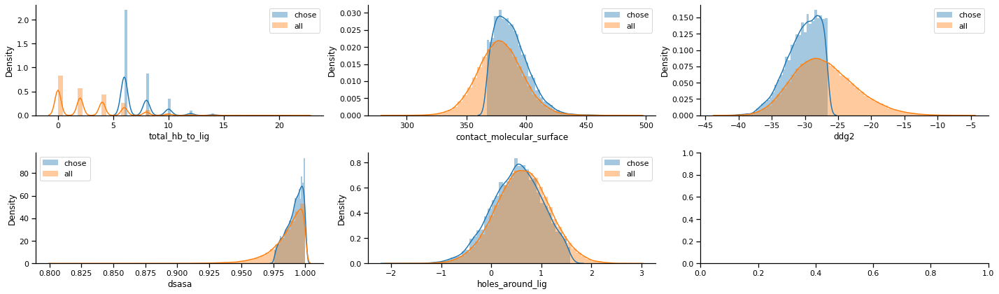

In [14]:
finalized_SEL = True
for n, lig in enumerate(ligands):
    if (lig == 'T44'):
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        all_ligmpnn_df = pd.read_csv(f'{design_dir}all_ligmpnn_FR_scores.csv')
        chose_df = all_ligmpnn_df.copy()
        if 'total_atom_depth' not in list(chose_df.columns):
            chose_df['total_atom_depth'] = 0
        print(f'{lig} start from {len(chose_df)}')
        for feature in FINAL_CHOSE_QUANTILE[lig]:
            chose_df = chose_df.sort_values(by=feature,ascending=FINAL_CHOSE_QUANTILE[lig][feature][1])
            value = FINAL_CHOSE_QUANTILE[lig][feature][2]
            if FINAL_CHOSE_QUANTILE[lig][feature][1]: #ascending=True
                chose_df = chose_df[chose_df[feature] <= value]
                print(f'{feature} at quantile {FINAL_CHOSE_QUANTILE[lig][feature][0]} less than value {value},',
                      f'left design {len(chose_df)}')
            else:
                chose_df = chose_df[chose_df[feature] >= value]
                print(f'{feature} at quantile {FINAL_CHOSE_QUANTILE[lig][feature][0]} greater than value {value},',
                      f'left design {len(chose_df)}')
        print(f'Rosetta filter success rate {100*len(chose_df)/len(all_ligmpnn_df)}%')
        print(f'chose scaffolds '+str(len(set(list(chose_df['cluster'])))))
        ncols = 3
        nrows = math.ceil(len(FINAL_CHOSE_QUANTILE[lig].keys()) / ncols)
        (fig, axs) = plt.subplots(ncols=ncols, nrows=nrows, figsize=[20,3*nrows])
        axs = axs.reshape(-1)

        for (i, metric) in enumerate(FINAL_CHOSE_QUANTILE[lig].keys()):
            sns.distplot(chose_df[metric].dropna(), ax=axs[i],label='chose')
            sns.distplot(all_ligmpnn_df[metric].dropna(), ax=axs[i],label='all')
            axs[i].legend()
        sns.despine()
        plt.tight_layout()
        plt.show()
        
        if finalized_SEL:
            chose_df.to_csv(f'{design_dir}sel_ligmpnn_FR_scores_for_af2.csv')
            #design these chosen docks for accurate MPNN resampling

In [ ]:
# ## (optional) check designs from selected list
# for n, lig in enumerate(ligands):
#     if lig == '4KL':
#         design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
#         os.chdir(design_dir)
#         chose_df = pd.read_csv(f'{design_dir}sel_ligmpnn_FR_scores_for_af2.csv')
#         check_df = chose_df.sample(n = 50)
#         for i,(j,row) in enumerate(check_df.iterrows()):
#             pdb = ('/'.join(row['pdb_path'].split('/')[-4:]))
#             subprocess.check_call(f'ln -s ../{pdb} check_sample/',shell=True)

## 4. Final check with AF2

In [9]:
## Finally check with AF2
## if gpu: 8min 16 pdb
AF2 = '/software/containers/mlfold.sif /home/linnaan/software/af2/run_af2.py'
BATCH = 30 # request 32g, 200 aa need 2 g, can load 32/2 = 16 proteins at maximum
for n, lig in enumerate(ligands):
    if (lig == 'T44'):
        cmds = []
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        os.chdir(design_dir)
        chA_only = f'check_af2/chA_only/'
        AF2_models = f'check_af2/af2_results/'
        os.makedirs(chA_only,exist_ok=True)
        os.makedirs(AF2_models,exist_ok=True)
        chose_df = pd.read_csv(f'{design_dir}sel_ligmpnn_FR_scores_for_af2.csv')
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = chose_df[chose_df['rotamer']==rotamer_name]
            for cluster in list(set(rotamer_sel_df.cluster)):
                cluster_chose_df = rotamer_sel_df[rotamer_sel_df['cluster']==cluster]
                indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,'indi_cluster_dir'].values[0]
                if len(cluster_chose_df) > 0:
                    print(f'pdbs {len(cluster_chose_df)}')
                    length = int(scaffold_df.loc[scaffold_df['cluster']==cluster,'nres'].values[0])
                    pdbs = list(cluster_chose_df['pdb_path'])
                    af2_indi_dir = f'{chA_only}{rotamer_name}/{indi_cluster_dir}'
                    af2_result_dir = f'{AF2_models}{rotamer_name}/{indi_cluster_dir}'
                    os.makedirs(af2_indi_dir,exist_ok=True)
                    os.makedirs(af2_result_dir,exist_ok=True)
                    fastas = []
                    for i,pdb in enumerate(pdbs): 
                        fasta_f = f'{af2_indi_dir}'+os.path.basename(pdb)[:-4]+'.fasta'
                        af2_model = glob.glob(af2_result_dir+'/'+os.path.basename(pdb)[:-4]+\
                                              '*_model_*.pdb')
                        if len(af2_model) > 0:
                            subprocess.check_call(f'rm -f {fasta_f}',shell=True)
                        else:
                            try:
                                record_gen = SeqIO.parse(pdb,"pdb-atom")
                                for record in record_gen:
                                    seq = str(record.seq)
                                with open(fasta_f,'w') as f:
                                    f.write('>'+os.path.basename(pdb)[:-4]+'\n'+seq)
                                fastas.append(fasta_f)
                            except:
                                print(f'[ERROR] {pdb} ')
                    if len(fastas) > 0:
                        fasta_list = [fastas[i:i + BATCH] for i in range(0, len(fastas), BATCH)]
                        for fasta_fs in fasta_list:
                            batch_size = len(fasta_fs)
                            fasta_fs = ','.join(fasta_fs)
                            cmds.append(f'{AF2} --out_dir {af2_result_dir} '+\
                                        f' --min_length {length} --num_models 5 '+\
                                        f' --batch_size {batch_size} --fasta_fs {fasta_fs}')
        if len(cmds) > 0:
            cmd_f = f'{lig}_check_af2_cmd'
            with open(cmd_f,'w') as f:
                f.write('\n'.join(cmds))
            make_submit_file(cmds=cmd_f,submitfile=f'{cmd_f}.submit.sh',time="2-0:00:00",
            group_size=(int(len(cmds)/160)+1),logsfolder='logs',cpus=1,mem='6g',needs_gpu=True,
                    gpu_type='rtx2080')
            SUBMIT = True
            if SUBMIT:
                subprocess.check_call(f'sbatch {cmd_f}.submit.sh',shell=True)
        else:
            print(f'{lig} all done')

For T44_0040_relax_charged_ref2015:________________________________
pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 20


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0240_relax_charged_ref2015:________________________________
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 34


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 48


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 36


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 40


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

For T44_0018_relax_charged_ref2015:________________________________
pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 30


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 24


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

For T44_0221_relax_charged_ref2015:________________________________
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 38


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 90


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 16


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 36


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 20


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 23


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
For T44_0008_relax_charged_ref2015:________________________________
pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 22


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 23


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 50


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0088_relax_charged_ref2015:________________________________
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 25


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 33


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 108


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 28


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 30


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 22


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 54


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 17


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 36


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
For T44_0001_relax_charged_ref2015:________________________________
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 48


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 32


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 30


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 29


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

For T44_0002_relax_charged_ref2015:________________________________
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 31


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 22


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 23


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 26


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 17


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 35


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 32


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 16


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

For T44_0007_relax_charged_ref2015:________________________________
For T44_0011_relax_charged_ref2015:________________________________
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 23


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 31


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 50


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 20


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 35


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 24


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 26


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 20


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 32


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
For T44_0004_relax_charged_ref2015:________________________________
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 25


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0038_relax_charged_ref2015:________________________________
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 30


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0189_relax_charged_ref2015:________________________________
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 36


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 36


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0057_relax_charged_ref2015:________________________________
pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 20


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
For T44_0236_relax_charged_ref2015:________________________________
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 60


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 16


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 49


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 42


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 31


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 33


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0029_relax_charged_ref2015:________________________________
pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 16


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 35


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 11


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

For T44_0003_relax_charged_ref2015:________________________________
pdbs 1
pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 30


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
For T44_0061_relax_charged_ref2015:________________________________
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 17


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 78


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 33


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 17


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 39


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 30


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
For T44_0006_relax_charged_ref2015:________________________________
For T44_0062_relax_charged_ref2015:________________________________
pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 16


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 14


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 33


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 26


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 17


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 28


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 57


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 7


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 26


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 23


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 9


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 19


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 13


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 12


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


For T44_0005_relax_charged_ref2015:________________________________
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 21


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 17


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 15


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 18


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 3


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 8


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 4


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 10


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 5


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 6


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/pyt

pdbs 1
pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 1
pdbs 1


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


pdbs 2


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/Bio/SeqIO/PdbIO.py:304: BiopythonParserWarning: 'HEADER' line not found; can't determine PDB ID.
  "'HEADER' line not found; can't determine PDB ID.", BiopythonParserWarning


In [16]:
cmd_f = f'{lig}_check_af2_cmd'
with open(cmd_f,'w') as f:
    f.write('\n'.join(cmds))

In [7]:
# add AF2 scores
## Finally check with AF2
## if gpu: 8min 16 pdb
## AF2 171min1.74 
for n, lig in enumerate(ligands):
    if (lig == 'T44'):# or (lig == 'MOA'):
        print(f'working on {lig}...')
        cmds,df_list = [],[]
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        os.chdir(design_dir)
        chA_only = f'check_af2/chA_only/'
        AF2_models = f'check_af2/af2_results/'
        chose_df = pd.read_csv(f'{design_dir}sel_ligmpnn_FR_scores_for_af2.csv')
        for feature in chose_df.columns: # prevent repeakmerge
            if 'model' in feature:
                chose_df = chose_df.drop(columns=[feature])
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = chose_df[chose_df['rotamer']==rotamer_name]
            for cluster in list(set(rotamer_sel_df.cluster)):
                cluster_chose_df = rotamer_sel_df[rotamer_sel_df['cluster']==cluster]
                indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,\
                                                   'indi_cluster_dir'].values[0]
                if len(cluster_chose_df) > 0:
                    pdbs = list(cluster_chose_df['pdb_path'])
                    af2_indi_dir = f'{chA_only}{rotamer_name}/{indi_cluster_dir}'
                    af2_result_dir = f'{AF2_models}{rotamer_name}/{indi_cluster_dir}'
                    for i,pdb in enumerate(pdbs):
                        if i >= 0:
                            pdb_info = {}
                            af2_models = glob.glob(af2_result_dir+\
                                                   os.path.basename(pdb)[:-4]+'*_model_*.pdb')
                            if len(af2_models) > 0:
                                chA = f'{af2_indi_dir}'+os.path.basename(pdb)
                                subprocess.check_call(f'grep " A " {pdb} > {chA}',shell=True)
                                for af2_model in af2_models:
                                    with open(af2_model,'r') as f:
                                        for line in f:
                                            if 'plddt' in line:
                                                pdb_info[line.split()[0]] = [line.split()[-1]]
                                    if 'model_4' in af2_model:
                                        pdb_info['unrelaxed_model_4'] = [af2_model]
                                        rmsd = get_RMSD(TMalign(chA,af2_model))
                                        pdb_info['rmsd_model4'] = rmsd
                                pdb_info['pdb_path'] = [pdb]
                                indi_df = pd.DataFrame.from_dict(pdb_info)
                                df_list.append(indi_df)
                            else:
                                continue
        all_plddt_df = pd.concat(df_list)
        chose_df = chose_df.merge(all_plddt_df,how='left',on='pdb_path')
        chose_df.to_csv(f'{design_dir}sel_ligmpnn_FR_scores_for_af2.csv')
chose_df  

working on T44...
For T44_0040_relax_charged_ref2015:________________________________
For T44_0240_relax_charged_ref2015:________________________________
For T44_0018_relax_charged_ref2015:________________________________
For T44_0221_relax_charged_ref2015:________________________________
For T44_0008_relax_charged_ref2015:________________________________
For T44_0088_relax_charged_ref2015:________________________________
For T44_0001_relax_charged_ref2015:________________________________
For T44_0002_relax_charged_ref2015:________________________________
For T44_0007_relax_charged_ref2015:________________________________
For T44_0011_relax_charged_ref2015:________________________________
For T44_0004_relax_charged_ref2015:________________________________
For T44_0038_relax_charged_ref2015:________________________________
For T44_0189_relax_charged_ref2015:________________________________
For T44_0057_relax_charged_ref2015:________________________________
For T44_0236_relax_charged_ref

,Unnamed: 0,Unnamed: 0.1,level_0,Unnamed: 0.1.1,index,SC,ala_core_count,buns_all_heavy_ball,buns_bb_heavy_ball,buns_sc_heavy_ball,...,sspred_overall,total_hb_to_lig,total_atom_depth,model_2,model_5,model_4,unrelaxed_model_4,rmsd_model4,model_3,model_1
0,8506,8506,0,0,score,-1.0,18.5,21.0,3.0,18.0,...,NaN,6.0,0,90.49,93.99,92.68,check_af2/af2_results/T44_0018_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_0_mincst_000000102_T44_0018_relax_charged_ref2015_FR0_0_FR1_0_FR2_pbias_cyc3_noise_0_FR_1_model_4.pdb,1.04,92.55,89.85
1,101294,101294,0,0,score,-1.0,0.0,14.0,6.0,8.0,...,NaN,10.0,0,64.96,53.89,61.36,check_af2/af2_results/T44_0005_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_pbias_33_mincst_000001548_T44_0005_relax_charged_ref2015_FR0_0_FR1_0_FR2_pbias_cyc3_noise_0_FR_1_model_4.pdb,3.37,51.89,61.0
2,35734,35734,0,0,score,-1.0,8.3,12.0,7.0,5.0,...,NaN,6.0,0,81.34,84.85,88.76,check_af2/af2_results/T44_0001_relax_charged_ref2015/3/EEEEEE_3_91/L_36_R_3_M_4_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211101_022756_142055_AAA+_step_00484_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_15_mincst_000000840_T44_0001_relax_charged_ref2015_FR0_0_FR1_0_FR2_pbias_cyc3_noise_0_FR_1_model_4.pdb,1.46,82.39,86.56
3,67471,67471,0,0,score,-1.0,42.1,7.0,3.0,4.0,...,NaN,6.0,0,95.61,95.58,94.48,check_af2/af2_results/T44_0236_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_pbias_2_mincst_000001619_T44_0236_relax_charged_ref2015_FR0_0_FR1_0_FR2_nobias_cyc3_noise_0_FR_1_model_4.pdb,0.80,94.76,94.43
4,45668,45668,0,0,score,-1.0,20.0,7.0,5.0,2.0,...,NaN,6.0,0,91.11,90.04,92.64,check_af2/af2_results/T44_0011_relax_charged_ref2015/3/HHHHHH_3_418/L_46_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211024_100115_511386_AAA+_step_00495_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_9_mincst_000000178_T44_0011_relax_charged_ref2015_FR0_0_FR1_0_FR2_nobias_cyc3_noise_0_FR_1_model_4.pdb,1.97,86.18,90.66
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6429,66886,66886,0,0,score,-1.0,5.9,12.0,7.0,5.0,...,NaN,6.0,0,86.67,89.21,85.51,check_af2/af2_results/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_31/L_64_R_2_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211022_215044_067437_AA+_step_00472_dldesign_2_relax_0001_rank_1_relax_dldesign_nbias_7_mincst_000000314_T44_0236_relax_charged_ref2015_FR0_0_FR1_0_FR2_nobias_cyc3_noise_0_FR_1_model_4.pdb,2.00,74.53,63.53
6430,24519,24519,0,0,score,-1.0,33.3,5.0,2.0,3.0,...,NaN,6.0,0,89.17,94.65,93.45,check_af2/af2_results/T44_0088_relax_charged_ref2015/3/HHHHHH_3_998/L_48_R_3_M_3_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211031_032247_620520_AAA+_step_00492_dldesign_0_relax_0001_rank_1_relax_dldesign_nbias_0_mincst_000000403_T44_0088_relax_charged_ref2015_FR0_0_FR1_0_FR2_nobias_cyc3_noise_0_FR_1_model_4.pdb,0.97,94.03,93.36
6431,72627,72627,0,0,score,-1.0,6.3,10.0,8.0,2.0,...,NaN,6.0,0,81.9,73.43,85.18,check_af2/af2_results/T44_0236_relax_charged_ref2015/2/EEHHEEHH_2_22/L_71_oligo_AA+_MR_2_MM_uniform_T_0.01_20211109_140914_230084_AA+_step_00404_dldesign_6_relax_0001_rank_1_relax_dldesign_pbias_15_mincst_000001406_T44_0236_relax_charged_ref2015_FR0_0_FR1_0_FR2_nobias_cyc3_noise_0_FR_1_model_4.pdb,1.14,82.19,77.67
6432,82311,82311,0,0,score,-1.0,11.8,9.0,3.0,6.0,...,NaN,8.0,0,58.91,60.45,75.32,check_af2/af2_results/T44_0003_relax_charged_ref2015/3/HHHHH_3_42/L_40_R_3_M_5_MR_5_MM_uniform_T_0_02_LW_4_0_2_0_1_0_20211025_074122_420227_AAA+_step_00491_dldesign_1_relax_0001_rank_1_relax_dldesign_nbias_6_mincst_000000594_T44_0003_relax_charged_ref2015_FR0_0_FR1_0_FR2_pbias_cyc3_noise_0_FR_1_model_4.pdb,1.52,59.52,71.82


working on T44...
T44 start 6434
obtained 2971, success rate 46.17656201429904%


/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-l

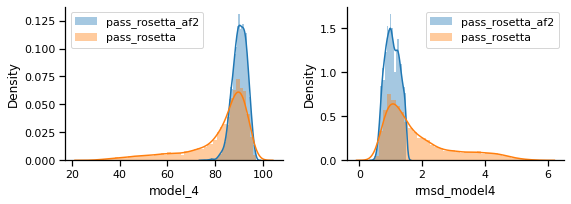

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-l

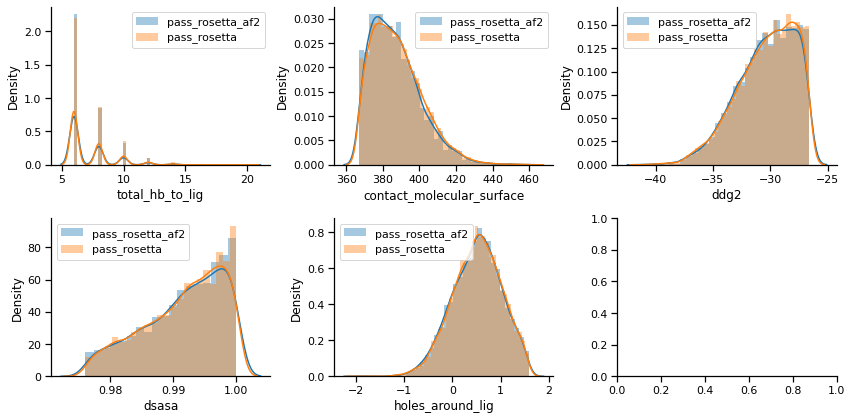

/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/ipykernel_launcher.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/linnaan/.conda/envs/common_use/lib/python3.6/site-packages/pandas/core/indexing.py:1763: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)


In [9]:
pLDDT_CUTOFF = 85
RMSD_CUTOFF = 1.5
cutoff_final = True
for n,lig in enumerate(ligands):
    if (lig == 'T44'):# or (lig == 'MOA'):
        print(f'working on {lig}...')
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        chose_df = pd.read_csv(f'{design_dir}sel_ligmpnn_FR_scores_for_af2.csv')
        print(f'{lig} start {len(chose_df)}')
        sel_df = chose_df[((chose_df['model_1'] > pLDDT_CUTOFF) | \
                          (chose_df['model_2'] > pLDDT_CUTOFF) | \
                          (chose_df['model_3'] > pLDDT_CUTOFF) | \
                          (chose_df['model_4'] > pLDDT_CUTOFF) | \
                          (chose_df['model_5'] > pLDDT_CUTOFF)) & \
                          (chose_df['rmsd_model4'] <= RMSD_CUTOFF) ]
        print(f'obtained {len(sel_df)}, success rate {100*len(sel_df)/len(chose_df)}%')
        features = ['model_4','rmsd_model4']
        plot2pandas(sel_df,chose_df,features,legend1='pass_rosetta_af2',legend2='pass_rosetta',ncols=2)

        order_dir = f'{scratch_dir}9_for_order/{lig}_design/'
        ligmpnn_design_dir = f'{order_dir}sel_ligMPNN_designs/'
        os.makedirs(ligmpnn_design_dir,exist_ok=True)
        plot2pandas(sel_df,chose_df,FINAL_CHOSE_QUANTILE[lig],legend1='pass_rosetta_af2',
                    legend2='pass_rosetta',ncols=3)
        
        if cutoff_final:
            sel_df['order_name'] = ''
            for i,(j,row) in enumerate(sel_df.iterrows()):
                pdb = row['pdb_path']
                rotamer = row['rotamer']
                cluster = row['cluster']
                short_name = scaffold_df.loc[scaffold_df['cluster']==cluster,'short_name'].values[0]
                original_name = os.path.basename(scaffold_df.loc[scaffold_df['cluster']==cluster,\
                                                                 'path'].values[0]).replace('.pdb','')
                new_pdb_name = os.path.basename(pdb)[:-4].replace(original_name,short_name)+f'_{rotamer}.pdb'
                cmd = f'cp -n {pdb} {ligmpnn_design_dir}{new_pdb_name}'
                subprocess.check_call(cmd,shell=True)
                with open(f'{ligmpnn_design_dir}{new_pdb_name}','a+') as f:
                    f.write(f'original_pdb {pdb}')
                sel_df.loc[j,'order_name'] = f'{ligmpnn_design_dir}{new_pdb_name}'
            sel_df.to_csv(f'{order_dir}sel_ligMPNN_designs.csv')

-----------------------------------------------------------
## Old scripts

## Correlation before FR intermediate results to final scores

In [ ]:
def get_score_lines(pdb):
    features = {'cms':-1,'ddg':9999,'res_totalscore':9999,'totalscore':9999}
    with open(pdb,'r') as fp:
        for line in fp:
            if line.rstrip() != '':
                if line.split()[0] in features:
                    features[line.split()[0]] = float(line.split()[1])
                else:
                    continue
            else:
                continue
    features['description'] = pdb
    df = pd.DataFrame.from_dict(features,orient='index')
    df_T = df.transpose()
    return df_T

In [ ]:
## Collect results and filter with Already validated Rosetta Filter
## collect all results, FR them and score
features = {'cms':True,'ddg':False,'res_totalscore':False,'totalscore':False}
for n,lig in enumerate(ligands):
    if lig == '4KL':
        miss_input,total_pdb = 0,0
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/'
        input_df= pd.read_csv(f'{scratch_dir}6_redo_ref2015_predictor/4KL_prediction/chosen_scaffolds.csv')
        os.chdir(design_dir)
        df_list = []
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = input_df[input_df['rotamer']==rotamer_name]
            for i,cluster in enumerate(list(set(rotamer_sel_df.cluster))):
                if i >= 0:
                    indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,
                                                       'indi_cluster_dir'].values[0]
                    ligMPNN_desigs = glob.glob(f'{rotamer_name}/{indi_cluster_dir}*_cyc3_0.pdb')
                    total_pdb += len(ligMPNN_desigs)
                    pdbs = [i for i in ligMPNN_desigs if 'cyc3' in i]
                    if len(pdbs)>0:
                        for pdb in pdbs:
                            indi_df = get_score_lines(pdb)
                            df_list.append(indi_df)
            print(len(df_list))
        all_ligmpnn_df = pd.concat(df_list)
        all_ligmpnn_df = all_ligmpnn_df.reset_index()
        #all_ligmpnn_df.to_csv(f'{design_dir}all_ligmpnn_quickFR_scores.csv')
        print(len(all_ligmpnn_df))

In [ ]:
all_ligmpnn_df.to_csv(f'{design_dir}all_ligmpnn_quickFR_scores.csv')

In [ ]:
design_dir = f'{scratch_dir}7_ligandMPNN_design/4KL_ligMPNN/'
all_ligmpnn_df = pd.read_csv(f'{design_dir}all_ligmpnn_quickFR_scores.csv')
df_real = pd.read_csv(f'{design_dir}all_ligmpnn_FR_scores.csv')

In [ ]:
df_real['before_FR'] = df_real['pdb_path'].str.replace('_FR.pdb','.pdb').str.split('/').str[-4:].str.join('/')

In [ ]:
df_real_quick = all_ligmpnn_df.merge(df_real[['contact_molecular_surface','ddg2','total','score_per_res','before_FR']],\
                left_on='description',right_on='before_FR',how='left')

In [ ]:
df_real_quick = df_real_quick.rename(columns={"cms": "cms_quick", "ddg": "ddg_quick",
                                              "res_totalscore":"score_per_res_quick",
                                              "totalscore":"total_score_quick",
                                              "contact_molecular_surface":"cms_real",
                                              "ddg2":"ddg_real","total":"total_score_real",
                                              "score_per_res":"score_per_res_real"})
df_real_quick

In [ ]:
from sklearn.metrics import roc_auc_score  
from sklearn.metrics import roc_curve, auc 
from sklearn.metrics import roc_auc_score
sns.set_context('notebook')  

# Find relevant features  
# Features to draw ROC for, you should have true and predict value for all of them 

features = ['cms','ddg','total_score','score_per_res']  #,'total_score','score_per_res']
higher_better = ['cms']  
method = '_quick'
df_feature = df_real_quick.copy()
df_feature = df_feature.drop(columns=['index'])
df_feature = df_feature.dropna()
# Prep axes; draw figures 
ncols = 4  
nrows = math.ceil(len(features) / ncols)*2 # *2 because we will also be plotting ROCs  
(fig, axs) = plt.subplots(nrows=nrows, ncols=ncols, figsize=[4*ncols,3*nrows])  
axs = axs.reshape(-1)  

# Plot  
for i,f in enumerate(features):
    print(f)
    #-------- First we plot the scatter ---------  
    # f+'_min': predict value; f+'_full': true value 
    df_feature[f+method] = df_feature[f+method].astype('float')
    sns.scatterplot(data=df_feature,x=f+method, y=f+'_real', ax=axs[i*2]) 
#    plt.plot(df_feature[f+method], df_feature[f+'_real'], ax=axs[i*2]) 
    #-------- Next we make roc plots ------------
    ps = [99,95,85,70,50,25,1] if f in higher_better else [5,15,30,50,75,100]
    print(ps)
    #ps = [1] if f in higher_better else [5,15,30,50,75,100]  
    cutoffs = np.percentile(df_feature[f+'_real'], ps) 
    print(f'{f} cutoffs {cutoffs}')
    dftmp = pd.DataFrame.from_dict({'percentiles':ps, 'cutoffs': cutoffs}).drop_duplicates(subset='cutoffs') #remove duplicates in case after some percentile, the cutoffs are the same 
    ps = list(dftmp['percentiles'])  
    cutoffs = list(dftmp['cutoffs'])  
    alt_cuts = list(set(df_feature[f+'_real'])) 
    print(len(alt_cuts))
    if len(alt_cuts)<=5: # if actual data number less or equal to cutoff number 
        cutoffs = alt_cuts  
        ps = len(cutoffs)*['_']            
    for percentile, cutoff in zip(ps, cutoffs):  
        print(percentile, cutoff)
        truth = (df_feature[f+'_real'] >= cutoff) if f in higher_better else (df_feature[f+'_real'] <= cutoff)  
        if sum(truth)==0 or sum(truth)==len(truth): # if no training set in range 
            continue  
        pred = df_feature[f+method] if f in higher_better else - df_feature[f+method]  
        print(len(truth), len(pred))
        y_true = truth
        y_score = pred
        AUC = roc_auc_score(y_true, y_score)
        print(AUC)
        fpr, tpr, _ = roc_curve(truth, pred) # https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html; fpr: false possitive rate; tpr; true possitive rate 
#         print(fpr, tpr)
        sns.lineplot(fpr,tpr,ax=axs[i*2+1], label=f'{percentile}_c={np.round(cutoff,0)} AUC={np.round(AUC,2)}')#   
        axs[i*2+1].set_xlabel('tpr')  
        axs[i*2+1].set_ylabel('fpr')  
        axs[i*2+1].set_title(f'{f}{method}')  

plt.tight_layout()  

## Benchmark for ligMPNN

In [ ]:
## Benchmark for ligMPNN
PYTHON = '/home/aivan/.conda/envs/SE3-a6000/bin/python'
ligMPNN = '/home/linnaan/scripts/scripts/pseudocycle_scripts/GRL_dl_design_scripts/ligMPNN_FR.py'
bias_fs = {'/home/drhicks1/scripts/proteinmpnn/design_scripts/bias_AA.jsonl':'_nobias',\
          '/home/linnaan/software/ml_mpnn/polar_bias.json':'_pbias'}
for n,lig in enumerate(ligands):
    if lig == '4KL':
        miss_input = 0
        design_dir = f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/benchmark/'
        input_df= pd.read_csv(f'{scratch_dir}6_redo_ref2015_predictor/4KL_prediction/chosen_scaffolds.csv')
        os.chdir(design_dir)
        cmds = []
        for rotamer in ligands[lig][2]:
            rotamer_name = os.path.basename(rotamer).replace('.pdb','')
            print(f'For {rotamer_name}:________________________________')
            rotamer_sel_df = input_df[input_df['rotamer']==rotamer_name]
            random_df = rotamer_sel_df.sample(25)
            for i,cluster in enumerate(list(set(random_df.cluster))):
                if i >= 0:
                    indi_cluster_dir = scaffold_df.loc[scaffold_df['cluster']==cluster,'indi_cluster_dir'].values[0]
                    pos_res_f = scaffold_df.loc[scaffold_df['cluster']==cluster,'posfile_by_hull'].values[0]
                    pos_res = []
                    with open(pos_res_f,'r') as f:
                        for line in f:
                            pos_res.append(line.rstrip())
                    pos_res = ','.join(pos_res)
                    rotamer_cluster_sel = random_df[random_df['cluster']==cluster]
                    os.makedirs(f'{rotamer_name}/{indi_cluster_dir}',exist_ok=True)
                    for silent_f in list(set(rotamer_cluster_sel.orig_silent_f)):
                        tags = list(rotamer_cluster_sel[rotamer_cluster_sel['orig_silent_f']==silent_f].description)
                        tag = tags[0]
                        if os.path.isfile(f'../{rotamer_name}/{indi_cluster_dir}{tag}.pdb'):
                            for bias_f in bias_fs:
                                for n_mpnn_FR_cycle in range(1,11):
                                    cmds.append(f'{PYTHON} {ligMPNN} '+\
                                          f'--pdb_path ../{rotamer_name}/{indi_cluster_dir}{tag}.pdb '+\
                                          f'--target_atm_for_cst '+ ligands[lig][4] +\
                                          f' --ligand_params_path '+ ligands[lig][1]+\
                                          f' --repackable_res {pos_res} --omit_AAs C'+\
                                          f' --out_folder {rotamer_name}/{indi_cluster_dir}'+\
                                          f' --use_ligand 1 --num_seq_per_target 4 '+\
                                          f'--sampling_temp 0.2 --ligand_genpot_params_path '+ ligands[lig][1]+\
                                          f' --out_folder {rotamer_name}/{indi_cluster_dir}'+\
                                          f' --bias_AA_jsonl {bias_f} '+\
                                          f' --suffix {bias_fs[bias_f]}_cyc{n_mpnn_FR_cycle}'+\
                                          f' --target_hb_atms '+ligands[lig][4] + \
                                          f' --n_mpnn_FR_cycle {n_mpnn_FR_cycle}')
                        else:
                            miss_input += 1
        cmd_f = design_dir + 'ligMPNN_cmd'
        with open(cmd_f,'w') as fp:
            fp.write('\n'.join(cmds))
        make_submit_file(cmds=cmd_f,
                submitfile=f'{cmd_f}.submit.sh',
                queue='medium',
                group_size=50,
                logsfolder='logs',
                cpus=1,
                mem='3g',
                limit_job_to100=False,
                needs_gpu=False) ## SSpred usage save cache which will create error if visited too often. 
        print(f'write {len(cmds)} design commands, miss input {miss_input}')
        SUBMIT = False
        if SUBMIT:
            subprocess.check_call(f'sbatch {cmd_f}.submit.sh',shell=True)

In [ ]:
## collect results to check correlation between ddg v.s. n_mpnn_FR_cycle numbers, 
## also eyeball to check which is better
lig = '4KL'
os.chdir(f'{scratch_dir}7_ligandMPNN_design/{lig}_ligMPNN/benchmark')
pdbs = glob.glob('*/*/*/*.pdb')
print(len(pdbs))
df_list = []
features = {'cms':True,'ddg':False,'res_totalscore':False,'totalscore':False}
for pdb in pdbs:
    scores = {}
    with open(pdb,'r') as f:
        for line in f:
            if line.rstrip() != '':
                if line.split()[0] in features:
                      scores[line.split()[0]] = [float(line.split()[-1])]
    indi_df = pd.DataFrame.from_dict(data=scores)
    indi_df['n_mpnn_FR_cycle'] = int(pdb.split('_')[-2].replace('cyc',''))
    indi_df['pdb_path'] = pdb 
    indi_df['parent'] = pdb.split('_FR0')[0]
    indi_df['bias'] = pdb.split('_')[-3]
    df_list.append(indi_df)
all_df = pd.concat(df_list)
df_list = []
for parent in list(all_df.parent):
    parent_df = all_df[all_df['parent']==parent]
    for feature in features:
        max_v, min_v = parent_df[feature].max(),parent_df[feature].min()
        if features[feature]:
            parent_df[feature+'_relative'] = (parent_df[feature]-min_v)/(max_v-min_v)
        else:
            parent_df[feature+'_relative'] = (parent_df[feature]-max_v)/(min_v-max_v)
    df_list.append(parent_df)
all_df = pd.concat(df_list)
all_df = all_df.drop_duplicates(subset = 'pdb_path')
all_df = all_df.sort_values(by='ddg',ascending=False).reset_index()

In [ ]:
plot_features = [i+'_relative' for i in features]
#g1= sns.distplot(data=all_df,x='ddg_relative',y='cms_relative',hue='n_mpnn_FR_cycle',style='bias',palette="deep")
g1= sns.displot(data=all_df,x='ddg',hue='n_mpnn_FR_cycle',palette="deep")#,style='bias',palette="deep")
g2= sns.displot(data=all_df,x='cms',hue='n_mpnn_FR_cycle',palette="deep")#,style='bias',palette="deep")
g3 = sns.scatterplot(data=all_df,x='ddg_relative',y='cms_relative',hue='n_mpnn_FR_cycle',palette="deep")#,style='bias',palette="deep")
all_df

In [ ]:
g3 = sns.scatterplot(data=all_df,x='ddg_relative',y='cms_relative',hue='n_mpnn_FR_cycle',style='bias',palette="deep")
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)